# let's see the results if we run 100x with only a mean landmark!

In [1]:
import cv2, os 
import numpy as np 
import warnings
warnings.filterwarnings('ignore')

In [2]:
import mediapipe as mp 
from PIL import Image as im 
import mediapipe as mp

def hand_locations(frame, min_detection_confidence = 0.5, min_tracking_confidence = 0.5): 
    hands = mp.solutions.hands.Hands(min_detection_confidence=min_detection_confidence, min_tracking_confidence=min_tracking_confidence) # MAKE SURE THIS IS ALL GOOD 
    results = hands.process(frame.astype('uint8'))
    X_locations = [0] * 42 # use 0 as default if the class is not there 
    Y_locations = [0] * 42 
    Z_locations = [0] * 42
    x = y = z = 0 
    if results.multi_hand_landmarks:
        for hand, hand_landmark in enumerate(results.multi_hand_landmarks):
            for i in range(0, 21):
                landmark = hand_landmark.landmark[i]
                X_locations[x] = landmark.x
                Y_locations[y] = landmark.y
                Z_locations[z] = landmark.z
                x += 1; y += 1; z += 1;
    X_locations = np.array(X_locations)
    Y_locations = np.array(Y_locations)
    Z_locations = np.array(Z_locations) 
    
    X_locs_1, X_locs_2 = X_locations[:21], X_locations[21:]
    Y_locs_1, Y_locs_2 = Y_locations[:21], Y_locations[21:]
    Z_locs_1, Z_locs_2 = Z_locations[:21], Z_locations[21:]
    locations = np.array([locs[np.nonzero(locs)].mean() for locs in [X_locs_1, X_locs_2, Y_locs_1, Y_locs_2, Z_locs_1, Z_locs_2] ])
    hands.close()
    return np.nan_to_num(locations)

In [3]:
#https://stackoverflow.com/questions/41908379/keras-plot-training-validation-and-test-set-accuracy
import matplotlib.pyplot as plt 
def plot(history, show_pr = False, num = None): 
    
    if num: 
        plt.plot(history.history['accuracy'], label = "train_acc")
        plt.plot(history.history['val_accuracy'], label = "val_acc")
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        plt.plot(history.history['loss'], label = "train_loss")
        plt.plot(history.history['val_loss'], label = "val_loss")
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        if show_pr: 
            plt.plot(history.history[f'precision_{num}'], label = "train_precision")
            plt.plot(history.history[f'val_precision_{num}'], label = "val_precision")
            plt.title('model precision')
            plt.ylabel('precision')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()

            plt.plot(history.history[f'recall_{num}'], label = "train_recall")
            plt.plot(history.history[f'val_recall_{num}'], label = "val_recall")
            plt.title('model recall')
            plt.ylabel('recall')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()
    else: 
        plt.plot(history.history['accuracy'], label = "train_acc")
        plt.plot(history.history['val_accuracy'], label = "val_acc")
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        plt.plot(history.history['loss'], label = "train_loss")
        plt.plot(history.history['val_loss'], label = "val_loss")
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        if show_pr: 
            plt.plot(history.history[f'precision'], label = "train_precision")
            plt.plot(history.history[f'val_precision'], label = "val_precision")
            plt.title('model precision')
            plt.ylabel('precision')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()

            plt.plot(history.history[f'recall'], label = "train_recall")
            plt.plot(history.history[f'val_recall'], label = "val_recall")
            plt.title('model recall')
            plt.ylabel('recall')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()
    # let's see whether it can detect me not doing anything 

# we can create a padding function in order to pad 
def pad(locations, maxlen = 90, padding = "post", truncating = "post"): 
    new_locations = np.array(locations).tolist() 
    empty_row = np.zeros((1, 126))
    for i, video in tqdm(enumerate(new_locations)): 
        if len(video) < maxlen:  
            for new_row in range(maxlen - len(video)): 
                if padding == "post": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([new_locations[i], empty_row])
                if padding == "pre": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([empty_row, new_locations[i]])

        if len(video) > maxlen: 
            if truncating == "post": 
                new_locations[i] = new_locations[i][:maxlen]
            elif truncating == "pre": 
                new_locations[i] = new_locations[i][len(video) - maxlen : ]
    return np.array(new_locations)
    
def predict_on_video(model, path): 
    LOCATIONS = []
    cap = cv2.VideoCapture(path)
    while cap.isOpened():
        _, frame = cap.read()
        if not _: break 

        LOCATIONS.append(hand_locations(frame))
    LOCATIONS = pad(np.array([LOCATIONS]),maxlen=90)
    return model.predict(LOCATIONS)


In [4]:
import random, cv2
import mediapipe as mp
import tensorflow as tf 
from warnings import filterwarnings
filterwarnings("ignore") 
tf.config.run_functions_eagerly(True)

def _shift(X):
        
        X = tf.Variable(X, dtype = tf.float32)
        
        X_locations = X[:, :2] 
        Y_locations = X[:, 2:4] 
        Z_locations = X[:, 4:6]
        
        mask = tf.not_equal(Y_locations, 0) 
        nonzero_Y_locations = tf.boolean_mask(Y_locations, mask) # contains all nonzero elements of Y_locations 
    
        maximum = tf.math.reduce_max(nonzero_Y_locations)
        minimum = tf.math.reduce_min(nonzero_Y_locations)

        can_move_up = 1 - maximum 
        can_move_down = minimum 
        mask = tf.cast(mask, tf.float32)
    
        if tf.random.uniform((1,)) > 0.5: 
            move_up = tf.random.uniform((1,), 0, can_move_up)
            X[:, 2:4].assign(X[:, 2:4] + mask * tf.ones_like(X[:, 2:4]) * move_up)
        else: 

            move_down = tf.random.uniform((1,), 0, can_move_down)
            X[:, 2:4].assign(X[:, 2:4] - mask * tf.ones_like(X[:, 2:4]) * move_down)

        mask = tf.not_equal(X_locations, 0) 
        nonzero_X_locations = tf.boolean_mask(X_locations, mask) 

        maximum = tf.math.reduce_max(nonzero_X_locations)
        minimum = tf.math.reduce_min(nonzero_X_locations)
            
        can_move_right = 1- maximum
        can_move_left = minimum 
        mask = tf.cast(mask, tf.float32)

        if tf.random.uniform((1,)) > 0.5: 
            #print("right")
            # move right
            move_right = tf.random.uniform((1,), 0, can_move_right)
            X[:, :2].assign(X[:, :2] + mask * tf.ones_like(X[:, :2]) * move_right)

        else: 
            # move left 
            move_left = tf.random.uniform((1,), 0, can_move_left)
            X[:, :2].assign(X[:, :2] - mask * tf.ones_like(X[:, :2]) * move_left)

        mask = tf.not_equal(Z_locations, 0) 
        nonzero_Z_locations = tf.boolean_mask(Z_locations, mask)

        maximum = tf.math.reduce_max(nonzero_Z_locations)
        minimum = tf.math.reduce_min(nonzero_Z_locations)
        mask = tf.cast(mask, tf.float32)

        can_move_far = 1 - maximum 
        can_move_close = minimum 

        if tf.random.uniform((1,)) > 0.5: 
            # move right
            move_far = tf.random.uniform((1,), 0, can_move_far)
            X[:, 4:6].assign(X[:, 4:6] + mask * tf.ones_like(X[:, 4:6]) * move_far)
        else: 
            # move left 
            move_close = tf.random.uniform((1,), 0, can_move_close)
            X[:, 4:6].assign(X[:, 4:6] - mask * tf.ones_like(X[:, 4:6]) * move_close)

        return X

class Augmenter(tf.keras.layers.Layer): 
    def __init__(self, rotation_range = None, **kwargs): 
        super().__init__(kwargs)
        self.trainable = False 
        self._trainable_weights = [] 
        self._non_trainable_weights = []
        self.rotation_range = rotation_range 
    
    def _rotate(self, X):  
        """
        new_x = X * np.cos(theta * np.pi/180) + y * np.sin(theta * np.pi/180)
        new_y = -X * np.sin(theta* np.pi/180) + y * np.cos(theta * np.pi/180)
        """
        X = tf.Variable(X, dtype = tf.float32)

        pi = 3.1415
        rotate_by = tf.random.uniform((1,), -self.rotation_range, self.rotation_range)
        X[:, :12].assign(X[:, :12] * tf.math.cos(rotate_by * pi/180) + X[:, 12:24] * tf.math.sin(rotate_by * pi/180))
        X[:, 12:24].assign(X[:, 12:24] * tf.math.cos(rotate_by * pi/180) - X[:, :12] * tf.math.sin(rotate_by * pi/180))
        return X 
    def get_config(self):

        config = super().get_config().copy()
        config.update({
            'vocab_size': 0,
            'num_layers': 1,
            'units': 0,
            'd_model': 1,
            'num_heads': 1,
            'dropout': 0,
        })
        return config
    
    def call(self, X, training = True):
        if training: 
            X =  tf.map_fn(_shift, X)
            if self.rotation_range: 
                X = tf.map_fn(self._rotate, X)
            return X
        else: 
            return X 

class TTAugmenter(tf.keras.layers.Layer): 
    """apply augmentation during test-time too"""
    def __init__(self, rotation_range = None, **kwargs): 
        super().__init__(**kwargs)
        self.trainable = False 
        self._trainable_weights = [] 
        self._non_trainable_weights = []
        self.rotation_range = rotation_range 
    
    def _rotate(self, X):  
        """
        new_x = X * np.cos(theta * np.pi/180) + y * np.sin(theta * np.pi/180)
        new_y = -X * np.sin(theta* np.pi/180) + y * np.cos(theta * np.pi/180)
        """
        X = tf.Variable(X, dtype = tf.float32)

        pi = 3.1415
        rotate_by = tf.random.uniform((1,), -self.rotation_range, self.rotation_range)
        
        X[:, :12].assign(X[:, :12] * tf.math.cos(rotate_by * pi/180)  - X[:, 12:24] * tf.math.sin(rotate_by * pi/180))
        X[:, 12:24].assign(X[:, 12:24] * tf.math.cos(rotate_by * pi/180) + X[:, :12] * tf.math.sin(rotate_by * pi/180))
        return X 

    def call(self, X):
        X =  tf.map_fn(_shift, X)
        if self.rotation_range: 
            X = tf.map_fn(self._rotate, X)
        return X 

class myCallback(tf.keras.callbacks.Callback): 
    def on_epoch_end(self, epoch, logs={}): 
        if(logs.get('val_accuracy') > 0.9):   
            print("\nReached %2.2f%% accuracy, so stopping training!!" %(0.9*100))   
            self.model.stop_training = True  

In [5]:
def pad(locations, maxlen = 90, padding = "post", truncating = "post"): 
    new_locations = locations.tolist() 
    empty_row = np.zeros((1, 6))
    for i, video in tqdm(enumerate(new_locations)): 
        if len(video) < maxlen:  
            for new_row in range(maxlen - len(video)): 
                if padding == "post": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([new_locations[i], empty_row])
                if padding == "pre": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([empty_row, new_locations[i]])

        if len(video) > maxlen: 
            if truncating == "post": 
                new_locations[i] = new_locations[i][:maxlen]
            elif truncating == "pre": 
                new_locations[i] = new_locations[i][len(video) - maxlen : ]
    return np.array(new_locations)

In [6]:
from scipy import interpolate
def adjust(frame_matrix): 
    assert len(frame_matrix.shape) == 2
    rows, columns = frame_matrix.shape
    for column in range(columns): 
        loc_dimension = frame_matrix[column]
        x = np.arange(0, rows, 1)
        idx = np.nonzero(loc_dimension)
        if len(idx) == 1: 
            continue 
        interp_func = interpolate.interp1d(x[idx], loc_dimension[idx], kind='cubic', fill_value = "extrapolate")
        frame_matrix[:, column] = interp_func(x) 
    return frame_matrix

def interp_X(X): 
    temp_X = np.concatenate([X_i for X_i in X])
    temp_X =  np.array([adjust(temp_X_i) for temp_X_i in temp_X])
    print(temp_X.shape)
    return temp_X.reshape(X.shape)

In [7]:
def plot_roc_auroc(base_fpr, TPRs, FPRs, aurocs): 
    

    for i, (tpr, fpr) in enumerate(zip(TPRs, FPRs)): 
        plt.plot(base_fpr, tpr, label = f"fold {i + 1}")

    mean_tpr = np.mean(TPRs, axis=0)
    plt.plot(base_fpr, mean_tpr, label = "average of folds")
    
    std_tpr = np.std(TPRs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    plt.fill_between(base_fpr, tprs_lower, tprs_upper, color='grey', alpha=.3,
                 label=r'$\pm$ 1 std. dev.')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--', label = "chance")
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve across folds')
    plt.legend(loc="lower right")
    plt.show()

    # plot the auroc curves 
    mean_auroc = sum(aurocs) / len(aurocs)
    descriptions = [f"fold {i + 1}" for i in range(len(aurocs))] + ["average fold"]
    aurocs.append(mean_auroc)
    plt.bar(descriptions, aurocs, color = "green")
    plt.xlabel("Fold")
    plt.ylabel("Area Under Curve")
    plt.title("Area Under ROC Curve across folds")
    plt.show() 

    return mean_tpr, mean_auroc

def plot_meta_roc_auroc(average_aurocs, average_tprs, base_fpr): 
    meta_avg_tpr = np.mean(average_tprs, axis = 0) 
    meta_avg_auroc = sum(average_aurocs) / len(average_aurocs)
    
    for i, average_tpr in enumerate(average_tprs): 
        plt.plot(base_fpr, average_tpr, label = f"run {i + 1}")
    
    plt.plot(base_fpr, meta_avg_tpr, label = "average of runs")
    
    std_tpr = np.std(average_tprs, axis=0)
    tprs_upper = np.minimum(meta_avg_tpr + std_tpr, 1)
    tprs_lower = np.maximum(meta_avg_tpr - std_tpr, 0)
    plt.fill_between(base_fpr, tprs_lower, tprs_upper, color='grey', alpha=.3, label=r'$\pm$ 1 std. dev.')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--', label = "chance")
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Average ROC Curve across Runs (No Aug)')
    plt.legend(loc="lower right")
    plt.show()

    descriptions = [f"{i + 1}" for i in range(len(average_aurocs))] + ["avg"]
    average_aurocs.append(meta_avg_auroc)
    plt.bar(descriptions, average_aurocs, color = "green")
    plt.xlabel("Run Number")
    plt.ylabel("Area Under Curve")
    plt.title("Area Under ROC Curve across Runs (No Aug)")
    plt.show()

In [16]:
from glob import glob
from tqdm import tqdm 
from scipy import interp
import tensorflow_addons as tfa
from sklearn.metrics import roc_curve, roc_auc_score
AVERAGE_TPRS, AVERAGE_AUROCS = [], []
META_RESULT_MATRIX = [] 
def cross_validate(make_model, epochs = 50, callbacks=[]):
    """adds the training & validation accuracy, precision, recall, and F1 for each of the folds to a meta matrix"""
    model = make_model()

    base_fpr = np.linspace(0, 1, 101)
    FPRS, TPRS, AUROCS = [], [], []
    for i in range(5): 
        # for each fold change up the dataset 
        model = make_model()

        ARMFLAPPING_TRAINING_FRAMES = np.concatenate([fold for j, fold in enumerate(ARMFLAPPING_FRAMES_SPLIT) if j != i])
        CONTROL_TRAINING_FRAMES = np.concatenate([fold for j, fold in enumerate(CONTROL_FRAMES_SPLIT) if j != i])

        ARMFLAPPING_VALIDATION_FRAMES = ARMFLAPPING_FRAMES_SPLIT[i]
        CONTROL_VALIDATION_FRAMES = CONTROL_FRAMES_SPLIT[i]

        print(ARMFLAPPING_TRAINING_FRAMES.shape, CONTROL_TRAINING_FRAMES.shape)
        print(ARMFLAPPING_VALIDATION_FRAMES.shape, CONTROL_VALIDATION_FRAMES.shape)
        
        X_test = np.concatenate([ARMFLAPPING_VALIDATION_FRAMES, CONTROL_VALIDATION_FRAMES])
        X_train = np.concatenate([ARMFLAPPING_TRAINING_FRAMES, CONTROL_TRAINING_FRAMES])
        
        y_train = np.concatenate([np.ones(len(ARMFLAPPING_TRAINING_FRAMES)), np.zeros(len(CONTROL_TRAINING_FRAMES))])
        y_test = np.concatenate([np.ones(len(ARMFLAPPING_VALIDATION_FRAMES)), np.zeros(len(CONTROL_VALIDATION_FRAMES))])

        # shuffle it to avoid 0e+00 error 
        N = np.random.permutation(X_train.shape[0])
        X_train = X_train[N]
        y_train = y_train[N]

        N= np.random.permutation(X_test.shape[0])
        X_test = X_test[N]
        y_test = y_test[N]

        try:
            os.remove("best_other.h5") 
        except Exception as e: 
            pass 
        
        # train 
        history = model.fit(X_train, y_train, validation_data = (X_test, y_test), epochs = epochs, callbacks = callbacks)
        
        try: 
            model.load_weights("best_other.h5")
        except Exception as e: 
            pass 

        # evaluate again 
        model.evaluate(X_test, y_test)
        
        # plot accuracy and loss 
        plot(history)

        # get this information  
        y_pred = model.predict(X_test).flatten()
        fpr, tpr, _ = roc_curve(y_test, y_pred) 
        FPRS.append(fpr)
        tpr = interp(base_fpr, fpr, tpr)
        tpr[0] = 0.0 
        TPRS.append(tpr)
        AUROCS.append(roc_auc_score(y_test, y_pred))


        # accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6086 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0

        training_accuracy = history.history['accuracy'][-1]
        validation_accuracy = history.history['val_accuracy'][-1]
        training_precision = history.history['precision'][-1]
        validation_precision = history.history['val_precision'][-1]
        training_recall = history.history['recall'][-1]
        validation_recall = history.history['val_recall'][-1]
        training_f1 = 2 * training_precision * training_recall / (training_precision + training_recall + tf.keras.backend.epsilon())
        validation_f1 = 2 * validation_precision * validation_recall / (validation_precision + validation_recall + tf.keras.backend.epsilon())

        # add to meta matrix
        META_RESULT_MATRIX.append([training_accuracy, training_precision, training_recall, training_f1, validation_accuracy, validation_precision, validation_recall, validation_f1])

        # evaluate on our own custom videos
        for file in glob("*.mov"):
            print(f"prediction for video {file} is {predict_on_video(model, file)}")

    mean_tpr, mean_auroc = plot_roc_auroc(base_fpr, TPRS, FPRS, AUROCS) 
    AVERAGE_TPRS.append(mean_tpr) 
    AVERAGE_AUROCS.append(mean_auroc)

In [17]:
# don't shuffle  

import random 
def shuffle(X, y, seed = None):
    if seed == None:  
        seed = random.randrange(0, 100)
        print(f"using seed {seed}")
    np.random.seed(seed) 
    new_X = np.concatenate([X_i for X_i in X])
    new_y = np.concatenate([y_i for y_i in y])
    N = np.random.permutation(new_X.shape[0])
    new_X = new_X[N]
    new_y = new_y[N]
    new_X = new_X.reshape(5, 20, 90, 6)
    new_y = new_y.reshape(5, 20)
    return new_X, new_y


In [18]:
def f1(y_true, y_pred):
    y_pred = tf.round(y_pred)
    tp = tf.math.reduce_sum(tf.cast(y_true*y_pred, 'float'), axis=0)
    tn = tf.math.reduce_sum(tf.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = tf.math.reduce_sum(tf.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = tf.math.reduce_sum(tf.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + tf.keras.backend.epsilon())
    r = tp / (tp + fn + tf.keras.backend.epsilon())

    f1 = 2*p*r / (p+r+tf.epsilon())
    f1 = tf.where(tf.math.is_nan(f1), tf.zeros_like(f1), f1)
    return tf.mean(f1)

def f1_loss(y_true, y_pred):
    
    tp = tf.math.reduce_sum(tf.cast(y_true*y_pred, 'float'), axis=0)
    tn = tf.math.reduce_sum(tf.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = tf.math.reduce_sum(tf.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = tf.math.reduce_sum(tf.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + tf.keras.backend.epsilon())
    r = tp / (tp + fn + tf.keras.backend.epsilon())

    f1 = 2*p*r / (p+r+tf.keras.backend.epsilon())
    f1 = tf.where(tf.math.is_nan(f1), tf.zeros_like(f1), f1)
    return 1 - tf.math.reduce_mean(f1)

In [19]:
def make_model(): 
    model = tf.keras.models.Sequential([
        #Augmenter(), 
        tf.keras.layers.LSTM(64, return_sequences=False, input_shape = (None, 6)), 
        tf.keras.layers.Dropout(0.3), 
        tf.keras.layers.Dense(1, activation = 'sigmoid') 
    ]) 

    model.compile(loss = tf.keras.losses.BinaryCrossentropy(), optimizer = tf.keras.optimizers.Adam(learning_rate=0.01), metrics = ['accuracy', tf.keras.metrics.Precision(name="precision"), tf.keras.metrics.Recall(name="recall")])

    return model

In [20]:
import pickle, numpy as np
with open("one_point_folds_seeds", 'rb') as f: 
    information = pickle.load(f)

ARMFLAPPING_FRAMES, ARMFLAPPING_FILE_NAMES, CONTROL_FRAMES, CONTROL_FILE_NAMES = [np.concatenate(info) for info in information]

assert ARMFLAPPING_FILE_NAMES.shape == CONTROL_FILE_NAMES.shape
assert ARMFLAPPING_FRAMES.shape == CONTROL_FRAMES.shape

In [21]:
WRITE_DATA = False
if WRITE_DATA: 
    SEEDS = np.abs(np.array(np.random.randn(100) * 100, dtype = np.int32))
    FILES_FOR_FOLD = []
    for seed in SEEDS:
        np.random.seed(seed) # set seed 
        
        N = np.random.permutation(ARMFLAPPING_FRAMES.shape[0])
        ARMFLAPPING_FILE_NAMES = ARMFLAPPING_FILE_NAMES[N]
        CONTROL_FILE_NAMES = CONTROL_FILE_NAMES[N]

        armflapping_file_name_folds =  np.array_split(ARMFLAPPING_FILE_NAMES, 5)
        control_file_name_folds =  np.array_split(CONTROL_FILE_NAMES, 5)

        for i in range(5):
            # the ith fold is for validation, everything else is for whatever 

            armflapping_training_files = np.concatenate([fold for j, fold in enumerate(armflapping_file_name_folds) if j != i])
            control_training_files = np.concatenate([fold for j, fold in enumerate(control_file_name_folds) if j != i])

            armflapping_validation_files = armflapping_file_name_folds[i]
            control_validation_files = control_file_name_folds[i]

            FILES_FOR_FOLD.append({"train": np.concatenate([armflapping_training_files, control_training_files]).tolist(), "test": np.concatenate([armflapping_validation_files, control_validation_files]).tolist()})
    # save this and the seeds used in a pickle file 

    with open("file_names_folds.pkl", 'wb') as f: 
        pickle.dump((SEEDS.tolist(), FILES_FOR_FOLD), f)

In [22]:
if not WRITE_DATA: 
    with open("file_names_folds.pkl", 'rb') as f: 
        SEEDS, _ = pickle.load(f)

# okay so this is the same thing but for the mean landmark approach

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.7022 - accuracy: 0.4500 - precision: 0.4714 - recall: 0.8250 - val_loss: 0.6836 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6829 - accuracy: 0.5125 - precision: 0.5714 - recall: 0.1000 - val_loss: 0.6675 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6480 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.9044 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 172ms/step - loss: 0.8083 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 1.0162 - val_accuracy: 0.4500 - val_precision: 0.4000 - val_recall: 0.2000
Epoch 5/75
3/3 [==============================] - 1s 174ms/step 

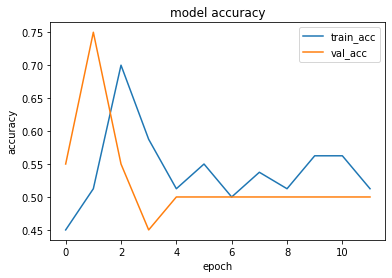

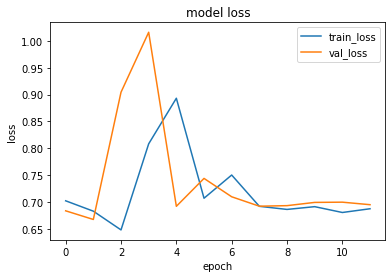

1it [00:00, 1510.37it/s]


prediction for video armflapping_1.mov is [[0.4515709]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.433749]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.45181814]]


1it [00:00, 8208.03it/s]


prediction for video control_1.mov is [[0.45131582]]


1it [00:00, 11748.75it/s]


prediction for video control_2.mov is [[0.45126337]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.45126328]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6815 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.7809 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6145 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.9784 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 177ms/step - loss: 0.8658 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.7128 - val_accuracy: 0.4500 - val_precision: 0.4286 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6097 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.7538 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 5/75


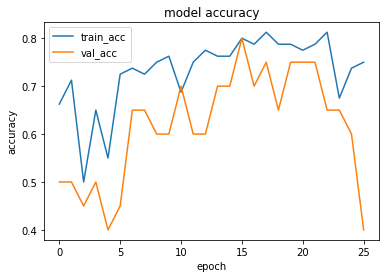

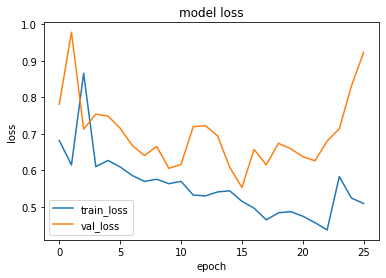

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.19066021]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.2949633]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.47581467]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.16738531]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.15999106]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.15861621]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 173ms/step - loss: 0.7103 - accuracy: 0.4500 - precision: 0.4167 - recall: 0.2500 - val_loss: 0.6696 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6838 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6393 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6591 - accuracy: 0.5375 - precision: 0.5273 - recall: 0.7250 - val_loss: 0.6444 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6619 - accuracy: 0.6250 - precision: 0.6136 - recall: 0.6750 - val_loss: 0.5930 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75


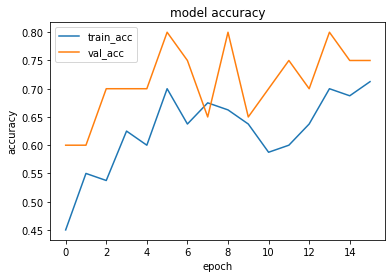

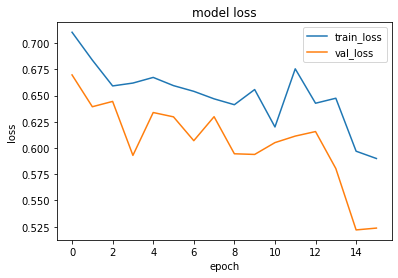

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.45101786]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_3.mov is [[0.5920617]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.58652645]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.3221019]]


1it [00:00, 14563.56it/s]


prediction for video control_2.mov is [[0.3172351]]


1it [00:00, 12633.45it/s]


prediction for video control_3.mov is [[0.3354115]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6715 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.8391 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7100 - accuracy: 0.6000 - precision: 0.6176 - recall: 0.5250 - val_loss: 0.6901 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6634 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.6819 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6747 - accuracy: 0.6875 - precision: 0.6364 - recall: 0.8750 - val_loss: 0.6782 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75
3

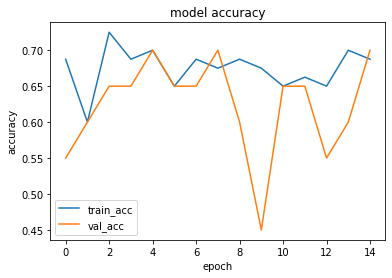

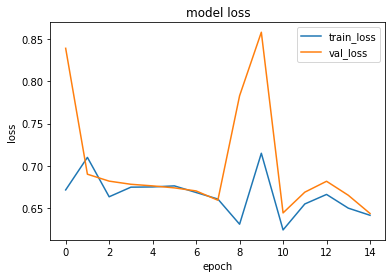

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.35633296]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.41725463]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.4499942]]


1it [00:00, 15477.14it/s]


prediction for video control_1.mov is [[0.33369315]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.32966292]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.33492482]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6961 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3750 - val_loss: 0.6748 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6695 - accuracy: 0.5250 - precision: 0.5250 - recall: 0.5250 - val_loss: 0.6939 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6375 - accuracy: 0.6000 - precision: 0.5741 - recall: 0.7750 - val_loss: 0.7158 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6283 - accuracy: 0.6875 - precision: 0.6316 - recall: 0.9000 - val_loss: 0.9805 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 5/75


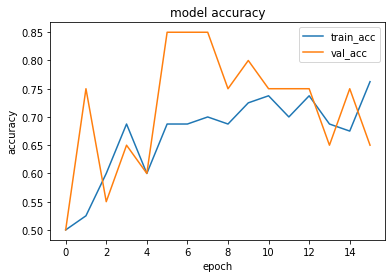

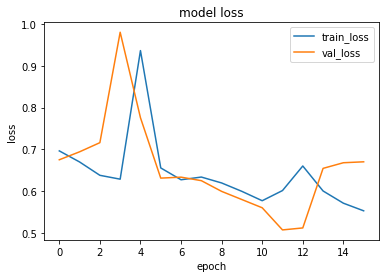

1it [00:00, 6584.46it/s]


prediction for video armflapping_1.mov is [[0.40686768]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.4458112]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.48341864]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.38395292]]


1it [00:00, 16320.25it/s]


prediction for video control_2.mov is [[0.38815638]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.39175972]]


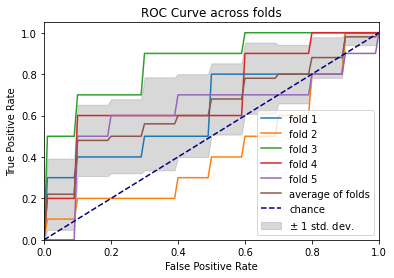

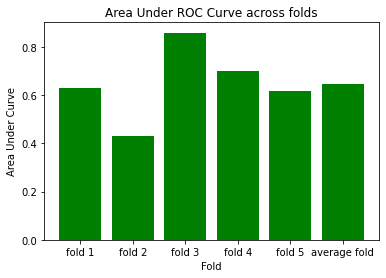

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 231ms/step - loss: 0.7061 - accuracy: 0.4500 - precision: 0.4600 - recall: 0.5750 - val_loss: 0.6870 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 171ms/step - loss: 0.7703 - accuracy: 0.6750 - precision: 0.8889 - recall: 0.4000 - val_loss: 0.7184 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6492 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6891 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6769 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6804 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 158ms/step 

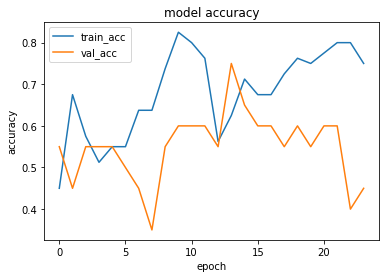

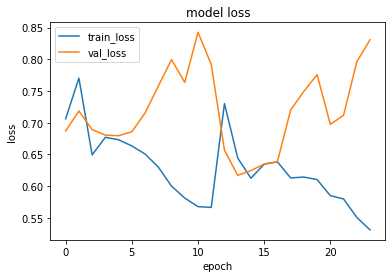

1it [00:00, 8338.58it/s]


prediction for video armflapping_1.mov is [[0.3019673]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.3118552]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.42018065]]


1it [00:00, 19599.55it/s]


prediction for video control_1.mov is [[0.2833833]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.27441984]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.26544154]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 191ms/step - loss: 0.7067 - accuracy: 0.4125 - precision: 0.4493 - recall: 0.7750 - val_loss: 0.6522 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 223ms/step - loss: 0.6803 - accuracy: 0.5750 - precision: 0.5682 - recall: 0.6250 - val_loss: 0.6436 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6870 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1750 - val_loss: 0.6127 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 183ms/step - loss: 0.6761 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.5375 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epoch 5/75


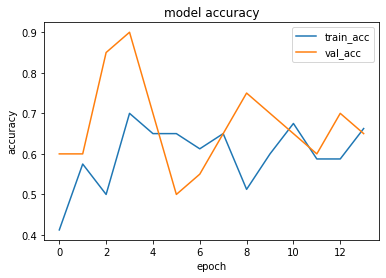

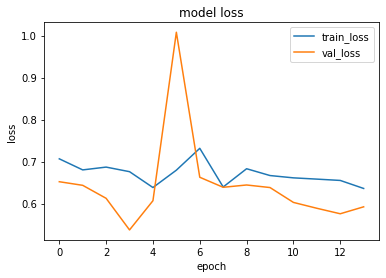

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.5586332]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_3.mov is [[0.54672724]]


1it [00:00, 7358.43it/s]


prediction for video armflapping_2.mov is [[0.49013686]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.5535544]]


1it [00:00, 17260.51it/s]


prediction for video control_2.mov is [[0.50983113]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.55302685]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 184ms/step - loss: 0.6731 - accuracy: 0.6375 - precision: 0.6410 - recall: 0.6250 - val_loss: 0.6472 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 191ms/step - loss: 0.6422 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.6416 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 1s 185ms/step - loss: 0.6484 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6479 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6464 - accuracy: 0.7125 - precision: 0.6545 - recall: 0.9000 - val_loss: 0.6388 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


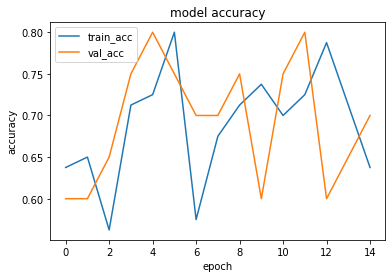

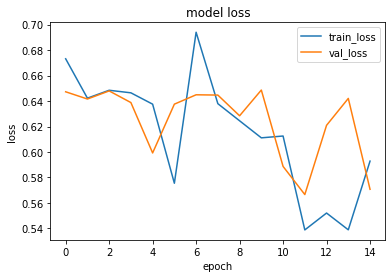

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.48985562]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.58106107]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.6064446]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.33624882]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.29778022]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.28038305]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 184ms/step - loss: 0.6822 - accuracy: 0.5750 - precision: 0.5455 - recall: 0.9000 - val_loss: 0.6187 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 1s 197ms/step - loss: 0.7760 - accuracy: 0.6125 - precision: 0.5849 - recall: 0.7750 - val_loss: 0.7020 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6636 - accuracy: 0.5500 - precision: 0.5286 - recall: 0.9250 - val_loss: 0.7054 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6702 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.6986 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


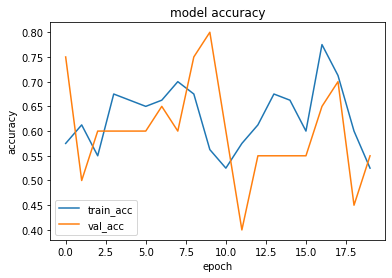

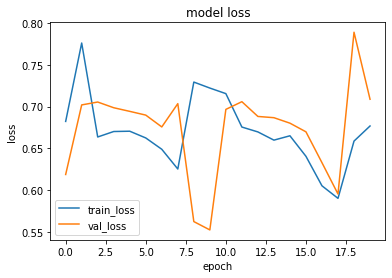

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.4872488]]


1it [00:00, 11618.57it/s]


prediction for video armflapping_3.mov is [[0.5186746]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.50432795]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.47885033]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.47584203]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.4760562]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6806 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6622 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6947 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6622 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6547 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6701 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6736 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6673 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75
3

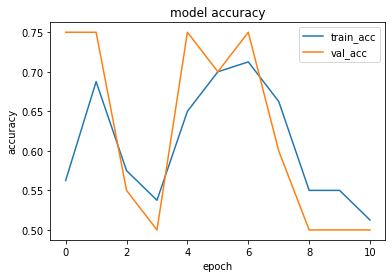

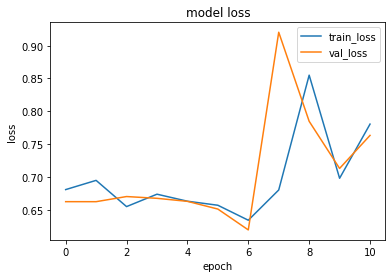

1it [00:00, 12865.96it/s]


prediction for video armflapping_1.mov is [[0.68533576]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.6914847]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.68755376]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.68461573]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.6844654]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.6844706]]


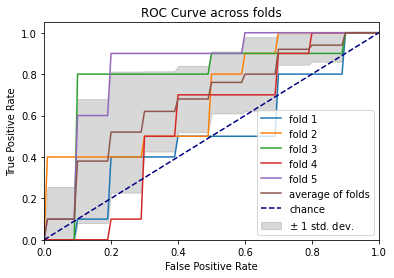

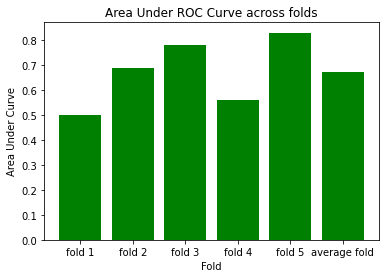

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6934 - accuracy: 0.5750 - precision: 0.5600 - recall: 0.7000 - val_loss: 0.6550 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6808 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.6644 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6147 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6961 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6561 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.6881 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 145ms/step 

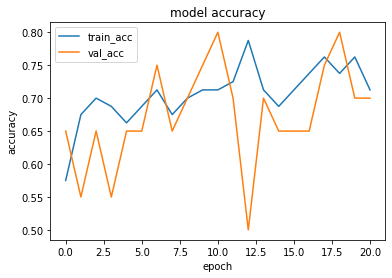

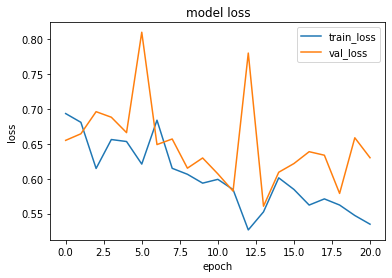

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.48392034]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.68788993]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.67696667]]


1it [00:00, 10407.70it/s]


prediction for video control_1.mov is [[0.35257584]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.3203078]]


1it [00:00, 11491.24it/s]


prediction for video control_3.mov is [[0.31258044]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 180ms/step - loss: 0.6787 - accuracy: 0.5250 - precision: 0.5417 - recall: 0.3250 - val_loss: 0.5834 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 169ms/step - loss: 0.7249 - accuracy: 0.6125 - precision: 0.6552 - recall: 0.4750 - val_loss: 0.6770 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6653 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.6687 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6662 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6614 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


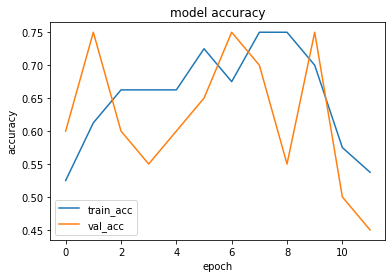

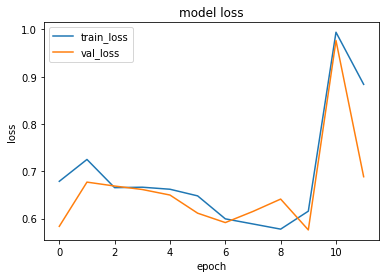

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.27904087]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.6448957]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.3040266]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.26674065]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.26184142]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.26180235]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7026 - accuracy: 0.4625 - precision: 0.4000 - recall: 0.1500 - val_loss: 0.6832 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6725 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6561 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6570 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6782 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6006 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 1.5393 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 5/75


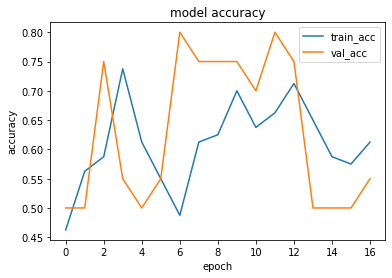

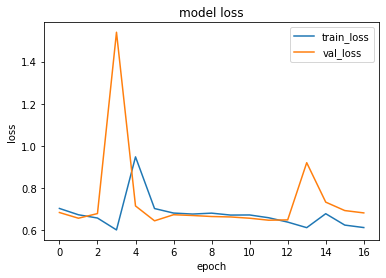

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.5182666]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.5214668]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.5373899]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.50930756]]


1it [00:00, 14217.98it/s]


prediction for video control_2.mov is [[0.50197095]]


1it [00:00, 17331.83it/s]


prediction for video control_3.mov is [[0.50161284]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 222ms/step - loss: 0.6914 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4250 - val_loss: 0.6696 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6563 - accuracy: 0.6500 - precision: 0.6250 - recall: 0.7500 - val_loss: 0.6516 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6460 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6787 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6494 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.6918 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


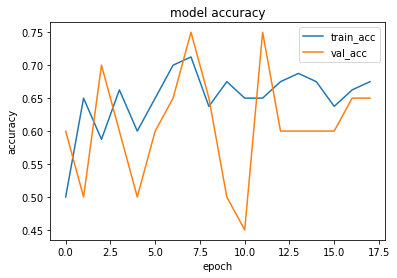

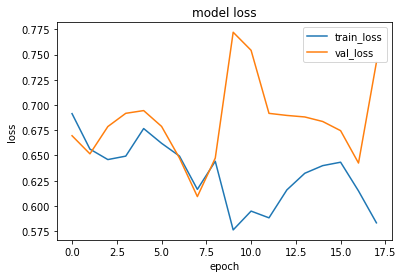

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.02659243]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.63175106]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.02744597]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.02574942]]


1it [00:00, 11848.32it/s]


prediction for video control_2.mov is [[0.02557519]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.0256092]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6932 - accuracy: 0.5125 - precision: 0.5116 - recall: 0.5500 - val_loss: 0.6594 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 169ms/step - loss: 0.7166 - accuracy: 0.6500 - precision: 0.6364 - recall: 0.7000 - val_loss: 0.9055 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 175ms/step - loss: 0.8179 - accuracy: 0.5125 - precision: 0.5714 - recall: 0.1000 - val_loss: 0.6791 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 179ms/step - loss: 0.6801 - accuracy: 0.5125 - precision: 0.5085 - recall: 0.7500 - val_loss: 0.6888 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3

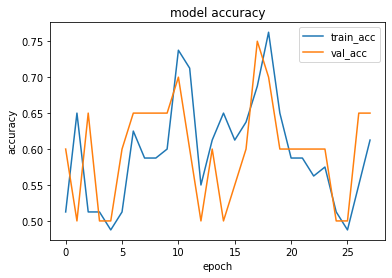

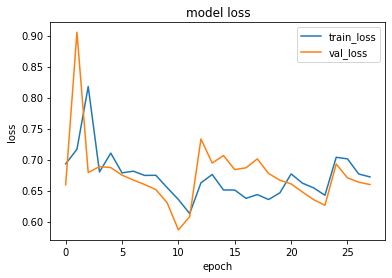

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.4825822]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.503147]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_2.mov is [[0.50016373]]


1it [00:00, 8848.74it/s]


prediction for video control_1.mov is [[0.48265168]]


1it [00:00, 12633.45it/s]


prediction for video control_2.mov is [[0.47600386]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.47641498]]


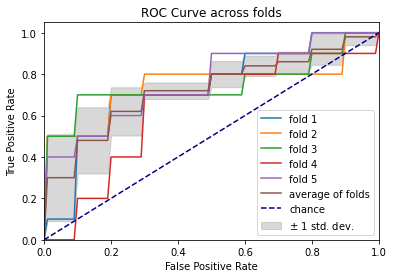

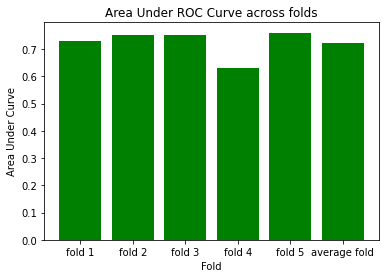

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 237ms/step - loss: 0.6838 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.7031 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6529 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.6784 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6486 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.6745 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6491 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6760 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 176ms/step 

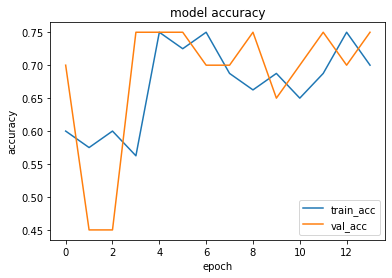

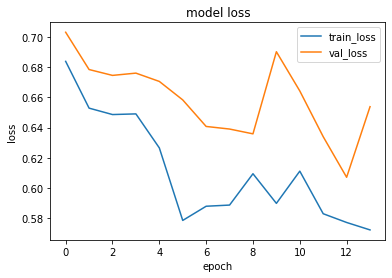

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.5452523]]


1it [00:00, 12520.31it/s]


prediction for video armflapping_3.mov is [[0.61550134]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.6661236]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.44149193]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.40136686]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.40516487]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 198ms/step - loss: 0.7049 - accuracy: 0.3750 - precision: 0.2500 - recall: 0.1250 - val_loss: 0.6747 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6860 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.6757 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6732 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.6563 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 1s 177ms/step - loss: 0.6784 - accuracy: 0.5750 - precision: 0.5517 - recall: 0.8000 - val_loss: 0.6279 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


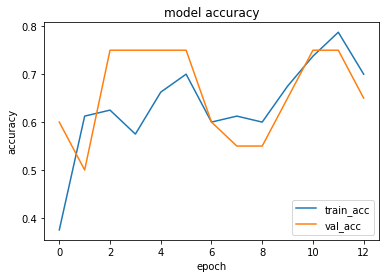

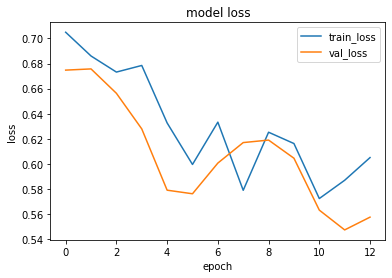

1it [00:00, 8322.03it/s]


prediction for video armflapping_1.mov is [[0.39402473]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.49056247]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.4897374]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.35410836]]


1it [00:00, 13842.59it/s]


prediction for video control_2.mov is [[0.3480507]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.34079337]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6899 - accuracy: 0.4625 - precision: 0.4769 - recall: 0.7750 - val_loss: 0.6593 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 176ms/step - loss: 0.6667 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6136 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 1s 189ms/step - loss: 0.6443 - accuracy: 0.6250 - precision: 0.6786 - recall: 0.4750 - val_loss: 0.6369 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6384 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6439 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75


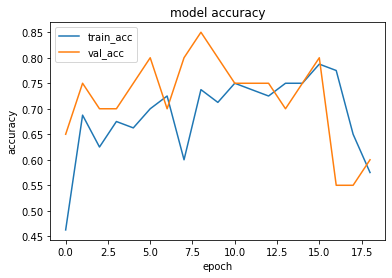

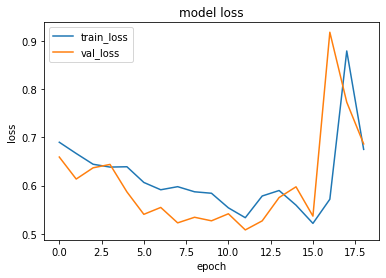

1it [00:00, 12052.60it/s]


prediction for video armflapping_1.mov is [[0.49854478]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.58293056]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.6877968]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.43828577]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.4103098]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.39552116]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 185ms/step - loss: 0.6882 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9000 - val_loss: 0.6524 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6553 - accuracy: 0.6500 - precision: 0.7500 - recall: 0.4500 - val_loss: 0.6318 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 175ms/step - loss: 0.6200 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6601 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6158 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.6398 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


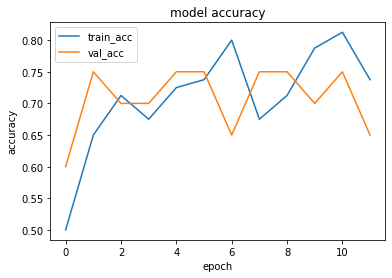

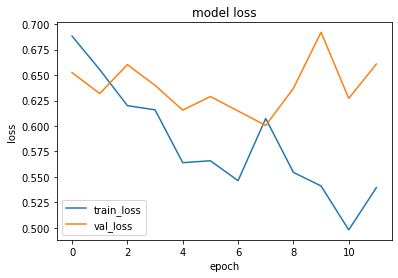

1it [00:00, 14563.56it/s]


prediction for video armflapping_1.mov is [[0.63200223]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.67822623]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6268666]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.58563757]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.55791175]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.53540456]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6860 - accuracy: 0.5625 - precision: 0.5862 - recall: 0.4250 - val_loss: 0.6853 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7580 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6680 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6584 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.6736 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6539 - accuracy: 0.5750 - precision: 0.8750 - recall: 0.1750 - val_loss: 0.6850 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75


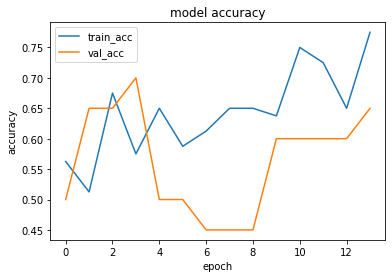

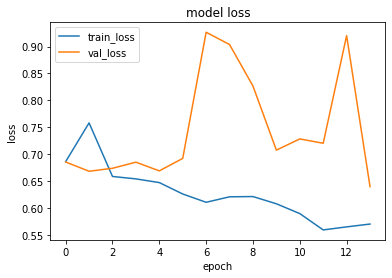

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.4846311]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.50070095]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.50969076]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.4360061]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.41068313]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.39596316]]


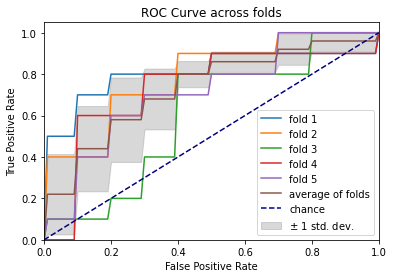

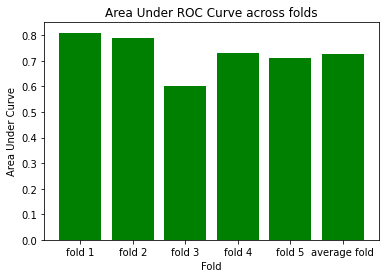

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 189ms/step - loss: 0.6829 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 0.7013 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 176ms/step - loss: 0.6709 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6000 - val_loss: 0.6334 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 180ms/step - loss: 0.6662 - accuracy: 0.6125 - precision: 0.5818 - recall: 0.8000 - val_loss: 0.6286 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6386 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.7428 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 169ms/step 

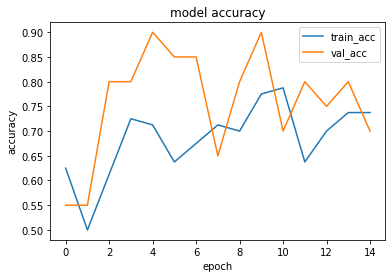

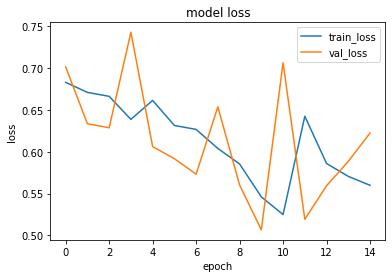

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.4170377]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.65530115]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.6149189]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.3399616]]


1it [00:00, 20460.02it/s]


prediction for video control_2.mov is [[0.32428965]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.3367659]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7013 - accuracy: 0.4875 - precision: 0.4857 - recall: 0.4250 - val_loss: 0.6832 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6609 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.6217 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6961 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.9889 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6746 - accuracy: 0.6500 - precision: 0.5882 - recall: 1.0000 - val_loss: 0.7263 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3

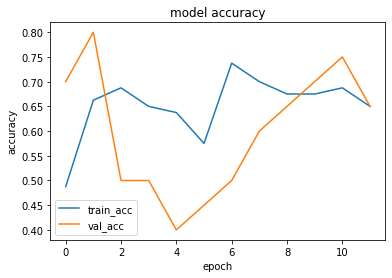

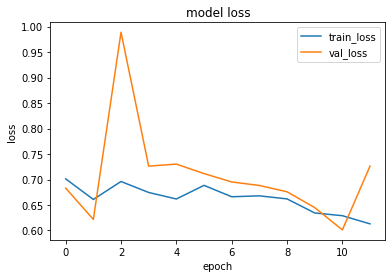

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.35205022]]


1it [00:00, 19152.07it/s]


prediction for video armflapping_3.mov is [[0.44264853]]


1it [00:00, 12945.38it/s]


prediction for video armflapping_2.mov is [[0.5031535]]


1it [00:00, 18808.54it/s]


prediction for video control_1.mov is [[0.2728608]]


1it [00:00, 7476.48it/s]


prediction for video control_2.mov is [[0.24576041]]


1it [00:00, 20763.88it/s]


prediction for video control_3.mov is [[0.31982344]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6832 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6000 - val_loss: 0.7554 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 1.0233 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.7210 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6473 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.7362 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6469 - accuracy: 0.6125 - precision: 0.8462 - recall: 0.2750 - val_loss: 0.7395 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 5/75


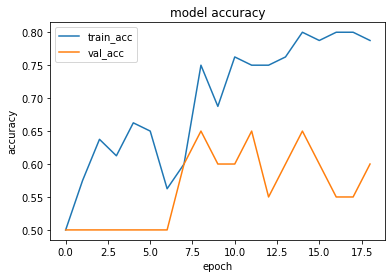

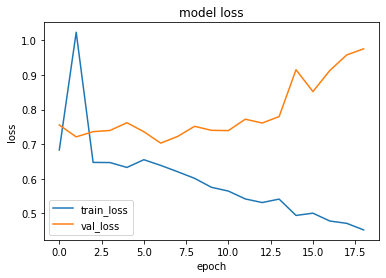

1it [00:00, 19239.93it/s]


prediction for video armflapping_1.mov is [[0.5324329]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.67987853]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.7358819]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.4117986]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.33847478]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.31062943]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7024 - accuracy: 0.5375 - precision: 0.5405 - recall: 0.5000 - val_loss: 0.6727 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6688 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.6514 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6711 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6419 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6744 - accuracy: 0.5875 - precision: 0.5854 - recall: 0.6000 - val_loss: 0.6500 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


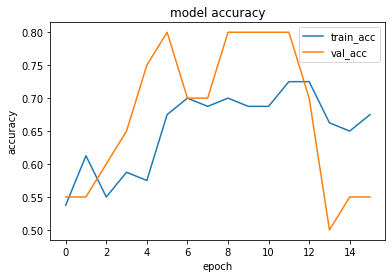

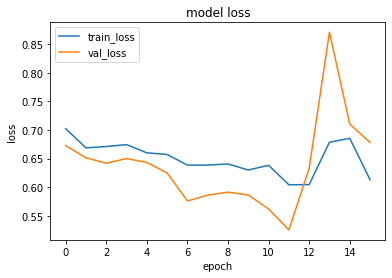

1it [00:00, 12520.31it/s]


prediction for video armflapping_1.mov is [[0.4543549]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.448008]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.4575995]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.4550417]]


1it [00:00, 12228.29it/s]


prediction for video control_2.mov is [[0.45565072]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.45578903]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7091 - accuracy: 0.4625 - precision: 0.4706 - recall: 0.6000 - val_loss: 0.6971 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6849 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6462 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6897 - accuracy: 0.5750 - precision: 0.6500 - recall: 0.3250 - val_loss: 0.6344 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6470 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5974 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75


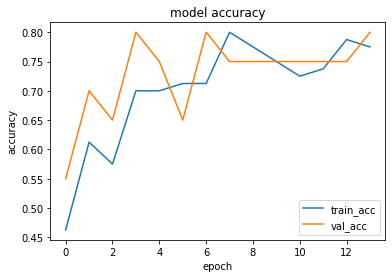

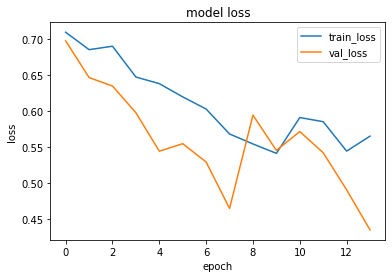

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.3426078]]


1it [00:00, 8112.77it/s]


prediction for video armflapping_3.mov is [[0.6125324]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6763468]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.19027507]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.17137402]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.1643573]]


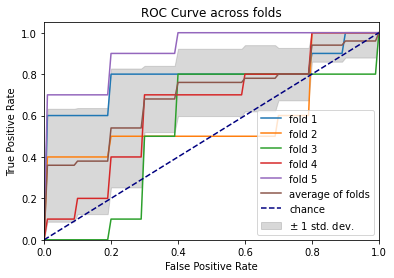

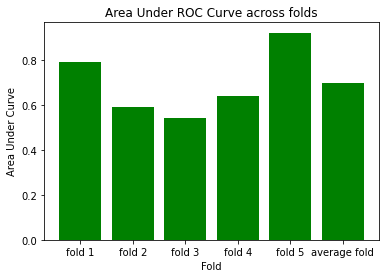

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 220ms/step - loss: 0.7021 - accuracy: 0.4625 - precision: 0.4717 - recall: 0.6250 - val_loss: 0.6836 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6835 - accuracy: 0.5375 - precision: 0.5882 - recall: 0.2500 - val_loss: 0.6606 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6489 - accuracy: 0.6125 - precision: 0.5652 - recall: 0.9750 - val_loss: 0.6785 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7226 - accuracy: 0.5375 - precision: 0.5238 - recall: 0.8250 - val_loss: 0.6399 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 146ms/step 

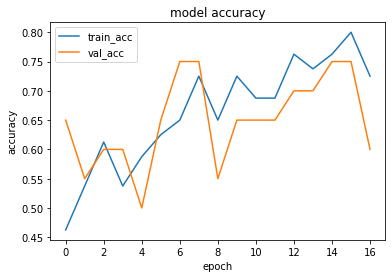

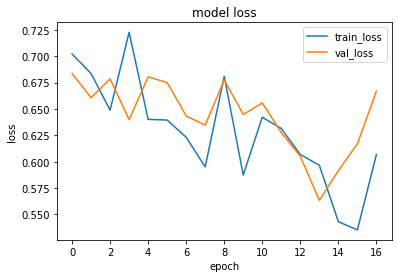

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.45173377]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.44858867]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.27882686]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.3749864]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.3549556]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.28774774]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6862 - accuracy: 0.6000 - precision: 0.5690 - recall: 0.8250 - val_loss: 0.6631 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6700 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.5775 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6743 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.5976 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6474 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 0.5862 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epo

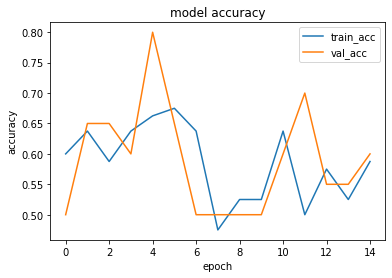

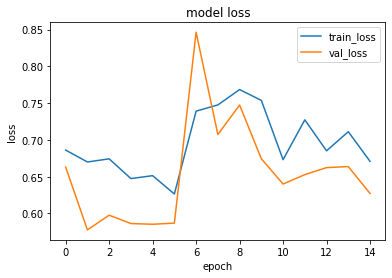

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5430424]]


1it [00:00, 8338.58it/s]


prediction for video armflapping_3.mov is [[0.60677594]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.5561452]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.5410278]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.54117465]]


1it [00:00, 10866.07it/s]


prediction for video control_3.mov is [[0.5412989]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6857 - accuracy: 0.4875 - precision: 0.4889 - recall: 0.5500 - val_loss: 0.6475 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7829 - accuracy: 0.6375 - precision: 0.7200 - recall: 0.4500 - val_loss: 0.6846 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6305 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.7212 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6529 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.7060 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 5/75
3

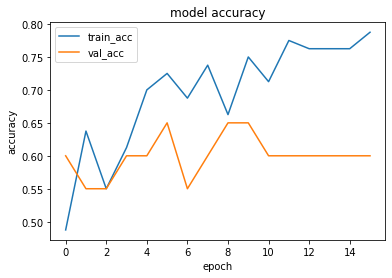

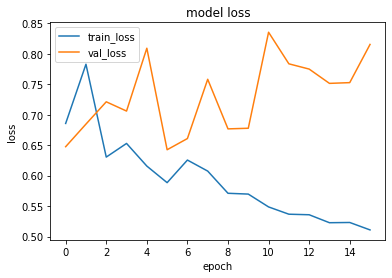

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5743741]]


1it [00:00, 17623.13it/s]


prediction for video armflapping_3.mov is [[0.6572648]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.74375415]]


1it [00:00, 3457.79it/s]


prediction for video control_1.mov is [[0.35841954]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.3136683]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.28222808]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6951 - accuracy: 0.5125 - precision: 0.5072 - recall: 0.8750 - val_loss: 0.6813 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6747 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1500 - val_loss: 0.6916 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6639 - accuracy: 0.5500 - precision: 0.5357 - recall: 0.7500 - val_loss: 0.6878 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6347 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6611 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epo

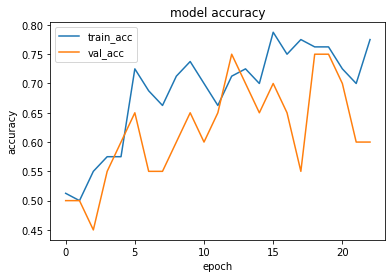

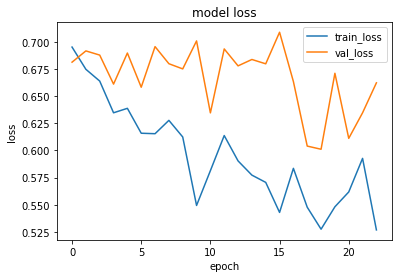

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.30935517]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.44531998]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.38168526]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.28526622]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.28152883]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.27754873]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 234ms/step - loss: 0.7155 - accuracy: 0.5125 - precision: 1.0000 - recall: 0.0250 - val_loss: 0.6869 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6841 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6672 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6544 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.7466 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6619 - accuracy: 0.6000 - precision: 0.5741 - recall: 0.7750 - val_loss: 0.6237 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


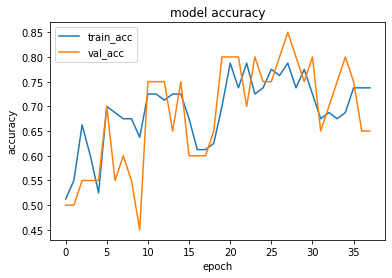

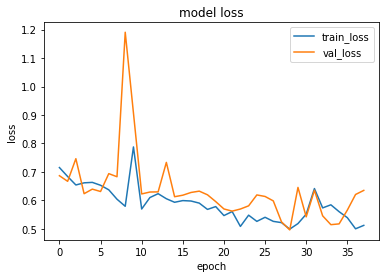

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.535964]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.73473895]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.685125]]


1it [00:00, 14563.56it/s]


prediction for video control_1.mov is [[0.10007632]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.09571332]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.10299808]]


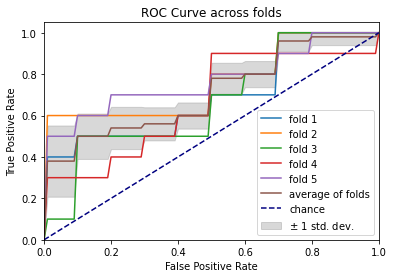

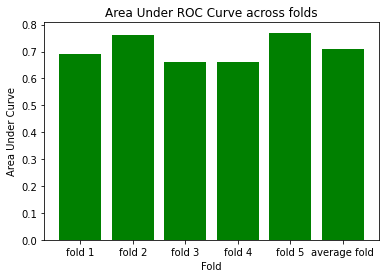

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6836 - accuracy: 0.5500 - precision: 0.5370 - recall: 0.7250 - val_loss: 0.6677 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6631 - accuracy: 0.6375 - precision: 0.6410 - recall: 0.6250 - val_loss: 0.6901 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6293 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6431 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6086 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6077 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 169ms/step 

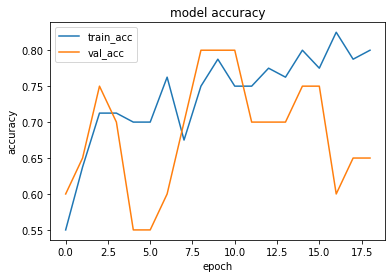

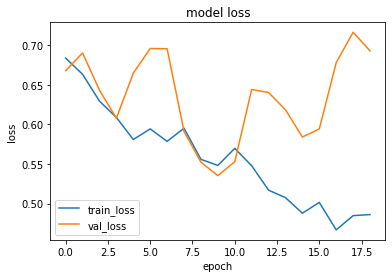

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.2101998]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.6300461]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.60262233]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.17034289]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.15903217]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.15851417]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7025 - accuracy: 0.5125 - precision: 0.5385 - recall: 0.1750 - val_loss: 0.7061 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6746 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6900 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6470 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6890 - val_accuracy: 0.4500 - val_precision: 0.3333 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6411 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.6278 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


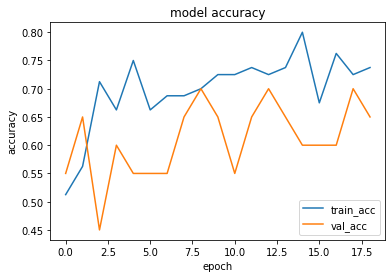

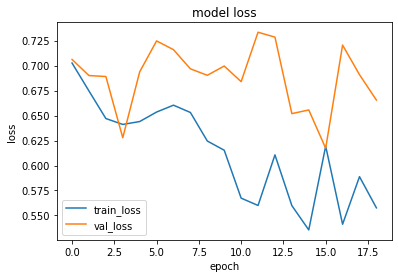

1it [00:00, 15477.14it/s]


prediction for video armflapping_1.mov is [[0.5111367]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.6268966]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.5917569]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.43717253]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.41565037]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.40185767]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6998 - accuracy: 0.4125 - precision: 0.4386 - recall: 0.6250 - val_loss: 0.6788 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6786 - accuracy: 0.5125 - precision: 0.5077 - recall: 0.8250 - val_loss: 0.6428 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6720 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6042 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6323 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.6860 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75


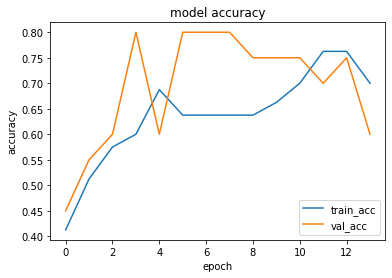

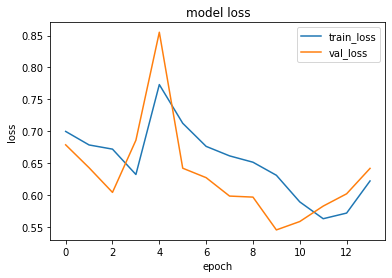

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.6616268]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.48606932]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5929232]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.61490446]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.5500121]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.5735236]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6972 - accuracy: 0.4500 - precision: 0.4444 - recall: 0.4000 - val_loss: 0.6562 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6758 - accuracy: 0.5250 - precision: 0.5139 - recall: 0.9250 - val_loss: 0.6341 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6606 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.5954 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6400 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.7950 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75
3

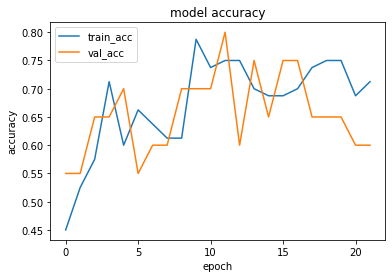

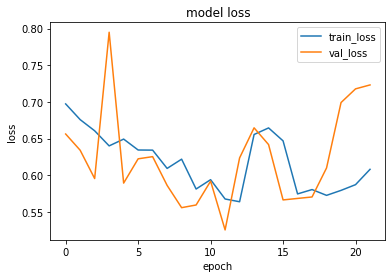

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.20412832]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.22459644]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.24863431]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.18733186]]


1it [00:00, 11618.57it/s]


prediction for video control_2.mov is [[0.18254247]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.1789875]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6998 - accuracy: 0.3875 - precision: 0.3043 - recall: 0.1750 - val_loss: 0.6919 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6846 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6783 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6517 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.7358 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7191 - accuracy: 0.5875 - precision: 0.5745 - recall: 0.6750 - val_loss: 0.6554 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75
3

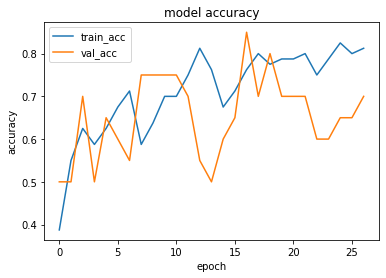

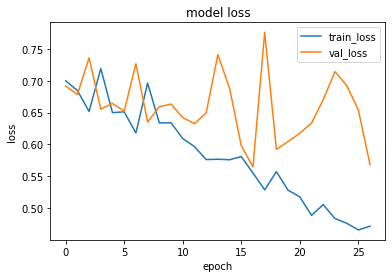

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.5007167]]


1it [00:00, 8112.77it/s]


prediction for video armflapping_3.mov is [[0.63312197]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.6809909]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.37231553]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.3209067]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.29196537]]


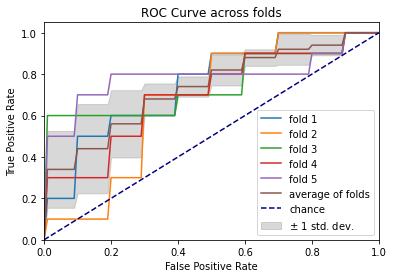

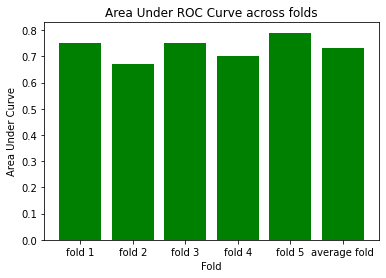

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6956 - accuracy: 0.3750 - precision: 0.3333 - recall: 0.2500 - val_loss: 0.6812 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6371 - accuracy: 0.6250 - precision: 0.5714 - recall: 1.0000 - val_loss: 1.2592 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7537 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.6651 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 149ms/step - loss: 0.6720 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6752 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 149

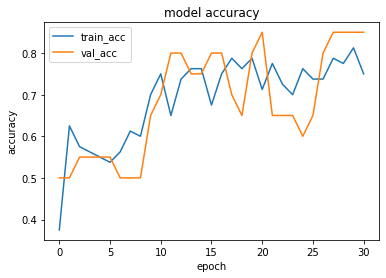

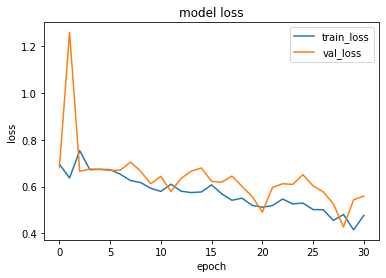

1it [00:00, 8256.50it/s]


prediction for video armflapping_1.mov is [[0.48049906]]


1it [00:00, 8473.34it/s]


prediction for video armflapping_3.mov is [[0.72319424]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_2.mov is [[0.6560709]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.3682425]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.3412031]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.31261158]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7079 - accuracy: 0.3625 - precision: 0.4035 - recall: 0.5750 - val_loss: 0.6760 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6686 - accuracy: 0.5750 - precision: 0.6667 - recall: 0.3000 - val_loss: 0.6421 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6605 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6973 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6433 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6595 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


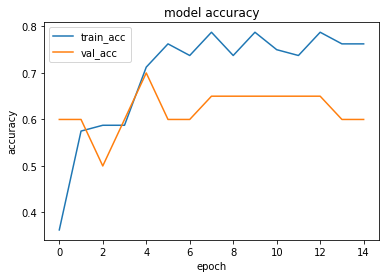

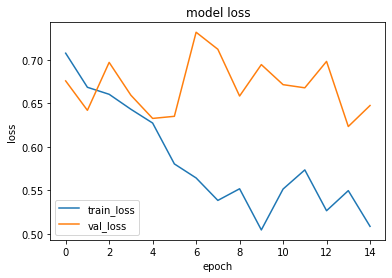

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.47872108]]


1it [00:00, 7869.24it/s]


prediction for video armflapping_3.mov is [[0.70384187]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.6776258]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.19156256]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.17909142]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.18905178]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7060 - accuracy: 0.4750 - precision: 0.4167 - recall: 0.1250 - val_loss: 0.6863 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6837 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6752 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6699 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6487 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6646 - accuracy: 0.6125 - precision: 0.7647 - recall: 0.3250 - val_loss: 0.6946 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 5/75


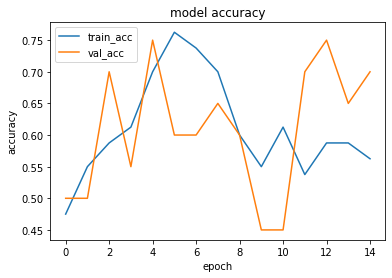

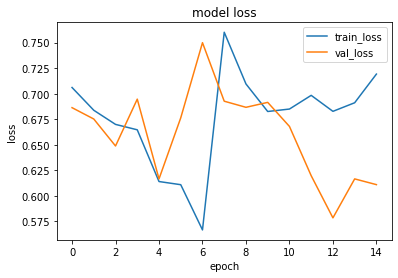

1it [00:00, 17549.39it/s]


prediction for video armflapping_1.mov is [[0.38341942]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.36290768]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.387504]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.38287932]]


1it [00:00, 9642.08it/s]


prediction for video control_2.mov is [[0.3827656]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.38276386]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6840 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.6460 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 198ms/step - loss: 0.6288 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.6142 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.8814 - accuracy: 0.5750 - precision: 0.5556 - recall: 0.7500 - val_loss: 0.6184 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6445 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.6514 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


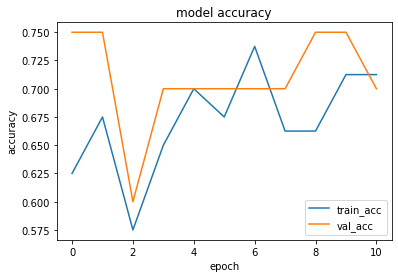

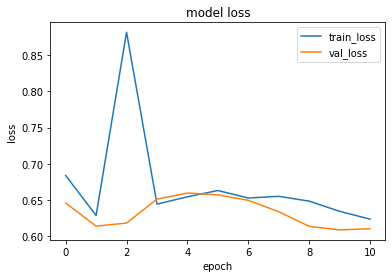

1it [00:00, 17549.39it/s]


prediction for video armflapping_1.mov is [[0.52178013]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.5467576]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.55012995]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.5038461]]


1it [00:00, 13662.23it/s]


prediction for video control_2.mov is [[0.49666932]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.49432027]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6957 - accuracy: 0.4500 - precision: 0.4615 - recall: 0.6000 - val_loss: 0.6472 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6720 - accuracy: 0.5750 - precision: 0.5833 - recall: 0.5250 - val_loss: 0.6163 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 1s 204ms/step - loss: 0.6913 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6181 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6469 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.6471 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75


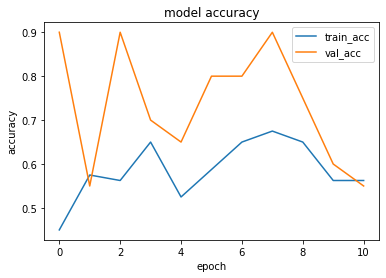

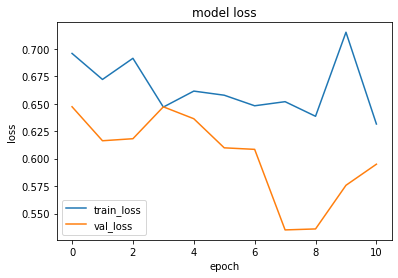

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5227832]]


1it [00:00, 16578.28it/s]


prediction for video armflapping_3.mov is [[0.54351676]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.5361092]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.511981]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.5105319]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.5112626]]


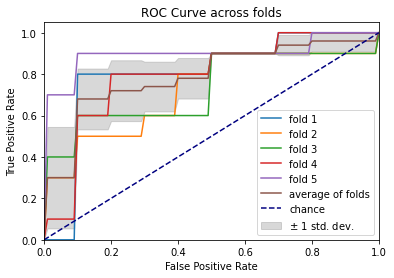

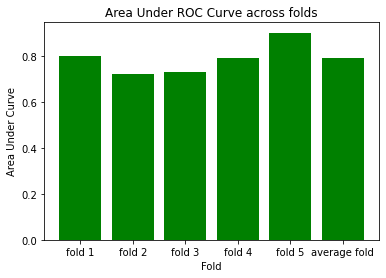

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7180 - accuracy: 0.5250 - precision: 0.6000 - recall: 0.1500 - val_loss: 0.6479 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6818 - accuracy: 0.6000 - precision: 0.6429 - recall: 0.4500 - val_loss: 0.6492 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6798 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.6347 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6680 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.6067 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 170ms/step 

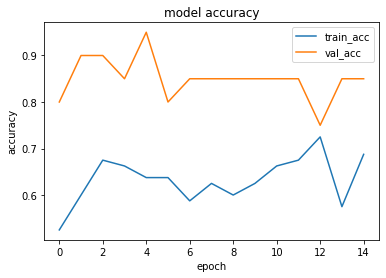

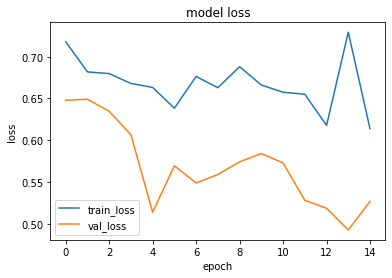

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.44556934]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.48177394]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.49303806]]


1it [00:00, 19239.93it/s]


prediction for video control_1.mov is [[0.36336058]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.34198955]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.34132078]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6819 - accuracy: 0.6375 - precision: 0.6341 - recall: 0.6500 - val_loss: 0.7926 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6970 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.7739 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5977 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.7210 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6171 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.6994 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75


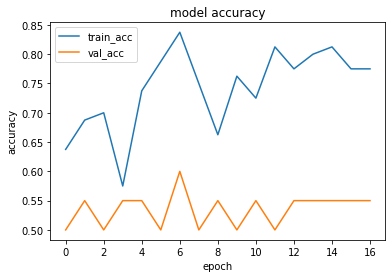

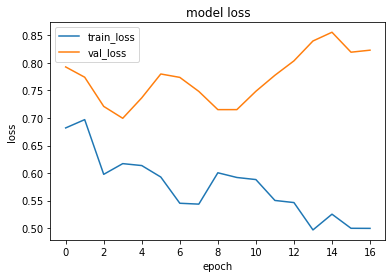

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.4704217]]


1it [00:00, 12372.58it/s]


prediction for video armflapping_3.mov is [[0.55042595]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_2.mov is [[0.63464576]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.4938706]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.38401228]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.500674]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7081 - accuracy: 0.5125 - precision: 0.5333 - recall: 0.2000 - val_loss: 0.6885 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6768 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6997 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6439 - accuracy: 0.6125 - precision: 0.5882 - recall: 0.7500 - val_loss: 0.6879 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6419 - accuracy: 0.7375 - precision: 0.8065 - recall: 0.6250 - val_loss: 0.6764 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/

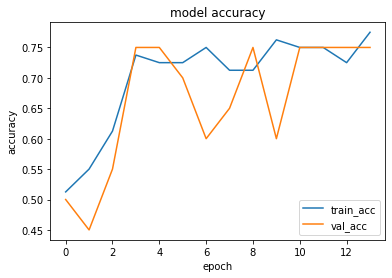

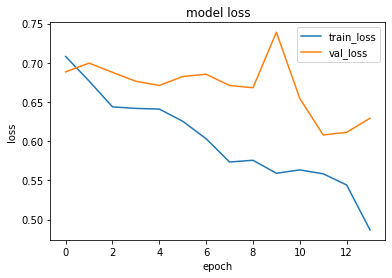

1it [00:00, 11748.75it/s]


prediction for video armflapping_1.mov is [[0.2730184]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_3.mov is [[0.6920561]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.6990535]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.21922675]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.20751512]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.21617445]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6939 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8500 - val_loss: 0.6894 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 183ms/step - loss: 0.6631 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.6700 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6459 - accuracy: 0.7000 - precision: 0.8636 - recall: 0.4750 - val_loss: 0.6596 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7057 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.6968 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 5/75


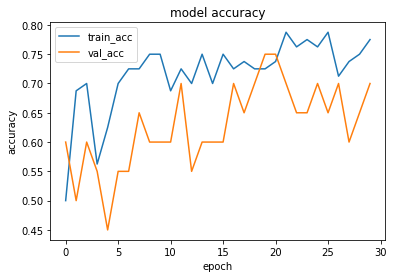

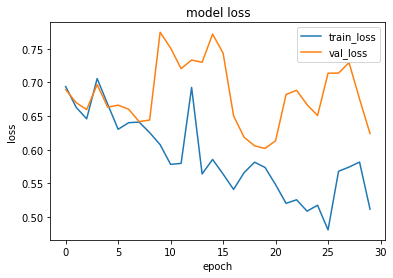

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.3604914]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5036412]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.5350705]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.2739135]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.24792692]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.2394174]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 171ms/step - loss: 0.6947 - accuracy: 0.4750 - precision: 0.4583 - recall: 0.2750 - val_loss: 0.6327 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6585 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5943 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6437 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.5173 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 198ms/step - loss: 0.6325 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.5597 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75
3

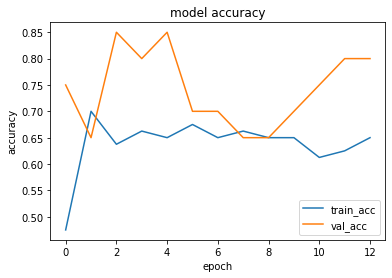

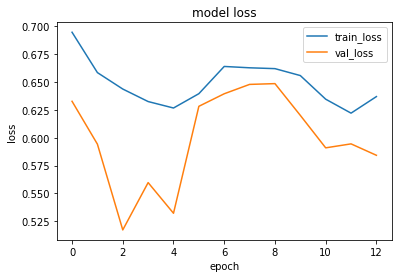

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.3719923]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_3.mov is [[0.47521833]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.5078548]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.29771587]]


1it [00:00, 17476.27it/s]


prediction for video control_2.mov is [[0.3055334]]


1it [00:00, 12192.74it/s]


prediction for video control_3.mov is [[0.32876164]]


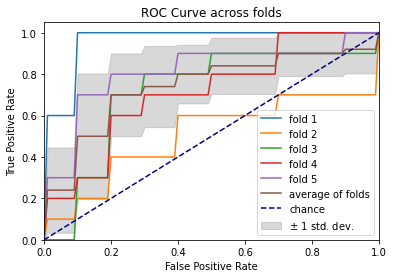

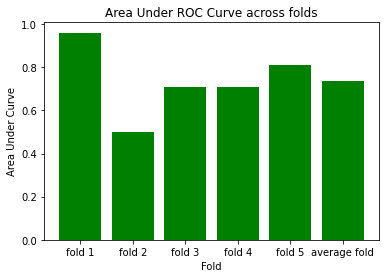

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6780 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.8271 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6775 - accuracy: 0.5875 - precision: 0.5897 - recall: 0.5750 - val_loss: 0.6337 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6544 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6316 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6438 - accuracy: 0.5750 - precision: 0.5455 - recall: 0.9000 - val_loss: 0.6418 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 154

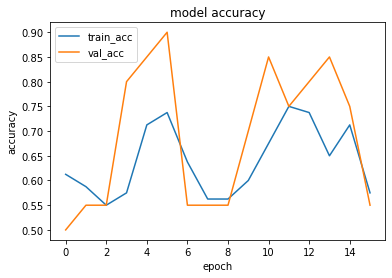

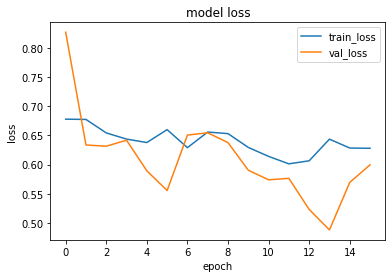

1it [00:00, 17189.77it/s]


prediction for video armflapping_1.mov is [[0.55895203]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.59306574]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.590247]]


1it [00:00, 12228.29it/s]


prediction for video control_1.mov is [[0.5335964]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.52277225]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.5185785]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6839 - accuracy: 0.5875 - precision: 0.6207 - recall: 0.4500 - val_loss: 0.6808 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6498 - accuracy: 0.5875 - precision: 0.5660 - recall: 0.7500 - val_loss: 0.7139 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6230 - accuracy: 0.6250 - precision: 0.7500 - recall: 0.3750 - val_loss: 0.7043 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6819 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6287 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3

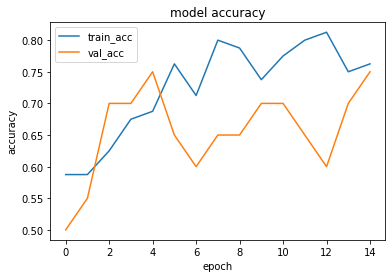

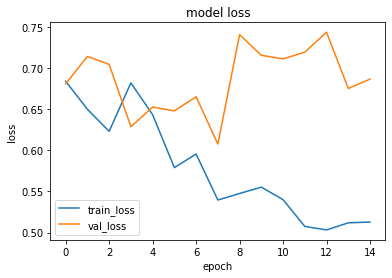

1it [00:00, 9510.89it/s]


prediction for video armflapping_1.mov is [[0.3575085]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_3.mov is [[0.46228328]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.59934765]]


1it [00:00, 12192.74it/s]


prediction for video control_1.mov is [[0.2942522]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.27443147]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.26536843]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 135ms/step - loss: 0.6736 - accuracy: 0.5750 - precision: 0.6000 - recall: 0.4500 - val_loss: 1.1255 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7684 - accuracy: 0.6625 - precision: 0.6032 - recall: 0.9500 - val_loss: 0.7055 - val_accuracy: 0.4000 - val_precision: 0.3750 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6433 - accuracy: 0.6000 - precision: 0.8333 - recall: 0.2500 - val_loss: 0.8114 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.7220 - accuracy: 0.6625 - precision: 0.8824 - recall: 0.3750 - val_loss: 0.7286 - val_accuracy: 0.4000 - val_precision: 0.3750 - val_recall: 0.3000
Epoch 5/75


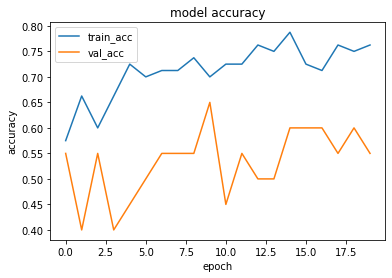

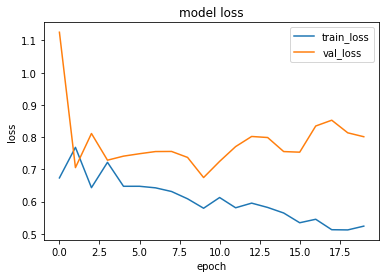

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.45672446]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.5428654]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.5644902]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.37391752]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.346574]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.33416277]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6897 - accuracy: 0.4875 - precision: 0.4894 - recall: 0.5750 - val_loss: 0.7202 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6858 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.6450 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6660 - accuracy: 0.5500 - precision: 0.5303 - recall: 0.8750 - val_loss: 0.6547 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6729 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.6556 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epo

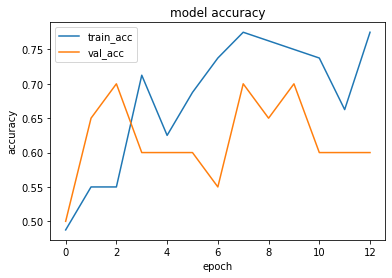

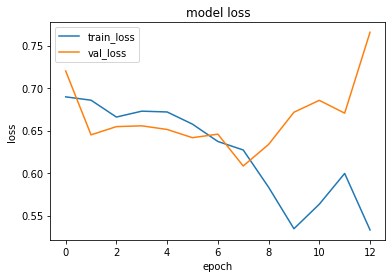

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.49267986]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.6062814]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5635014]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.40328285]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.38228643]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.3372627]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7177 - accuracy: 0.4500 - precision: 0.3750 - recall: 0.1500 - val_loss: 0.6884 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7005 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6772 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6729 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6861 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6767 - accuracy: 0.5125 - precision: 0.5200 - recall: 0.3250 - val_loss: 0.6848 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75
3

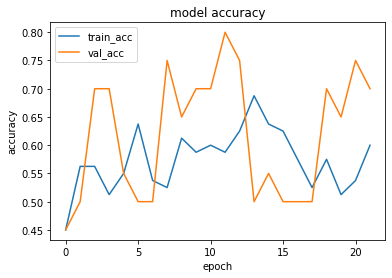

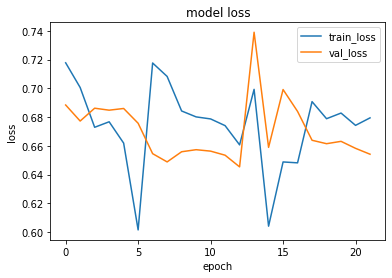

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.47594684]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.4879397]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.48937827]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.47126457]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.4683732]]


1it [00:00, 14027.77it/s]


prediction for video control_3.mov is [[0.4684113]]


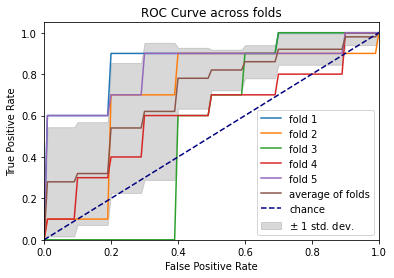

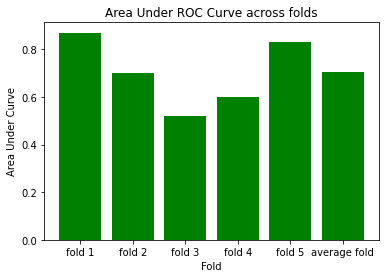

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6972 - accuracy: 0.5250 - precision: 0.5192 - recall: 0.6750 - val_loss: 0.6798 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6690 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6631 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6944 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6515 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6454 - accuracy: 0.7125 - precision: 0.8400 - recall: 0.5250 - val_loss: 0.6441 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 5/75
3/3 [==============================] - 0s 148ms/step 

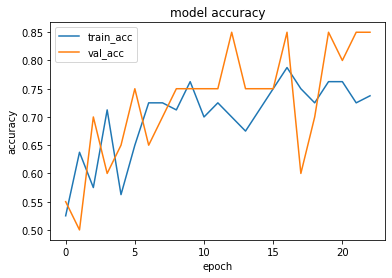

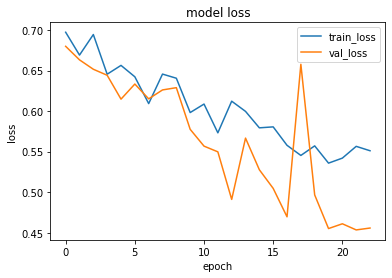

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.4211188]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.53038013]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.59602314]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.35280204]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.33336902]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.33093527]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 192ms/step - loss: 0.7077 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6716 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6836 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6673 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 1s 192ms/step - loss: 0.6757 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6389 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6654 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.5511 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75


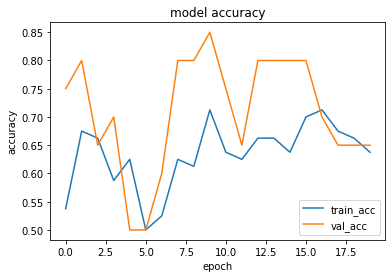

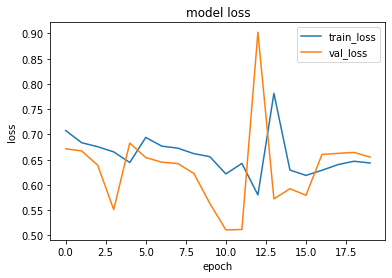

1it [00:00, 17331.83it/s]


prediction for video armflapping_1.mov is [[0.49527577]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.60058624]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5944148]]


1it [00:00, 15827.56it/s]


prediction for video control_1.mov is [[0.35242814]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.33104032]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.32909465]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7093 - accuracy: 0.4750 - precision: 0.4615 - recall: 0.3000 - val_loss: 0.6687 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6741 - accuracy: 0.5625 - precision: 0.5439 - recall: 0.7750 - val_loss: 0.6352 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6601 - accuracy: 0.5375 - precision: 0.5263 - recall: 0.7500 - val_loss: 0.6465 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6801 - accuracy: 0.5125 - precision: 0.5067 - recall: 0.9500 - val_loss: 0.6605 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75


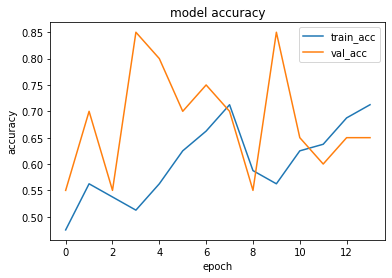

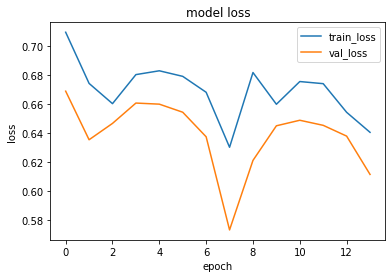

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.42038414]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.4667725]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.45808053]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.40293345]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.39605814]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.3928752]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6816 - accuracy: 0.5125 - precision: 0.5116 - recall: 0.5500 - val_loss: 1.1094 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 167ms/step - loss: 0.8096 - accuracy: 0.5125 - precision: 0.5172 - recall: 0.3750 - val_loss: 0.6783 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6628 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6713 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6390 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.7006 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoc

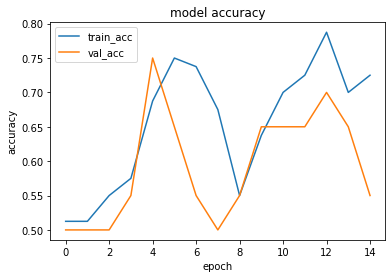

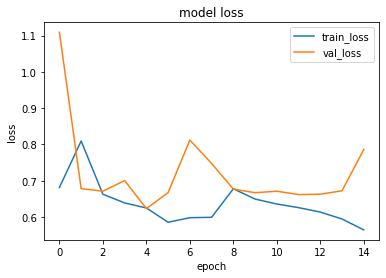

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.48548764]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5735251]]


1it [00:00, 17331.83it/s]


prediction for video armflapping_2.mov is [[0.60532206]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.38958913]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.32671535]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.41196397]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.7086 - accuracy: 0.3875 - precision: 0.4151 - recall: 0.5500 - val_loss: 0.6894 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6722 - accuracy: 0.5750 - precision: 0.6500 - recall: 0.3250 - val_loss: 0.6734 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6627 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.7080 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6227 - accuracy: 0.7750 - precision: 0.7895 - recall: 0.7500 - val_loss: 0.6972 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


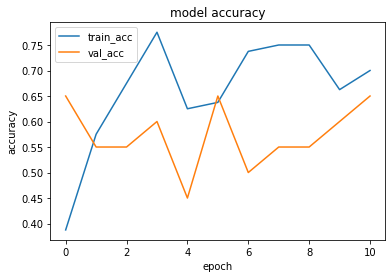

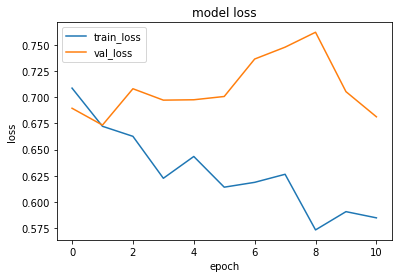

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.43138057]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.45804286]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_2.mov is [[0.44985765]]


1it [00:00, 16448.25it/s]


prediction for video control_1.mov is [[0.39729175]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.37453333]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.375758]]


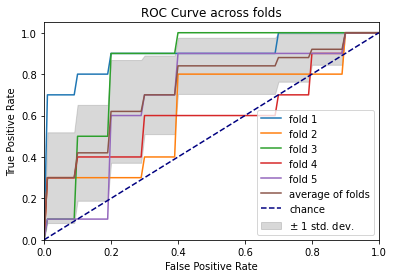

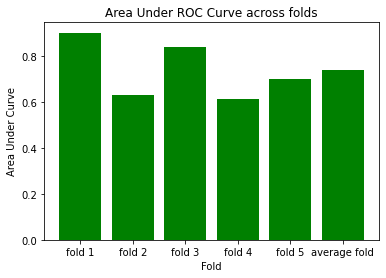

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6912 - accuracy: 0.4000 - precision: 0.3333 - recall: 0.2000 - val_loss: 0.7318 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7927 - accuracy: 0.5875 - precision: 0.5686 - recall: 0.7250 - val_loss: 0.6482 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6303 - accuracy: 0.6375 - precision: 0.5797 - recall: 1.0000 - val_loss: 0.6562 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6574 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6768 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 148ms/step 

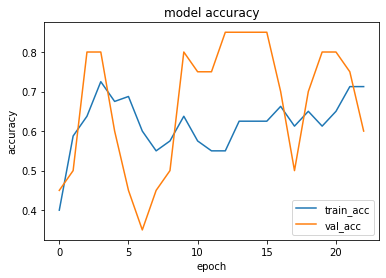

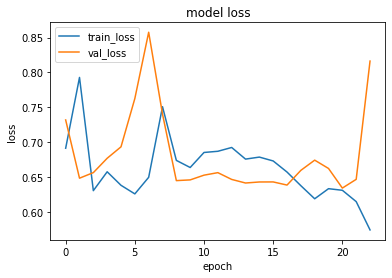

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.58042866]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.5691677]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.6269833]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.5397469]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.502399]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.43563643]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6908 - accuracy: 0.5625 - precision: 0.5641 - recall: 0.5500 - val_loss: 0.6158 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7085 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.5933 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6485 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6413 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6806 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6383 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75


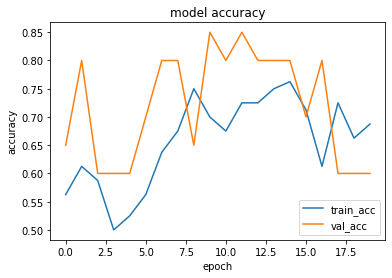

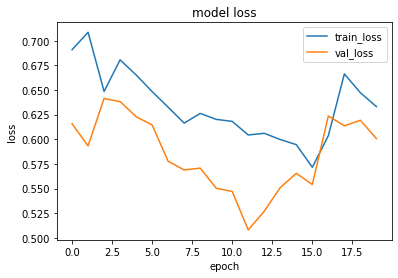

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.41486177]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.50338835]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.43877816]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.4036322]]


1it [00:00, 17476.27it/s]


prediction for video control_2.mov is [[0.40780583]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.40679684]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6891 - accuracy: 0.4125 - precision: 0.3793 - recall: 0.2750 - val_loss: 0.6857 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6479 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6584 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 1s 212ms/step - loss: 0.6507 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.6407 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.9841 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.6417 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 5/75


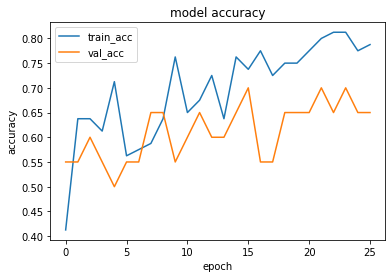

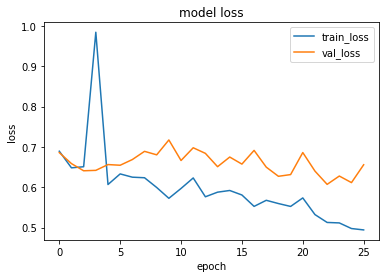

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.58417046]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.76866186]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.7714168]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.27003825]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.2561918]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.2501657]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6996 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.6819 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 241ms/step - loss: 0.6483 - accuracy: 0.6500 - precision: 0.7308 - recall: 0.4750 - val_loss: 0.8713 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7332 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6974 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6544 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.7338 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoc

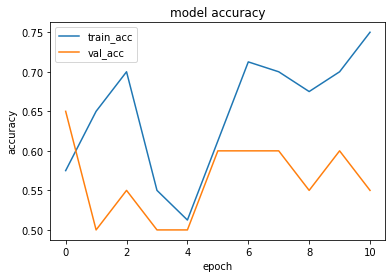

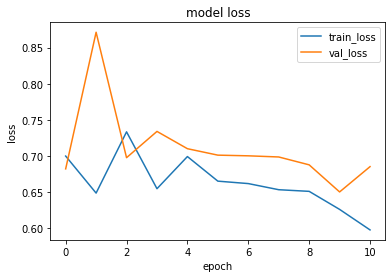

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.5633394]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.5824196]]


1it [00:00, 11618.57it/s]


prediction for video armflapping_2.mov is [[0.606767]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.52967525]]


1it [00:00, 17476.27it/s]


prediction for video control_2.mov is [[0.5171684]]


1it [00:00, 12710.01it/s]


prediction for video control_3.mov is [[0.5076344]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 195ms/step - loss: 0.6933 - accuracy: 0.4375 - precision: 0.4545 - recall: 0.6250 - val_loss: 0.6688 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6522 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6943 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5913 - accuracy: 0.7000 - precision: 0.6429 - recall: 0.9000 - val_loss: 0.7007 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6333 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.7049 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 5/75
3

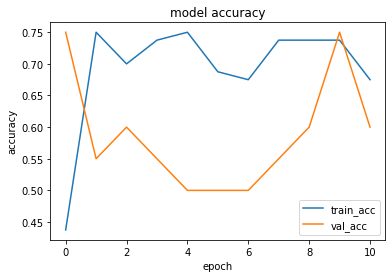

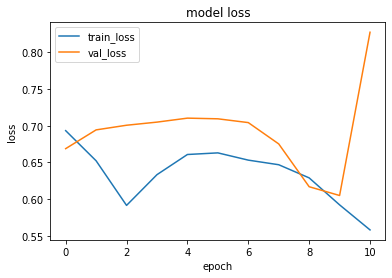

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.03607073]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.8004774]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.03961337]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.03448239]]


1it [00:00, 9822.73it/s]


prediction for video control_2.mov is [[0.03401625]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.03393334]]


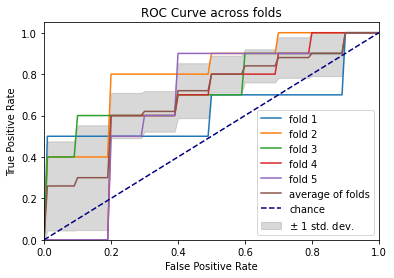

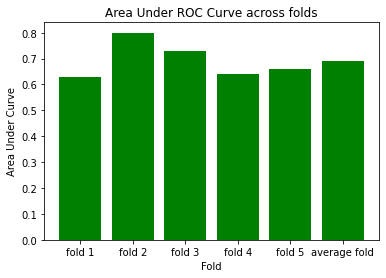

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 180ms/step - loss: 0.7098 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.6771 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6664 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6607 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6431 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6697 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6095 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.6537 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 149ms/step 

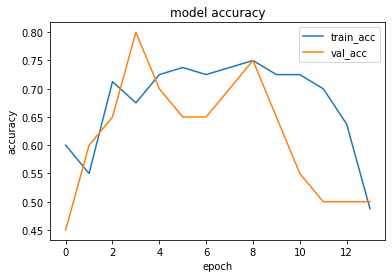

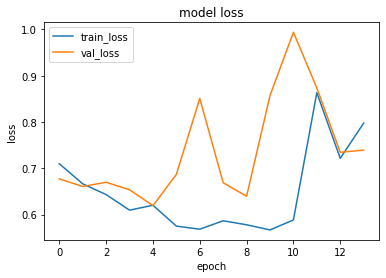

1it [00:00, 13934.56it/s]


prediction for video armflapping_1.mov is [[0.65351385]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.6399932]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6522953]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.6535139]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.65352213]]


1it [00:00, 12826.62it/s]


prediction for video control_3.mov is [[0.6535239]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6951 - accuracy: 0.3875 - precision: 0.4182 - recall: 0.5750 - val_loss: 0.6528 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6684 - accuracy: 0.6375 - precision: 0.7200 - recall: 0.4500 - val_loss: 0.5674 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6412 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.5837 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6077 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6102 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3

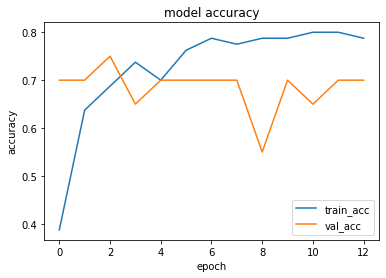

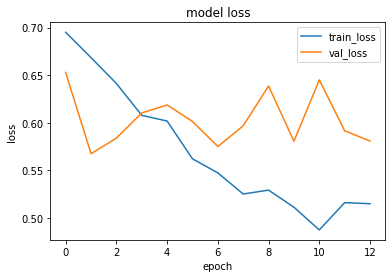

1it [00:00, 16384.00it/s]


prediction for video armflapping_1.mov is [[0.32481384]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.3772968]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.49659666]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.2818368]]


1it [00:00, 11125.47it/s]


prediction for video control_2.mov is [[0.25292444]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.25566483]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 176ms/step - loss: 0.7452 - accuracy: 0.5125 - precision: 0.5065 - recall: 0.9750 - val_loss: 0.6837 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6871 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.6762 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6786 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6627 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6592 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.6482 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


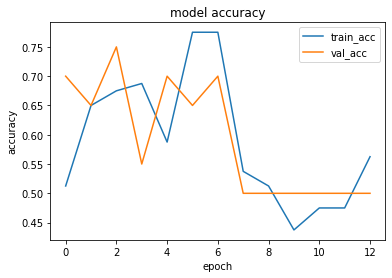

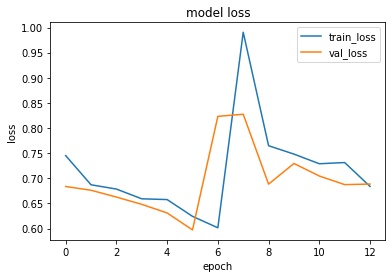

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.46085137]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.45553577]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.46168184]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.460303]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.4600965]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.46008426]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6926 - accuracy: 0.6250 - precision: 0.6000 - recall: 0.7500 - val_loss: 0.6581 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6737 - accuracy: 0.6125 - precision: 0.5957 - recall: 0.7000 - val_loss: 0.5690 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 1s 208ms/step - loss: 0.6591 - accuracy: 0.6375 - precision: 0.7391 - recall: 0.4250 - val_loss: 0.6176 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6416 - accuracy: 0.7000 - precision: 0.7857 - recall: 0.5500 - val_loss: 0.7061 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


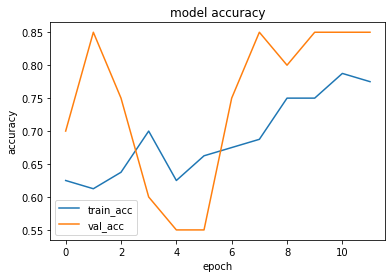

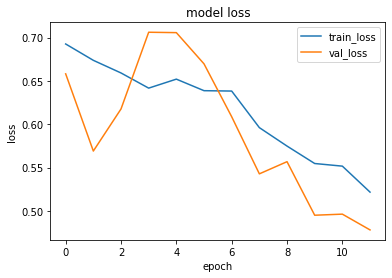

1it [00:00, 8867.45it/s]


prediction for video armflapping_1.mov is [[0.32929796]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.53292954]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_2.mov is [[0.6129057]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.2497293]]


1it [00:00, 13357.66it/s]


prediction for video control_2.mov is [[0.23193076]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.2338427]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6881 - accuracy: 0.5125 - precision: 0.5161 - recall: 0.4000 - val_loss: 0.7019 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6151 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 1.1690 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.8927 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6993 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6632 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.7011 - val_accuracy: 0.4000 - val_precision: 0.3333 - val_recall: 0.2000
Epoch 5/75
3

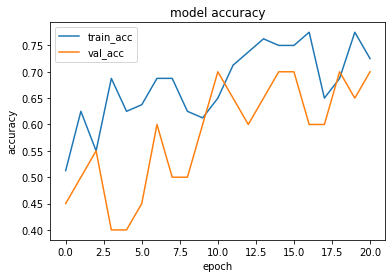

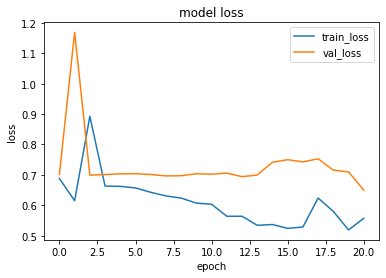

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.35663623]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5508258]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.6156378]]


1it [00:00, 16070.13it/s]


prediction for video control_1.mov is [[0.27874684]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.260435]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.25785324]]


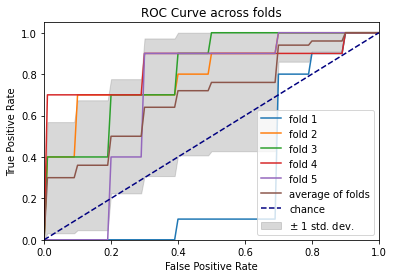

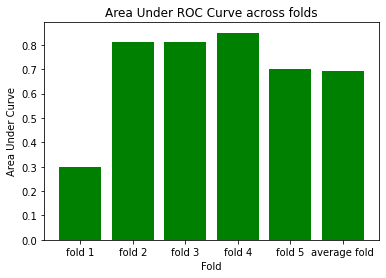

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7068 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.6962 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6690 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6534 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6746 - accuracy: 0.6250 - precision: 0.6786 - recall: 0.4750 - val_loss: 0.6524 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6223 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6355 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 149

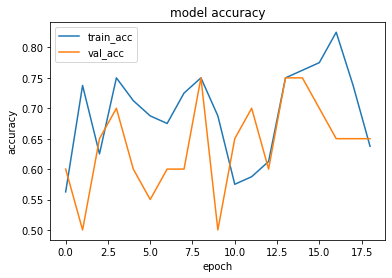

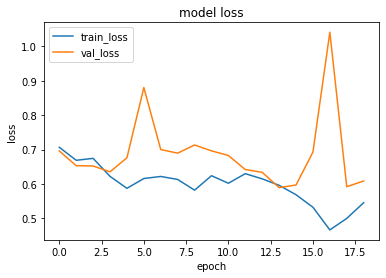

1it [00:00, 17549.39it/s]


prediction for video armflapping_1.mov is [[0.6369561]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.7314664]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6936935]]


1it [00:00, 12865.96it/s]


prediction for video control_1.mov is [[0.5696891]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.5287617]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.52304554]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 175ms/step - loss: 0.6878 - accuracy: 0.5500 - precision: 0.5417 - recall: 0.6500 - val_loss: 0.6620 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6550 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.6411 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 1s 171ms/step - loss: 0.6265 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.6828 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5989 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6003 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

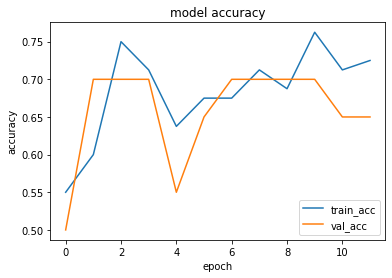

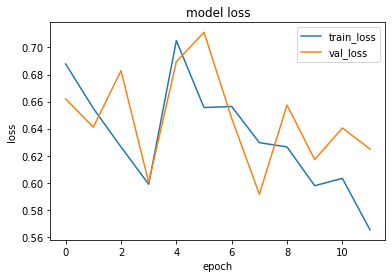

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.39198568]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.6130383]]


1it [00:00, 8612.53it/s]


prediction for video armflapping_2.mov is [[0.49792722]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.46341163]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.43894753]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.49404284]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6840 - accuracy: 0.6125 - precision: 0.6286 - recall: 0.5500 - val_loss: 0.6538 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6362 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6413 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6178 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.6663 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 206ms/step - loss: 0.6154 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.6106 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75


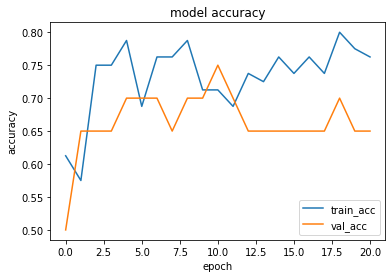

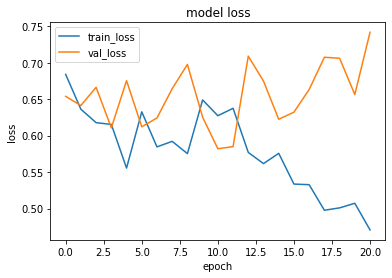

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.29793704]]


1it [00:00, 12520.31it/s]


prediction for video armflapping_3.mov is [[0.84160745]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_2.mov is [[0.8268178]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.22338545]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.21005616]]


1it [00:00, 11618.57it/s]


prediction for video control_3.mov is [[0.19088575]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6947 - accuracy: 0.4875 - precision: 0.4865 - recall: 0.4500 - val_loss: 0.6591 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7006 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6293 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6826 - accuracy: 0.6500 - precision: 0.8333 - recall: 0.3750 - val_loss: 0.6550 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6814 - accuracy: 0.5875 - precision: 0.7333 - recall: 0.2750 - val_loss: 0.6751 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


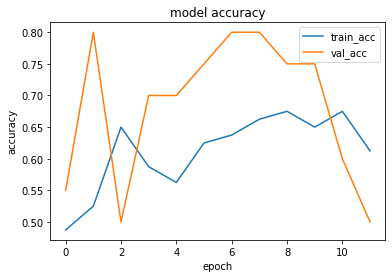

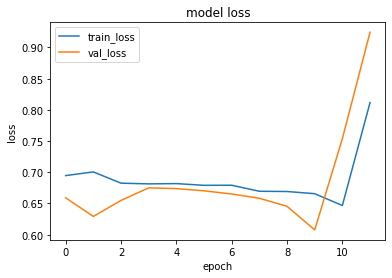

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.18455955]]


1it [00:00, 5817.34it/s]


prediction for video armflapping_3.mov is [[0.1922155]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.18662858]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.1836614]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.18347326]]


1it [00:00, 16320.25it/s]


prediction for video control_3.mov is [[0.18344522]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 164ms/step - loss: 0.6983 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.6718 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6657 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6633 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6716 - accuracy: 0.5875 - precision: 0.5479 - recall: 1.0000 - val_loss: 0.6438 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 192ms/step - loss: 0.6457 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.6578 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75


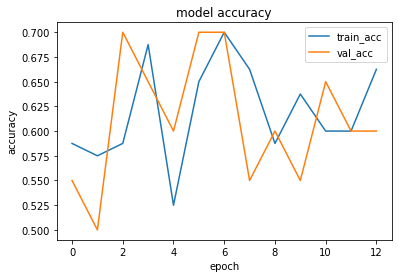

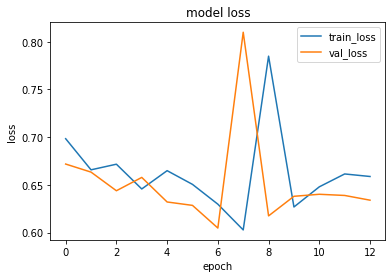

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.516669]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5436948]]


1it [00:00, 9425.40it/s]


prediction for video armflapping_2.mov is [[0.53106797]]


1it [00:00, 17260.51it/s]


prediction for video control_1.mov is [[0.51119554]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.5099695]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.5098169]]


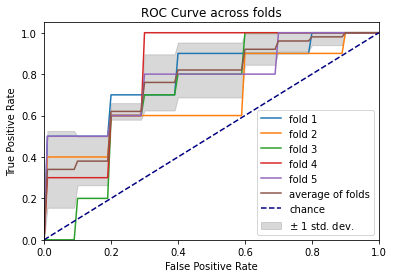

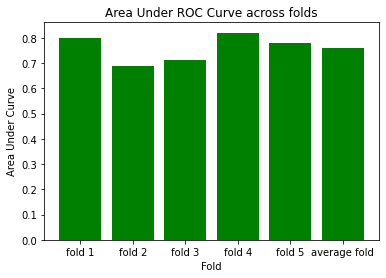

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6973 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.6889 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6925 - accuracy: 0.5250 - precision: 0.5217 - recall: 0.6000 - val_loss: 0.6783 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6511 - accuracy: 0.6875 - precision: 0.9412 - recall: 0.4000 - val_loss: 0.6387 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6326 - accuracy: 0.7000 - precision: 0.6429 - recall: 0.9000 - val_loss: 0.6226 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 148ms/step 

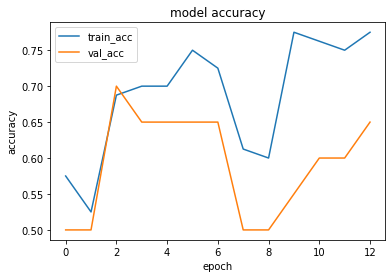

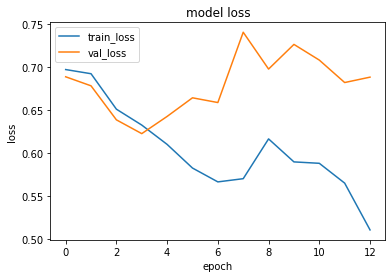

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.21423173]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5586597]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_2.mov is [[0.35018182]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.19100231]]


1it [00:00, 12985.46it/s]


prediction for video control_2.mov is [[0.18647513]]


1it [00:00, 13315.25it/s]


prediction for video control_3.mov is [[0.19699079]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.7069 - accuracy: 0.3875 - precision: 0.3953 - recall: 0.4250 - val_loss: 0.6897 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6846 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6742 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6415 - accuracy: 0.6375 - precision: 0.5873 - recall: 0.9250 - val_loss: 0.7626 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.8642 - accuracy: 0.5250 - precision: 0.5333 - recall: 0.4000 - val_loss: 0.6714 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 5/75


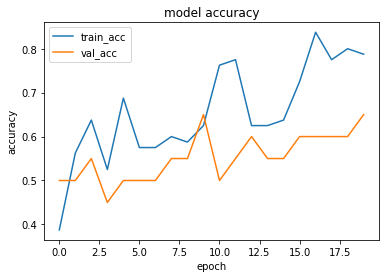

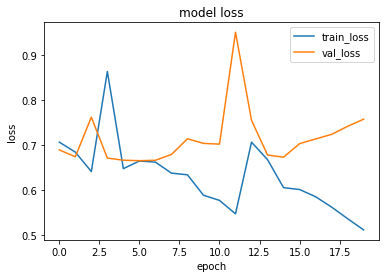

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.20596287]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.66872525]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.281591]]


1it [00:00, 15827.56it/s]


prediction for video control_1.mov is [[0.19202963]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.18703431]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.18503478]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 199ms/step - loss: 0.6906 - accuracy: 0.6250 - precision: 0.6136 - recall: 0.6750 - val_loss: 0.6668 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6448 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.5916 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6970 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6205 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6165 - accuracy: 0.7375 - precision: 0.8065 - recall: 0.6250 - val_loss: 0.5750 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 5/75


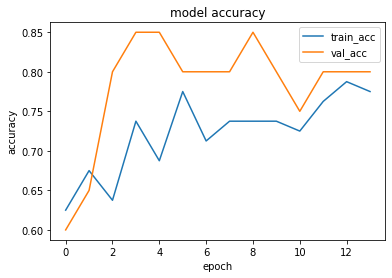

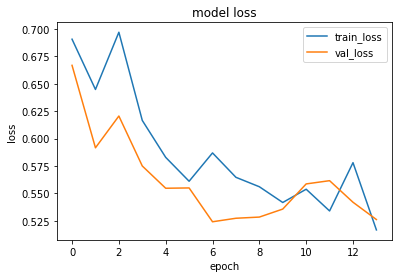

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4396695]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.6377788]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.66430527]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.3477083]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.30361915]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.30724737]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 166ms/step - loss: 0.7036 - accuracy: 0.4125 - precision: 0.1818 - recall: 0.0500 - val_loss: 0.6811 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6487 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.8519 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7326 - accuracy: 0.6375 - precision: 0.6222 - recall: 0.7000 - val_loss: 0.8212 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 176ms/step - loss: 0.6916 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.7134 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 5/75


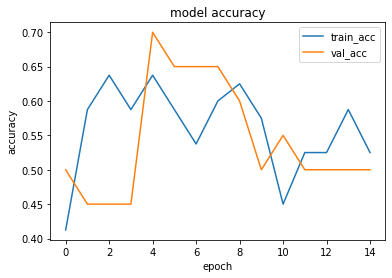

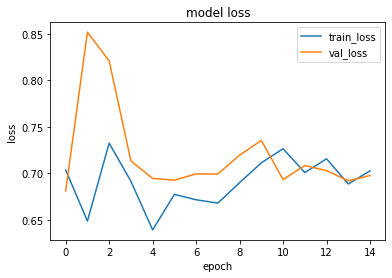

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.44195983]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.43133837]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.4419046]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.4418128]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.4417541]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.44175458]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6820 - accuracy: 0.5250 - precision: 0.5185 - recall: 0.7000 - val_loss: 0.7597 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6377 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.6173 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6563 - accuracy: 0.5625 - precision: 0.7273 - recall: 0.2000 - val_loss: 0.5876 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 205ms/step - loss: 0.6418 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.6012 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75


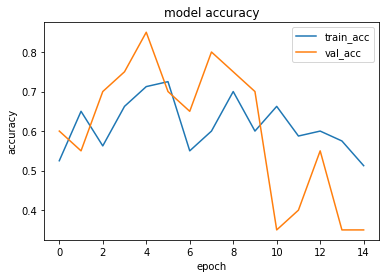

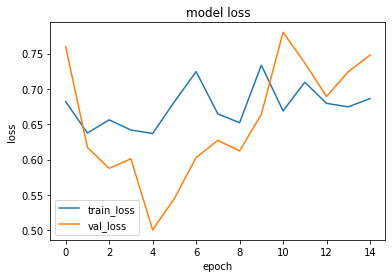

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.3243186]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.3797394]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.3555671]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.29838753]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.28662622]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.28094006]]


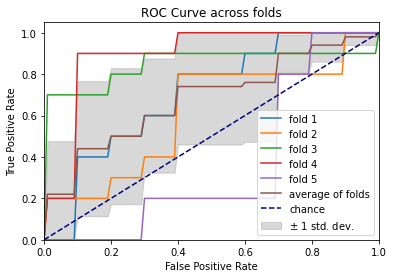

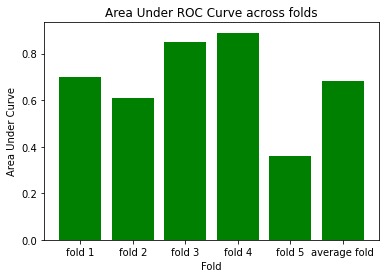

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 200ms/step - loss: 0.6919 - accuracy: 0.5375 - precision: 0.5231 - recall: 0.8500 - val_loss: 0.6963 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6050 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 1.2858 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.9572 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.7935 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.9202 - accuracy: 0.5625 - precision: 0.6471 - recall: 0.2750 - val_loss: 0.8115 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 5/75
3/3 [==============================] - 0s 149

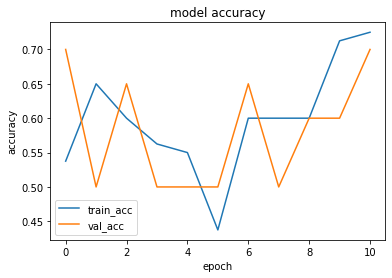

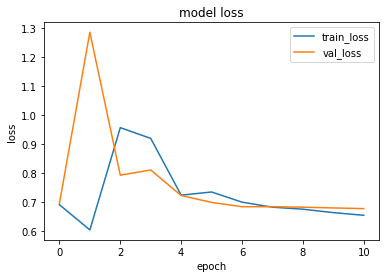

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.49509668]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.5011351]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.5080506]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.48776817]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.48491943]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.48467916]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6955 - accuracy: 0.6000 - precision: 0.5952 - recall: 0.6250 - val_loss: 0.6756 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6787 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6524 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6338 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.8204 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 181ms/step - loss: 0.7117 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6390 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


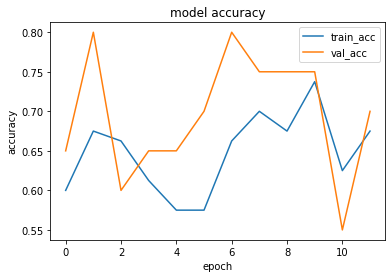

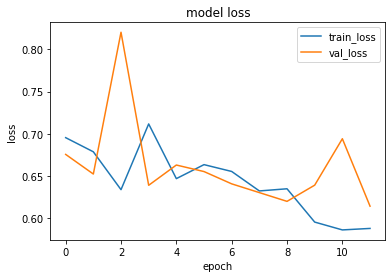

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.03019229]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.48206276]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.4940299]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.02416015]]


1it [00:00, 12633.45it/s]


prediction for video control_2.mov is [[0.02342361]]


1it [00:00, 9892.23it/s]


prediction for video control_3.mov is [[0.02354845]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6976 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3500 - val_loss: 0.6565 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6441 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.9372 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.9617 - accuracy: 0.5375 - precision: 0.5385 - recall: 0.5250 - val_loss: 0.6271 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6828 - accuracy: 0.5500 - precision: 0.5333 - recall: 0.8000 - val_loss: 0.6427 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


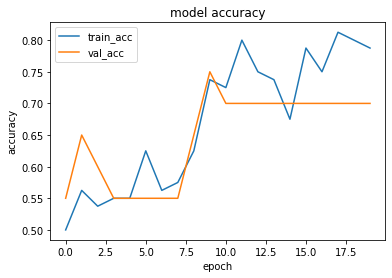

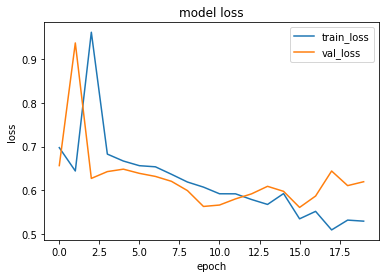

1it [00:00, 12671.61it/s]


prediction for video armflapping_1.mov is [[0.29672807]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.57371825]]


1it [00:00, 9799.78it/s]


prediction for video armflapping_2.mov is [[0.6802906]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.22764307]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.20849347]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.1971286]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6924 - accuracy: 0.4875 - precision: 0.4737 - recall: 0.2250 - val_loss: 0.6710 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6862 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6724 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6297 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.7131 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6470 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.7235 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 5/75
3

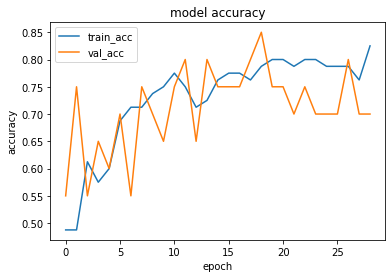

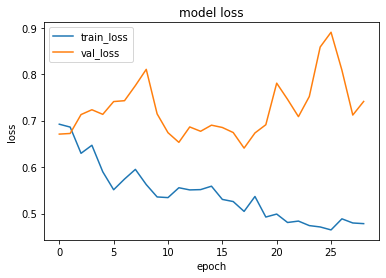

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.39850956]]


1it [00:00, 15087.42it/s]


prediction for video armflapping_3.mov is [[0.47318953]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.4615433]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.35698122]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.33965015]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.33598837]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7031 - accuracy: 0.5375 - precision: 0.5652 - recall: 0.3250 - val_loss: 0.6564 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6703 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.5514 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6372 - accuracy: 0.6125 - precision: 0.5957 - recall: 0.7000 - val_loss: 0.5903 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6398 - accuracy: 0.6625 - precision: 0.6970 - recall: 0.5750 - val_loss: 0.5835 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75


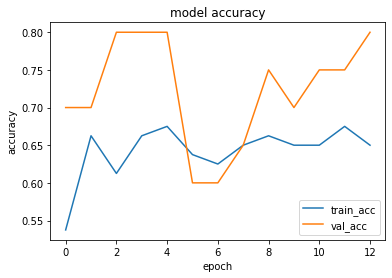

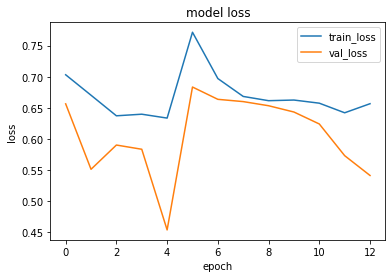

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.2060498]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.4540303]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.4770538]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.18848765]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.1843274]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.18591455]]


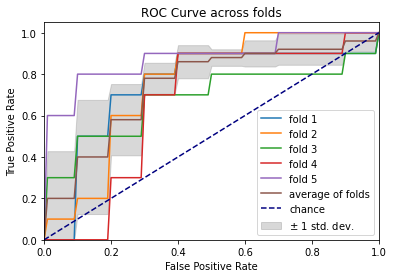

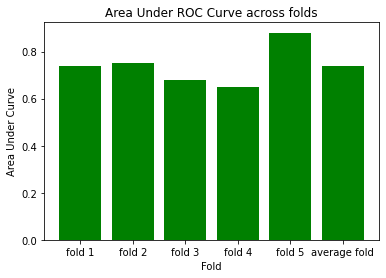

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7181 - accuracy: 0.5125 - precision: 0.5556 - recall: 0.1250 - val_loss: 0.7109 - val_accuracy: 0.2000 - val_precision: 0.2857 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6913 - accuracy: 0.4500 - precision: 0.4500 - recall: 0.4500 - val_loss: 0.7065 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6530 - accuracy: 0.6250 - precision: 0.5735 - recall: 0.9750 - val_loss: 0.8482 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.9182 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1750 - val_loss: 0.7280 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 5/75
3/3 [==============================] - 0s 148

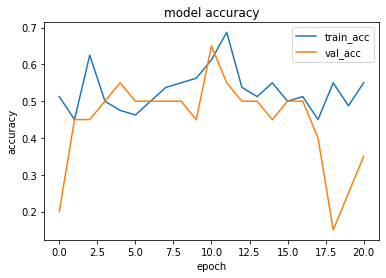

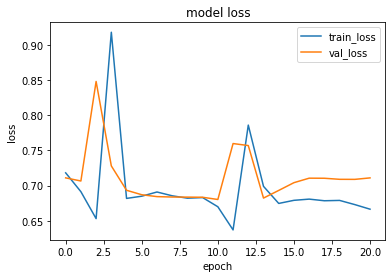

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.5018398]]


1it [00:00, 12787.51it/s]


prediction for video armflapping_3.mov is [[0.4993339]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.5079544]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.5031475]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.50421786]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.50377536]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 186ms/step - loss: 0.6974 - accuracy: 0.4750 - precision: 0.4848 - recall: 0.8000 - val_loss: 0.6582 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6850 - accuracy: 0.5125 - precision: 0.6000 - recall: 0.0750 - val_loss: 0.6499 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6683 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.6477 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6531 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6038 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


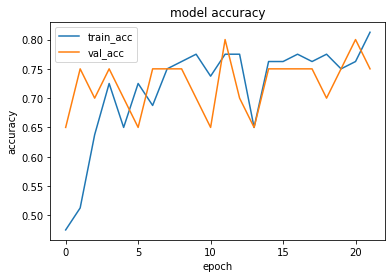

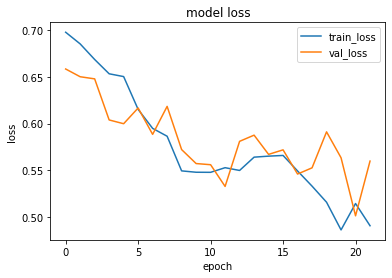

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.36934528]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.6613394]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.7647839]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.28993905]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.26696122]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.25855908]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 175ms/step - loss: 0.6794 - accuracy: 0.4750 - precision: 0.4706 - recall: 0.4000 - val_loss: 0.6481 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6723 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8250 - val_loss: 0.6702 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6889 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.6471 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6381 - accuracy: 0.6875 - precision: 0.6364 - recall: 0.8750 - val_loss: 0.6850 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


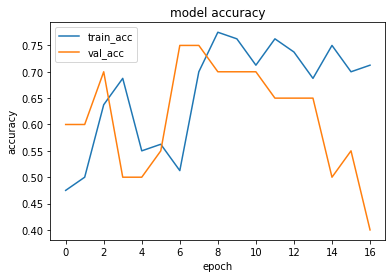

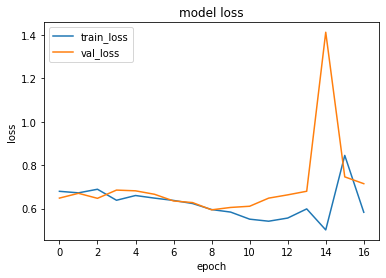

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.4104397]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.42168444]]


1it [00:00, 12945.38it/s]


prediction for video armflapping_2.mov is [[0.38029438]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.38860944]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.38691786]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.38488534]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6913 - accuracy: 0.4375 - precision: 0.4468 - recall: 0.5250 - val_loss: 0.6641 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 209ms/step - loss: 0.6950 - accuracy: 0.6125 - precision: 0.5882 - recall: 0.7500 - val_loss: 0.6516 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6759 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6792 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6584 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6783 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75


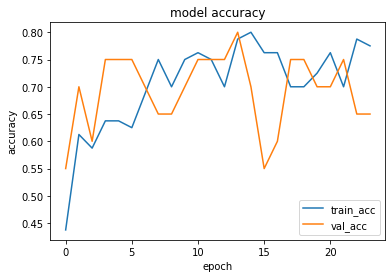

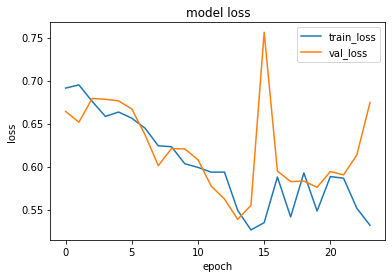

1it [00:00, 10305.42it/s]


prediction for video armflapping_1.mov is [[0.52697814]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.6346408]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_2.mov is [[0.6680284]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.34154928]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.30651397]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.28938127]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6956 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6666 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6906 - accuracy: 0.6375 - precision: 0.8667 - recall: 0.3250 - val_loss: 0.6323 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6473 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6984 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 199ms/step - loss: 0.6640 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.7070 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75


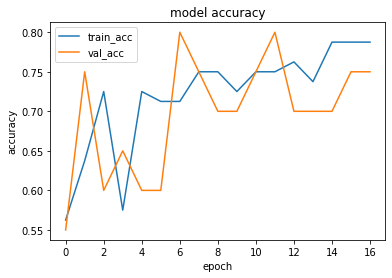

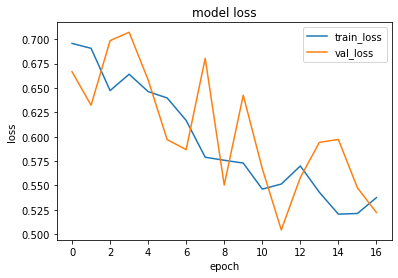

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.25734472]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.5753463]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5948737]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.21982658]]


1it [00:00, 13357.66it/s]


prediction for video control_2.mov is [[0.20732278]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.20545346]]


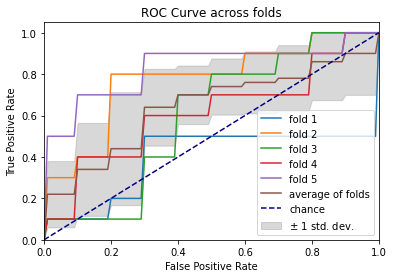

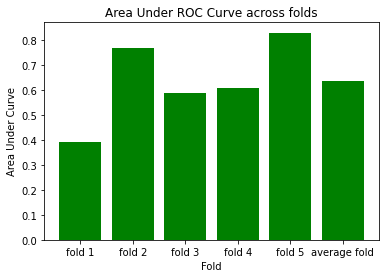

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6925 - accuracy: 0.4375 - precision: 0.4545 - recall: 0.6250 - val_loss: 0.6553 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6612 - accuracy: 0.6375 - precision: 1.0000 - recall: 0.2750 - val_loss: 0.6355 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6477 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.5907 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6837 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.6410 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 151ms/step 

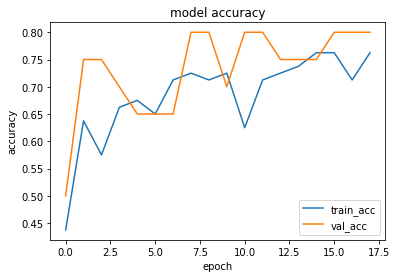

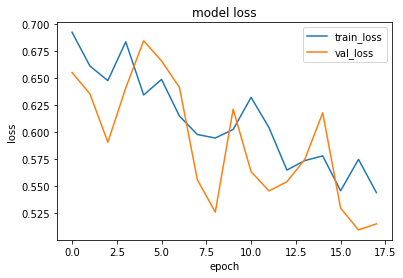

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.48740533]]


1it [00:00, 12865.96it/s]


prediction for video armflapping_3.mov is [[0.49851966]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_2.mov is [[0.5398758]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.37954172]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.33622098]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.32183653]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6823 - accuracy: 0.5250 - precision: 0.5714 - recall: 0.2000 - val_loss: 0.7454 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7442 - accuracy: 0.5625 - precision: 0.5439 - recall: 0.7750 - val_loss: 0.6987 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6765 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6837 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6926 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6792 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


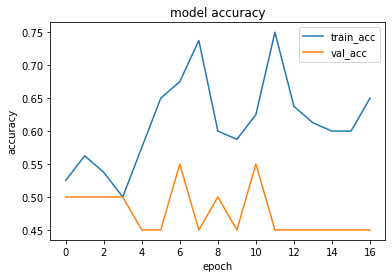

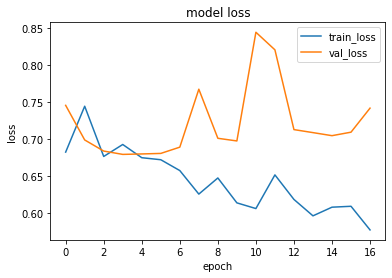

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5766656]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5812631]]


1it [00:00, 17623.13it/s]


prediction for video armflapping_2.mov is [[0.6235106]]


1it [00:00, 8208.03it/s]


prediction for video control_1.mov is [[0.547915]]


1it [00:00, 10979.85it/s]


prediction for video control_2.mov is [[0.5319303]]


1it [00:00, 8192.00it/s]


prediction for video control_3.mov is [[0.5265478]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 182ms/step - loss: 0.6929 - accuracy: 0.4125 - precision: 0.4386 - recall: 0.6250 - val_loss: 0.6889 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6489 - accuracy: 0.6000 - precision: 0.6818 - recall: 0.3750 - val_loss: 0.6909 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6373 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6911 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 154ms/step - loss: 0.5939 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.6969 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3

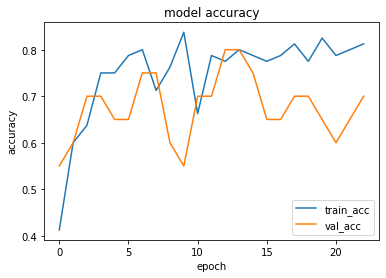

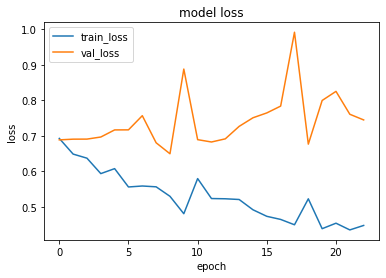

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.28650373]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_3.mov is [[0.5473908]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.72997683]]


1it [00:00, 3393.45it/s]


prediction for video control_1.mov is [[0.24669904]]


1it [00:00, 13934.56it/s]


prediction for video control_2.mov is [[0.21423915]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2253406]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6910 - accuracy: 0.4625 - precision: 0.4717 - recall: 0.6250 - val_loss: 0.6132 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6855 - accuracy: 0.5500 - precision: 0.5312 - recall: 0.8500 - val_loss: 0.5437 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6700 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.6492 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6452 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5267 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75
3

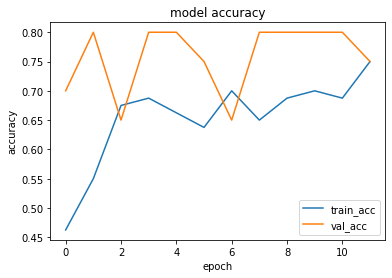

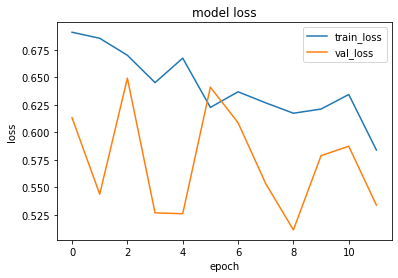

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.29657072]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.6554999]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6934581]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.2019873]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.18930608]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.23935878]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7175 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6500 - val_loss: 0.6802 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6860 - accuracy: 0.5250 - precision: 0.5833 - recall: 0.1750 - val_loss: 0.6797 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6645 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.6878 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6430 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6387 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75


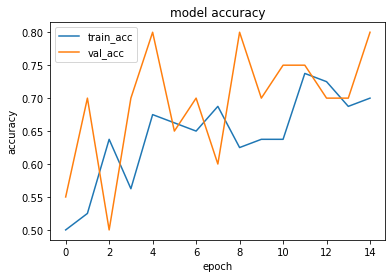

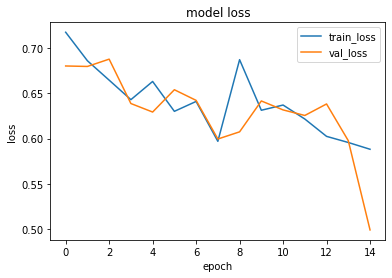

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.498764]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.61754656]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.63735676]]


1it [00:00, 17260.51it/s]


prediction for video control_1.mov is [[0.14972255]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.1335054]]


1it [00:00, 12192.74it/s]


prediction for video control_3.mov is [[0.2565785]]


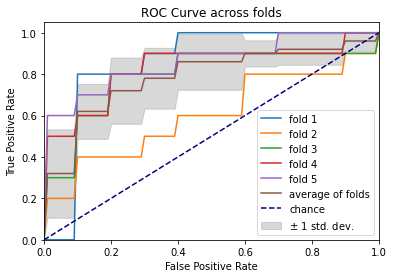

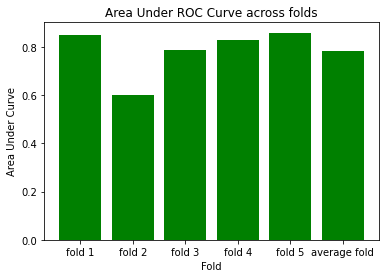

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7013 - accuracy: 0.4500 - precision: 0.4091 - recall: 0.2250 - val_loss: 0.6846 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7034 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6946 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6784 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6832 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6686 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.6597 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 150ms/step 

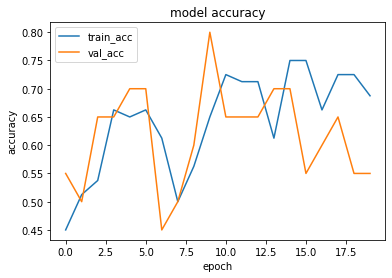

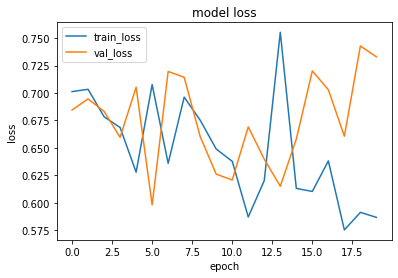

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.19651866]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.6420924]]


1it [00:00, 9532.51it/s]


prediction for video armflapping_2.mov is [[0.21005282]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.19054851]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.18865931]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.18834478]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 182ms/step - loss: 0.6990 - accuracy: 0.3750 - precision: 0.3529 - recall: 0.3000 - val_loss: 0.6708 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6699 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.6684 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6639 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.7421 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6274 - accuracy: 0.6625 - precision: 0.6140 - recall: 0.8750 - val_loss: 0.7654 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


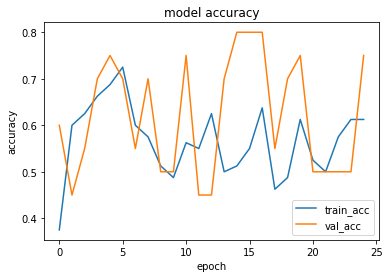

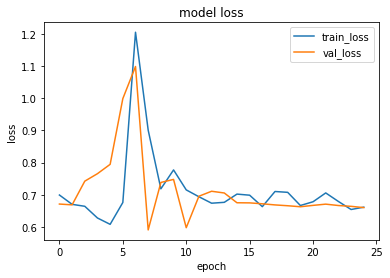

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5082722]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.4337407]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_2.mov is [[0.5189581]]


1it [00:00, 17050.02it/s]


prediction for video control_1.mov is [[0.50193703]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.49917483]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.49876678]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7091 - accuracy: 0.4500 - precision: 0.4667 - recall: 0.7000 - val_loss: 0.7165 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6691 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6743 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6715 - accuracy: 0.6625 - precision: 0.8824 - recall: 0.3750 - val_loss: 0.6664 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6384 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.6610 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 5/75


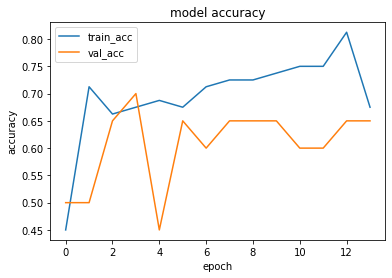

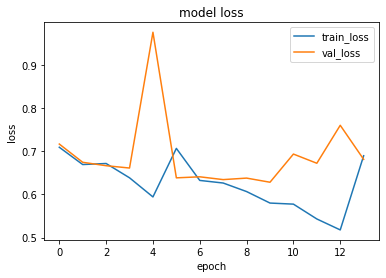

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.73177207]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.82710284]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.81237096]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.3774527]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.28677553]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.58040375]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7218 - accuracy: 0.3875 - precision: 0.4151 - recall: 0.5500 - val_loss: 0.6813 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6802 - accuracy: 0.6375 - precision: 0.6486 - recall: 0.6000 - val_loss: 0.6712 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6680 - accuracy: 0.5875 - precision: 0.8889 - recall: 0.2000 - val_loss: 0.6606 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6358 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6422 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


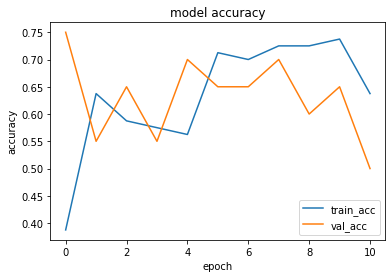

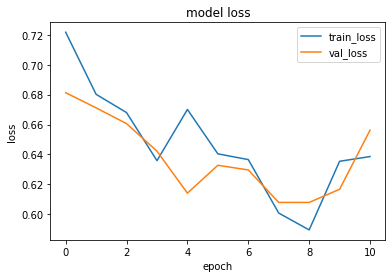

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.54575986]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.5841878]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.5771523]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.5231761]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.5142235]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.5121008]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7024 - accuracy: 0.3750 - precision: 0.2500 - recall: 0.1250 - val_loss: 0.6828 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6771 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6612 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6443 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6510 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6342 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.6656 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3

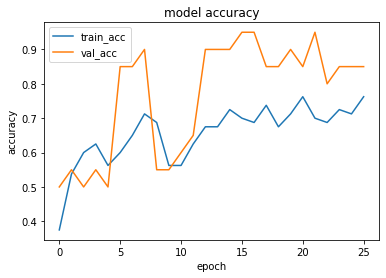

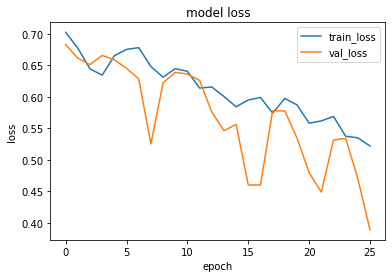

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.42521763]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.69019055]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_2.mov is [[0.7297713]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.26372278]]


1it [00:00, 14217.98it/s]


prediction for video control_2.mov is [[0.23653254]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.22338569]]


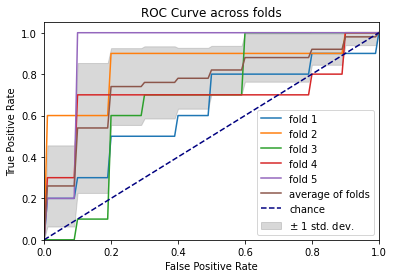

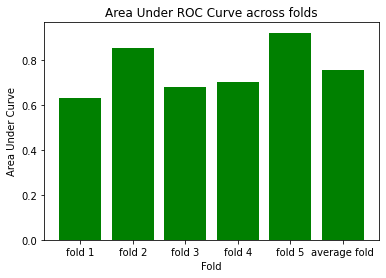

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 187ms/step - loss: 0.7269 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6823 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6781 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 0.6735 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6730 - accuracy: 0.5875 - precision: 0.8889 - recall: 0.2000 - val_loss: 0.6392 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6757 - accuracy: 0.5500 - precision: 0.5909 - recall: 0.3250 - val_loss: 0.6515 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 168ms/step 

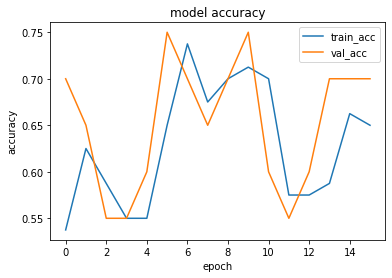

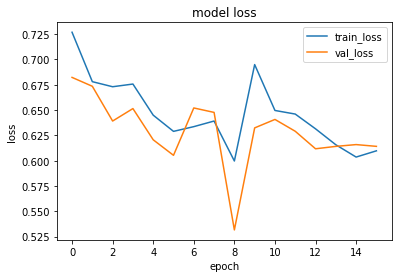

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.4088993]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.503418]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.57343656]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.35876837]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.34481475]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.3432843]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7094 - accuracy: 0.4500 - precision: 0.3333 - recall: 0.1000 - val_loss: 0.7076 - val_accuracy: 0.2000 - val_precision: 0.2000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6816 - accuracy: 0.4875 - precision: 0.4878 - recall: 0.5000 - val_loss: 0.6986 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6640 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.8282 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6858 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.7941 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epoch 5/75
3

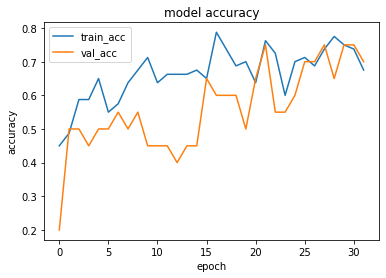

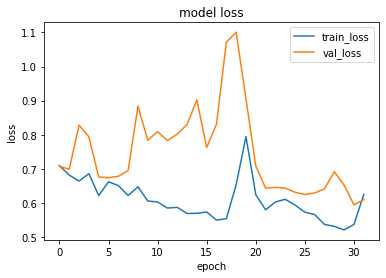

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.320974]]


1it [00:00, 11781.75it/s]


prediction for video armflapping_3.mov is [[0.5125371]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.46420613]]


1it [00:00, 18893.26it/s]


prediction for video control_1.mov is [[0.13607177]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.13014776]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.19163537]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6865 - accuracy: 0.5250 - precision: 0.5385 - recall: 0.3500 - val_loss: 0.7068 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6851 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.6484 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6460 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.6691 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6817 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6618 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75


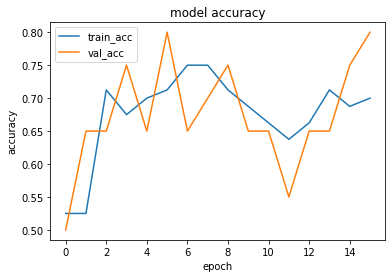

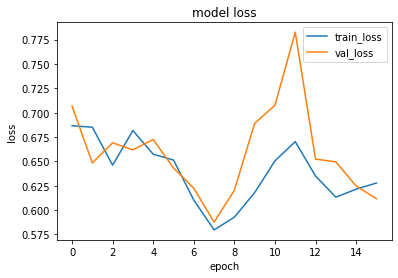

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.46052843]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.52011156]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.5429031]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.42060602]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.41287565]]


1it [00:00, 13842.59it/s]


prediction for video control_3.mov is [[0.40890318]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6933 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5500 - val_loss: 0.6737 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7274 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6929 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6761 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6780 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6809 - accuracy: 0.6000 - precision: 0.7222 - recall: 0.3250 - val_loss: 0.6674 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 5/75


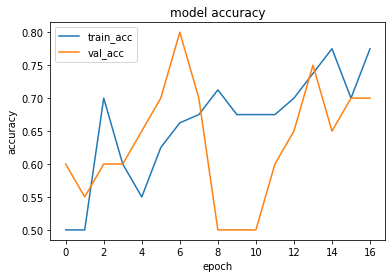

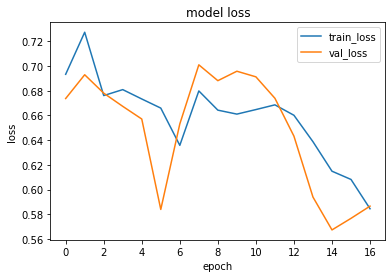

1it [00:00, 11618.57it/s]


prediction for video armflapping_1.mov is [[0.40146554]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.48098528]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5135576]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.31927583]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.29102254]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.28279245]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7080 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3250 - val_loss: 0.6798 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6883 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6554 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 1s 221ms/step - loss: 0.6915 - accuracy: 0.5125 - precision: 0.5217 - recall: 0.3000 - val_loss: 0.6593 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 1s 180ms/step - loss: 0.6659 - accuracy: 0.5750 - precision: 0.8000 - recall: 0.2000 - val_loss: 0.6435 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75


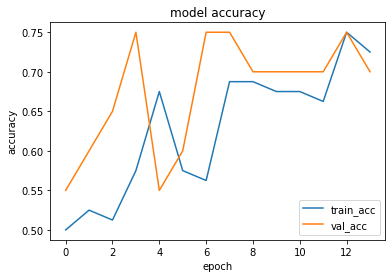

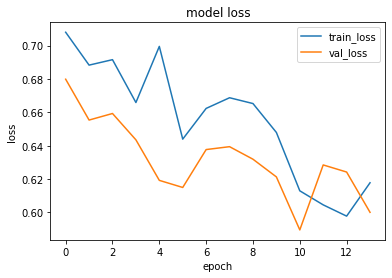

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.49518293]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.4913558]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.49774817]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.47002244]]


1it [00:00, 12372.58it/s]


prediction for video control_2.mov is [[0.4470719]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.43554306]]


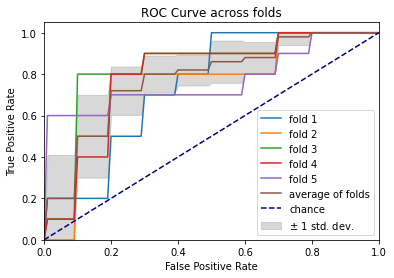

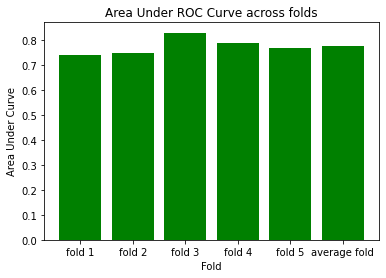

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 179ms/step - loss: 0.7109 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6910 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6731 - accuracy: 0.5500 - precision: 0.8333 - recall: 0.1250 - val_loss: 0.7213 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6427 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6860 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6733 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6897 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 149ms/step 

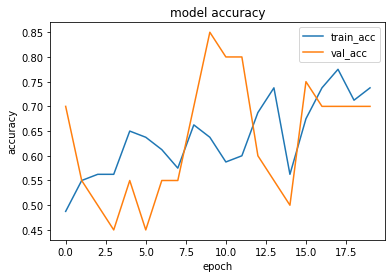

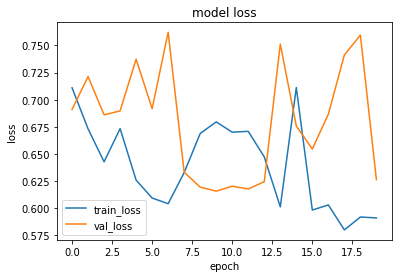

1it [00:00, 11522.81it/s]


prediction for video armflapping_1.mov is [[0.47522292]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.5200988]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.5259374]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.43197185]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.41217595]]


1it [00:00, 14027.77it/s]


prediction for video control_3.mov is [[0.40131825]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 182ms/step - loss: 0.6898 - accuracy: 0.5125 - precision: 0.5217 - recall: 0.3000 - val_loss: 0.7162 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 180ms/step - loss: 0.7151 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6560 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6632 - accuracy: 0.5875 - precision: 0.7692 - recall: 0.2500 - val_loss: 0.6533 - val_accuracy: 0.4500 - val_precision: 0.4000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6579 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6518 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75


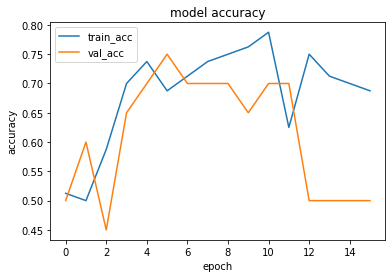

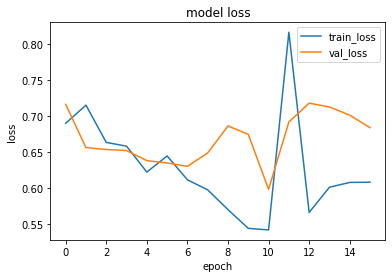

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.37869167]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.50713056]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5041902]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.31615216]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.3024184]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.29650867]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7208 - accuracy: 0.4375 - precision: 0.2222 - recall: 0.0500 - val_loss: 0.6918 - val_accuracy: 0.3500 - val_precision: 0.3846 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6882 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.6767 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6825 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6480 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6628 - accuracy: 0.5750 - precision: 0.5455 - recall: 0.9000 - val_loss: 0.5961 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75


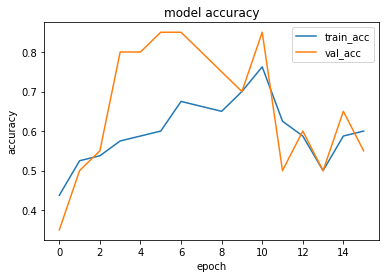

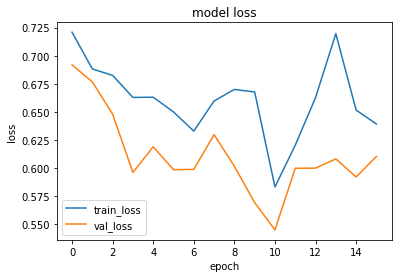

1it [00:00, 13189.64it/s]


prediction for video armflapping_1.mov is [[0.60289407]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_3.mov is [[0.65280724]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6919118]]


1it [00:00, 12336.19it/s]


prediction for video control_1.mov is [[0.54753613]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.5477504]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.50897247]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 242ms/step - loss: 0.6912 - accuracy: 0.3500 - precision: 0.3000 - recall: 0.2250 - val_loss: 0.6742 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6742 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6805 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6736 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.7100 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6405 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.6698 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 5/75


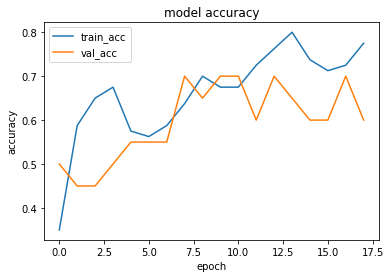

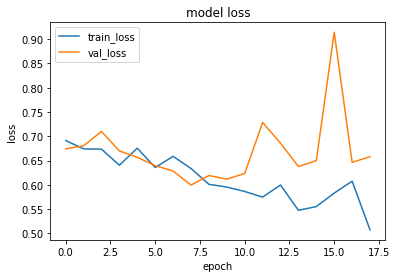

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.50069994]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.50315046]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.63885397]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.41321892]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.3665115]]


1it [00:00, 9709.04it/s]


prediction for video control_3.mov is [[0.36075604]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6916 - accuracy: 0.5500 - precision: 0.5385 - recall: 0.7000 - val_loss: 0.6813 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6504 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5251 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6703 - accuracy: 0.6500 - precision: 0.6200 - recall: 0.7750 - val_loss: 0.6745 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6390 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6968 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 5/75


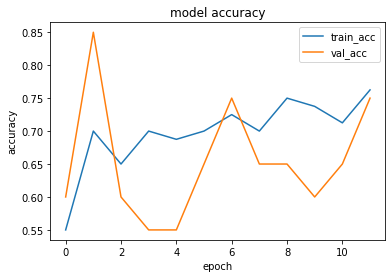

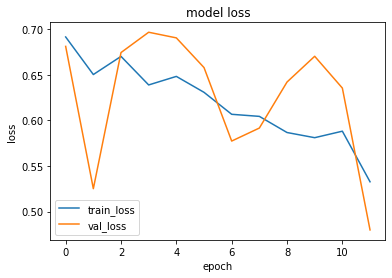

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.45412683]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_3.mov is [[0.57993543]]


1it [00:00, 8848.74it/s]


prediction for video armflapping_2.mov is [[0.56587654]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.3360443]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.3032843]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.28999096]]


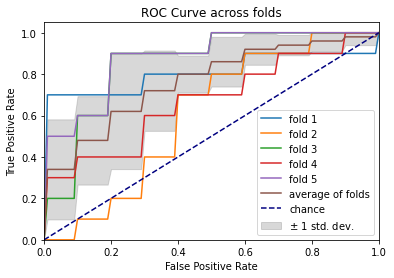

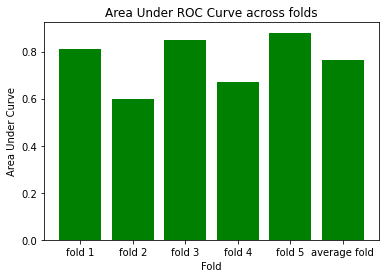

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 175ms/step - loss: 0.7029 - accuracy: 0.3500 - precision: 0.3889 - recall: 0.5250 - val_loss: 0.6689 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6780 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.6276 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6832 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.5776 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6577 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.5785 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 1s 175ms/step 

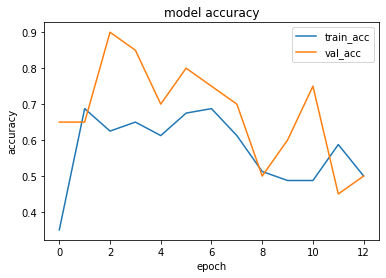

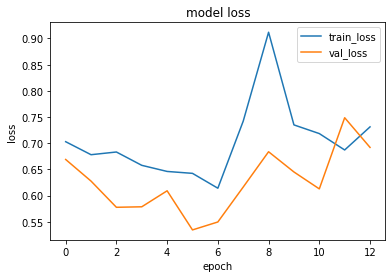

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.42839047]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.43773317]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.4341542]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.42828724]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.4285301]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.42858204]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6834 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.8218 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7312 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4750 - val_loss: 0.6661 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6654 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6360 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6648 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.6420 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epo

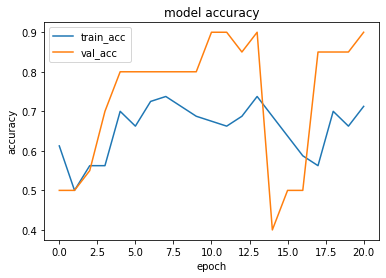

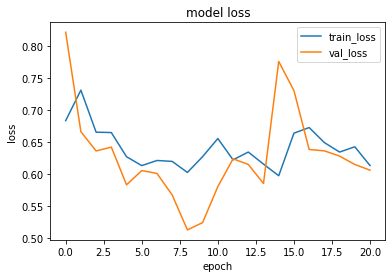

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.50020385]]


1it [00:00, 12228.29it/s]


prediction for video armflapping_3.mov is [[0.52110744]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5227391]]


1it [00:00, 16644.06it/s]


prediction for video control_1.mov is [[0.4867901]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.4776484]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.47556546]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7159 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.6849 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6806 - accuracy: 0.5250 - precision: 1.0000 - recall: 0.0500 - val_loss: 0.6824 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6637 - accuracy: 0.5750 - precision: 0.6667 - recall: 0.3000 - val_loss: 0.6754 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6286 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6857 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epo

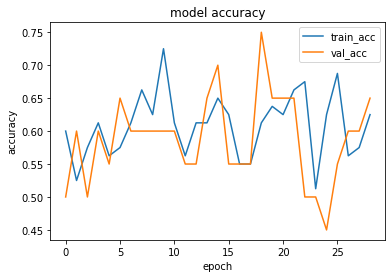

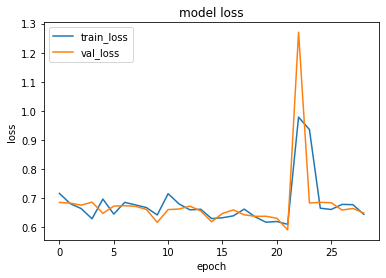

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.4370606]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.58595735]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.5521834]]


1it [00:00, 10618.49it/s]


prediction for video control_1.mov is [[0.44888225]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.43643314]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.43643644]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 202ms/step - loss: 0.6859 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3000 - val_loss: 0.7125 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7971 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6864 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6547 - accuracy: 0.5500 - precision: 0.8333 - recall: 0.1250 - val_loss: 0.7048 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6345 - accuracy: 0.7125 - precision: 0.9474 - recall: 0.4500 - val_loss: 0.7054 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


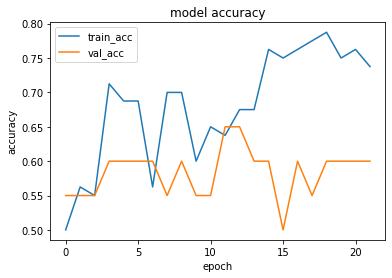

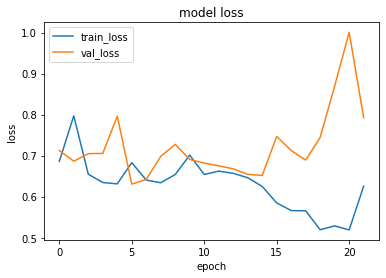

1it [00:00, 12671.61it/s]


prediction for video armflapping_1.mov is [[0.3937642]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.5457187]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_2.mov is [[0.6691547]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.292882]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.26382095]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.23249891]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 191ms/step - loss: 0.6918 - accuracy: 0.4750 - precision: 0.4792 - recall: 0.5750 - val_loss: 0.6078 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 206ms/step - loss: 0.6267 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.7055 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6445 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 1.1444 - val_accuracy: 0.4500 - val_precision: 0.4000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.9343 - accuracy: 0.6250 - precision: 0.6667 - recall: 0.5000 - val_loss: 0.6863 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


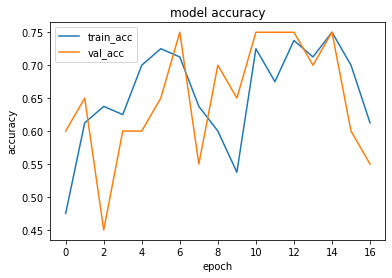

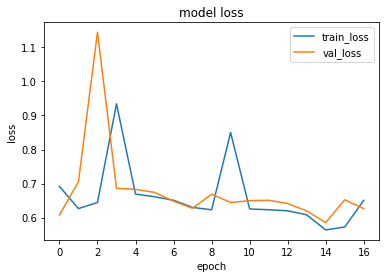

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.5452771]]


1it [00:00, 11715.93it/s]


prediction for video armflapping_3.mov is [[0.5042289]]


1it [00:00, 12710.01it/s]


prediction for video armflapping_2.mov is [[0.5452119]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.53459173]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.5049521]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.5268073]]


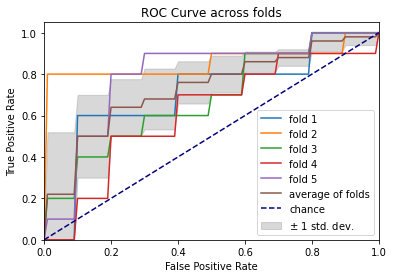

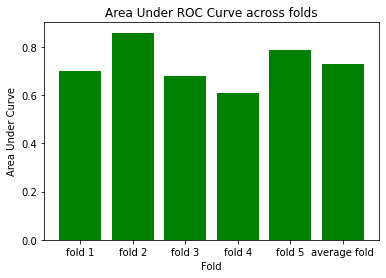

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 196ms/step - loss: 0.7026 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6250 - val_loss: 0.6837 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6887 - accuracy: 0.5750 - precision: 0.6000 - recall: 0.4500 - val_loss: 0.6514 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6985 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.6487 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6685 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6322 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 152ms/step 

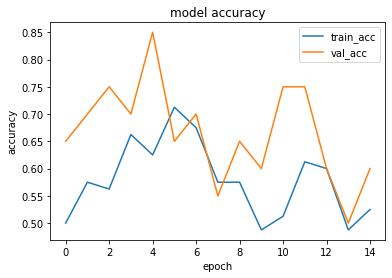

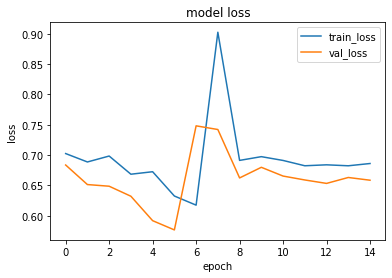

1it [00:00, 11781.75it/s]


prediction for video armflapping_1.mov is [[0.533529]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.5565842]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.54138434]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.5327245]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.5323981]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.53229797]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6985 - accuracy: 0.4125 - precision: 0.3600 - recall: 0.2250 - val_loss: 0.6644 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6946 - accuracy: 0.5500 - precision: 0.5312 - recall: 0.8500 - val_loss: 0.6322 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6534 - accuracy: 0.6500 - precision: 0.6500 - recall: 0.6500 - val_loss: 0.6430 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6563 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.6274 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75


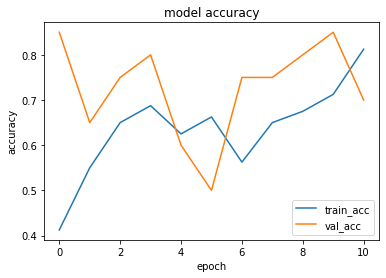

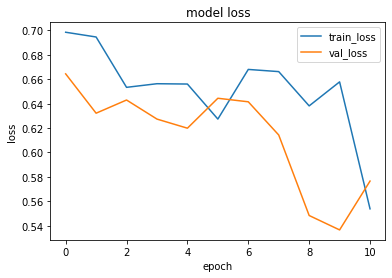

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.7130152]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.6848794]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.72817373]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.6563849]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.3634377]]


1it [00:00, 12336.19it/s]


prediction for video control_3.mov is [[0.6419599]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 167ms/step - loss: 0.6988 - accuracy: 0.5625 - precision: 0.5926 - recall: 0.4000 - val_loss: 0.6996 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6780 - accuracy: 0.5500 - precision: 0.5294 - recall: 0.9000 - val_loss: 0.7047 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6710 - accuracy: 0.6875 - precision: 0.6364 - recall: 0.8750 - val_loss: 0.6782 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6263 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.6382 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75
3

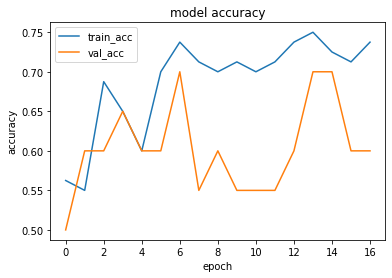

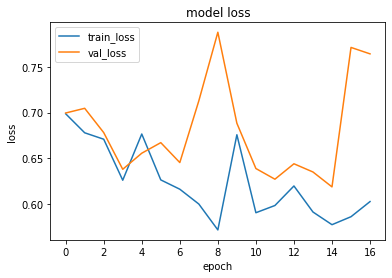

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4638326]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5758607]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_2.mov is [[0.5762162]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.40448493]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.3900849]]


1it [00:00, 10618.49it/s]


prediction for video control_3.mov is [[0.37463865]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6941 - accuracy: 0.4750 - precision: 0.4839 - recall: 0.7500 - val_loss: 0.7093 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7074 - accuracy: 0.5625 - precision: 0.5439 - recall: 0.7750 - val_loss: 0.6753 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.5811 - accuracy: 0.7875 - precision: 0.8485 - recall: 0.7000 - val_loss: 0.8836 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6904 - accuracy: 0.6375 - precision: 0.8235 - recall: 0.3500 - val_loss: 0.6941 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


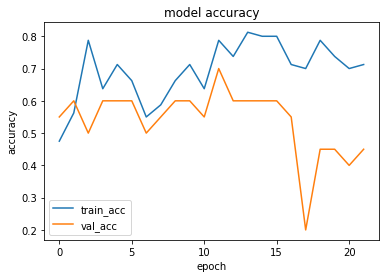

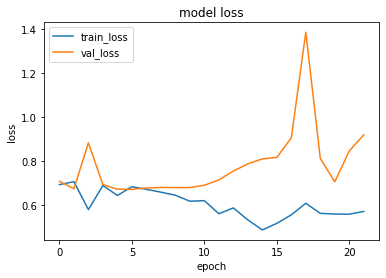

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.46609512]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.6664173]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.7198355]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.31556928]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.28375477]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.27946723]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6950 - accuracy: 0.5375 - precision: 0.5217 - recall: 0.9000 - val_loss: 0.6864 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6636 - accuracy: 0.5750 - precision: 0.7500 - recall: 0.2250 - val_loss: 0.6720 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6315 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.7288 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 170ms/step - loss: 0.5794 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.8090 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75


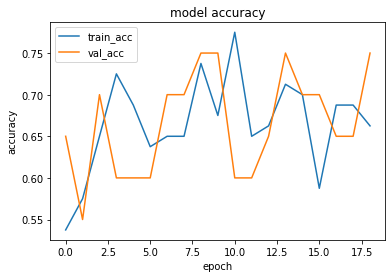

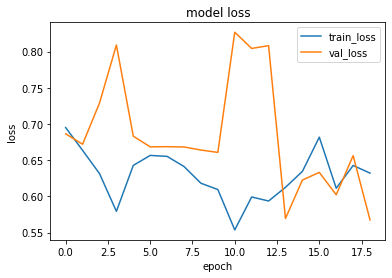

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.36747622]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.34645313]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.37952036]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.36172897]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.35958546]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.35932124]]


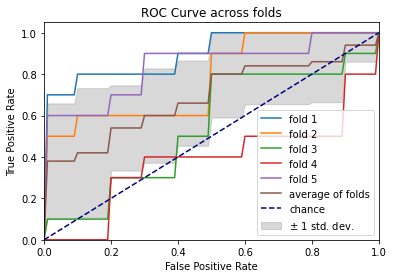

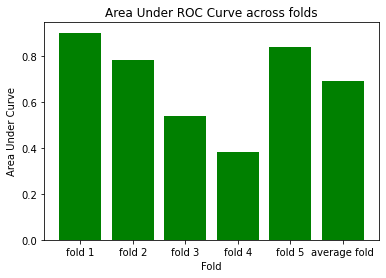

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7040 - accuracy: 0.3750 - precision: 0.3810 - recall: 0.4000 - val_loss: 0.6941 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6891 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6727 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6651 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.6371 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7473 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6758 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 162ms/step 

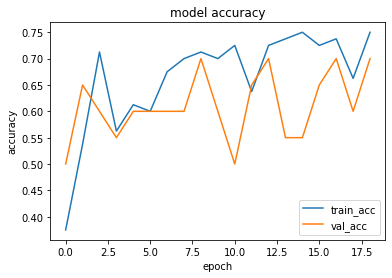

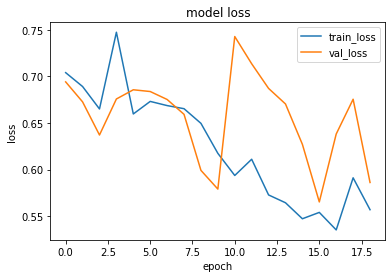

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.196338]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_3.mov is [[0.66119367]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.66420436]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.13625267]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.12399474]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.13469708]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6913 - accuracy: 0.5125 - precision: 0.5082 - recall: 0.7750 - val_loss: 0.6240 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6194 - accuracy: 0.6625 - precision: 0.6032 - recall: 0.9500 - val_loss: 1.9496 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 1.5563 - accuracy: 0.5000 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6564 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6559 - accuracy: 0.7125 - precision: 0.7931 - recall: 0.5750 - val_loss: 0.6659 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.

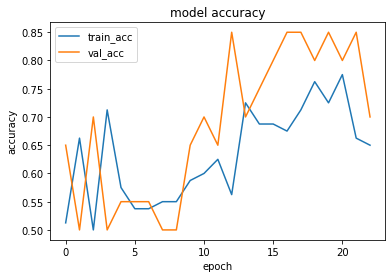

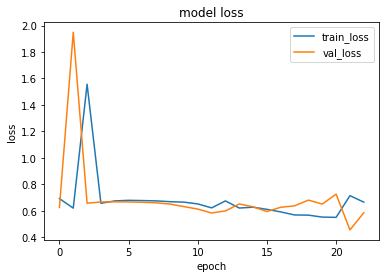

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5980647]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.69777584]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.68497705]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.21312562]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.21165928]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.21066922]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6974 - accuracy: 0.4625 - precision: 0.4286 - recall: 0.2250 - val_loss: 0.7078 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6770 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6759 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6576 - accuracy: 0.5250 - precision: 1.0000 - recall: 0.0500 - val_loss: 0.8763 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7574 - accuracy: 0.5875 - precision: 0.7692 - recall: 0.2500 - val_loss: 0.6680 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

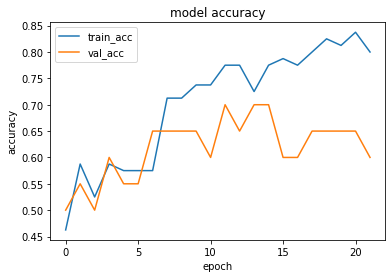

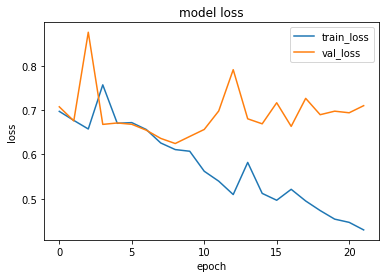

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.27231348]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.41117203]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.7657638]]


1it [00:00, 10205.12it/s]


prediction for video control_1.mov is [[0.23343381]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.20296028]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.2146425]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6886 - accuracy: 0.4625 - precision: 0.4000 - recall: 0.1500 - val_loss: 0.7022 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6750 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6963 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6297 - accuracy: 0.7625 - precision: 0.8889 - recall: 0.6000 - val_loss: 0.7023 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6065 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.7696 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3

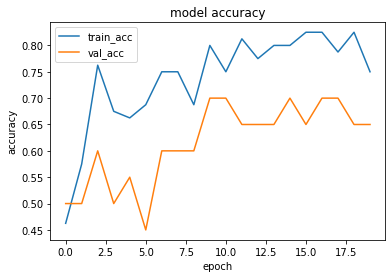

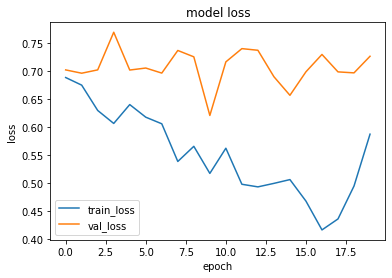

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.40728825]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.5033832]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5051879]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.35419747]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.33127213]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.32972068]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 188ms/step - loss: 0.6971 - accuracy: 0.4625 - precision: 0.4754 - recall: 0.7250 - val_loss: 0.6751 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6486 - accuracy: 0.5875 - precision: 0.6522 - recall: 0.3750 - val_loss: 0.9028 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7322 - accuracy: 0.5250 - precision: 0.5385 - recall: 0.3500 - val_loss: 0.6529 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6661 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6462 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epo

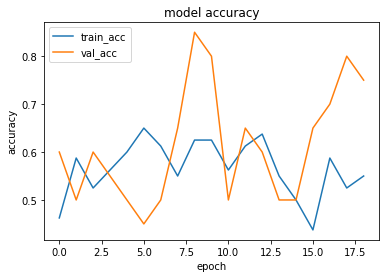

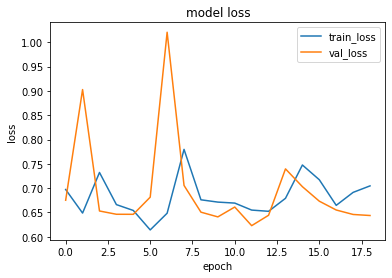

1it [00:00, 13189.64it/s]


prediction for video armflapping_1.mov is [[0.48265684]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.51419485]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.47946876]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.4845259]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.4857349]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.47854882]]


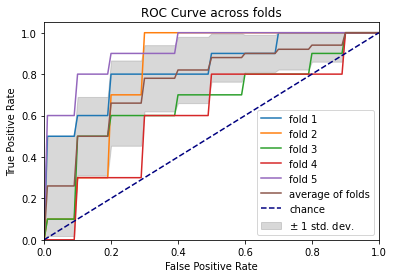

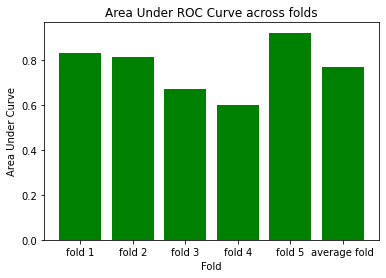

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6976 - accuracy: 0.4500 - precision: 0.4444 - recall: 0.4000 - val_loss: 0.6516 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6733 - accuracy: 0.6250 - precision: 0.6190 - recall: 0.6500 - val_loss: 0.6434 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6477 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6278 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6118 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6430 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 129ms/step 

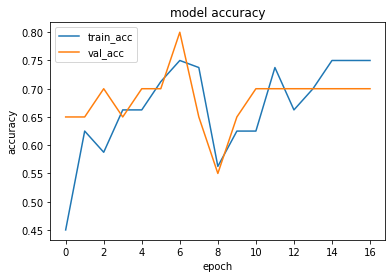

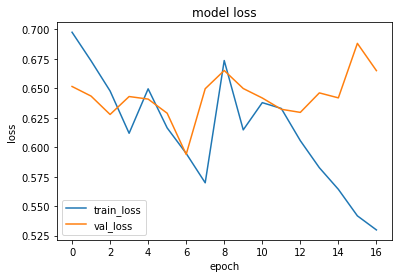

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.43012607]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.67210376]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.68503094]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.30535853]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.29799205]]


1it [00:00, 16320.25it/s]


prediction for video control_3.mov is [[0.2525383]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 163ms/step - loss: 0.6981 - accuracy: 0.4375 - precision: 0.4528 - recall: 0.6000 - val_loss: 0.6625 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6733 - accuracy: 0.6000 - precision: 0.8333 - recall: 0.2500 - val_loss: 0.6456 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6672 - accuracy: 0.5875 - precision: 0.5814 - recall: 0.6250 - val_loss: 0.6719 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6600 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.6542 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

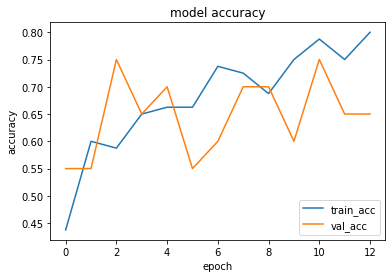

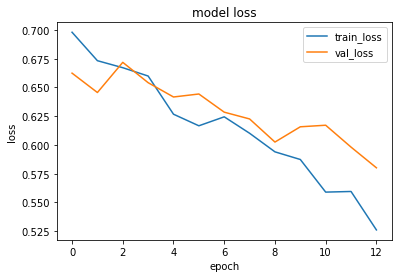

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5431208]]


1it [00:00, 8848.74it/s]


prediction for video armflapping_3.mov is [[0.54658276]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.5879612]]


1it [00:00, 12052.60it/s]


prediction for video control_1.mov is [[0.43674204]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.40020236]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.37901348]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6957 - accuracy: 0.4750 - precision: 0.4783 - recall: 0.5500 - val_loss: 0.6661 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6418 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.7696 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.8053 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 0.7780 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.7326 - accuracy: 0.4875 - precision: 0.4783 - recall: 0.2750 - val_loss: 0.7473 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epo

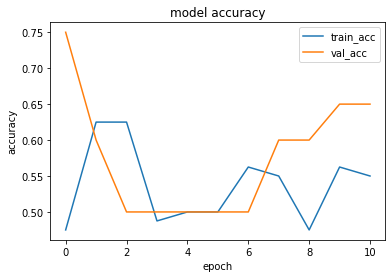

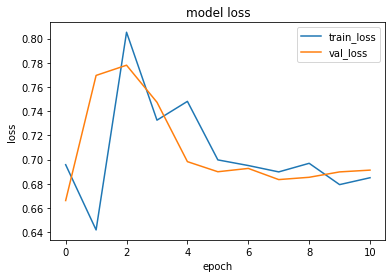

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.5005409]]


1it [00:00, 11214.72it/s]


prediction for video armflapping_3.mov is [[0.51201373]]


1it [00:00, 7463.17it/s]


prediction for video armflapping_2.mov is [[0.50821036]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.49398005]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.49105516]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.4914553]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 221ms/step - loss: 0.7022 - accuracy: 0.4875 - precision: 0.4928 - recall: 0.8500 - val_loss: 0.6947 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6927 - accuracy: 0.5000 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6916 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6505 - accuracy: 0.6125 - precision: 0.5918 - recall: 0.7250 - val_loss: 0.6846 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6701 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6775 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0

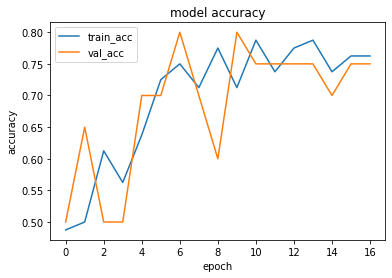

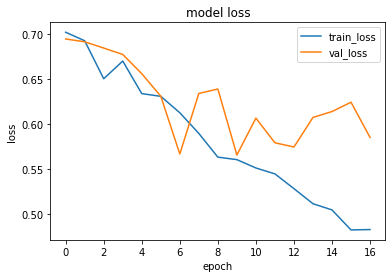

1it [00:00, 13934.56it/s]


prediction for video armflapping_1.mov is [[0.44824204]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.54226416]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.59949064]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.36089563]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.3204911]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.3138233]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7027 - accuracy: 0.4750 - precision: 0.4848 - recall: 0.8000 - val_loss: 0.6709 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6945 - accuracy: 0.5125 - precision: 0.5556 - recall: 0.1250 - val_loss: 0.6821 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6760 - accuracy: 0.4750 - precision: 0.4000 - recall: 0.1000 - val_loss: 0.6656 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6501 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.6398 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoc

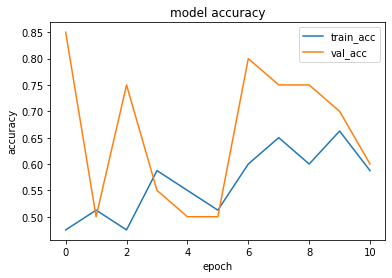

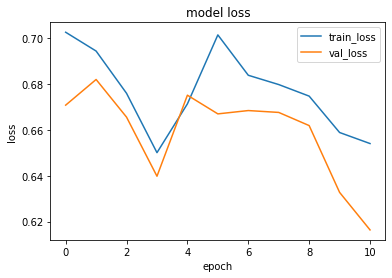

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.5665782]]


1it [00:00, 5622.39it/s]


prediction for video armflapping_3.mov is [[0.5795879]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5867709]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.54479295]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.5369667]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.5345173]]


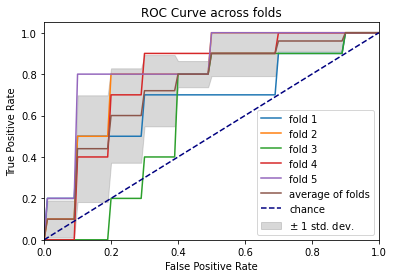

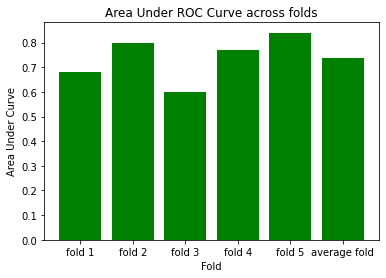

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 184ms/step - loss: 0.6912 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.6137 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6772 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.6173 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6510 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.6441 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6571 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6186 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 153ms/step 

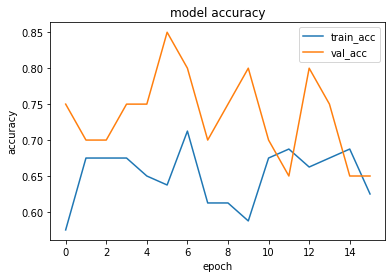

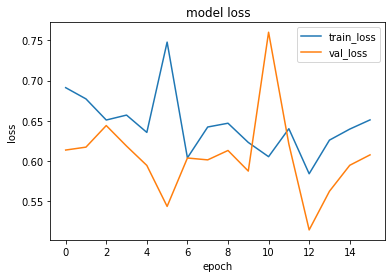

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.397115]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.39555612]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.40266472]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.39470163]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.39391124]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.3939195]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6812 - accuracy: 0.5500 - precision: 0.5357 - recall: 0.7500 - val_loss: 0.6776 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.8433 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.7205 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6741 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6921 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6711 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6942 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 5/75
3

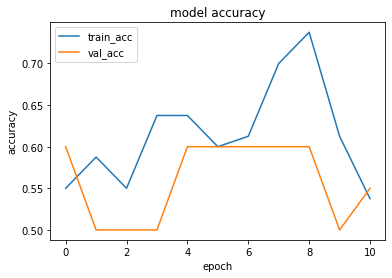

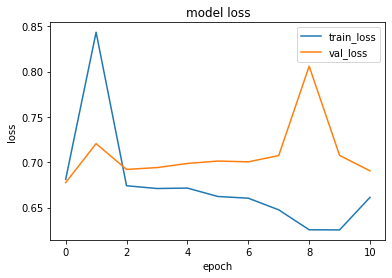

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5794556]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.6006515]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.61995184]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.5582098]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.54740214]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.54086405]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6936 - accuracy: 0.4375 - precision: 0.4324 - recall: 0.4000 - val_loss: 0.6567 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7289 - accuracy: 0.6000 - precision: 0.5714 - recall: 0.8000 - val_loss: 0.6794 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6846 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6712 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6735 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6686 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


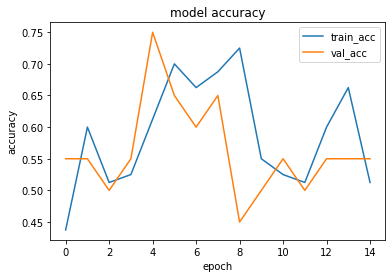

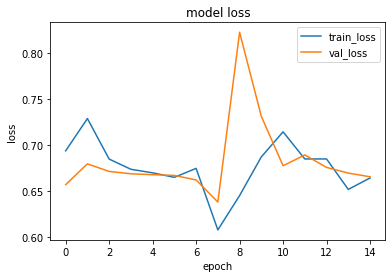

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.5453156]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.5696038]]


1it [00:00, 11008.67it/s]


prediction for video armflapping_2.mov is [[0.5549357]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.54241765]]


1it [00:00, 14217.98it/s]


prediction for video control_2.mov is [[0.5417406]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.54162955]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 162ms/step - loss: 0.7124 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6000 - val_loss: 0.6947 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6817 - accuracy: 0.5625 - precision: 0.6190 - recall: 0.3250 - val_loss: 0.6607 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6793 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.6369 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6283 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.7403 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 5/75


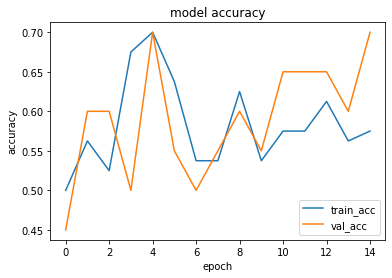

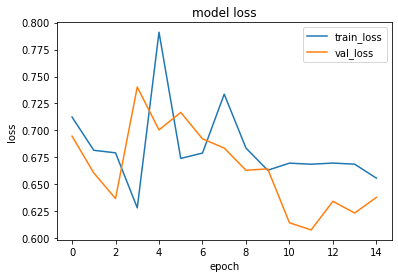

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.48862386]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.56637204]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5280261]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.48435667]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.4825714]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.4824652]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 175ms/step - loss: 0.6997 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6629 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 1s 207ms/step - loss: 0.6714 - accuracy: 0.6000 - precision: 0.7500 - recall: 0.3000 - val_loss: 0.6825 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6650 - accuracy: 0.6250 - precision: 0.6786 - recall: 0.4750 - val_loss: 0.6411 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6596 - accuracy: 0.6500 - precision: 0.6304 - recall: 0.7250 - val_loss: 0.6149 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoc

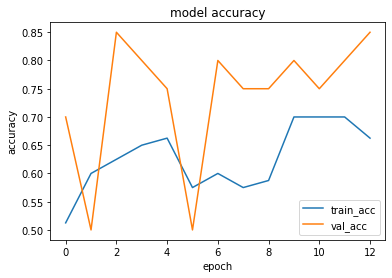

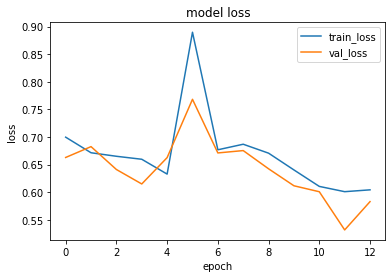

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5224014]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.5306701]]


1it [00:00, 17623.13it/s]


prediction for video armflapping_2.mov is [[0.54331315]]


1it [00:00, 12671.61it/s]


prediction for video control_1.mov is [[0.4974307]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.4749409]]


1it [00:00, 12787.51it/s]


prediction for video control_3.mov is [[0.47228864]]


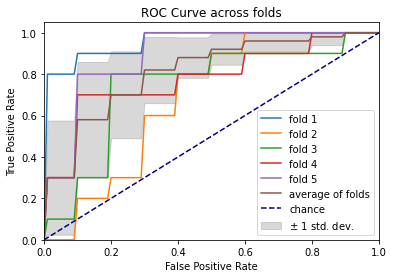

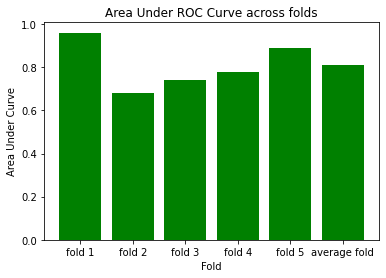

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7185 - accuracy: 0.5125 - precision: 0.5294 - recall: 0.2250 - val_loss: 0.6878 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6774 - accuracy: 0.5500 - precision: 0.5303 - recall: 0.8750 - val_loss: 0.6729 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6694 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6339 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6247 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6564 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 148ms/step 

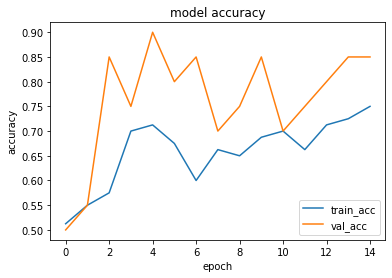

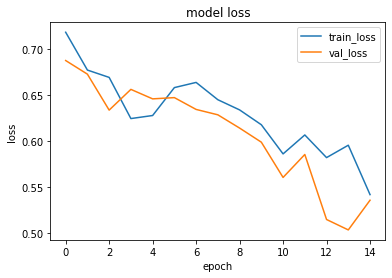

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.1246095]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.4609894]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.28288078]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.09463283]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.08889341]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.09500343]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 169ms/step - loss: 0.6944 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6564 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6826 - accuracy: 0.5625 - precision: 1.0000 - recall: 0.1250 - val_loss: 0.6246 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6539 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6298 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6504 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6206 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 5/75


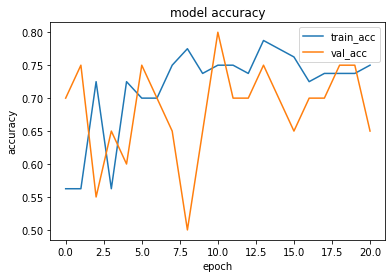

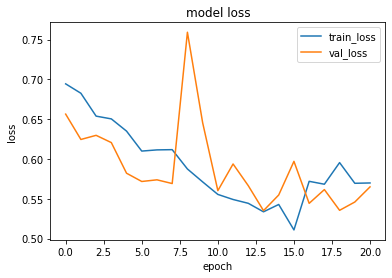

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.47889322]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.69026566]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.6774851]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.1854024]]


1it [00:00, 12052.60it/s]


prediction for video control_2.mov is [[0.16479409]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.21110079]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6838 - accuracy: 0.5750 - precision: 0.5517 - recall: 0.8000 - val_loss: 0.6284 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6496 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.5525 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6398 - accuracy: 0.7000 - precision: 0.8636 - recall: 0.4750 - val_loss: 0.6230 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6374 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.6226 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75


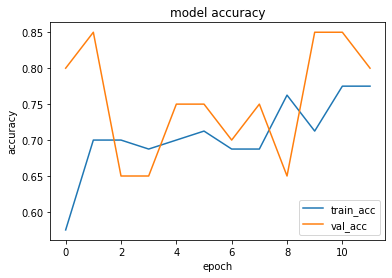

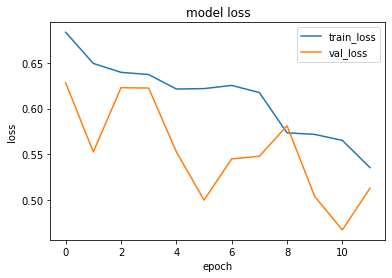

1it [00:00, 11366.68it/s]


prediction for video armflapping_1.mov is [[0.6760496]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.8289879]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.81542856]]


1it [00:00, 11915.64it/s]


prediction for video control_1.mov is [[0.347036]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.30365336]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.31260067]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6822 - accuracy: 0.6125 - precision: 0.6286 - recall: 0.5500 - val_loss: 0.7163 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7080 - accuracy: 0.6125 - precision: 0.5652 - recall: 0.9750 - val_loss: 1.0328 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 1.0913 - accuracy: 0.5250 - precision: 0.5833 - recall: 0.1750 - val_loss: 0.6914 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7095 - accuracy: 0.4750 - precision: 0.4773 - recall: 0.5250 - val_loss: 0.7356 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epo

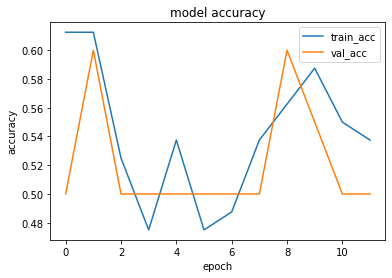

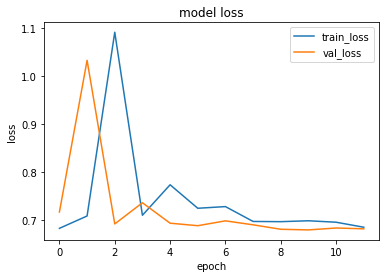

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.54753476]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.55156547]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5496773]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.5468456]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.5467231]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.54673225]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 162ms/step - loss: 0.6865 - accuracy: 0.5125 - precision: 0.5070 - recall: 0.9000 - val_loss: 0.6632 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6445 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.6860 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 1s 178ms/step - loss: 0.6218 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.6673 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6234 - accuracy: 0.6875 - precision: 0.8000 - recall: 0.5000 - val_loss: 0.7008 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


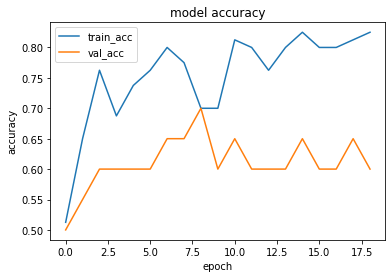

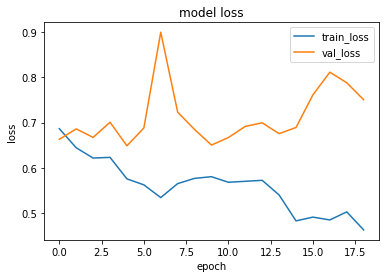

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.45749095]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.65904933]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.66738164]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.2976001]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.28016752]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.23484525]]


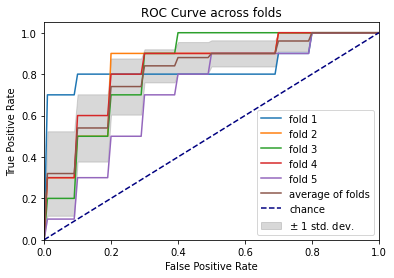

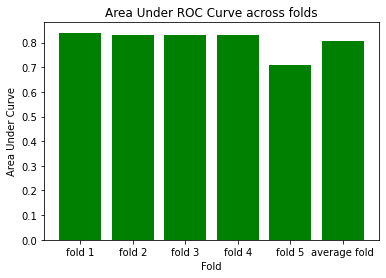

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6944 - accuracy: 0.4875 - precision: 0.4898 - recall: 0.6000 - val_loss: 0.6732 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6881 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.6621 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6443 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6489 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 183ms/step - loss: 0.6365 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6519 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 154ms/step 

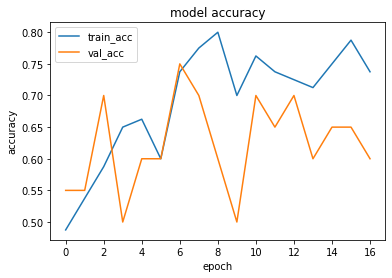

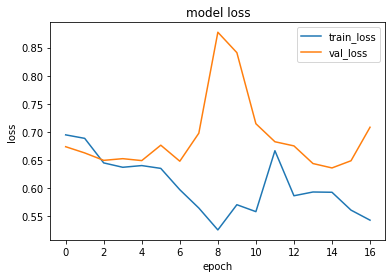

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.6088354]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.6997179]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_2.mov is [[0.71043783]]


1it [00:00, 14027.77it/s]


prediction for video control_1.mov is [[0.40458882]]


1it [00:00, 13662.23it/s]


prediction for video control_2.mov is [[0.263839]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.41497344]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6986 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6750 - val_loss: 0.6805 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6664 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6768 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6299 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.6865 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6165 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.6739 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


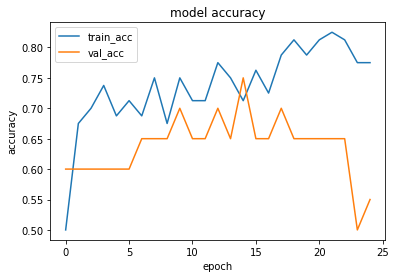

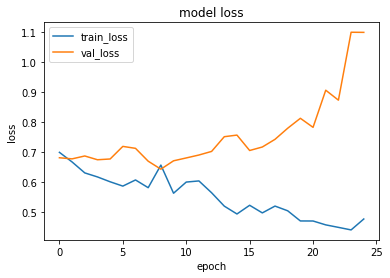

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.40669847]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.7805326]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7436433]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.61122745]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.6410457]]


1it [00:00, 12157.40it/s]


prediction for video control_3.mov is [[0.50824505]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 158ms/step - loss: 0.6939 - accuracy: 0.4875 - precision: 0.4706 - recall: 0.2000 - val_loss: 0.6562 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6839 - accuracy: 0.5500 - precision: 0.5345 - recall: 0.7750 - val_loss: 0.6245 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6512 - accuracy: 0.5875 - precision: 0.5574 - recall: 0.8500 - val_loss: 0.6469 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 201ms/step - loss: 0.6580 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.6392 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75


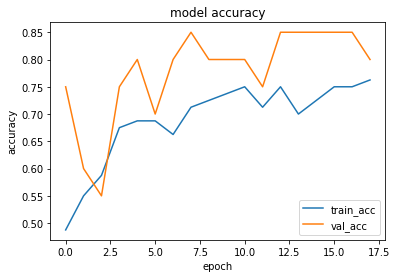

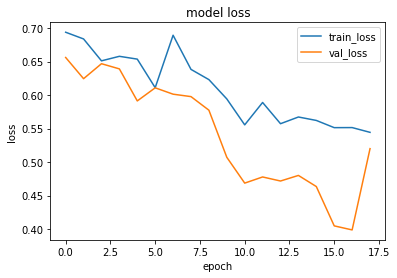

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.47504166]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.6921981]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.67187774]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.29869652]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.2537635]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.28956825]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 182ms/step - loss: 0.6984 - accuracy: 0.5250 - precision: 0.5833 - recall: 0.1750 - val_loss: 0.6844 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6833 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6530 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6909 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4500 - val_loss: 0.6376 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6602 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.5327 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75


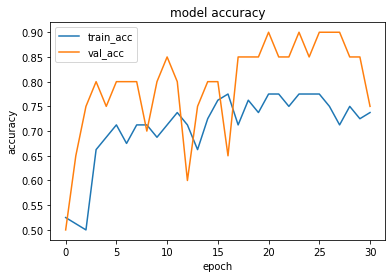

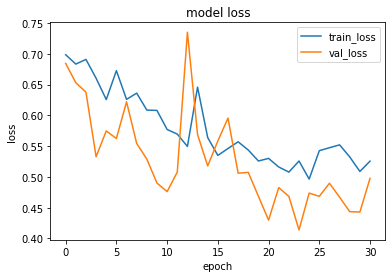

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.26398587]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.77157474]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.70596516]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.14757437]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.12425262]]


1it [00:00, 13486.51it/s]


prediction for video control_3.mov is [[0.1442625]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 184ms/step - loss: 0.6834 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.6789 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6077 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.7550 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6313 - accuracy: 0.5875 - precision: 0.5479 - recall: 1.0000 - val_loss: 0.7803 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 207ms/step - loss: 0.6837 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6674 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3

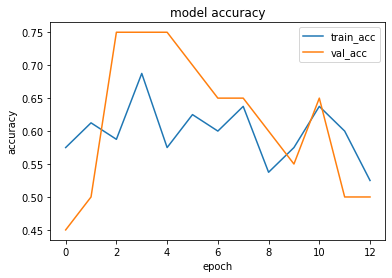

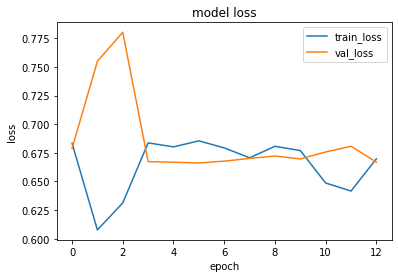

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.55105036]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.56791705]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.57322407]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.53170633]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.5226708]]


1it [00:00, 11491.24it/s]


prediction for video control_3.mov is [[0.5178671]]


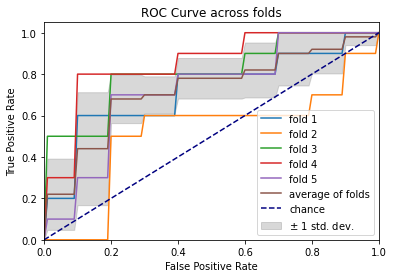

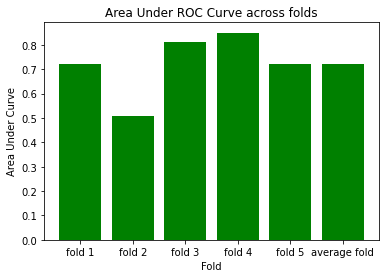

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 180ms/step - loss: 0.6859 - accuracy: 0.5625 - precision: 0.5532 - recall: 0.6500 - val_loss: 0.6719 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6561 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.6303 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6385 - accuracy: 0.7375 - precision: 0.8519 - recall: 0.5750 - val_loss: 0.6301 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6380 - accuracy: 0.7250 - precision: 0.8214 - recall: 0.5750 - val_loss: 0.6233 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 158ms/step 

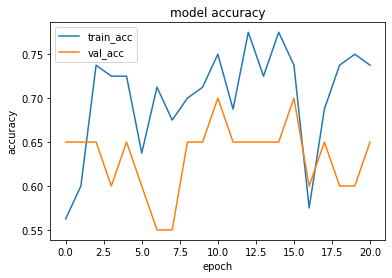

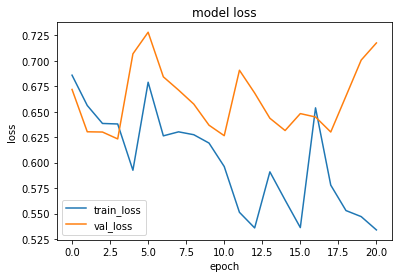

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.25192693]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.59222215]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.65189266]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.19749734]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.19007137]]


1it [00:00, 11491.24it/s]


prediction for video control_3.mov is [[0.18755418]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 185ms/step - loss: 0.7329 - accuracy: 0.3875 - precision: 0.2353 - recall: 0.1000 - val_loss: 0.6973 - val_accuracy: 0.3500 - val_precision: 0.4000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 1s 179ms/step - loss: 0.6943 - accuracy: 0.5375 - precision: 0.5238 - recall: 0.8250 - val_loss: 0.6682 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6700 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6451 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6987 - accuracy: 0.5875 - precision: 0.6400 - recall: 0.4000 - val_loss: 0.6237 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


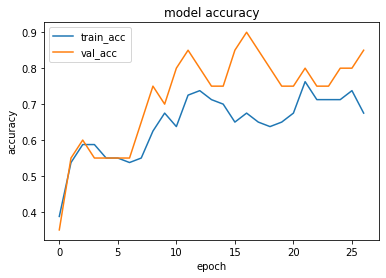

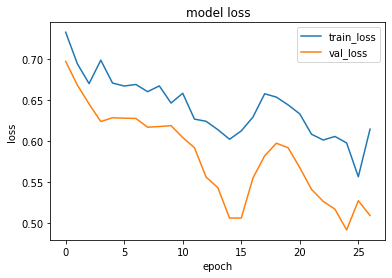

1it [00:00, 14027.77it/s]


prediction for video armflapping_1.mov is [[0.36439037]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.5080712]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.44046575]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.40157023]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.3701063]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.3652826]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 192ms/step - loss: 0.6840 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6330 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7001 - accuracy: 0.5500 - precision: 0.7500 - recall: 0.1500 - val_loss: 0.6406 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6589 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.6652 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 175ms/step - loss: 0.6817 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6517 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3

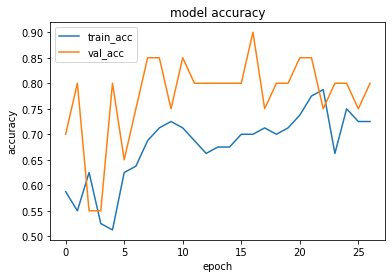

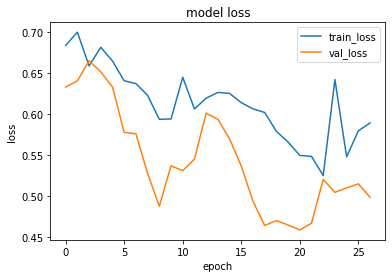

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4160632]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.53209805]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.52896655]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.35545146]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.32855165]]


1it [00:00, 12300.01it/s]


prediction for video control_3.mov is [[0.32095718]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 191ms/step - loss: 0.6993 - accuracy: 0.4750 - precision: 0.4706 - recall: 0.4000 - val_loss: 0.6646 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6912 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6253 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6543 - accuracy: 0.6750 - precision: 0.8182 - recall: 0.4500 - val_loss: 0.6426 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6724 - accuracy: 0.5125 - precision: 0.5714 - recall: 0.1000 - val_loss: 0.6372 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75


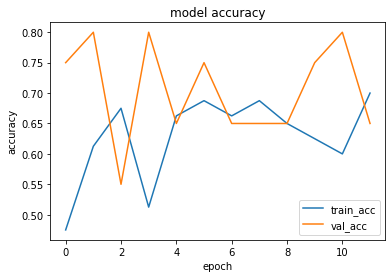

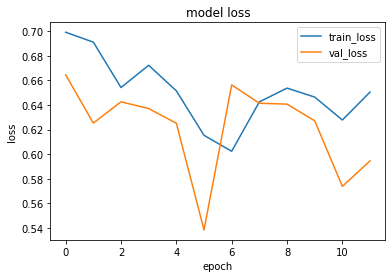

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.48273093]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.50621474]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.504537]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.45457846]]


1it [00:00, 17260.51it/s]


prediction for video control_2.mov is [[0.43759954]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.4361293]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 181ms/step - loss: 0.6920 - accuracy: 0.4250 - precision: 0.4444 - recall: 0.6000 - val_loss: 0.7086 - val_accuracy: 0.4000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7524 - accuracy: 0.6875 - precision: 1.0000 - recall: 0.3750 - val_loss: 0.7177 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6510 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.7982 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6803 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.7132 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoc

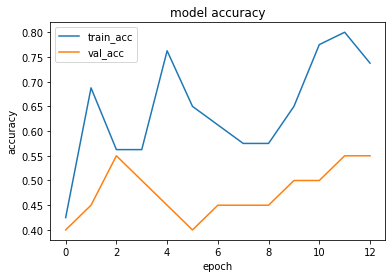

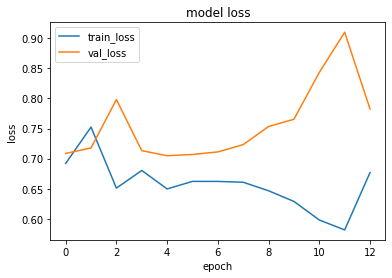

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.55573386]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.56415576]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.5848877]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.5290107]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.51245135]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.50876254]]


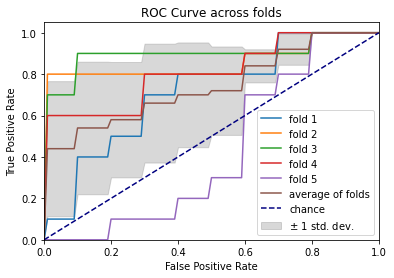

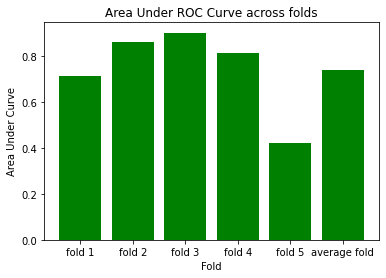

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6991 - accuracy: 0.5125 - precision: 0.5082 - recall: 0.7750 - val_loss: 0.6879 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 1s 223ms/step - loss: 0.6727 - accuracy: 0.5125 - precision: 0.6000 - recall: 0.0750 - val_loss: 0.6988 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6092 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.7963 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 169ms/step - loss: 0.7213 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.7127 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 155ms/step 

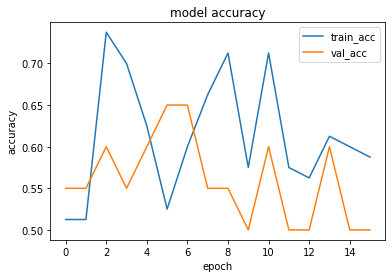

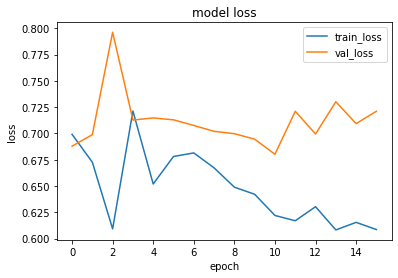

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5372058]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5467972]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.5656402]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.51000506]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.5000322]]


1it [00:00, 8756.38it/s]


prediction for video control_3.mov is [[0.49772176]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6970 - accuracy: 0.5125 - precision: 0.5161 - recall: 0.4000 - val_loss: 0.6769 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6586 - accuracy: 0.6250 - precision: 0.5758 - recall: 0.9500 - val_loss: 0.6830 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6448 - accuracy: 0.6125 - precision: 0.9091 - recall: 0.2500 - val_loss: 0.7184 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6613 - accuracy: 0.6875 - precision: 0.8261 - recall: 0.4750 - val_loss: 0.6890 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


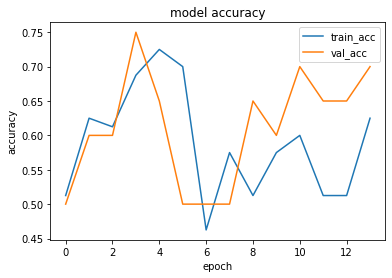

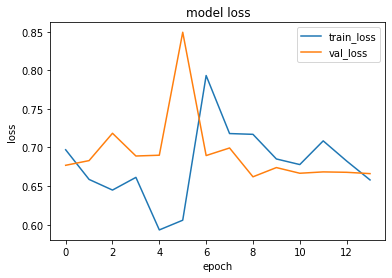

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.46594024]]


1it [00:00, 12157.40it/s]


prediction for video armflapping_3.mov is [[0.49117464]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.48687664]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.45637822]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.45343494]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.45388064]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6926 - accuracy: 0.5125 - precision: 0.5067 - recall: 0.9500 - val_loss: 0.6388 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6796 - accuracy: 0.5500 - precision: 0.6667 - recall: 0.2000 - val_loss: 0.5768 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6525 - accuracy: 0.6125 - precision: 0.8000 - recall: 0.3000 - val_loss: 0.4961 - val_accuracy: 0.9500 - val_precision: 0.9091 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6678 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.5820 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 5/75


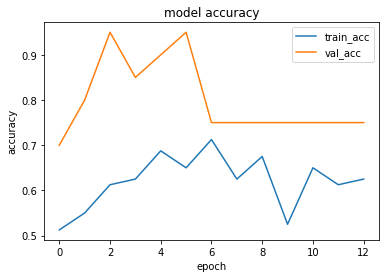

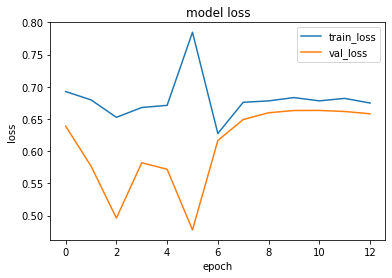

1it [00:00, 12865.96it/s]


prediction for video armflapping_1.mov is [[0.49517578]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.5396094]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.51178586]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.4896114]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.4882055]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.48839355]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7004 - accuracy: 0.4000 - precision: 0.3667 - recall: 0.2750 - val_loss: 0.6815 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6299 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.9150 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 168ms/step - loss: 0.9616 - accuracy: 0.5625 - precision: 0.6667 - recall: 0.2500 - val_loss: 0.7160 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.7173 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4250 - val_loss: 0.7131 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epo

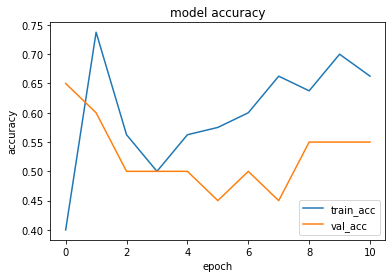

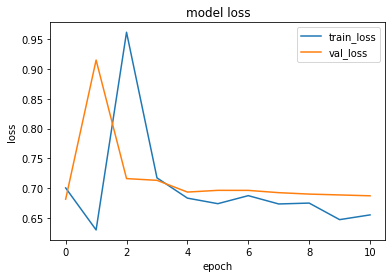

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.49689838]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5037939]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.534514]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.46408594]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.445621]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.4407581]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7089 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6703 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6885 - accuracy: 0.5875 - precision: 0.6522 - recall: 0.3750 - val_loss: 0.6693 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7014 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6549 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6536 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6155 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3

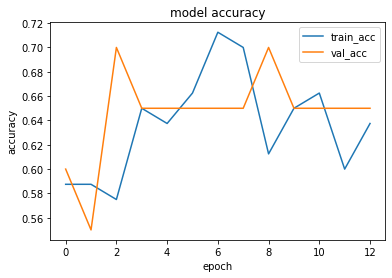

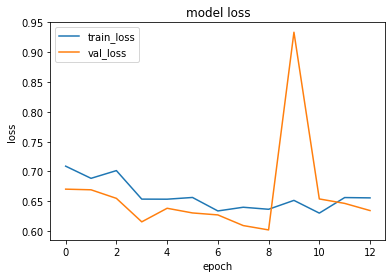

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.4516061]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.47002286]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.48150137]]


1it [00:00, 11781.75it/s]


prediction for video control_1.mov is [[0.4276477]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.41993028]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.41651422]]


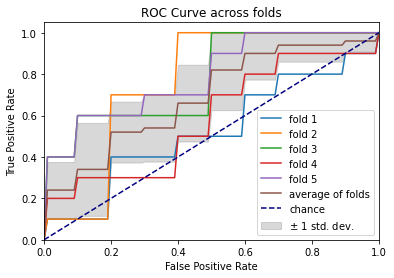

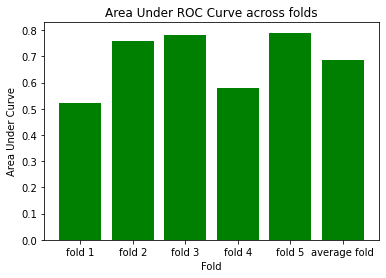

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 180ms/step - loss: 0.6928 - accuracy: 0.5500 - precision: 0.5312 - recall: 0.8500 - val_loss: 0.7139 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6822 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1750 - val_loss: 0.6938 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 1s 184ms/step - loss: 0.6104 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.7619 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 1.0161 - accuracy: 0.5750 - precision: 0.5682 - recall: 0.6250 - val_loss: 0.9949 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 5/75
3/3 [==============================] - 0s 155

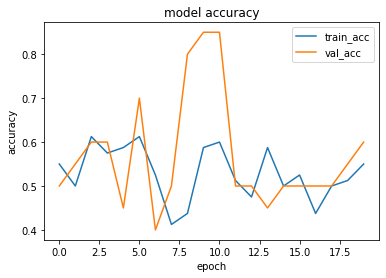

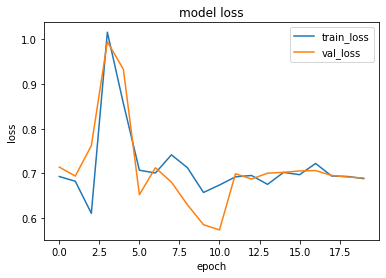

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.48062986]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.48178983]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.48012877]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.4807556]]


1it [00:00, 11915.64it/s]


prediction for video control_2.mov is [[0.48037213]]


1it [00:00, 11618.57it/s]


prediction for video control_3.mov is [[0.48032475]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 180ms/step - loss: 0.7058 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.2000 - val_loss: 0.6743 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 219ms/step - loss: 0.6911 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6426 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6618 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.6234 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6545 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.5785 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 5/75


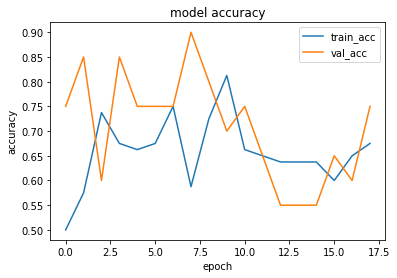

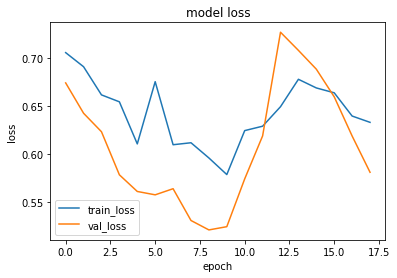

1it [00:00, 17623.13it/s]


prediction for video armflapping_1.mov is [[0.5018685]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.59147966]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.54609746]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.4873027]]


1it [00:00, 12228.29it/s]


prediction for video control_2.mov is [[0.48503843]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.4822931]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7010 - accuracy: 0.5250 - precision: 0.5278 - recall: 0.4750 - val_loss: 0.6683 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6757 - accuracy: 0.6375 - precision: 0.6170 - recall: 0.7250 - val_loss: 0.6248 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6477 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.5240 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6596 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.5971 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75
3

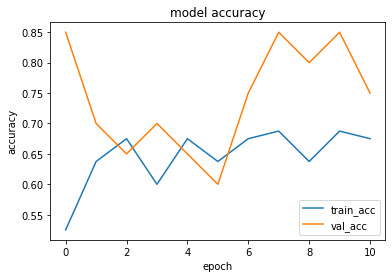

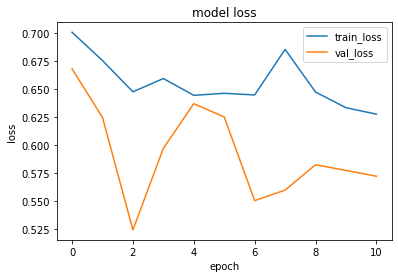

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.43258613]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.48179537]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.47101784]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.41014668]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.40268284]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.39873123]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6974 - accuracy: 0.4125 - precision: 0.3871 - recall: 0.3000 - val_loss: 0.6516 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6503 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.7202 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7004 - accuracy: 0.5875 - precision: 0.7059 - recall: 0.3000 - val_loss: 0.6635 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6624 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6704 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

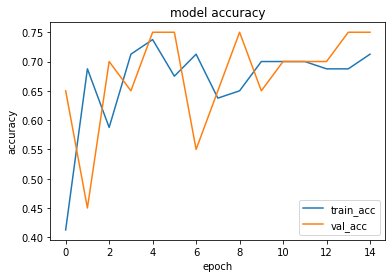

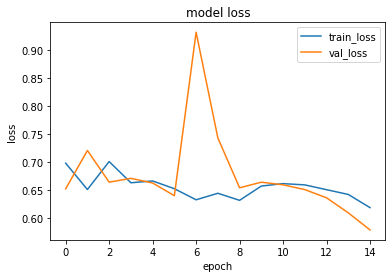

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.4447546]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.50830144]]


1it [00:00, 9279.43it/s]


prediction for video armflapping_2.mov is [[0.52624106]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.40384153]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.38927114]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.39502844]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7004 - accuracy: 0.4375 - precision: 0.4359 - recall: 0.4250 - val_loss: 0.6977 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6421 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 1.0580 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6878 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6980 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6451 - accuracy: 0.6625 - precision: 0.8421 - recall: 0.4000 - val_loss: 0.7003 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


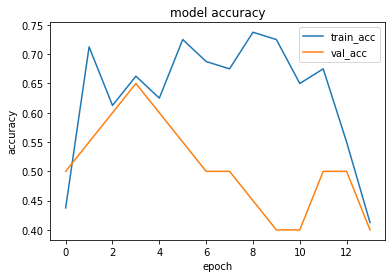

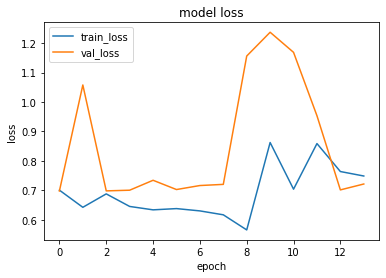

1it [00:00, 12483.05it/s]


prediction for video armflapping_1.mov is [[0.5522225]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.44913477]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.5564431]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.3964423]]


1it [00:00, 10330.80it/s]


prediction for video control_2.mov is [[0.39612132]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.5517137]]


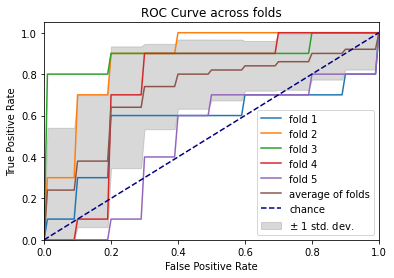

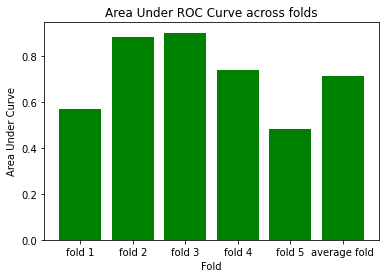

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 202ms/step - loss: 0.6753 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6656 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6054 - accuracy: 0.6250 - precision: 0.5806 - recall: 0.9000 - val_loss: 0.9224 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6182 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.7778 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6762 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.7199 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 147ms/step 

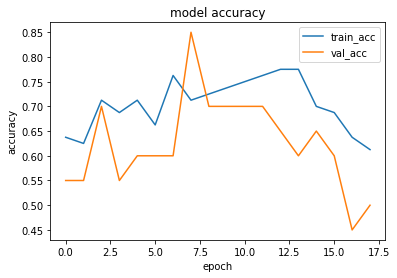

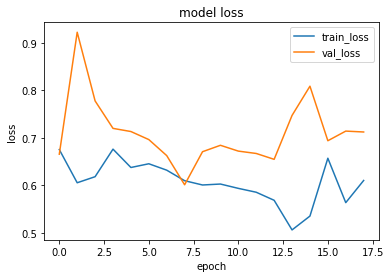

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.49789345]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5858759]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_2.mov is [[0.5461721]]


1it [00:00, 7463.17it/s]


prediction for video control_1.mov is [[0.48149574]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.4831512]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.4823374]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6860 - accuracy: 0.4875 - precision: 0.4615 - recall: 0.1500 - val_loss: 0.6374 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6623 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6123 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6321 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.7251 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6264 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.7251 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75
3

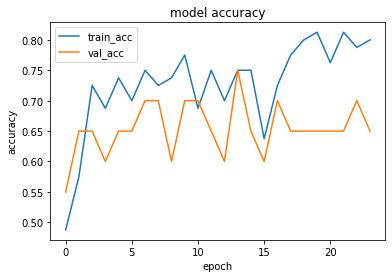

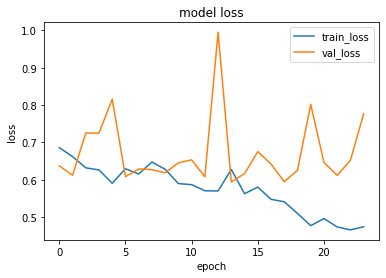

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.48664966]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.6791514]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.6258981]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.40745693]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.3736776]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.35967088]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 166ms/step - loss: 0.7081 - accuracy: 0.5125 - precision: 0.5070 - recall: 0.9000 - val_loss: 0.6629 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6820 - accuracy: 0.5500 - precision: 0.6429 - recall: 0.2250 - val_loss: 0.6293 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6545 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.5902 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6665 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.5679 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 5/75


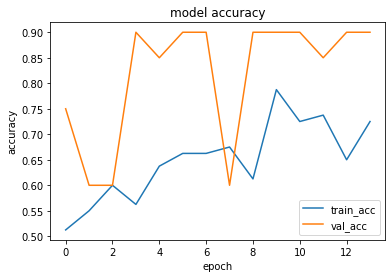

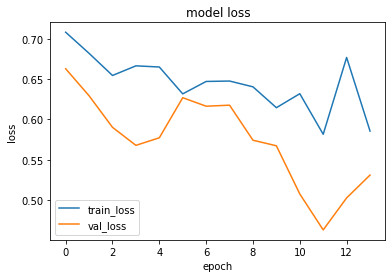

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.44852495]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.49566698]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.4955536]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.41633037]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.40253907]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.3989976]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6860 - accuracy: 0.5125 - precision: 0.5128 - recall: 0.5000 - val_loss: 0.6628 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 216ms/step - loss: 0.6961 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.6913 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7520 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6824 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6715 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6801 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3

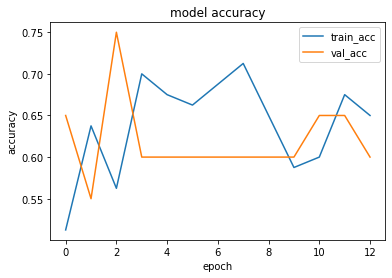

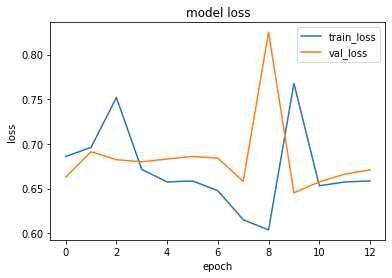

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.4997271]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.5200634]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_2.mov is [[0.5141082]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.48518977]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.4809398]]


1it [00:00, 13025.79it/s]


prediction for video control_3.mov is [[0.48061788]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6944 - accuracy: 0.4375 - precision: 0.4528 - recall: 0.6000 - val_loss: 0.6996 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6923 - accuracy: 0.6125 - precision: 0.6154 - recall: 0.6000 - val_loss: 0.6958 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7144 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6565 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6868 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.6727 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epo

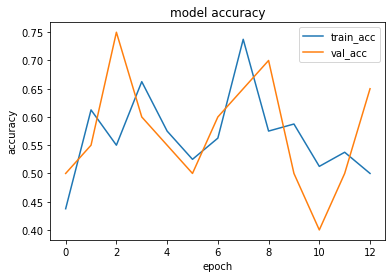

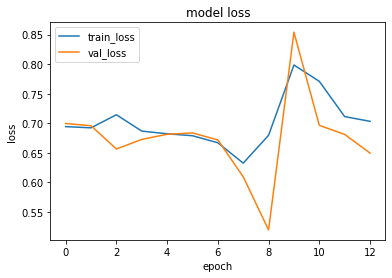

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.5221364]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_3.mov is [[0.4574827]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.46124345]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.48929894]]


1it [00:00, 11244.78it/s]


prediction for video control_2.mov is [[0.43739924]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.43805987]]


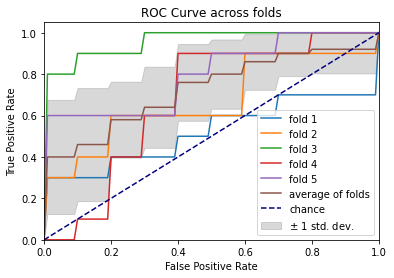

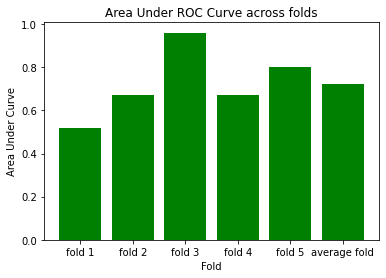

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6842 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7500 - val_loss: 0.7562 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6805 - accuracy: 0.7000 - precision: 0.6333 - recall: 0.9500 - val_loss: 0.7506 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6936 - accuracy: 0.5750 - precision: 0.7500 - recall: 0.2250 - val_loss: 0.6834 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6676 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6848 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 147

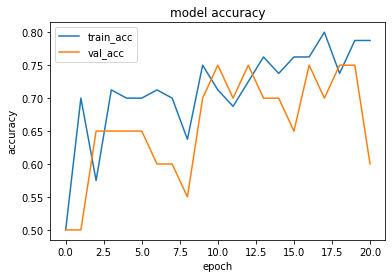

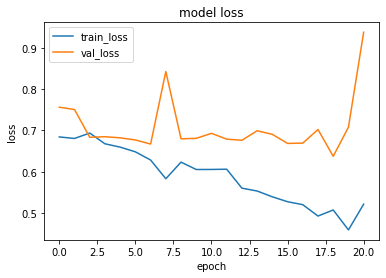

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.15338075]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.18292281]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.18893647]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.14236677]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.13999149]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.13803488]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6927 - accuracy: 0.5250 - precision: 0.5227 - recall: 0.5750 - val_loss: 0.6720 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7978 - accuracy: 0.6125 - precision: 0.6667 - recall: 0.4500 - val_loss: 0.6702 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6573 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6824 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6723 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6725 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


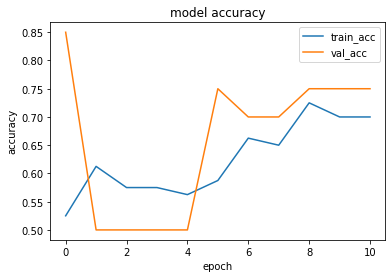

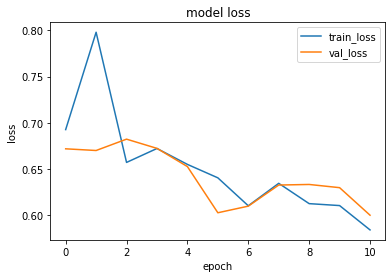

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.5361632]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.6300416]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.68862283]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.13727179]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.11945647]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.31045815]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 181ms/step - loss: 0.6944 - accuracy: 0.4750 - precision: 0.4286 - recall: 0.1500 - val_loss: 0.6647 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6950 - accuracy: 0.5125 - precision: 0.5067 - recall: 0.9500 - val_loss: 0.6332 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6654 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6458 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6423 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.5954 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75


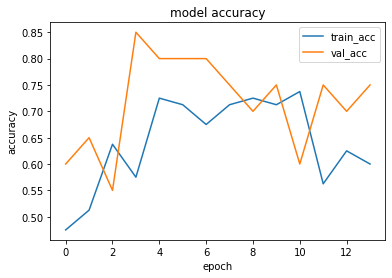

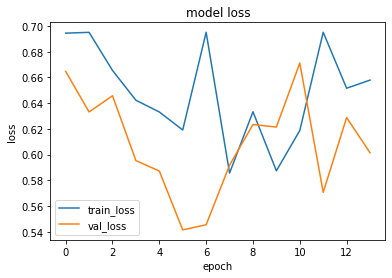

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.4948709]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.5897837]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.52198595]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.47897515]]


1it [00:00, 17189.77it/s]


prediction for video control_2.mov is [[0.47731665]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.476327]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 166ms/step - loss: 0.6981 - accuracy: 0.4500 - precision: 0.4444 - recall: 0.4000 - val_loss: 0.6748 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6535 - accuracy: 0.6875 - precision: 0.6230 - recall: 0.9500 - val_loss: 0.6837 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6306 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.6649 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6350 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 0.6543 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75
3/

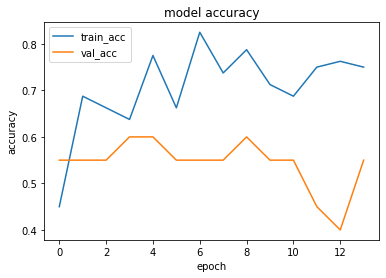

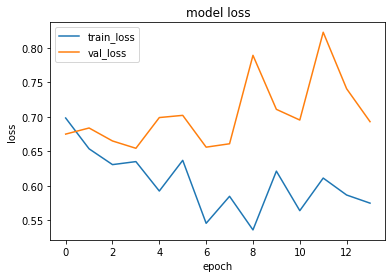

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.4452629]]


1it [00:00, 10512.04it/s]


prediction for video armflapping_3.mov is [[0.4838102]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.48998874]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.41446155]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.40175405]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.399706]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 174ms/step - loss: 0.7157 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6868 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 209ms/step - loss: 0.6865 - accuracy: 0.5500 - precision: 0.5500 - recall: 0.5500 - val_loss: 0.6752 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6708 - accuracy: 0.7500 - precision: 0.7083 - recall: 0.8500 - val_loss: 0.6227 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 169ms/step - loss: 0.7307 - accuracy: 0.5875 - precision: 0.5614 - recall: 0.8000 - val_loss: 0.6603 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch

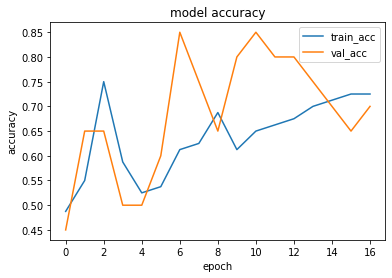

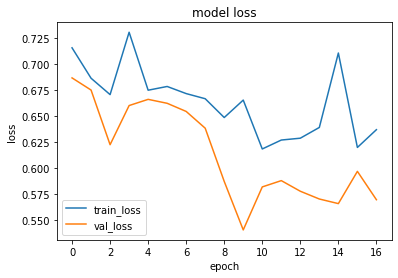

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.49594215]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5506156]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.5406613]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.4638155]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.45178896]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.44547266]]


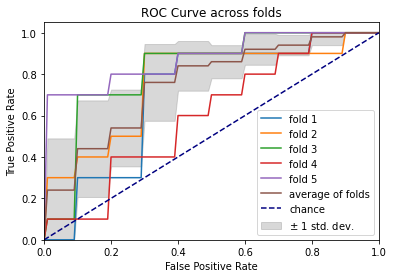

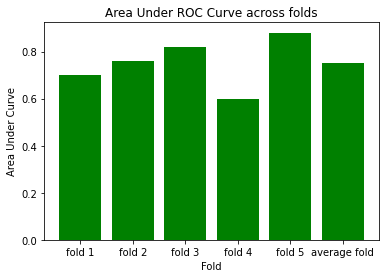

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6822 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6725 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6851 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.6433 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6514 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.6782 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6650 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6863 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] - 0s 156ms/step 

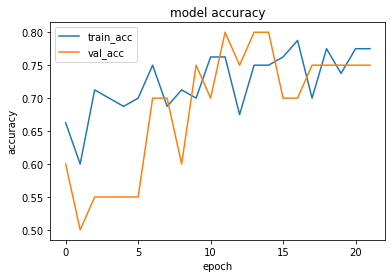

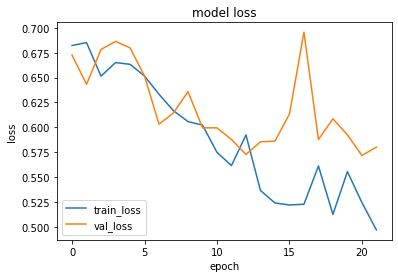

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.5282452]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.79451746]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.755265]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.35509002]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.3239873]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.3346767]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7068 - accuracy: 0.4750 - precision: 0.4783 - recall: 0.5500 - val_loss: 0.6842 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 176ms/step - loss: 0.6750 - accuracy: 0.6000 - precision: 0.6667 - recall: 0.4000 - val_loss: 0.6817 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6461 - accuracy: 0.7250 - precision: 0.8750 - recall: 0.5250 - val_loss: 0.7083 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6373 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6554 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 5/75
3

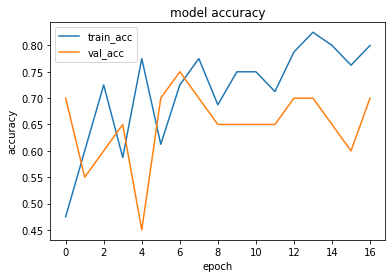

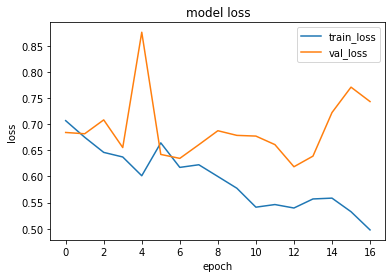

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.26140568]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.5277442]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.67977536]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.20080826]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.18691817]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.18670765]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7002 - accuracy: 0.4625 - precision: 0.4000 - recall: 0.1500 - val_loss: 0.6908 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6375 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.7209 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.7536 - accuracy: 0.5875 - precision: 0.5897 - recall: 0.5750 - val_loss: 0.6746 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6326 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.6899 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75


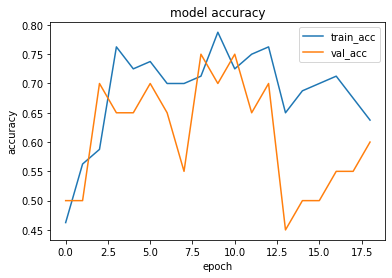

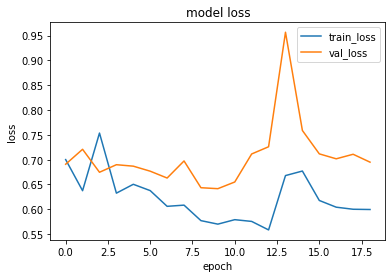

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.31992462]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.59248185]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.32371196]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.317972]]


1it [00:00, 12483.05it/s]


prediction for video control_2.mov is [[0.3172505]]


1it [00:00, 17623.13it/s]


prediction for video control_3.mov is [[0.3171686]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6890 - accuracy: 0.4750 - precision: 0.4286 - recall: 0.1500 - val_loss: 0.6745 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7182 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6712 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6655 - accuracy: 0.5875 - precision: 0.5745 - recall: 0.6750 - val_loss: 0.6836 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6530 - accuracy: 0.6250 - precision: 0.8571 - recall: 0.3000 - val_loss: 0.6707 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 5/75
3

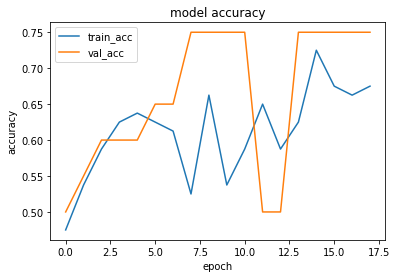

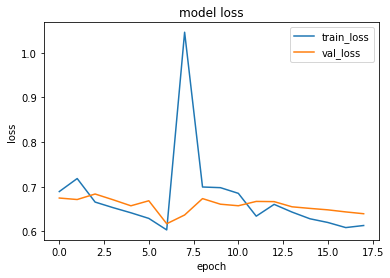

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.47640458]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_3.mov is [[0.5408457]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.511275]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.45922282]]


1it [00:00, 12520.31it/s]


prediction for video control_2.mov is [[0.45432928]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.4519383]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7402 - accuracy: 0.4875 - precision: 0.4615 - recall: 0.1500 - val_loss: 0.6888 - val_accuracy: 0.2500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 1s 212ms/step - loss: 0.6971 - accuracy: 0.4375 - precision: 0.4576 - recall: 0.6750 - val_loss: 0.6707 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6801 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6465 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6544 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6053 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoc

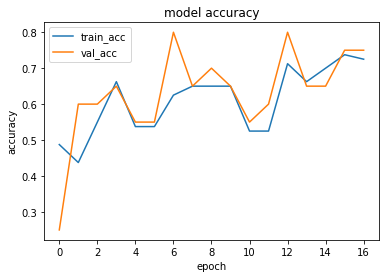

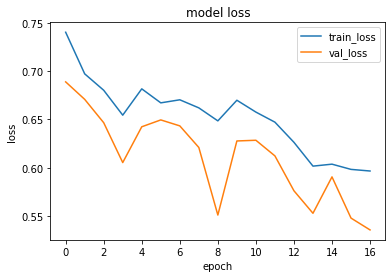

1it [00:00, 12372.58it/s]


prediction for video armflapping_1.mov is [[0.3478263]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5539746]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5617245]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.28416103]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.26996142]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.3012381]]


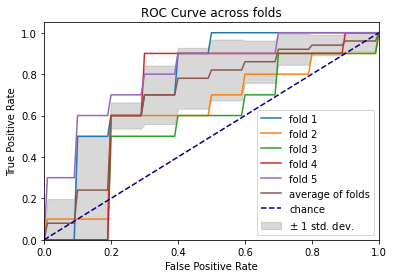

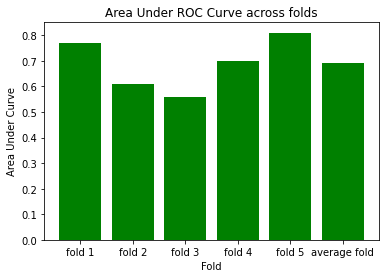

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 188ms/step - loss: 0.6891 - accuracy: 0.5125 - precision: 0.5333 - recall: 0.2000 - val_loss: 0.6971 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6859 - accuracy: 0.6500 - precision: 0.5909 - recall: 0.9750 - val_loss: 0.6736 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 1s 189ms/step - loss: 0.6714 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6305 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7120 - accuracy: 0.6125 - precision: 0.5818 - recall: 0.8000 - val_loss: 0.5771 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 152ms/step 

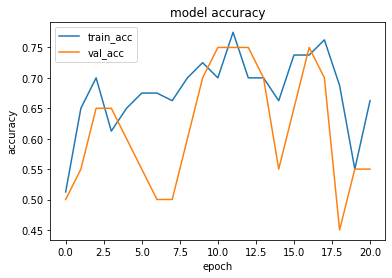

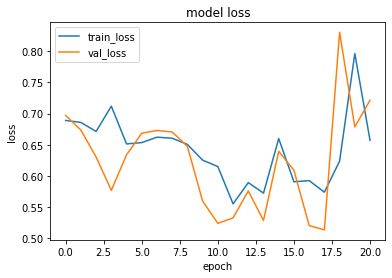

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.45853856]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_3.mov is [[0.57933855]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.50962603]]


1it [00:00, 10979.85it/s]


prediction for video control_1.mov is [[0.42604423]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.45133394]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.4428289]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6970 - accuracy: 0.4125 - precision: 0.4314 - recall: 0.5500 - val_loss: 0.6740 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6503 - accuracy: 0.5125 - precision: 0.5152 - recall: 0.4250 - val_loss: 0.7766 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 180ms/step - loss: 0.6424 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.6397 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6507 - accuracy: 0.7000 - precision: 0.8077 - recall: 0.5250 - val_loss: 0.6677 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

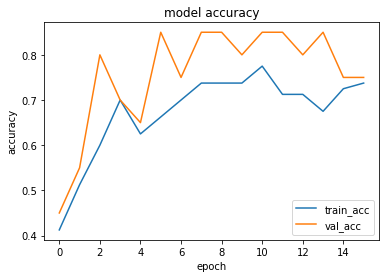

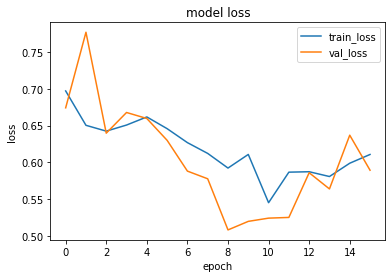

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5141063]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.5868965]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.55669343]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.47103098]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.45645887]]


1it [00:00, 12052.60it/s]


prediction for video control_3.mov is [[0.44964895]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6924 - accuracy: 0.4875 - precision: 0.4839 - recall: 0.3750 - val_loss: 0.6780 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6453 - accuracy: 0.6250 - precision: 0.5806 - recall: 0.9000 - val_loss: 0.7032 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7550 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6599 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6869 - accuracy: 0.5500 - precision: 0.5625 - recall: 0.4500 - val_loss: 0.6757 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 5/75


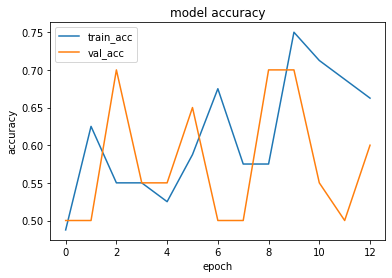

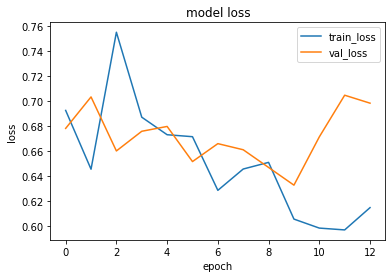

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.46431917]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.43619516]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.4788174]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.4527173]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.4455345]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.44225615]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 212ms/step - loss: 0.6847 - accuracy: 0.4625 - precision: 0.4651 - recall: 0.5000 - val_loss: 0.7289 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.8568 - accuracy: 0.5875 - precision: 0.6061 - recall: 0.5000 - val_loss: 0.7198 - val_accuracy: 0.4000 - val_precision: 0.4375 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6289 - accuracy: 0.5875 - precision: 0.5479 - recall: 1.0000 - val_loss: 0.8247 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6382 - accuracy: 0.7000 - precision: 0.6333 - recall: 0.9500 - val_loss: 0.7356 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 5/75


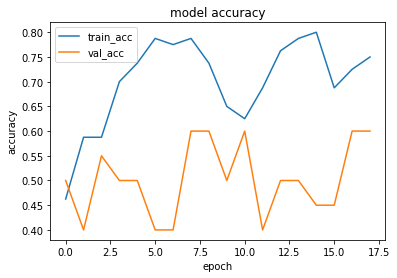

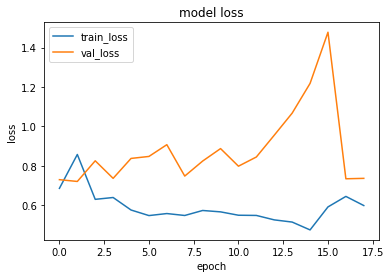

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.5223291]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_3.mov is [[0.48929617]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.52110386]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.485414]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.4587444]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.46234727]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 170ms/step - loss: 0.6967 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6496 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6840 - accuracy: 0.6250 - precision: 0.8125 - recall: 0.3250 - val_loss: 0.6385 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6743 - accuracy: 0.6250 - precision: 0.7778 - recall: 0.3500 - val_loss: 0.6550 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6722 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6546 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75


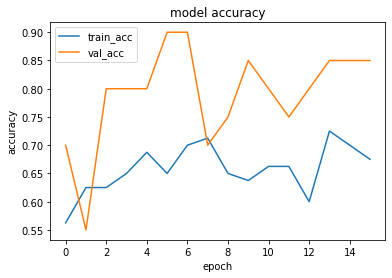

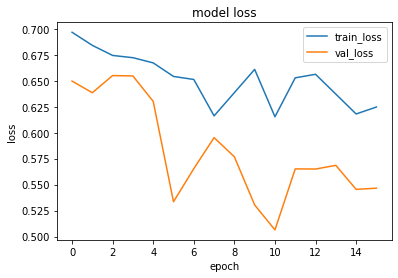

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4826229]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_3.mov is [[0.548037]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.5457572]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.43733346]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.42053527]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.41031536]]


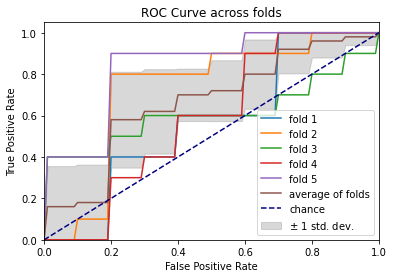

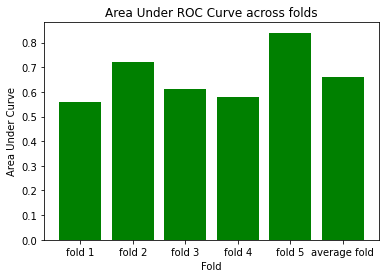

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 185ms/step - loss: 0.6967 - accuracy: 0.4375 - precision: 0.4074 - recall: 0.2750 - val_loss: 0.6780 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6788 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6721 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6775 - accuracy: 0.5375 - precision: 0.6667 - recall: 0.1500 - val_loss: 0.6710 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 1s 239ms/step - loss: 0.6737 - accuracy: 0.5750 - precision: 0.8750 - recall: 0.1750 - val_loss: 0.6496 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 5/75
3/3 [==============================] - 0s 154

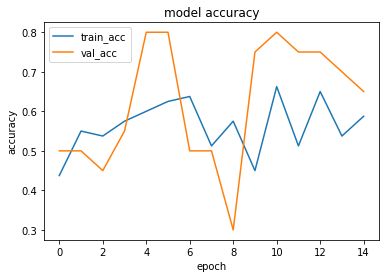

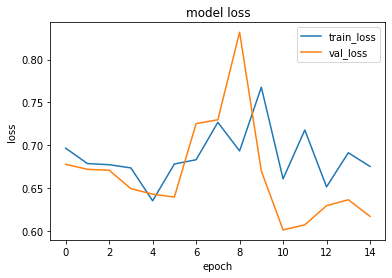

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.52445817]]


1it [00:00, 10894.30it/s]


prediction for video armflapping_3.mov is [[0.5688959]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.5346661]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.5216701]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.52242434]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.5219903]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7091 - accuracy: 0.4125 - precision: 0.4286 - recall: 0.5250 - val_loss: 0.6925 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6701 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.6549 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6600 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.8304 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.8001 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.8356 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 5/75
3

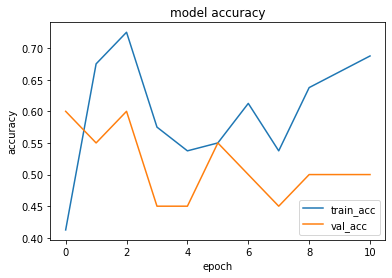

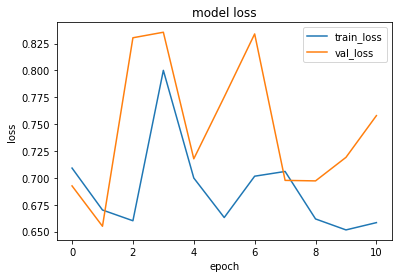

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.2731213]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.27375036]]


1it [00:00, 7449.92it/s]


prediction for video armflapping_2.mov is [[0.27331102]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.27310538]]


1it [00:00, 16194.22it/s]


prediction for video control_2.mov is [[0.27312195]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.27312618]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6848 - accuracy: 0.5125 - precision: 0.5067 - recall: 0.9500 - val_loss: 0.6702 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.9595 - accuracy: 0.5125 - precision: 0.6667 - recall: 0.0500 - val_loss: 0.6851 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 182ms/step - loss: 0.6796 - accuracy: 0.5625 - precision: 0.5610 - recall: 0.5750 - val_loss: 0.6910 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6645 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.6855 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75


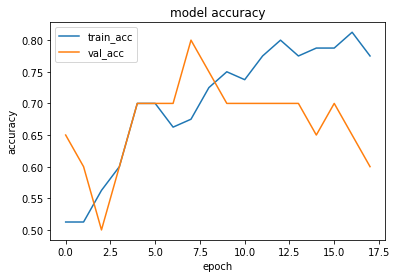

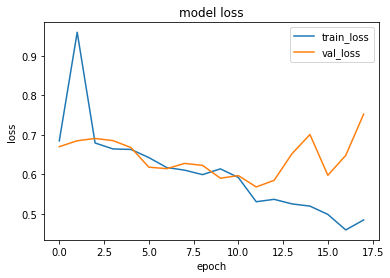

1it [00:00, 16320.25it/s]


prediction for video armflapping_1.mov is [[0.45659775]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.71813035]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_2.mov is [[0.76070786]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.26678318]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.25271887]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.22811916]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6883 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7750 - val_loss: 0.7026 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7106 - accuracy: 0.5750 - precision: 0.5536 - recall: 0.7750 - val_loss: 0.6682 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6697 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6657 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6536 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.6139 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75


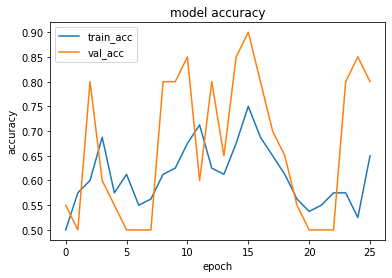

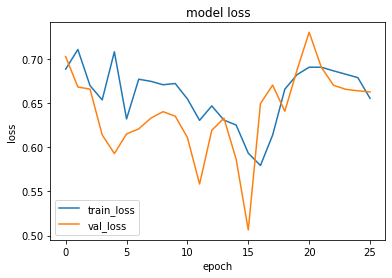

1it [00:00, 18893.26it/s]


prediction for video armflapping_1.mov is [[0.49132118]]


1it [00:00, 11781.75it/s]


prediction for video armflapping_3.mov is [[0.51598275]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.5028484]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.4902273]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.49070573]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.4902306]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 168ms/step - loss: 0.6904 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3750 - val_loss: 0.6710 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6854 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6492 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6518 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6630 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6441 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6254 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75
3

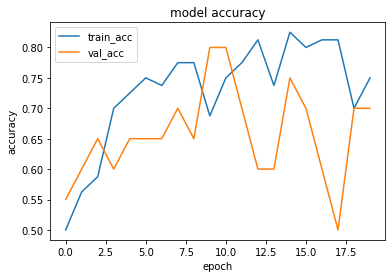

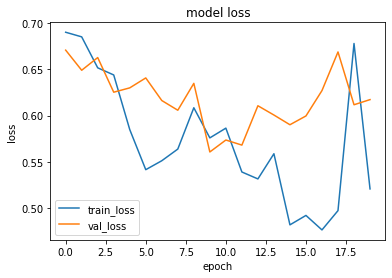

1it [00:00, 6462.72it/s]


prediction for video armflapping_1.mov is [[0.42886525]]


1it [00:00, 20068.44it/s]


prediction for video armflapping_3.mov is [[0.5432046]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.5243353]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.37283438]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.35348165]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.34502786]]


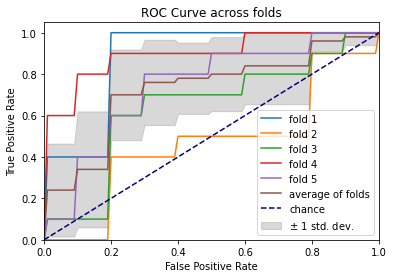

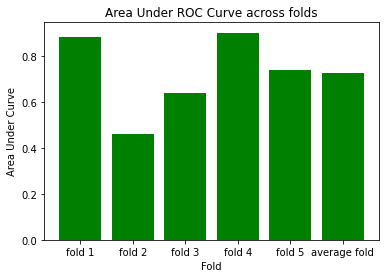

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 181ms/step - loss: 0.6928 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6250 - val_loss: 0.6570 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7302 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6513 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6523 - accuracy: 0.6625 - precision: 0.7826 - recall: 0.4500 - val_loss: 0.6516 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6386 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6263 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 152ms/step 

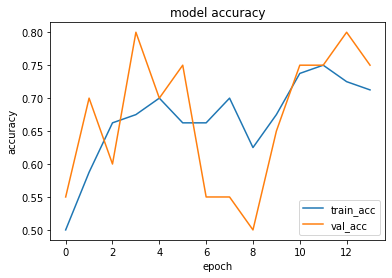

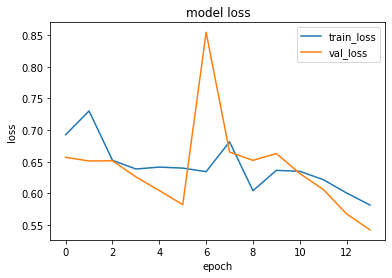

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.20580092]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.54751724]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.55399275]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.1560455]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.14749584]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.16280735]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6896 - accuracy: 0.5250 - precision: 0.5278 - recall: 0.4750 - val_loss: 0.6422 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6598 - accuracy: 0.6250 - precision: 0.7500 - recall: 0.3750 - val_loss: 0.5628 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6462 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.5244 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7596 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 0.6678 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75


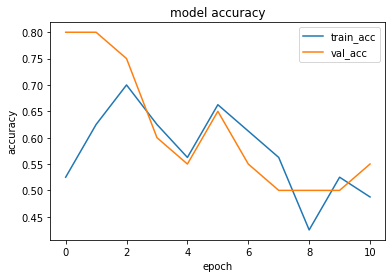

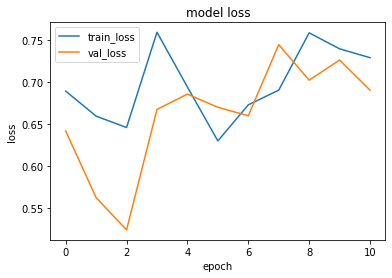

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.50827837]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.49766737]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_2.mov is [[0.52097636]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.5039229]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.50224125]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.50196093]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6971 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.7450 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6810 - accuracy: 0.4875 - precision: 0.4937 - recall: 0.9750 - val_loss: 0.6742 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6785 - accuracy: 0.6375 - precision: 0.6667 - recall: 0.5500 - val_loss: 0.6764 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6770 - accuracy: 0.6375 - precision: 0.8667 - recall: 0.3250 - val_loss: 0.6621 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


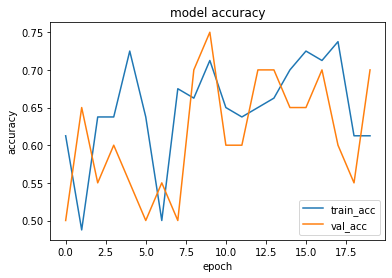

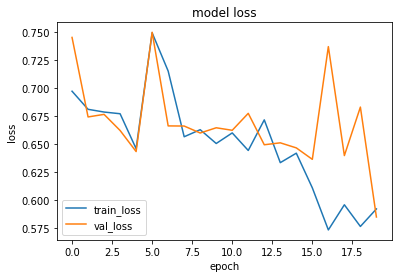

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5892539]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.65063244]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5909242]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.5558725]]


1it [00:00, 9020.01it/s]


prediction for video control_2.mov is [[0.54489034]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.54394495]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6993 - accuracy: 0.4750 - precision: 0.4839 - recall: 0.7500 - val_loss: 0.6843 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6824 - accuracy: 0.5500 - precision: 0.7500 - recall: 0.1500 - val_loss: 0.6912 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6780 - accuracy: 0.5375 - precision: 0.7143 - recall: 0.1250 - val_loss: 0.6690 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6290 - accuracy: 0.6875 - precision: 0.6271 - recall: 0.9250 - val_loss: 0.8169 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epo

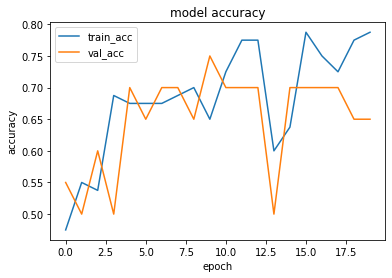

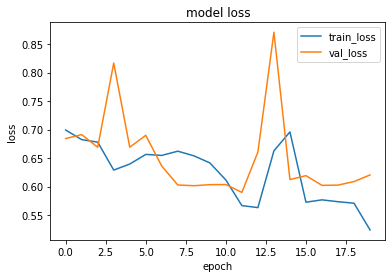

1it [00:00, 14563.56it/s]


prediction for video armflapping_1.mov is [[0.30810887]]


1it [00:00, 9341.43it/s]


prediction for video armflapping_3.mov is [[0.39302006]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.59410644]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.27276465]]


1it [00:00, 9000.65it/s]


prediction for video control_2.mov is [[0.26128381]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.25411355]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6999 - accuracy: 0.5125 - precision: 0.5079 - recall: 0.8000 - val_loss: 0.6802 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6751 - accuracy: 0.6625 - precision: 0.8824 - recall: 0.3750 - val_loss: 0.6541 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6466 - accuracy: 0.5750 - precision: 0.5625 - recall: 0.6750 - val_loss: 0.5340 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5952 - accuracy: 0.7875 - precision: 0.7949 - recall: 0.7750 - val_loss: 0.7091 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


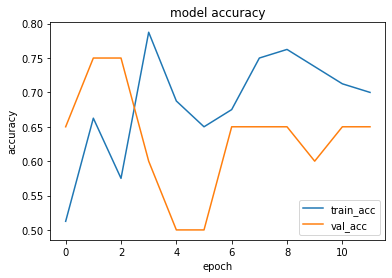

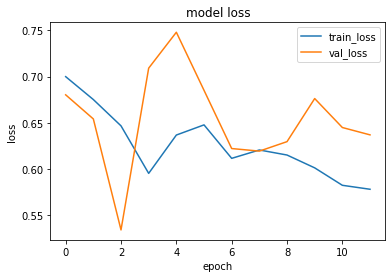

1it [00:00, 14027.77it/s]


prediction for video armflapping_1.mov is [[0.4209401]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.45070776]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.47608644]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.38586545]]


1it [00:00, 12192.74it/s]


prediction for video control_2.mov is [[0.36591333]]


1it [00:00, 8612.53it/s]


prediction for video control_3.mov is [[0.36292827]]


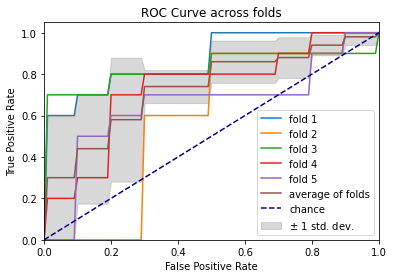

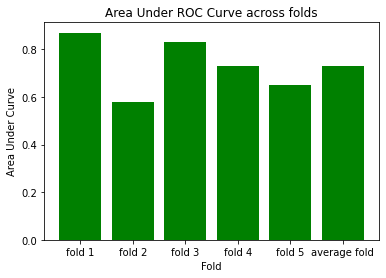

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 185ms/step - loss: 0.6973 - accuracy: 0.4125 - precision: 0.4255 - recall: 0.5000 - val_loss: 0.6898 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6728 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6537 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6401 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6512 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6167 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.7273 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 153ms/step 

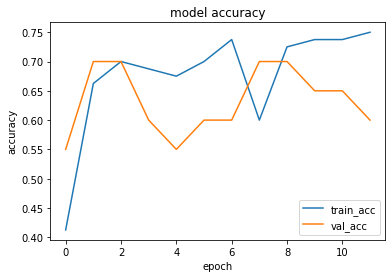

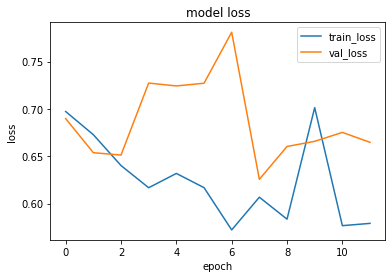

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.52635545]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.60078907]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.58885795]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.47381252]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.45693243]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.44513154]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7041 - accuracy: 0.4125 - precision: 0.4386 - recall: 0.6250 - val_loss: 0.6823 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6801 - accuracy: 0.5500 - precision: 0.5714 - recall: 0.4000 - val_loss: 0.6550 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6670 - accuracy: 0.5250 - precision: 0.5208 - recall: 0.6250 - val_loss: 0.6212 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6298 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6237 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epo

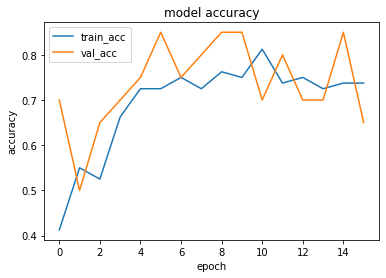

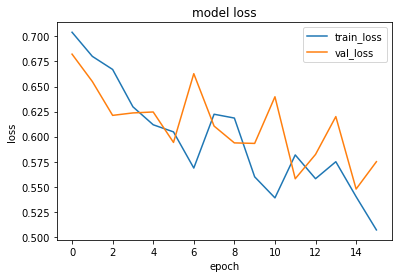

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.62793255]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.75924784]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.7115271]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.5587799]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.5372254]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.5212146]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6907 - accuracy: 0.5250 - precision: 0.5455 - recall: 0.3000 - val_loss: 0.6700 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6970 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6500 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6390 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.6714 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6531 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6666 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3

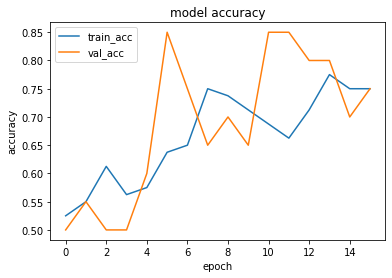

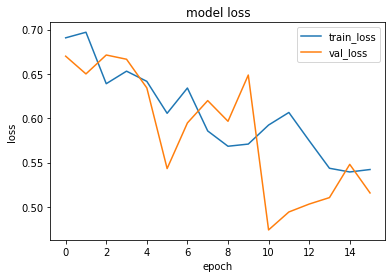

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.29533076]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.43054244]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.4574707]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.2432706]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.22936139]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.22484377]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7041 - accuracy: 0.5500 - precision: 0.8333 - recall: 0.1250 - val_loss: 0.7146 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6654 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.7499 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6244 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.7785 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5825 - accuracy: 0.6500 - precision: 0.5938 - recall: 0.9500 - val_loss: 0.9034 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 5/75


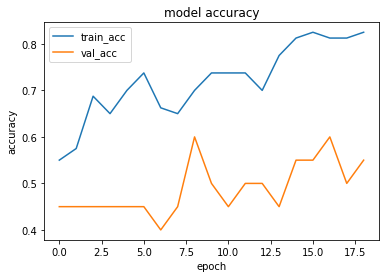

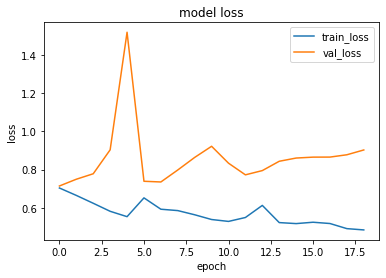

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.2944348]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.3689021]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.58227503]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.24548188]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.22844362]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.21750608]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 206ms/step - loss: 0.6946 - accuracy: 0.5500 - precision: 0.5385 - recall: 0.7000 - val_loss: 0.6620 - val_accuracy: 0.4000 - val_precision: 0.2500 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6808 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5750 - val_loss: 0.6318 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6678 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.6128 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 181ms/step - loss: 0.6875 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.5943 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 5/75


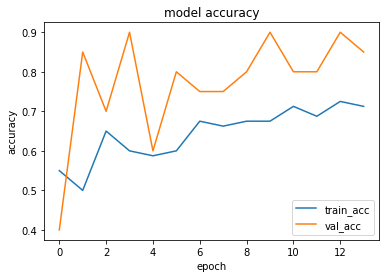

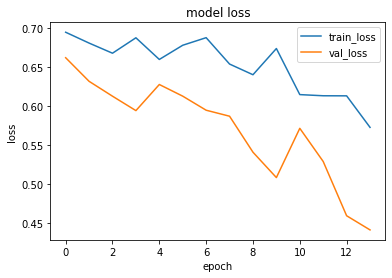

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.38727844]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.62300795]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6405693]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.30591735]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.29456535]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.3043997]]


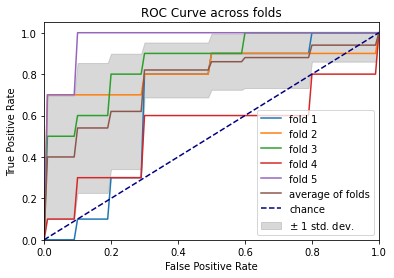

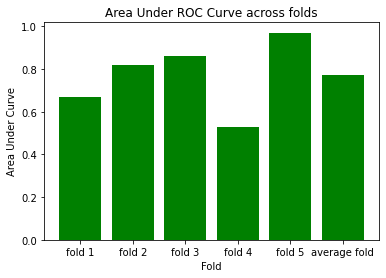

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 193ms/step - loss: 0.6901 - accuracy: 0.5750 - precision: 0.5789 - recall: 0.5500 - val_loss: 0.6672 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6623 - accuracy: 0.5500 - precision: 0.5303 - recall: 0.8750 - val_loss: 0.6550 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6678 - accuracy: 0.6375 - precision: 0.5846 - recall: 0.9500 - val_loss: 0.6318 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6637 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6049 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 138ms/step 

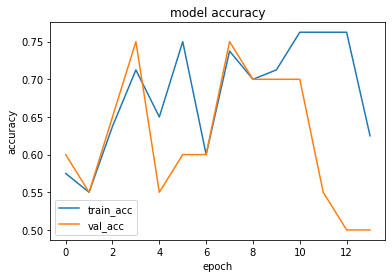

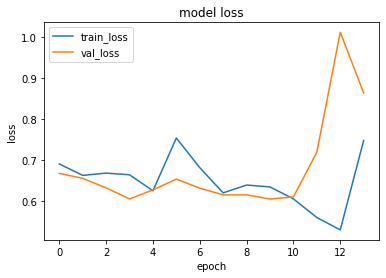

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.20092118]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.74241275]]


1it [00:00, 12787.51it/s]


prediction for video armflapping_2.mov is [[0.20002013]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.2010454]]


1it [00:00, 13357.66it/s]


prediction for video control_2.mov is [[0.20112005]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.20113686]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 165ms/step - loss: 0.6928 - accuracy: 0.4875 - precision: 0.4800 - recall: 0.3000 - val_loss: 0.7008 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6861 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6892 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 1s 174ms/step - loss: 0.6659 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.6593 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6478 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6300 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75


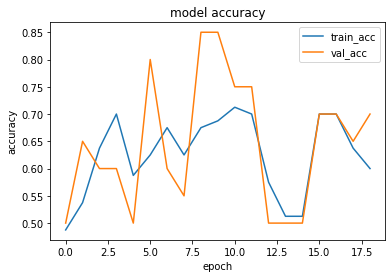

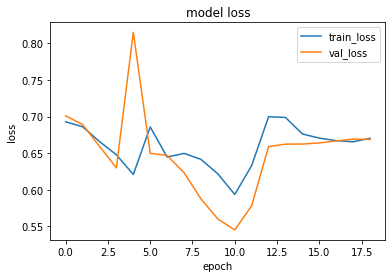

1it [00:00, 11915.64it/s]


prediction for video armflapping_1.mov is [[0.45222494]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.47952488]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.47436506]]


1it [00:00, 14563.56it/s]


prediction for video control_1.mov is [[0.4504713]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.45095545]]


1it [00:00, 15087.42it/s]


prediction for video control_3.mov is [[0.4506147]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6816 - accuracy: 0.4375 - precision: 0.4194 - recall: 0.3250 - val_loss: 0.6807 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7576 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6945 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6791 - accuracy: 0.5500 - precision: 0.5294 - recall: 0.9000 - val_loss: 0.6966 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6562 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.7255 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3

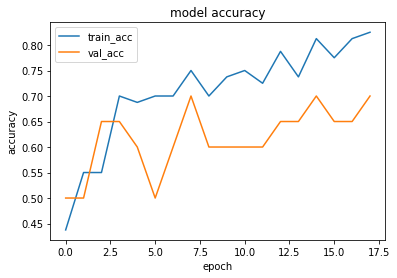

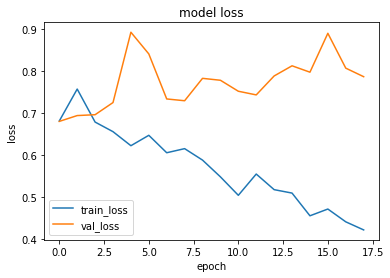

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.56715125]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.68980193]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.40403196]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.29101908]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.22797322]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.20743933]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 162ms/step - loss: 0.6912 - accuracy: 0.5125 - precision: 0.5070 - recall: 0.9000 - val_loss: 0.6511 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6601 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.6679 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6421 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.6432 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6470 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 0.8018 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


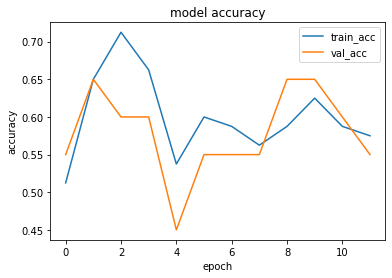

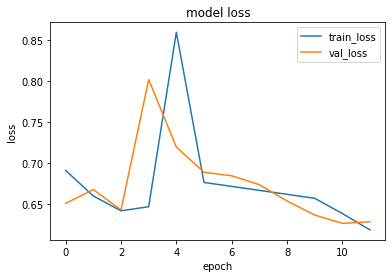

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.54336464]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.5772501]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_2.mov is [[0.5786322]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.52594274]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.5188463]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.51541]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 163ms/step - loss: 0.7162 - accuracy: 0.5375 - precision: 0.6000 - recall: 0.2250 - val_loss: 0.6656 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6818 - accuracy: 0.6375 - precision: 0.6170 - recall: 0.7250 - val_loss: 0.6339 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6886 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.6411 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 1s 188ms/step - loss: 0.6698 - accuracy: 0.5500 - precision: 0.7500 - recall: 0.1500 - val_loss: 0.6438 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 5/75
3/3

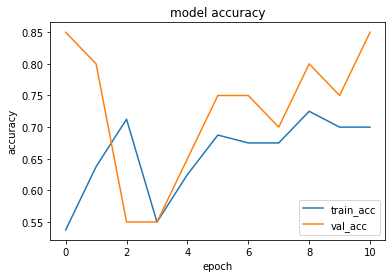

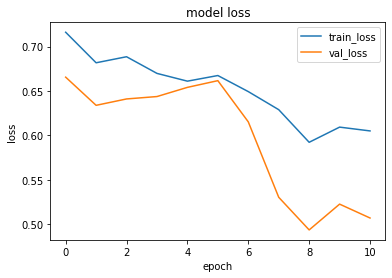

1it [00:00, 12372.58it/s]


prediction for video armflapping_1.mov is [[0.5398525]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.5931708]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5868342]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.5006072]]


1it [00:00, 15477.14it/s]


prediction for video control_2.mov is [[0.48438475]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.47576177]]


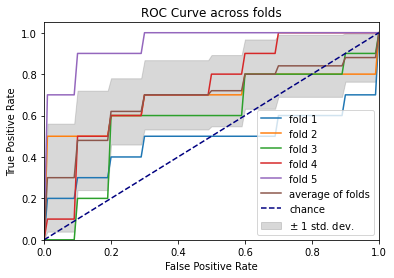

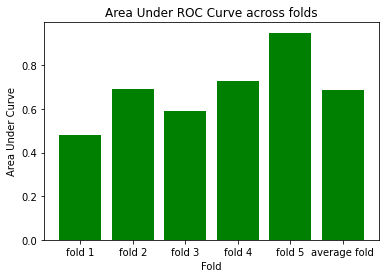

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 180ms/step - loss: 0.7020 - accuracy: 0.4500 - precision: 0.4655 - recall: 0.6750 - val_loss: 0.6736 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7471 - accuracy: 0.5375 - precision: 0.8000 - recall: 0.1000 - val_loss: 0.6726 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6707 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6762 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6706 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6678 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 150

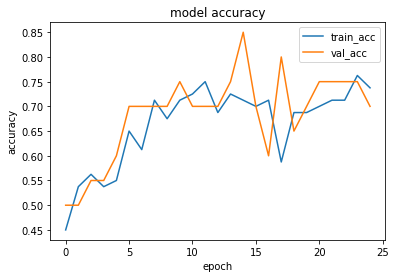

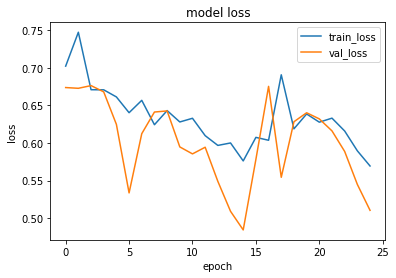

1it [00:00, 17331.83it/s]


prediction for video armflapping_1.mov is [[0.44591406]]


1it [00:00, 17623.13it/s]


prediction for video armflapping_3.mov is [[0.69607246]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.68629277]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.3459972]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.32941133]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.34670925]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6991 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8500 - val_loss: 0.6529 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6713 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 0.6449 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6466 - accuracy: 0.6500 - precision: 0.8750 - recall: 0.3500 - val_loss: 0.6080 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6409 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6135 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75


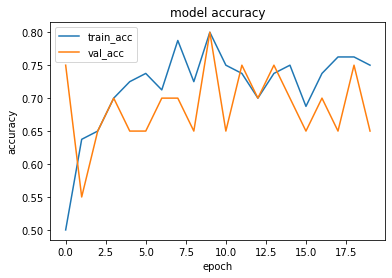

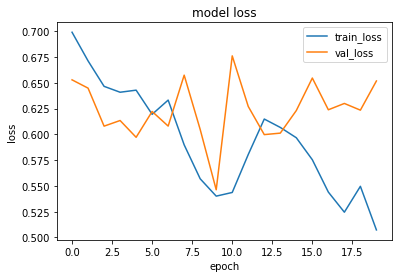

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.48454392]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.6586739]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7068516]]


1it [00:00, 3560.53it/s]


prediction for video control_1.mov is [[0.3789558]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.3632369]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.337363]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.7107 - accuracy: 0.4750 - precision: 0.4857 - recall: 0.8500 - val_loss: 0.6784 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6738 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6504 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6431 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.8987 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7036 - accuracy: 0.6750 - precision: 0.6061 - recall: 1.0000 - val_loss: 0.6887 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 5/75
3/

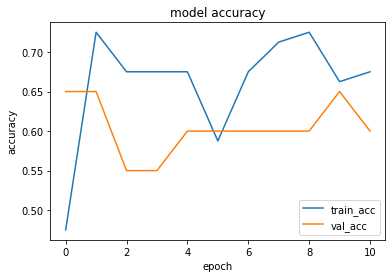

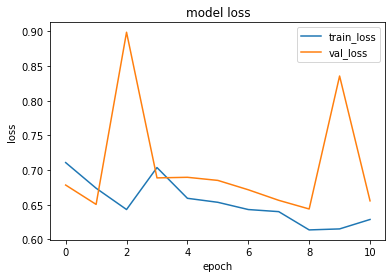

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.42339966]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.44339976]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_2.mov is [[0.46749142]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.38791615]]


1it [00:00, 12018.06it/s]


prediction for video control_2.mov is [[0.36846417]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.3638981]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6889 - accuracy: 0.4875 - precision: 0.4762 - recall: 0.2500 - val_loss: 0.7022 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6730 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6512 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6206 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.6320 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6371 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.6370 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3

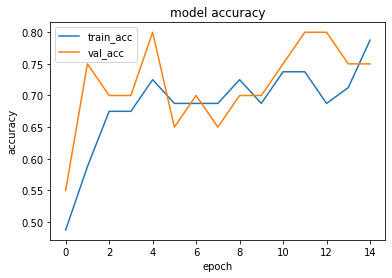

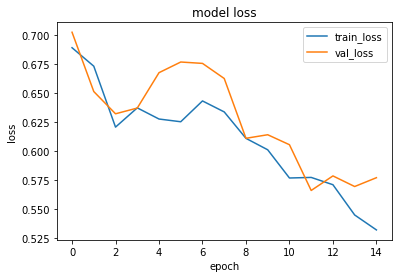

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.4416132]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.59716713]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.6806806]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.37148368]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.35189623]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.3439117]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6879 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8750 - val_loss: 0.9129 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7175 - accuracy: 0.5500 - precision: 0.5625 - recall: 0.4500 - val_loss: 0.6880 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 174ms/step - loss: 0.6657 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6803 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6639 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6691 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoc

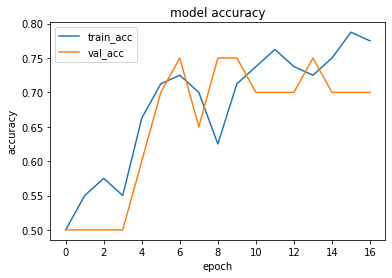

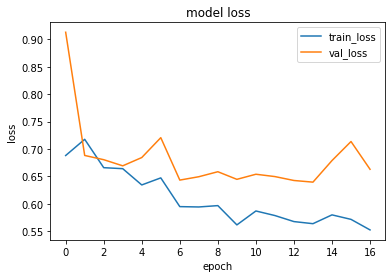

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.56306076]]


1it [00:00, 12787.51it/s]


prediction for video armflapping_3.mov is [[0.57367086]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.64849675]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.4847169]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.46544778]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.4144585]]


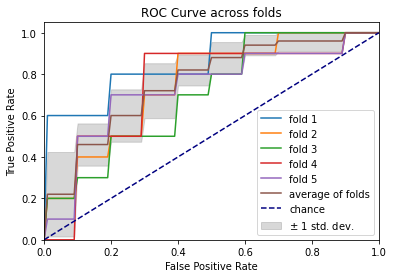

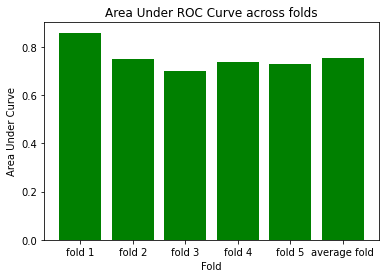

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6882 - accuracy: 0.5125 - precision: 0.5161 - recall: 0.4000 - val_loss: 0.6627 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6627 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6673 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6505 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6722 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6356 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6658 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 152ms/step 

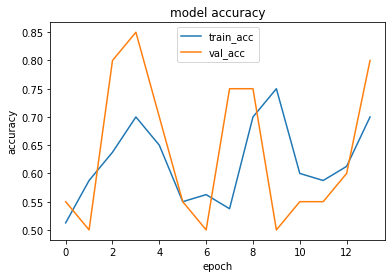

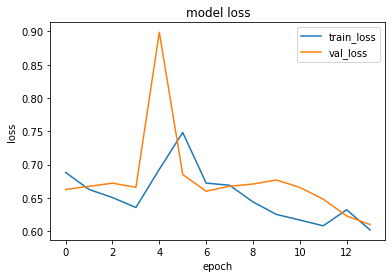

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.52153766]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5291508]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5550876]]


1it [00:00, 17260.51it/s]


prediction for video control_1.mov is [[0.4960991]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.48069483]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.4809701]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7022 - accuracy: 0.4750 - precision: 0.4857 - recall: 0.8500 - val_loss: 0.6569 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6592 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.6702 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6716 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 0.6416 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 211ms/step - loss: 0.6670 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6444 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

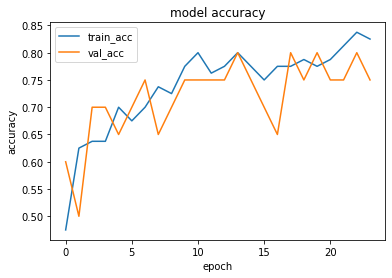

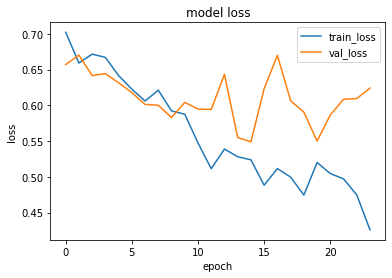

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.4541561]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_3.mov is [[0.74636996]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.76205754]]


1it [00:00, 12483.05it/s]


prediction for video control_1.mov is [[0.27238974]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.2319189]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.23056754]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7124 - accuracy: 0.5625 - precision: 0.7273 - recall: 0.2000 - val_loss: 0.6849 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6875 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6767 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6812 - accuracy: 0.5375 - precision: 0.5246 - recall: 0.8000 - val_loss: 0.6722 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6731 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.6581 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75


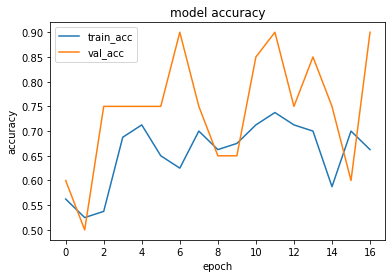

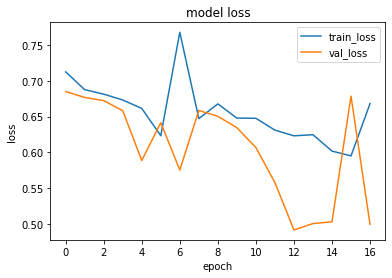

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.45484388]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5578302]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5350906]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.42068774]]


1it [00:00, 8612.53it/s]


prediction for video control_2.mov is [[0.41111428]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.4031977]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6803 - accuracy: 0.6125 - precision: 0.6452 - recall: 0.5000 - val_loss: 0.7286 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6526 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.7689 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6300 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.7224 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6027 - accuracy: 0.6250 - precision: 0.5758 - recall: 0.9500 - val_loss: 0.7439 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3

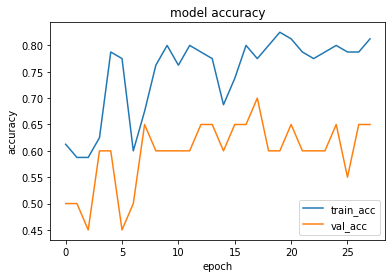

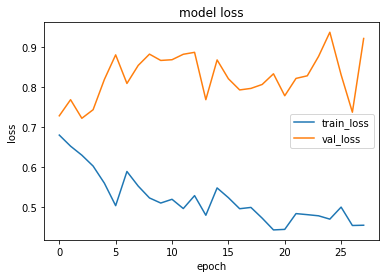

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.6211684]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.7713187]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.74554545]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.2103886]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.17727679]]


1it [00:00, 11781.75it/s]


prediction for video control_3.mov is [[0.16904]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 159ms/step - loss: 0.6963 - accuracy: 0.5125 - precision: 0.5098 - recall: 0.6500 - val_loss: 0.6686 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6751 - accuracy: 0.5500 - precision: 0.5833 - recall: 0.3500 - val_loss: 0.6566 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6627 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6306 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6404 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.6054 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75
3/3

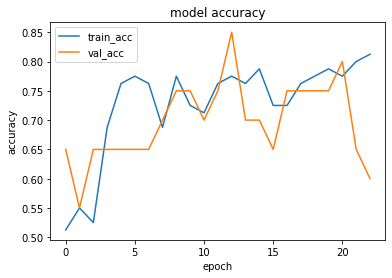

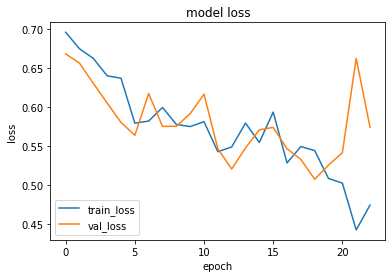

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.475873]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.5980083]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.67047554]]


1it [00:00, 7358.43it/s]


prediction for video control_1.mov is [[0.38467702]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.33321613]]


1it [00:00, 13617.87it/s]


prediction for video control_3.mov is [[0.32544836]]


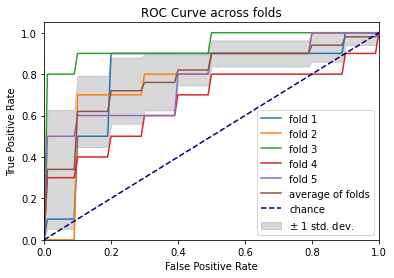

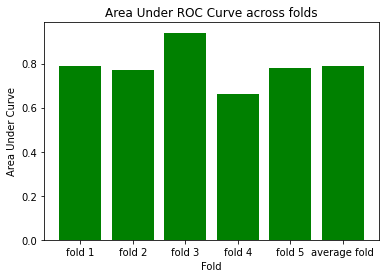

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6949 - accuracy: 0.4875 - precision: 0.4889 - recall: 0.5500 - val_loss: 0.7281 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6605 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6734 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6570 - accuracy: 0.5500 - precision: 0.8333 - recall: 0.1250 - val_loss: 0.6582 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6643 - accuracy: 0.6000 - precision: 0.8333 - recall: 0.2500 - val_loss: 0.6524 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] 

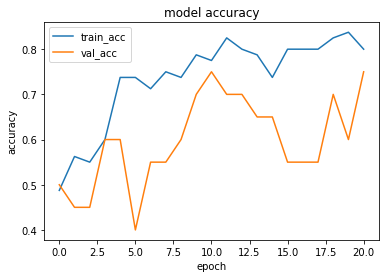

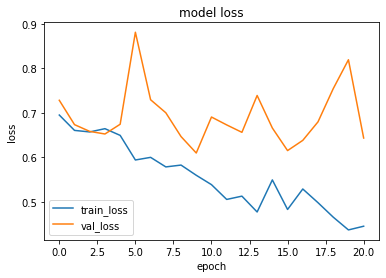

1it [00:00, 11214.72it/s]


prediction for video armflapping_1.mov is [[0.4792862]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_3.mov is [[0.7478349]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.7026465]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.28300297]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2291426]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.21617803]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 200ms/step - loss: 0.6898 - accuracy: 0.5375 - precision: 0.5254 - recall: 0.7750 - val_loss: 0.6689 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6902 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6745 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6787 - accuracy: 0.5125 - precision: 0.5065 - recall: 0.9750 - val_loss: 0.6699 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6785 - accuracy: 0.6375 - precision: 0.6486 - recall: 0.6000 - val_loss: 0.6689 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


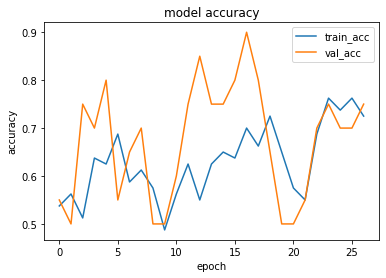

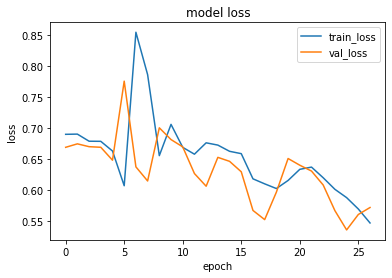

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5930618]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5338542]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_2.mov is [[0.6791818]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.3873108]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.34667963]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.33703658]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 189ms/step - loss: 0.6888 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6332 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7460 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6328 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6824 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.6530 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6819 - accuracy: 0.4875 - precision: 0.4444 - recall: 0.1000 - val_loss: 0.6546 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75


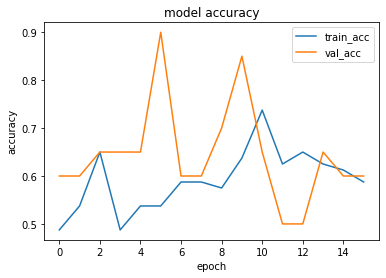

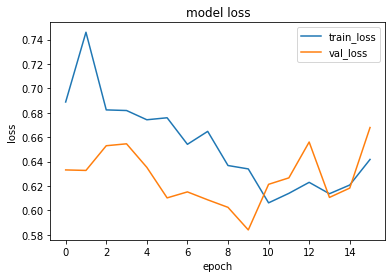

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.540489]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.58124036]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.57958436]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.5186581]]


1it [00:00, 15087.42it/s]


prediction for video control_2.mov is [[0.5067713]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.5053015]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 164ms/step - loss: 0.7273 - accuracy: 0.4375 - precision: 0.2222 - recall: 0.0500 - val_loss: 0.6820 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6968 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.6838 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6849 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.6810 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6797 - accuracy: 0.6375 - precision: 0.6410 - recall: 0.6250 - val_loss: 0.6735 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

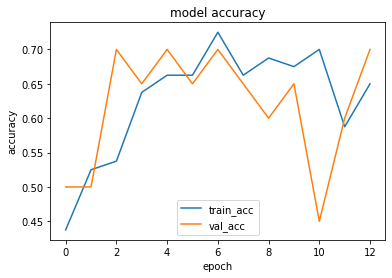

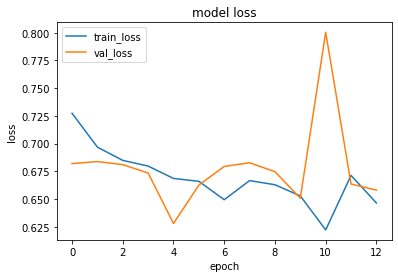

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4524402]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_3.mov is [[0.4870541]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.48932552]]


1it [00:00, 17623.13it/s]


prediction for video control_1.mov is [[0.4295137]]


1it [00:00, 11781.75it/s]


prediction for video control_2.mov is [[0.42273396]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.41955292]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 168ms/step - loss: 0.6868 - accuracy: 0.4750 - precision: 0.4643 - recall: 0.3250 - val_loss: 0.6915 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6827 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6838 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6575 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6869 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 207ms/step - loss: 0.6679 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.6893 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


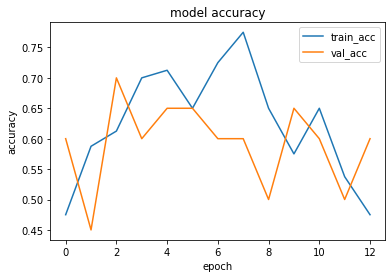

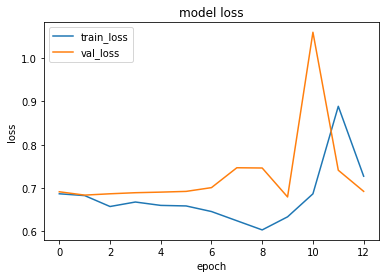

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.49100235]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.48115283]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.4996182]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.4876741]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.48763952]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.4879235]]


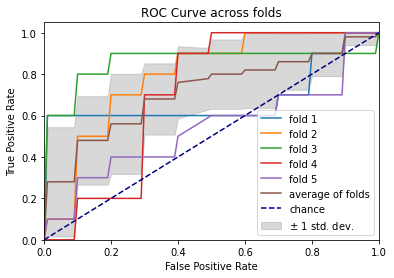

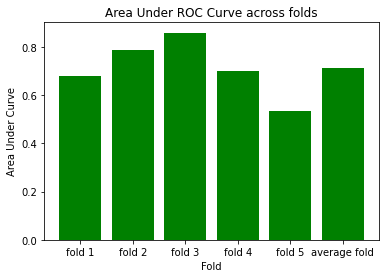

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 182ms/step - loss: 0.6957 - accuracy: 0.3750 - precision: 0.3077 - recall: 0.2000 - val_loss: 0.6779 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6704 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.9139 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.8267 - accuracy: 0.6250 - precision: 0.6471 - recall: 0.5500 - val_loss: 0.8586 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.8159 - accuracy: 0.5250 - precision: 0.6000 - recall: 0.1500 - val_loss: 0.7011 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 150

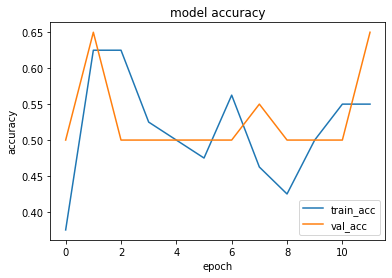

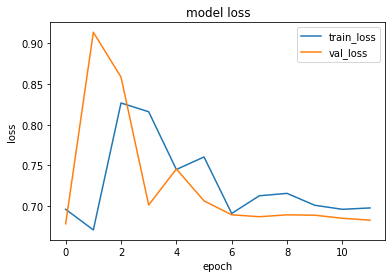

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.47939718]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.47198933]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.48155782]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.47914213]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.4790954]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.47909307]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 184ms/step - loss: 0.6885 - accuracy: 0.5375 - precision: 0.5349 - recall: 0.5750 - val_loss: 0.6479 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6635 - accuracy: 0.6000 - precision: 0.5800 - recall: 0.7250 - val_loss: 0.6218 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7389 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.6448 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6595 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.6328 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75


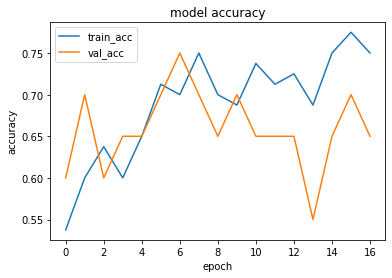

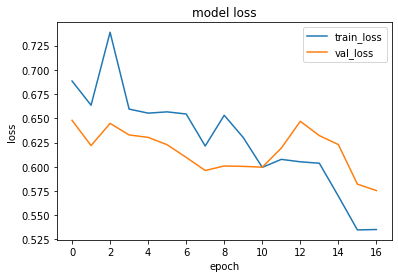

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.48528224]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.65387166]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.6871187]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.2563218]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.2183272]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.23805931]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6844 - accuracy: 0.5500 - precision: 0.5909 - recall: 0.3250 - val_loss: 0.6609 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 207ms/step - loss: 0.6856 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6574 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6609 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.6702 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6621 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.6636 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


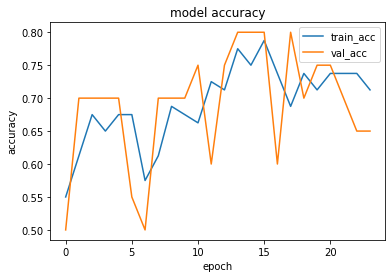

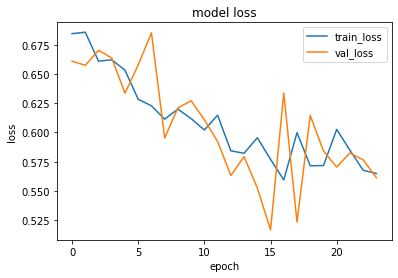

1it [00:00, 11214.72it/s]


prediction for video armflapping_1.mov is [[0.46979445]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.6068068]]


1it [00:00, 5526.09it/s]


prediction for video armflapping_2.mov is [[0.593531]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.3840808]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.36253136]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.3489959]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 183ms/step - loss: 0.6926 - accuracy: 0.4625 - precision: 0.4746 - recall: 0.7000 - val_loss: 0.7511 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6470 - accuracy: 0.5750 - precision: 0.5938 - recall: 0.4750 - val_loss: 0.7415 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5724 - accuracy: 0.6625 - precision: 0.6032 - recall: 0.9500 - val_loss: 0.8862 - val_accuracy: 0.4000 - val_precision: 0.3750 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 1s 211ms/step - loss: 0.8002 - accuracy: 0.7000 - precision: 0.7857 - recall: 0.5500 - val_loss: 0.7165 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

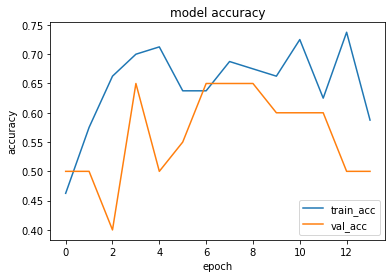

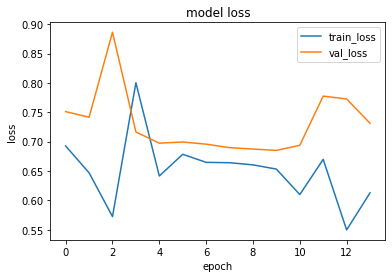

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.58775884]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.60336673]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.6420374]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.5494622]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.5423904]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.5320829]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 182ms/step - loss: 0.6900 - accuracy: 0.6125 - precision: 0.6286 - recall: 0.5500 - val_loss: 0.6475 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6888 - accuracy: 0.5875 - precision: 0.5660 - recall: 0.7500 - val_loss: 0.6432 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6954 - accuracy: 0.5625 - precision: 0.8571 - recall: 0.1500 - val_loss: 0.6836 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6734 - accuracy: 0.6625 - precision: 0.7097 - recall: 0.5500 - val_loss: 0.6931 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoc

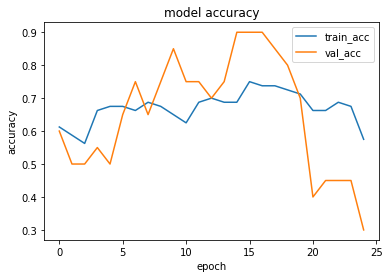

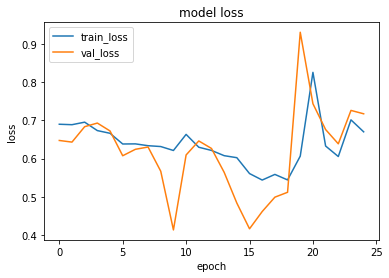

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.47949153]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_3.mov is [[0.6456131]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.5497381]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.487741]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.50461674]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.502679]]


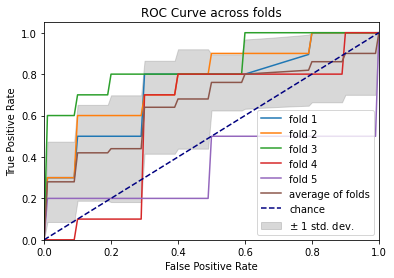

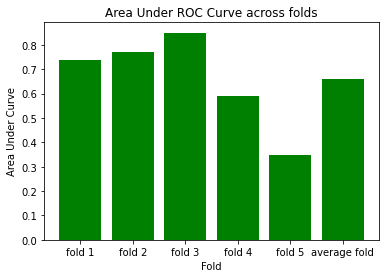

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 195ms/step - loss: 0.7010 - accuracy: 0.4875 - precision: 0.4894 - recall: 0.5750 - val_loss: 0.6541 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7181 - accuracy: 0.5500 - precision: 0.5714 - recall: 0.4000 - val_loss: 0.6674 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 1s 181ms/step - loss: 0.6725 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6736 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6809 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6707 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 152ms/step 

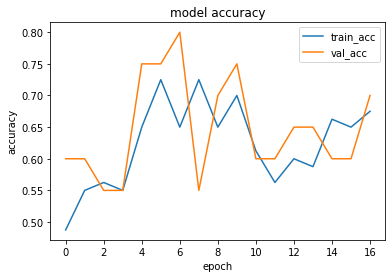

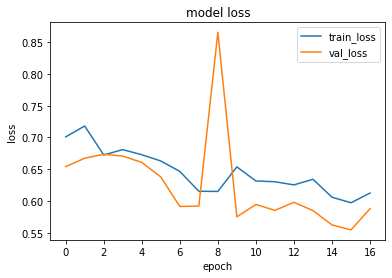

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.48510516]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.55373293]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5347764]]


1it [00:00, 12945.38it/s]


prediction for video control_1.mov is [[0.46051872]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.45235407]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.44727546]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 195ms/step - loss: 0.6926 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.6719 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 1s 179ms/step - loss: 0.6549 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.6807 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6584 - accuracy: 0.5500 - precision: 0.7500 - recall: 0.1500 - val_loss: 0.6589 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6466 - accuracy: 0.5750 - precision: 0.6500 - recall: 0.3250 - val_loss: 0.6065 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epo

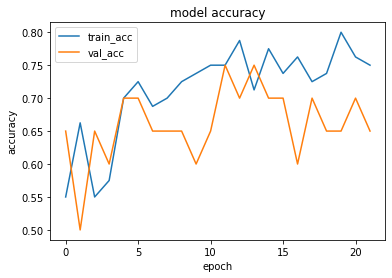

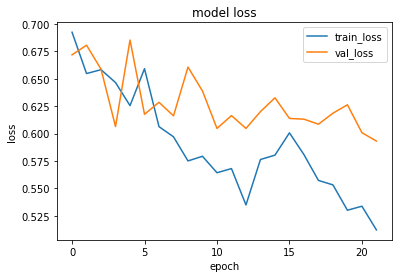

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.41616338]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.51679766]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.68824375]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.35346943]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.31535456]]


1it [00:00, 11915.64it/s]


prediction for video control_3.mov is [[0.31929103]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 163ms/step - loss: 0.7025 - accuracy: 0.4500 - precision: 0.4167 - recall: 0.2500 - val_loss: 0.6643 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7021 - accuracy: 0.6625 - precision: 0.6066 - recall: 0.9250 - val_loss: 0.6883 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6300 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6856 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 185ms/step - loss: 0.6299 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6860 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75


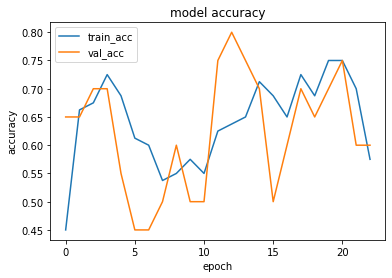

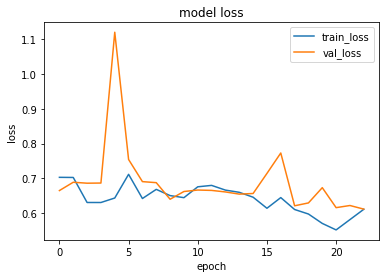

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.62132406]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.60934603]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6253662]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.5973976]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.5753052]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.58094996]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6862 - accuracy: 0.5625 - precision: 0.5472 - recall: 0.7250 - val_loss: 0.7900 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6989 - accuracy: 0.4875 - precision: 0.4783 - recall: 0.2750 - val_loss: 0.6616 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 1s 184ms/step - loss: 0.6729 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.6455 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6627 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.6202 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

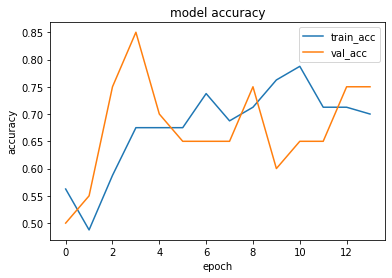

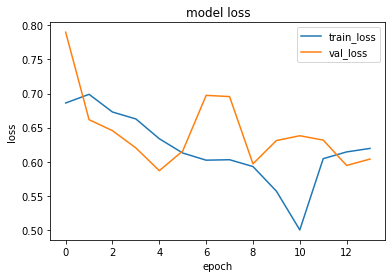

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5064227]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_3.mov is [[0.59323174]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.5547755]]


1it [00:00, 12865.96it/s]


prediction for video control_1.mov is [[0.46290484]]


1it [00:00, 11008.67it/s]


prediction for video control_2.mov is [[0.45643443]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.44574356]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 192ms/step - loss: 0.7121 - accuracy: 0.3250 - precision: 0.3750 - recall: 0.5250 - val_loss: 0.6888 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6548 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6309 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6475 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.7194 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6488 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.7009 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75


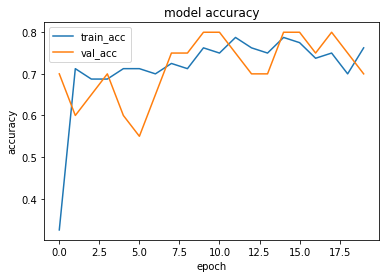

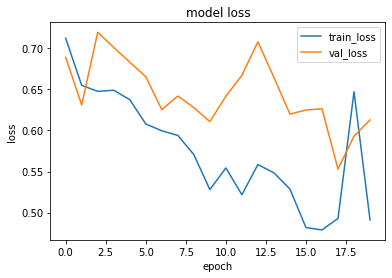

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.43987468]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.5629011]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.4765976]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.40678108]]


1it [00:00, 16980.99it/s]


prediction for video control_2.mov is [[0.39974025]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.39915687]]


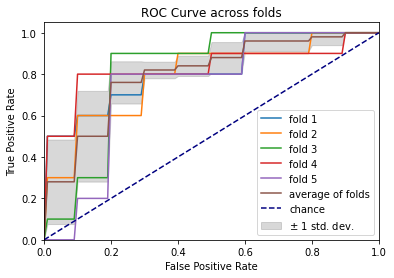

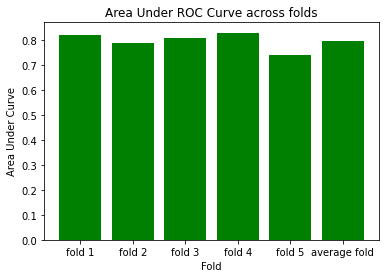

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6923 - accuracy: 0.5125 - precision: 0.5122 - recall: 0.5250 - val_loss: 0.6130 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6452 - accuracy: 0.7125 - precision: 0.6441 - recall: 0.9500 - val_loss: 0.6001 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6708 - accuracy: 0.5500 - precision: 0.7500 - recall: 0.1500 - val_loss: 0.6390 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6511 - accuracy: 0.6000 - precision: 0.7000 - recall: 0.3500 - val_loss: 0.6317 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 1s 183ms/step 

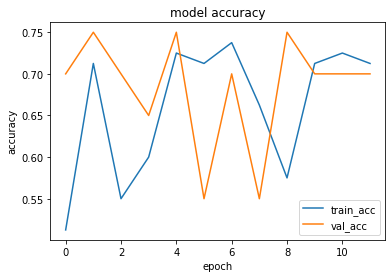

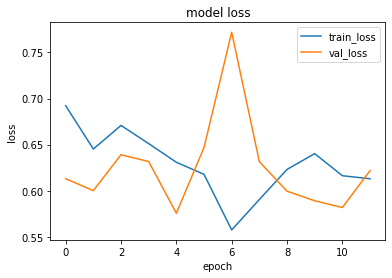

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.50452703]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_3.mov is [[0.544829]]


1it [00:00, 11244.78it/s]


prediction for video armflapping_2.mov is [[0.5187169]]


1it [00:00, 16070.13it/s]


prediction for video control_1.mov is [[0.4804077]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.4691857]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.46978495]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 209ms/step - loss: 0.6858 - accuracy: 0.6250 - precision: 0.7083 - recall: 0.4250 - val_loss: 0.6798 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6467 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.9346 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6852 - accuracy: 0.5750 - precision: 0.5455 - recall: 0.9000 - val_loss: 0.6005 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6406 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.5517 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75


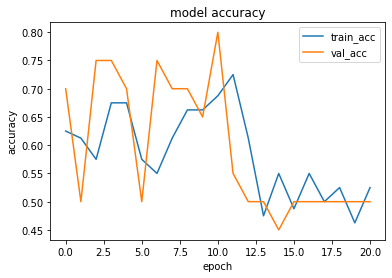

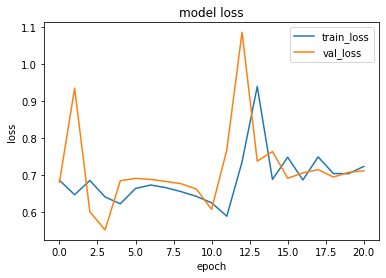

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.5879774]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.5936322]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.58757746]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.5876787]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.5875859]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.5875763]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6922 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3000 - val_loss: 0.6774 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6610 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.6794 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6942 - accuracy: 0.6625 - precision: 0.6970 - recall: 0.5750 - val_loss: 0.6544 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6353 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6824 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75
3

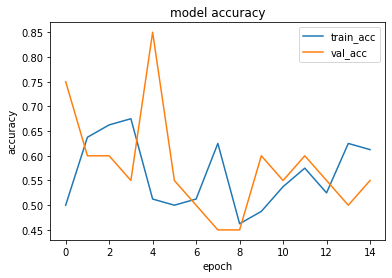

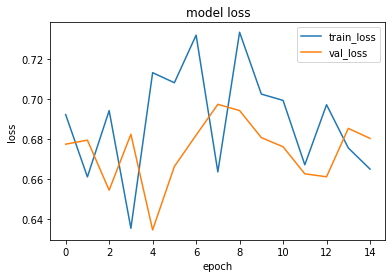

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.38989562]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.47694442]]


1it [00:00, 10754.63it/s]


prediction for video armflapping_2.mov is [[0.48398128]]


1it [00:00, 10754.63it/s]


prediction for video control_1.mov is [[0.37250108]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.35937822]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.48171335]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 170ms/step - loss: 0.6906 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.6527 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6822 - accuracy: 0.6250 - precision: 0.8125 - recall: 0.3250 - val_loss: 0.6061 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6552 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.5952 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6142 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.8479 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75


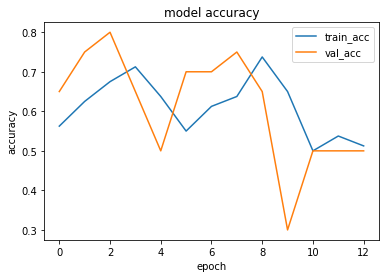

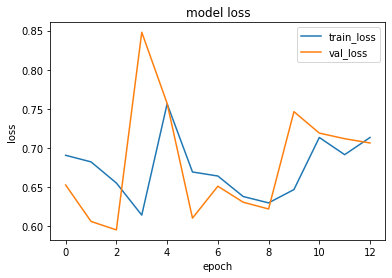

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.48189285]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5230286]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.49115196]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.48055616]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.48041672]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.48036337]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 170ms/step - loss: 0.7038 - accuracy: 0.4875 - precision: 0.4545 - recall: 0.1250 - val_loss: 0.7237 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6437 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.8099 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6356 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7424 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6394 - accuracy: 0.6125 - precision: 0.5634 - recall: 1.0000 - val_loss: 0.7271 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 5/75


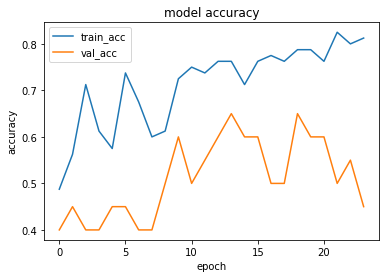

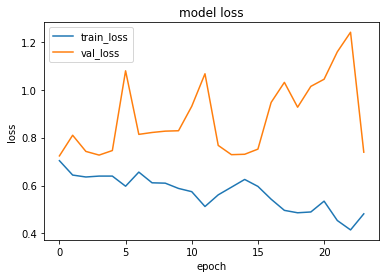

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5236322]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.62253207]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.6821368]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.43913397]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.34090877]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.3961891]]


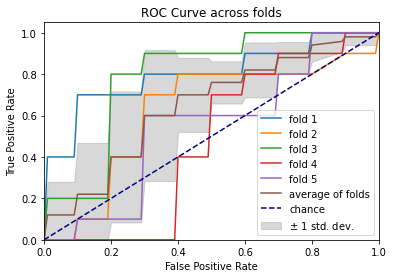

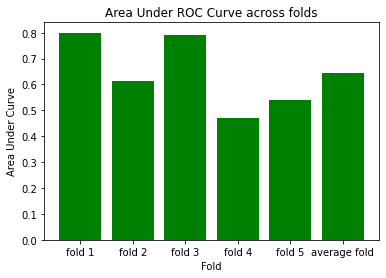

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 187ms/step - loss: 0.7233 - accuracy: 0.4000 - precision: 0.4375 - recall: 0.7000 - val_loss: 0.6874 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6791 - accuracy: 0.6125 - precision: 0.6154 - recall: 0.6000 - val_loss: 0.6752 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6735 - accuracy: 0.6250 - precision: 0.6562 - recall: 0.5250 - val_loss: 0.6507 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6438 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6666 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 147ms/step 

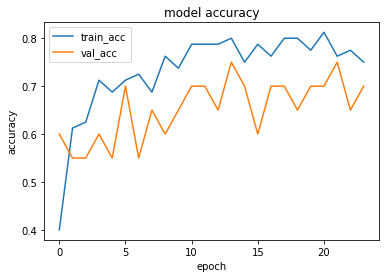

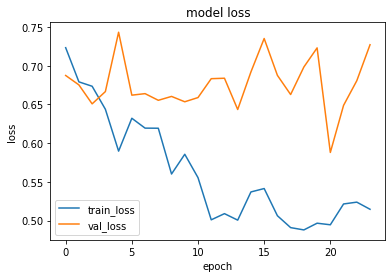

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.28017104]]


1it [00:00, 8756.38it/s]


prediction for video armflapping_3.mov is [[0.32889354]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.40273452]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.2444596]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.23096994]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.22562778]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 180ms/step - loss: 0.6977 - accuracy: 0.3875 - precision: 0.4082 - recall: 0.5000 - val_loss: 0.6682 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6845 - accuracy: 0.6500 - precision: 0.6000 - recall: 0.9000 - val_loss: 0.6643 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6681 - accuracy: 0.6250 - precision: 0.6471 - recall: 0.5500 - val_loss: 0.6088 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6304 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.6579 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75


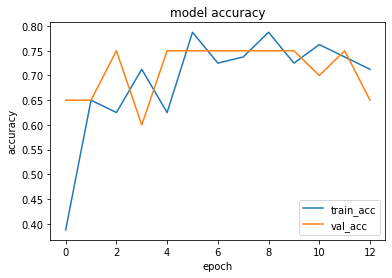

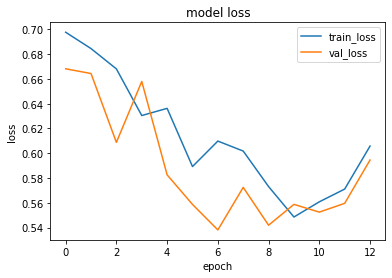

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.48677647]]


1it [00:00, 8756.38it/s]


prediction for video armflapping_3.mov is [[0.55451393]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.5407003]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.45163164]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.43449208]]


1it [00:00, 13315.25it/s]


prediction for video control_3.mov is [[0.4251503]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7128 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6797 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6608 - accuracy: 0.5500 - precision: 0.6111 - recall: 0.2750 - val_loss: 0.6736 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6636 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.7432 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6309 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6696 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75
3

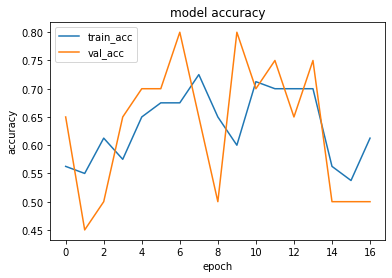

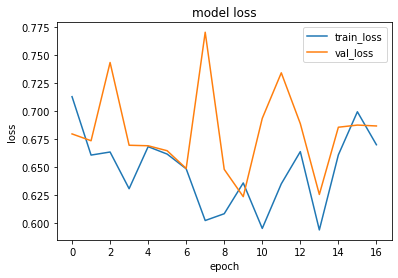

1it [00:00, 16448.25it/s]


prediction for video armflapping_1.mov is [[0.44202286]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.4212141]]


1it [00:00, 11781.75it/s]


prediction for video armflapping_2.mov is [[0.4475488]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.44116253]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.44100463]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.4410066]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 182ms/step - loss: 0.6908 - accuracy: 0.4125 - precision: 0.4364 - recall: 0.6000 - val_loss: 0.6907 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7759 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6884 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6286 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.7266 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6519 - accuracy: 0.5500 - precision: 0.8333 - recall: 0.1250 - val_loss: 0.7095 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3

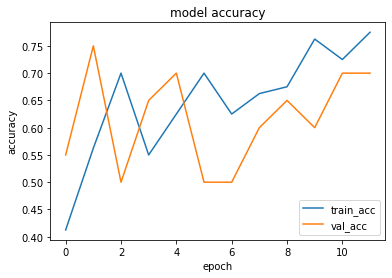

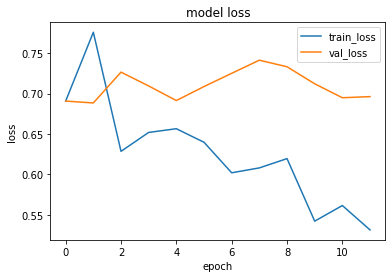

1it [00:00, 11618.57it/s]


prediction for video armflapping_1.mov is [[0.39116246]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.653905]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.67594504]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.1809383]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.15866035]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.21863076]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 172ms/step - loss: 0.7015 - accuracy: 0.5250 - precision: 0.5147 - recall: 0.8750 - val_loss: 0.6739 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6885 - accuracy: 0.5375 - precision: 0.6364 - recall: 0.1750 - val_loss: 0.6622 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6901 - accuracy: 0.5500 - precision: 0.5625 - recall: 0.4500 - val_loss: 0.6714 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6675 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.6215 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


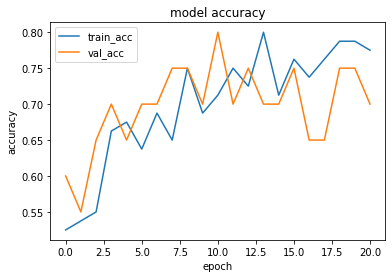

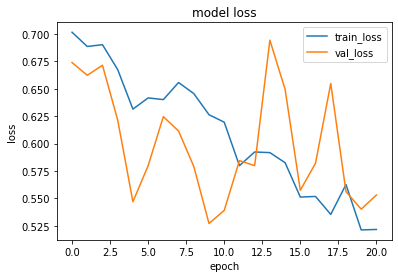

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.22318438]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.26126832]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.24364552]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.21276769]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.21095666]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.21040386]]


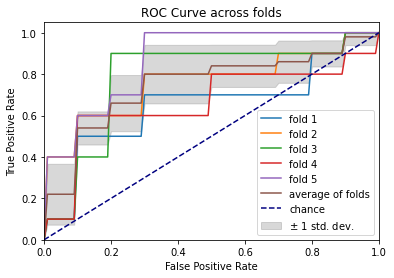

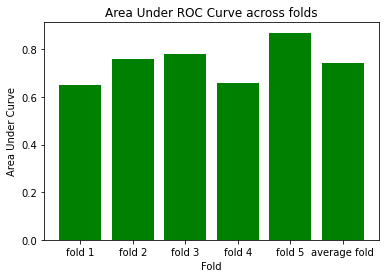

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 180ms/step - loss: 0.6955 - accuracy: 0.4750 - precision: 0.4286 - recall: 0.1500 - val_loss: 0.6558 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6716 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6373 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6624 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6469 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 210ms/step - loss: 0.6719 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6308 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 1s 203ms/step 

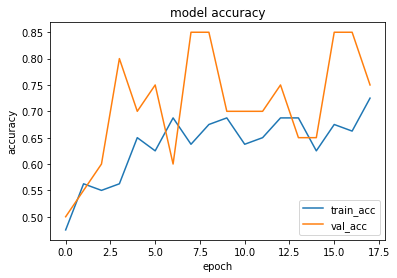

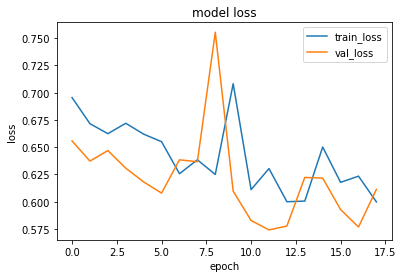

1it [00:00, 6374.32it/s]


prediction for video armflapping_1.mov is [[0.53715783]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.56895286]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.60678834]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.48538062]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.47420305]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.44089642]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.6947 - accuracy: 0.5250 - precision: 0.5172 - recall: 0.7500 - val_loss: 0.7236 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7081 - accuracy: 0.5750 - precision: 0.7500 - recall: 0.2250 - val_loss: 0.6831 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6534 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6864 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6482 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6784 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epo

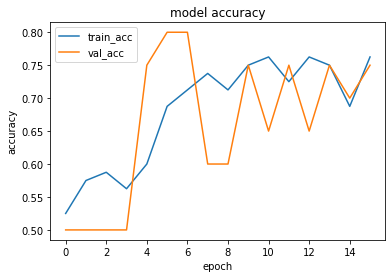

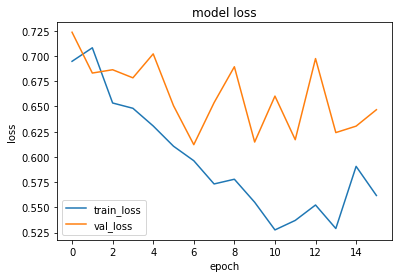

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.47741735]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.5590686]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.53914726]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.4458521]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.4350433]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.4301146]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 171ms/step - loss: 0.6801 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.6871 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.8180 - accuracy: 0.6250 - precision: 0.6316 - recall: 0.6000 - val_loss: 0.8011 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7278 - accuracy: 0.5125 - precision: 1.0000 - recall: 0.0250 - val_loss: 0.6901 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6763 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.6932 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3

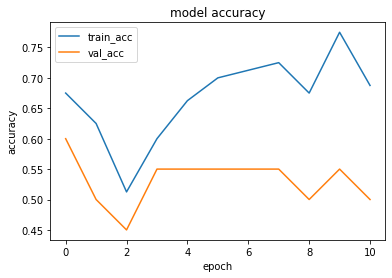

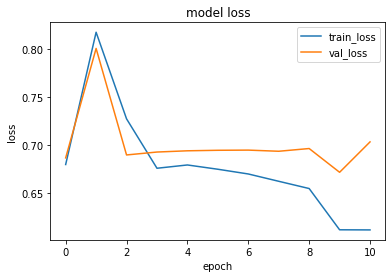

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.3004317]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.36619514]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.4790511]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.27845287]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.27159023]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.26940364]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7041 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6862 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6772 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.6303 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6439 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6409 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6440 - accuracy: 0.6375 - precision: 0.5873 - recall: 0.9250 - val_loss: 0.6405 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75


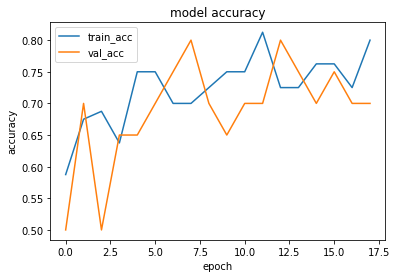

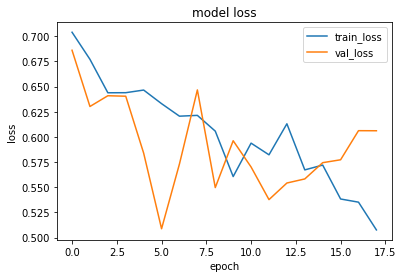

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.6495879]]


1it [00:00, 17623.13it/s]


prediction for video armflapping_3.mov is [[0.6932668]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.6950995]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.17751804]]


1it [00:00, 11748.75it/s]


prediction for video control_2.mov is [[0.16105479]]


1it [00:00, 11881.88it/s]


prediction for video control_3.mov is [[0.18531612]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 172ms/step - loss: 0.7081 - accuracy: 0.4875 - precision: 0.4737 - recall: 0.2250 - val_loss: 0.6814 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6983 - accuracy: 0.4250 - precision: 0.4531 - recall: 0.7250 - val_loss: 0.6704 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6815 - accuracy: 0.6250 - precision: 0.6000 - recall: 0.7500 - val_loss: 0.6638 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6818 - accuracy: 0.5625 - precision: 0.6923 - recall: 0.2250 - val_loss: 0.6385 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75


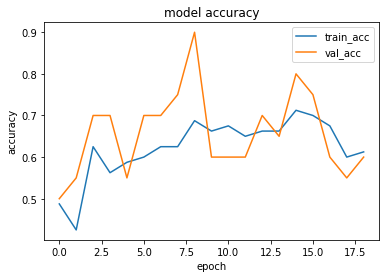

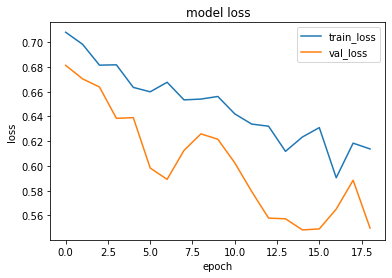

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5812736]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_3.mov is [[0.65813005]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6354831]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.5570692]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.5482261]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.5450002]]


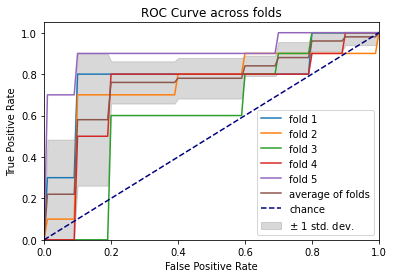

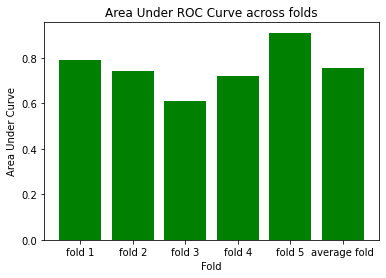

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 197ms/step - loss: 0.6895 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.6292 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6965 - accuracy: 0.4750 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6630 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6691 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.6799 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6672 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6822 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 150

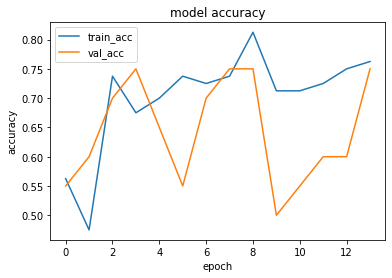

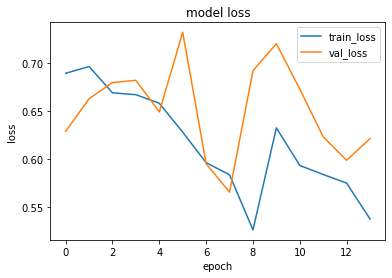

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.17872864]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.29969758]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.22197506]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.16778043]]


1it [00:00, 9986.44it/s]


prediction for video control_2.mov is [[0.16606706]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.16495442]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6948 - accuracy: 0.5125 - precision: 0.5098 - recall: 0.6500 - val_loss: 0.6780 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6272 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.9469 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.8072 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6998 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7100 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.7079 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


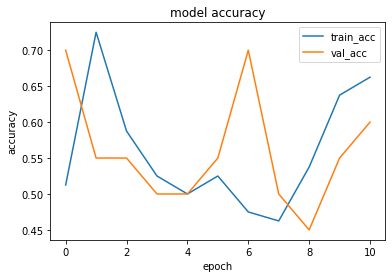

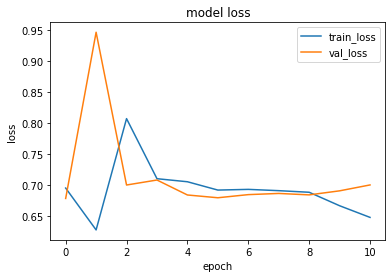

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.49983743]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.46443427]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.50708973]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.48707247]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.47782624]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.47212824]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 187ms/step - loss: 0.6875 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6822 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6792 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.0250 - val_loss: 0.6459 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6688 - accuracy: 0.5875 - precision: 0.6000 - recall: 0.5250 - val_loss: 0.6168 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6539 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 0.5846 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epo

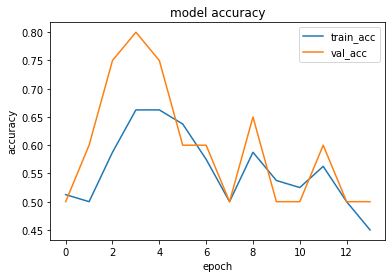

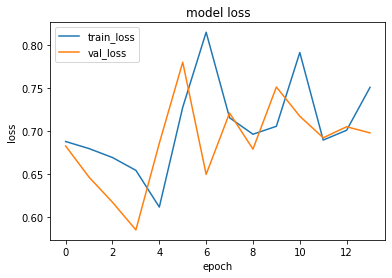

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.57744086]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.5574379]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.5799929]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.57685304]]


1it [00:00, 12826.62it/s]


prediction for video control_2.mov is [[0.57660294]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.5764836]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 177ms/step - loss: 0.7021 - accuracy: 0.4625 - precision: 0.4615 - recall: 0.4500 - val_loss: 0.6785 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6588 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.6647 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6426 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.6415 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 222ms/step - loss: 0.6151 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.7076 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75
3

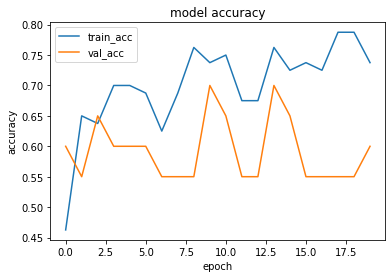

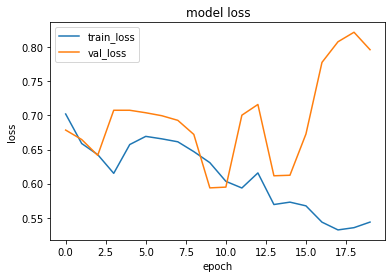

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5343997]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5250741]]


1it [00:00, 12520.31it/s]


prediction for video armflapping_2.mov is [[0.55289924]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.3246944]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.22013706]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.21531597]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 168ms/step - loss: 0.6857 - accuracy: 0.4500 - precision: 0.4565 - recall: 0.5250 - val_loss: 0.7267 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6405 - accuracy: 0.5250 - precision: 0.5278 - recall: 0.4750 - val_loss: 0.6419 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6217 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.9097 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 171ms/step - loss: 0.8241 - accuracy: 0.6750 - precision: 0.8182 - recall: 0.4500 - val_loss: 0.6886 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

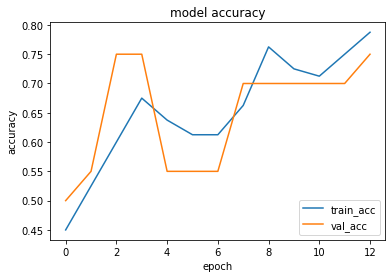

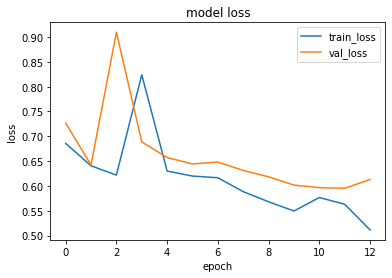

1it [00:00, 9258.95it/s]


prediction for video armflapping_1.mov is [[0.464278]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.44759056]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.5579666]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.3719768]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.35248625]]


1it [00:00, 17772.47it/s]


prediction for video control_3.mov is [[0.28851628]]


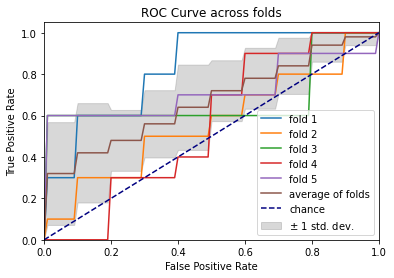

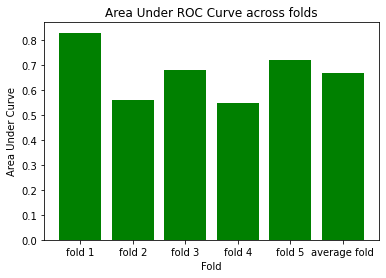

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.7035 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9000 - val_loss: 0.6690 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6662 - accuracy: 0.5375 - precision: 0.5484 - recall: 0.4250 - val_loss: 0.6692 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6536 - accuracy: 0.6625 - precision: 0.8095 - recall: 0.4250 - val_loss: 0.6373 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6428 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.5973 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 120ms/step 

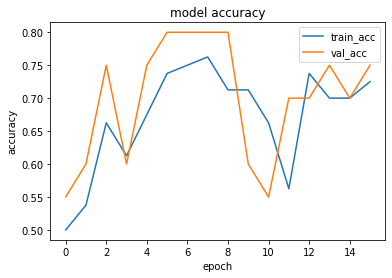

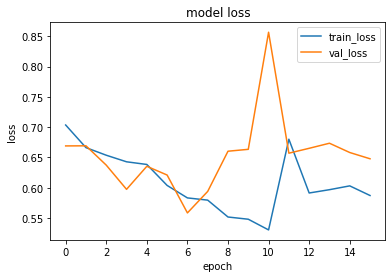

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.47860336]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.6048443]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.5200652]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.46510464]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.4665519]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.46430874]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6949 - accuracy: 0.4750 - precision: 0.4857 - recall: 0.8500 - val_loss: 0.6600 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6722 - accuracy: 0.5875 - precision: 0.7692 - recall: 0.2500 - val_loss: 0.6682 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.7281 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.6877 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.5940 - accuracy: 0.7125 - precision: 0.6545 - recall: 0.9000 - val_loss: 0.7021 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75


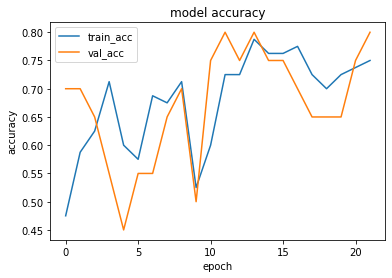

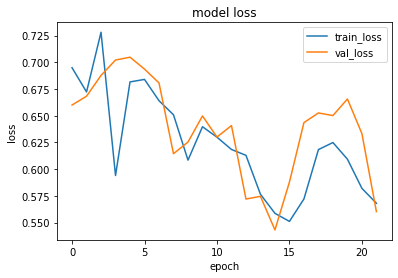

1it [00:00, 12633.45it/s]


prediction for video armflapping_1.mov is [[0.5371006]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5746342]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5628272]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.49760705]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.47473252]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.47465542]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6967 - accuracy: 0.5125 - precision: 0.5217 - recall: 0.3000 - val_loss: 0.6798 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6583 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.6712 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6469 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 1.0047 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.7356 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.6558 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 5/75


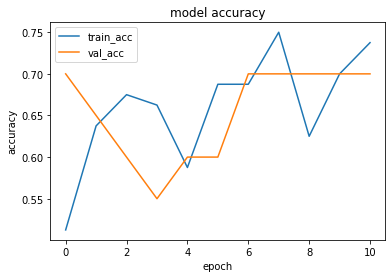

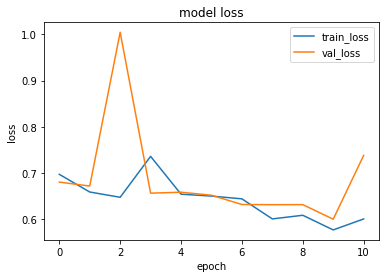

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.49165574]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.5328721]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.5466249]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.44863632]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.4318067]]


1it [00:00, 12826.62it/s]


prediction for video control_3.mov is [[0.4205914]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6858 - accuracy: 0.5625 - precision: 0.5556 - recall: 0.6250 - val_loss: 0.6691 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6449 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6422 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6678 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.6202 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6313 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6491 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3

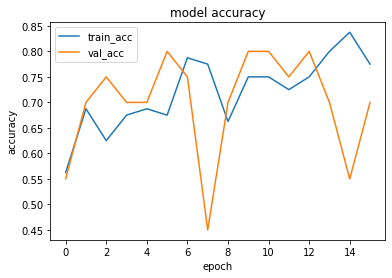

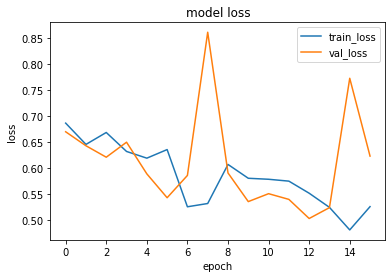

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.22763944]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.47079602]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5285729]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.17321557]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.1589233]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.16250443]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6899 - accuracy: 0.4875 - precision: 0.4815 - recall: 0.3250 - val_loss: 0.7368 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6604 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 1.3007 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 1.0930 - accuracy: 0.5000 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.7063 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6977 - accuracy: 0.4750 - precision: 0.4808 - recall: 0.6250 - val_loss: 0.7521 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_re

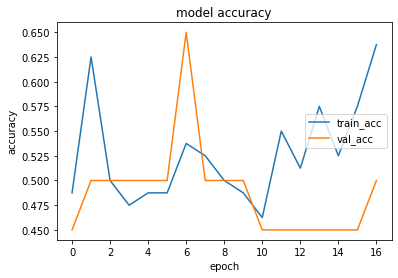

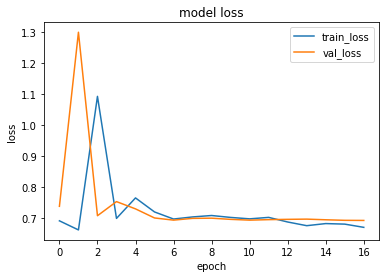

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5026996]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.47601548]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.5033192]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.5017082]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.50137466]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.50132996]]


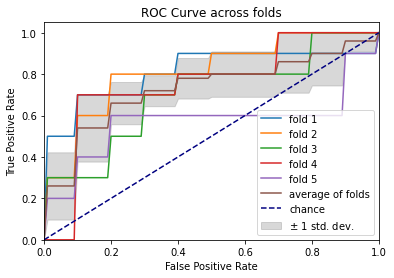

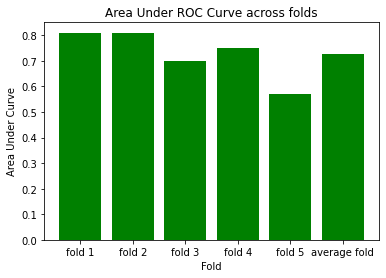

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6738 - accuracy: 0.4625 - precision: 0.4571 - recall: 0.4000 - val_loss: 1.2129 - val_accuracy: 0.4500 - val_precision: 0.3333 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.7211 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.6523 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6981 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6520 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6893 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6587 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

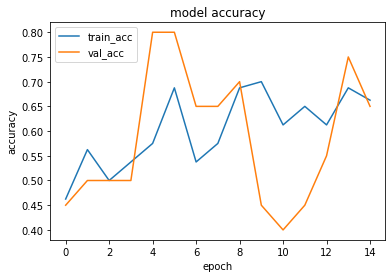

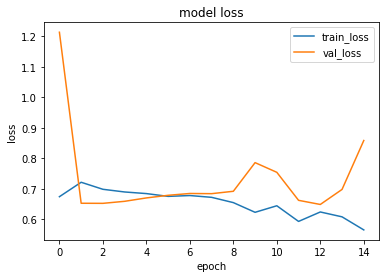

1it [00:00, 16710.37it/s]


prediction for video armflapping_1.mov is [[0.56203413]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.59417814]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.6743823]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.46274647]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.4193751]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.39017707]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 219ms/step - loss: 0.6989 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 0.6640 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6446 - accuracy: 0.7000 - precision: 0.8333 - recall: 0.5000 - val_loss: 0.6416 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7686 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.5745 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6491 - accuracy: 0.5875 - precision: 0.5574 - recall: 0.8500 - val_loss: 0.6492 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


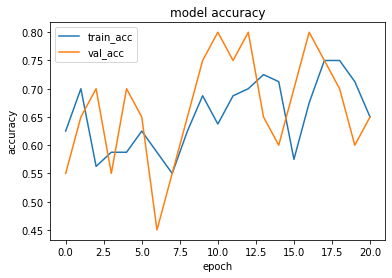

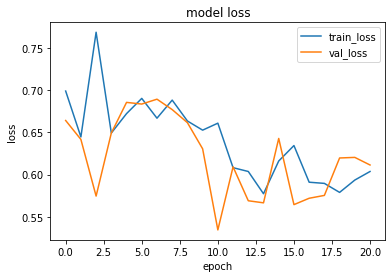

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4349075]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.5476639]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.59547603]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.4151588]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.3671593]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.38213387]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6916 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5000 - val_loss: 0.6685 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6409 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6607 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6333 - accuracy: 0.6750 - precision: 0.9375 - recall: 0.3750 - val_loss: 0.6409 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6441 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.6359 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75


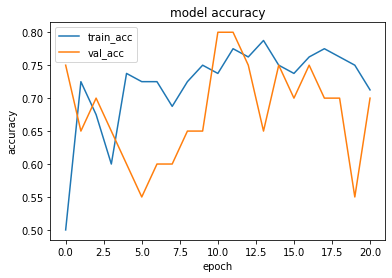

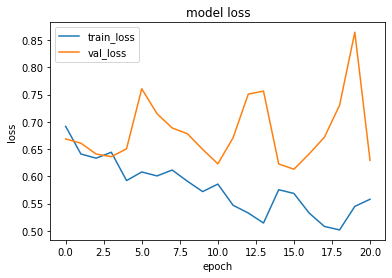

1it [00:00, 16448.25it/s]


prediction for video armflapping_1.mov is [[0.43187743]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.54772985]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.52196765]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.31969377]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.28589326]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.22369319]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6997 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9500 - val_loss: 0.6807 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6861 - accuracy: 0.5750 - precision: 0.6364 - recall: 0.3500 - val_loss: 0.6256 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6441 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.6542 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7103 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.7179 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


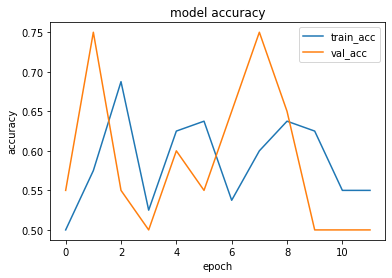

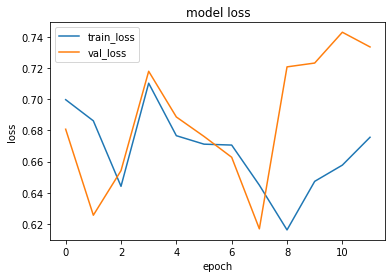

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.51686794]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.5659431]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.52824616]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.5193311]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.51485324]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.5186923]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6962 - accuracy: 0.6500 - precision: 0.6364 - recall: 0.7000 - val_loss: 0.6729 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6517 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6606 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6623 - accuracy: 0.5500 - precision: 0.5769 - recall: 0.3750 - val_loss: 0.6544 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6483 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.6660 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3

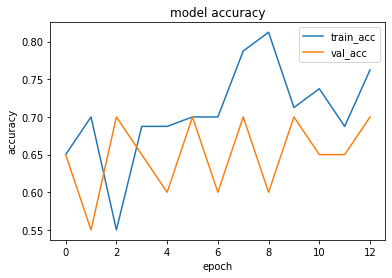

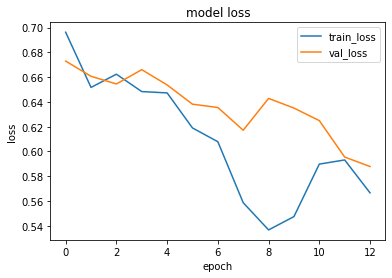

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.4530996]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5378343]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.549075]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.35430038]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.32169366]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.31390277]]


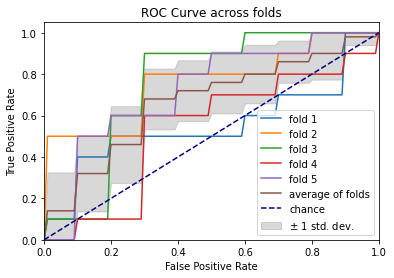

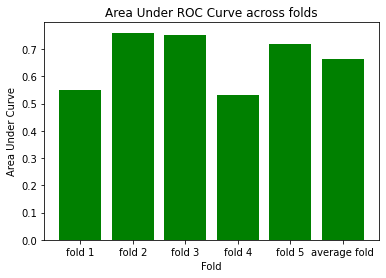

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6913 - accuracy: 0.4625 - precision: 0.4737 - recall: 0.6750 - val_loss: 0.6462 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6880 - accuracy: 0.5500 - precision: 0.6000 - recall: 0.3000 - val_loss: 0.6241 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6569 - accuracy: 0.6125 - precision: 0.6047 - recall: 0.6500 - val_loss: 0.5933 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6420 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.5810 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 132ms/step 

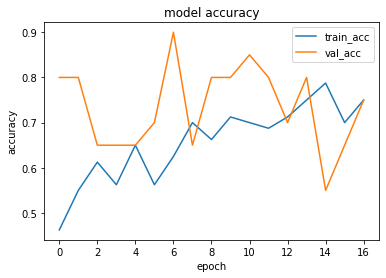

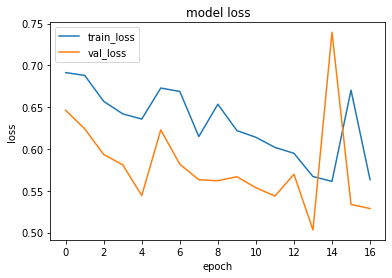

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.32861668]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.46329385]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.49674675]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.2977491]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.29477698]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.29032147]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6930 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7750 - val_loss: 0.6822 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6568 - accuracy: 0.6750 - precision: 0.8182 - recall: 0.4500 - val_loss: 0.6552 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6210 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6719 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6053 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.6876 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


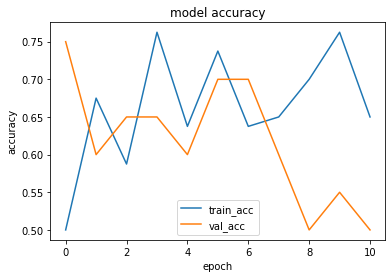

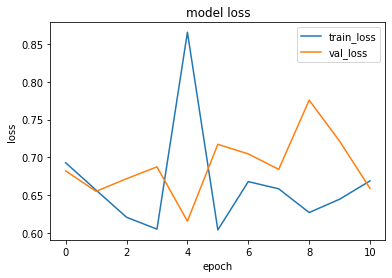

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5135306]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_3.mov is [[0.53894323]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.5230132]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.5121218]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.5142395]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.5138269]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6942 - accuracy: 0.4625 - precision: 0.4727 - recall: 0.6500 - val_loss: 0.6765 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6552 - accuracy: 0.5875 - precision: 0.7333 - recall: 0.2750 - val_loss: 0.6953 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6034 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.9620 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.5878 - accuracy: 0.7500 - precision: 0.7083 - recall: 0.8500 - val_loss: 0.7582 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75
3

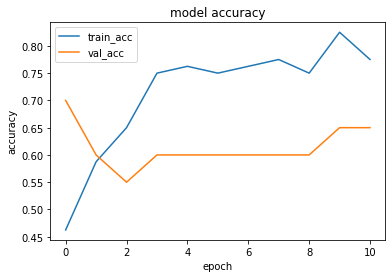

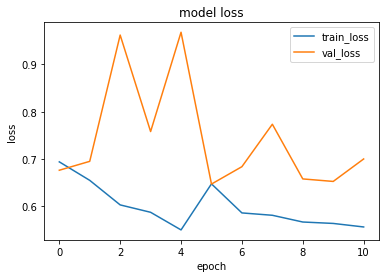

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.27720612]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.48782557]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.59208834]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.19937795]]


1it [00:00, 12985.46it/s]


prediction for video control_2.mov is [[0.18224299]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.21910411]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6874 - accuracy: 0.6250 - precision: 0.6000 - recall: 0.7500 - val_loss: 0.6885 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6593 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6565 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6767 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6478 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6740 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.6340 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 5/75


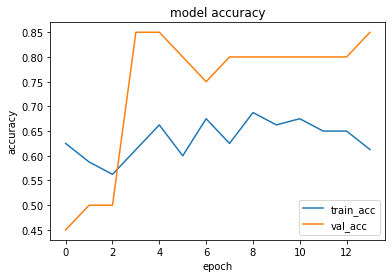

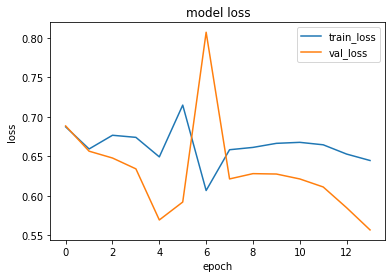

1it [00:00, 12520.31it/s]


prediction for video armflapping_1.mov is [[0.3984897]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.4514497]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.476438]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.3256424]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.2890095]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.31775856]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6793 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6470 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6194 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.5824 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6850 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.7277 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6627 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.7240 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75


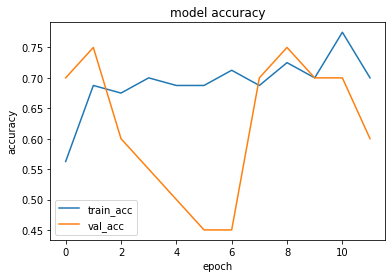

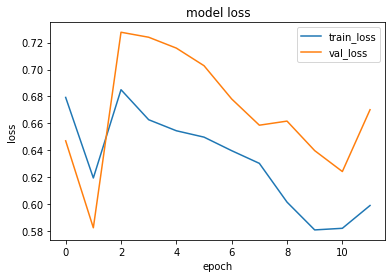

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5875381]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.58948755]]


1it [00:00, 11618.57it/s]


prediction for video armflapping_2.mov is [[0.5622282]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.5585261]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.5360451]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.5440096]]


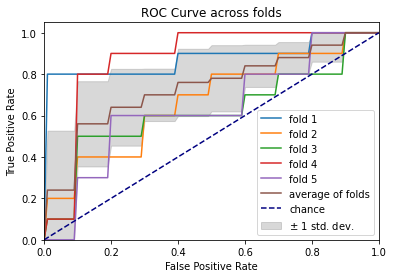

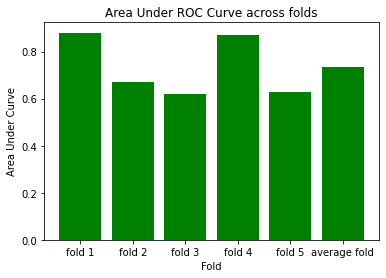

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6914 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7750 - val_loss: 0.7079 - val_accuracy: 0.4500 - val_precision: 0.4286 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6607 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.7647 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6245 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.8946 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6219 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6037 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

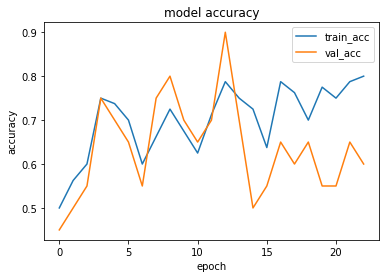

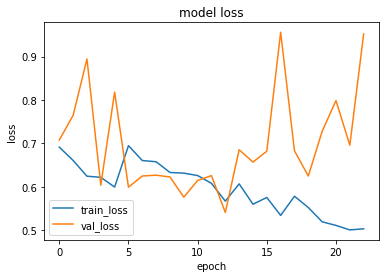

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.42639872]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5803305]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.65682024]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.10180706]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.09430707]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.09017259]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6897 - accuracy: 0.5875 - precision: 0.5814 - recall: 0.6250 - val_loss: 0.5937 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6585 - accuracy: 0.5750 - precision: 0.5577 - recall: 0.7250 - val_loss: 0.5481 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6527 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.5984 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6518 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5806 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75


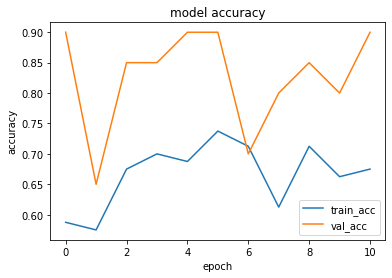

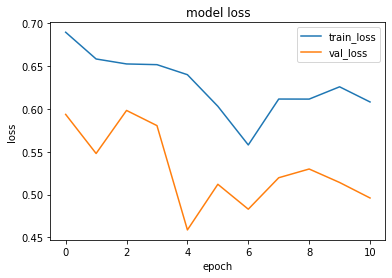

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.39393735]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.47526956]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.47712654]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.3531263]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.3502821]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.3410452]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7009 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4750 - val_loss: 0.6996 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6564 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.6833 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6798 - accuracy: 0.6750 - precision: 1.0000 - recall: 0.3500 - val_loss: 0.6933 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6373 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.7255 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75
3

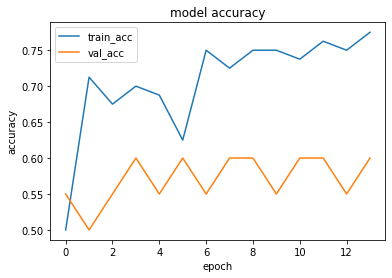

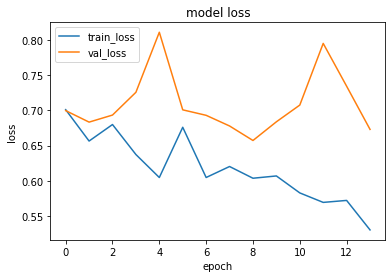

1it [00:00, 16710.37it/s]


prediction for video armflapping_1.mov is [[0.14851248]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.55304223]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.39152163]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.11983246]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.11348167]]


1it [00:00, 12018.06it/s]


prediction for video control_3.mov is [[0.11662745]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6862 - accuracy: 0.5250 - precision: 0.5294 - recall: 0.4500 - val_loss: 0.6286 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.7397 - accuracy: 0.5125 - precision: 0.5082 - recall: 0.7750 - val_loss: 0.6641 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6702 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.6725 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6691 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.6740 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


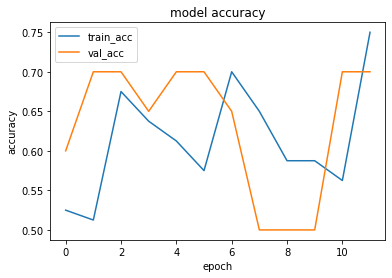

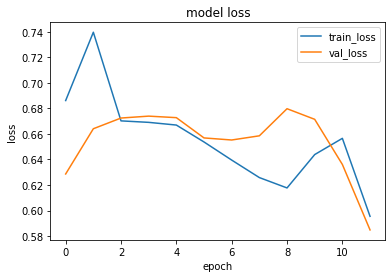

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4094163]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.47328824]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.49030226]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.2192333]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.13118005]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.31601658]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6872 - accuracy: 0.6125 - precision: 0.6364 - recall: 0.5250 - val_loss: 0.6653 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7710 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.6631 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6524 - accuracy: 0.5125 - precision: 0.6000 - recall: 0.0750 - val_loss: 0.6772 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6563 - accuracy: 0.6250 - precision: 0.8125 - recall: 0.3250 - val_loss: 0.6839 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


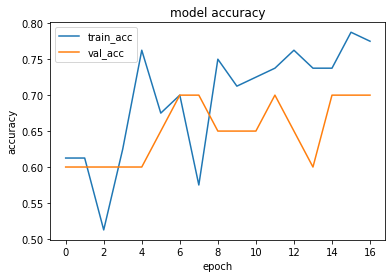

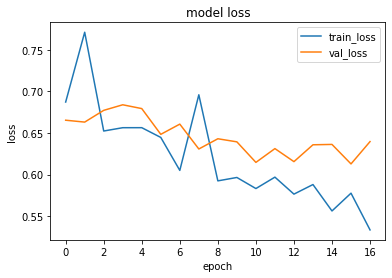

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.46796882]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.54057795]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.62916136]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.39972875]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.3510434]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.36107832]]


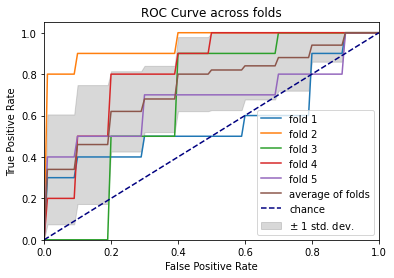

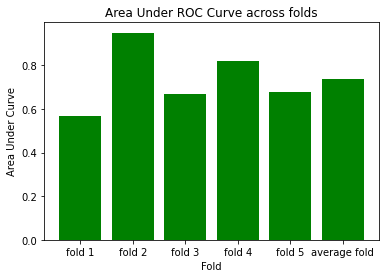

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6968 - accuracy: 0.4500 - precision: 0.4167 - recall: 0.2500 - val_loss: 0.6895 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6801 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.7339 - val_accuracy: 0.3500 - val_precision: 0.4000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6398 - accuracy: 0.5875 - precision: 0.5897 - recall: 0.5750 - val_loss: 0.7567 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6701 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.8450 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 124ms/step 

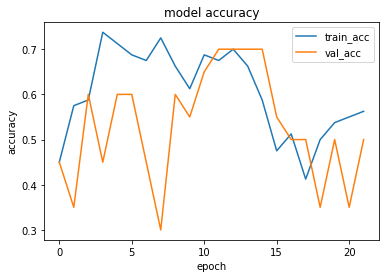

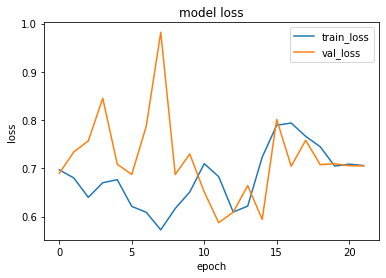

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.4922297]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.4673574]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.4906387]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.4926942]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.4928395]]


1it [00:00, 12633.45it/s]


prediction for video control_3.mov is [[0.4928425]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6996 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8250 - val_loss: 0.6825 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6859 - accuracy: 0.5375 - precision: 0.7143 - recall: 0.1250 - val_loss: 0.6664 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6626 - accuracy: 0.5750 - precision: 0.8000 - recall: 0.2000 - val_loss: 0.6324 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 1s 202ms/step - loss: 0.6491 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.6110 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoc

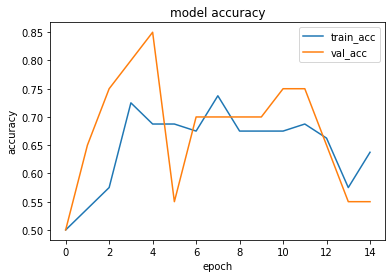

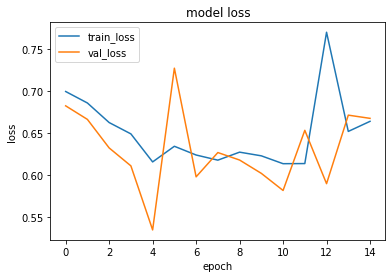

1it [00:00, 11618.57it/s]


prediction for video armflapping_1.mov is [[0.56677383]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.58185375]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.5705564]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.564605]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.56395066]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.5638139]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6920 - accuracy: 0.5250 - precision: 0.5238 - recall: 0.5500 - val_loss: 0.7062 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6809 - accuracy: 0.6500 - precision: 0.5938 - recall: 0.9500 - val_loss: 0.6654 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6522 - accuracy: 0.5625 - precision: 0.7778 - recall: 0.1750 - val_loss: 0.6534 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6222 - accuracy: 0.6250 - precision: 0.7500 - recall: 0.3750 - val_loss: 0.8929 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 5/75
3

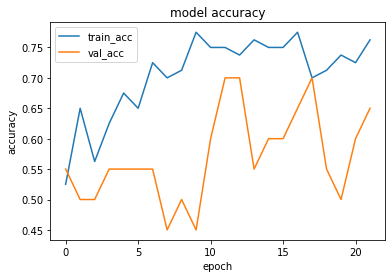

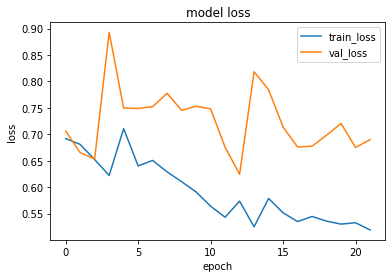

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.19935855]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.5455887]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.6009734]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.09533423]]


1it [00:00, 13443.28it/s]


prediction for video control_2.mov is [[0.09228152]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.09386718]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7034 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6736 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6742 - accuracy: 0.6250 - precision: 0.7273 - recall: 0.4000 - val_loss: 0.6505 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6349 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6172 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6109 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5988 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75


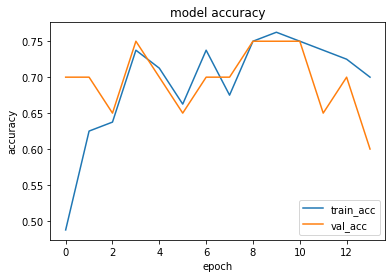

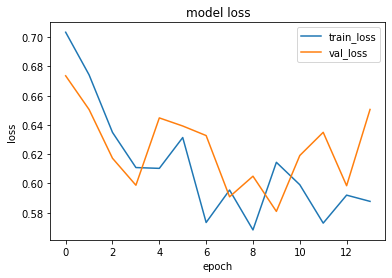

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.6802931]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_3.mov is [[0.31204093]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.67006075]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.42983454]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.4124444]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.38066489]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7116 - accuracy: 0.4750 - precision: 0.4783 - recall: 0.5500 - val_loss: 0.6817 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6980 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1750 - val_loss: 0.6676 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6833 - accuracy: 0.5750 - precision: 0.6667 - recall: 0.3000 - val_loss: 0.6023 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6631 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.5690 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75


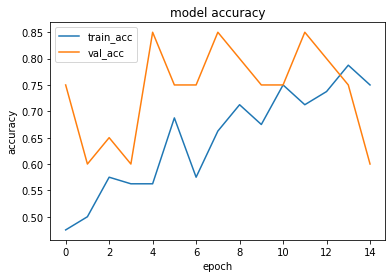

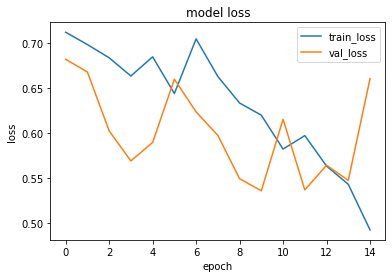

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.36009783]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_3.mov is [[0.5313096]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.5958809]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.28618515]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.27162552]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.26391223]]


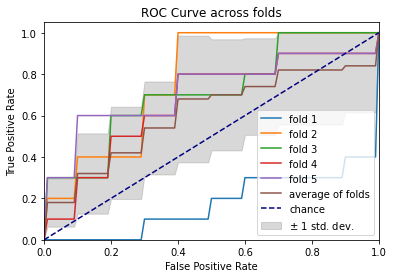

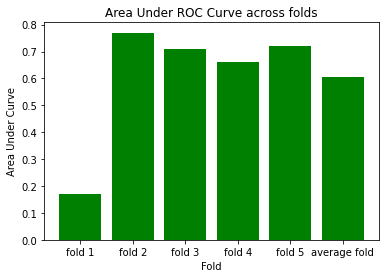

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6823 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.7198 - val_accuracy: 0.4000 - val_precision: 0.4375 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7949 - accuracy: 0.6125 - precision: 0.6000 - recall: 0.6750 - val_loss: 0.7040 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6340 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6682 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6708 - accuracy: 0.6500 - precision: 0.6154 - recall: 0.8000 - val_loss: 0.6677 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

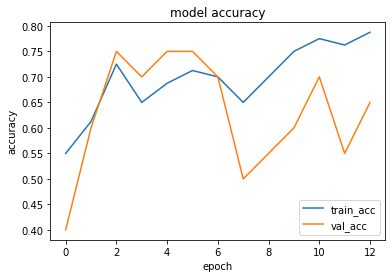

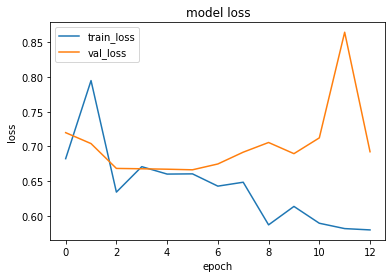

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.5584251]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.58097875]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.63503414]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.19450653]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.16755185]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.32199287]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7050 - accuracy: 0.3375 - precision: 0.3673 - recall: 0.4500 - val_loss: 0.6866 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6804 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.7069 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6657 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.6420 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6187 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.7343 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


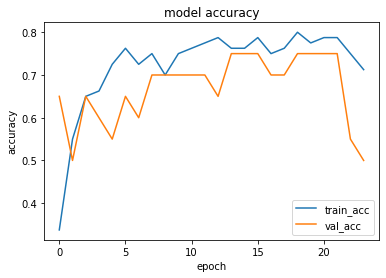

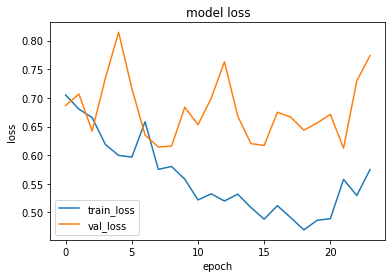

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.2607001]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.3255296]]


1it [00:00, 8065.97it/s]


prediction for video armflapping_2.mov is [[0.3300835]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.24158466]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.23473513]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.2350753]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 136ms/step - loss: 0.6998 - accuracy: 0.4375 - precision: 0.4000 - recall: 0.2500 - val_loss: 0.6729 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7031 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6664 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6565 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.6678 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6435 - accuracy: 0.7125 - precision: 0.7931 - recall: 0.5750 - val_loss: 0.6612 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3

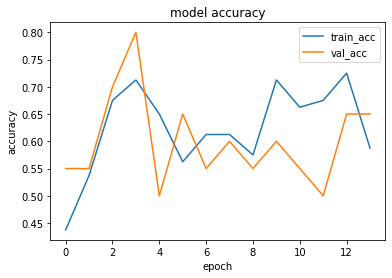

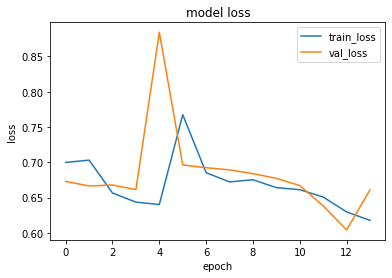

1it [00:00, 13443.28it/s]


prediction for video armflapping_1.mov is [[0.54715914]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.5625727]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5656646]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.52835846]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.5176944]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.5092504]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7126 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1250 - val_loss: 0.6787 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6874 - accuracy: 0.5125 - precision: 0.5094 - recall: 0.6750 - val_loss: 0.6625 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6778 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6422 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6506 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6361 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75
3

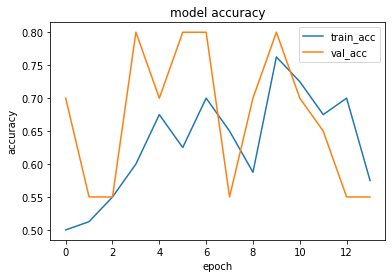

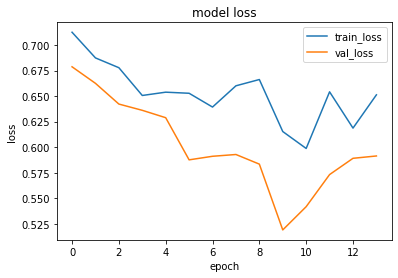

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.5511974]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.5713784]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.55569005]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.53458774]]


1it [00:00, 12985.46it/s]


prediction for video control_2.mov is [[0.5220356]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.5241284]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6962 - accuracy: 0.4875 - precision: 0.4898 - recall: 0.6000 - val_loss: 0.6927 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6705 - accuracy: 0.5375 - precision: 0.5405 - recall: 0.5000 - val_loss: 0.6517 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6549 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.6263 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6701 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.6563 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3

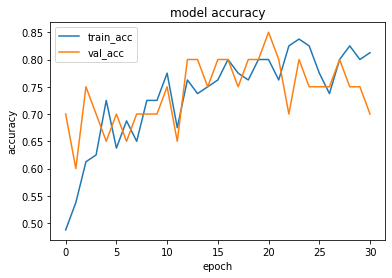

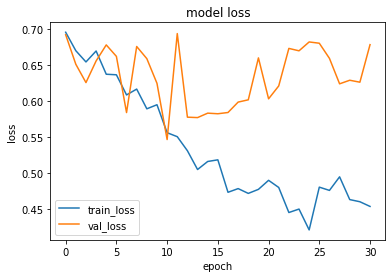

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.49354005]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.8016146]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.72590107]]


1it [00:00, 12826.62it/s]


prediction for video control_1.mov is [[0.36695927]]


1it [00:00, 13357.66it/s]


prediction for video control_2.mov is [[0.32843181]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.3110429]]


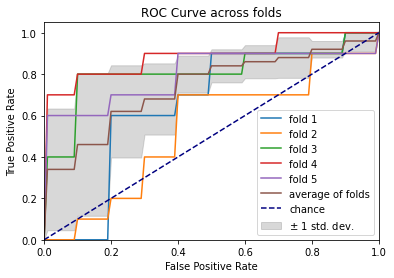

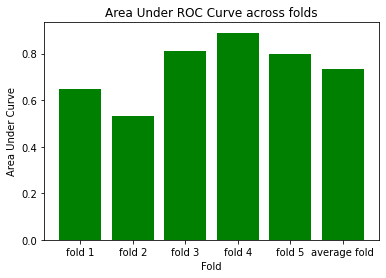

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6868 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6000 - val_loss: 0.6581 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7963 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6502 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6507 - accuracy: 0.6375 - precision: 0.8235 - recall: 0.3500 - val_loss: 0.6498 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6591 - accuracy: 0.6250 - precision: 0.6923 - recall: 0.4500 - val_loss: 0.6550 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

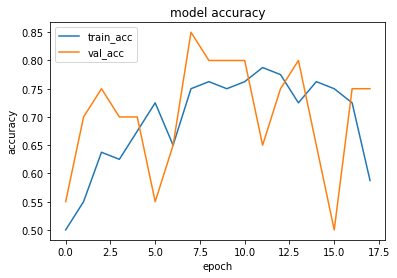

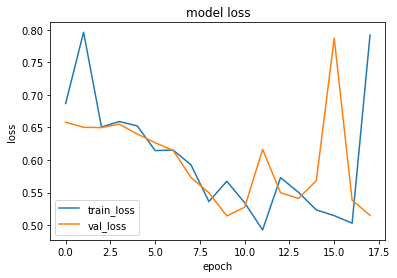

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.4258899]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.55422556]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.48337153]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.39017287]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.37449074]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.3741738]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6839 - accuracy: 0.4750 - precision: 0.4821 - recall: 0.6750 - val_loss: 0.6768 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6771 - accuracy: 0.5250 - precision: 0.5238 - recall: 0.5500 - val_loss: 0.6792 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6472 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.6878 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6516 - accuracy: 0.6250 - precision: 0.7273 - recall: 0.4000 - val_loss: 0.6847 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 5/75
3

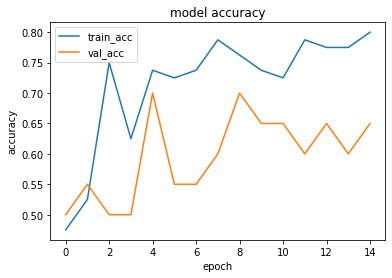

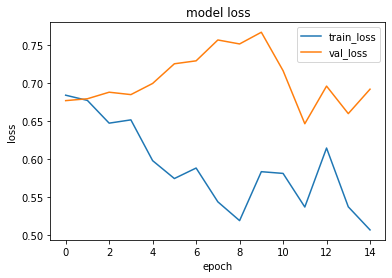

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.43297783]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.601144]]


1it [00:00, 9822.73it/s]


prediction for video armflapping_2.mov is [[0.65505636]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.28818142]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.27162686]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.23852786]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6865 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6687 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6593 - accuracy: 0.6125 - precision: 0.5957 - recall: 0.7000 - val_loss: 0.7045 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6126 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.7112 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.7257 - accuracy: 0.5750 - precision: 0.6500 - recall: 0.3250 - val_loss: 0.7249 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epo

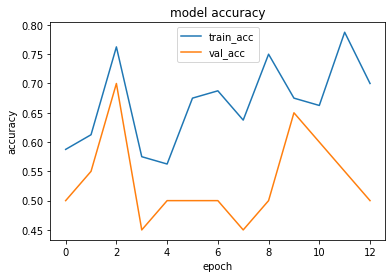

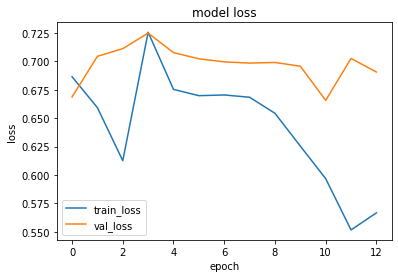

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.36273804]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.43907493]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.50654316]]


1it [00:00, 12052.60it/s]


prediction for video control_1.mov is [[0.2748782]]


1it [00:00, 13842.59it/s]


prediction for video control_2.mov is [[0.24563855]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.25721318]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7022 - accuracy: 0.4125 - precision: 0.3871 - recall: 0.3000 - val_loss: 0.6385 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6721 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.5510 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6404 - accuracy: 0.6625 - precision: 0.6585 - recall: 0.6750 - val_loss: 0.6524 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6980 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.5749 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 5/75


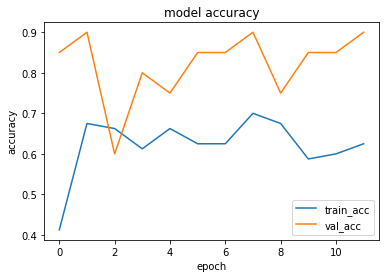

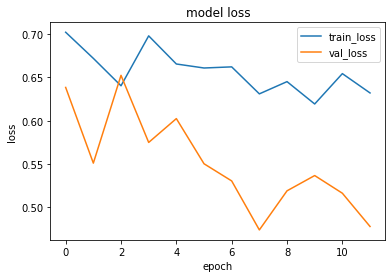

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.47946715]]


1it [00:00, 12483.05it/s]


prediction for video armflapping_3.mov is [[0.596523]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.6259041]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.41303906]]


1it [00:00, 17476.27it/s]


prediction for video control_2.mov is [[0.39502758]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.39489186]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7023 - accuracy: 0.4625 - precision: 0.4634 - recall: 0.4750 - val_loss: 0.6808 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6863 - accuracy: 0.4500 - precision: 0.4333 - recall: 0.3250 - val_loss: 0.6763 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6606 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6589 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6312 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.7983 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75


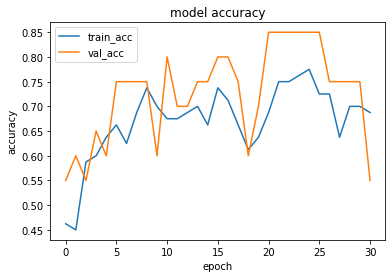

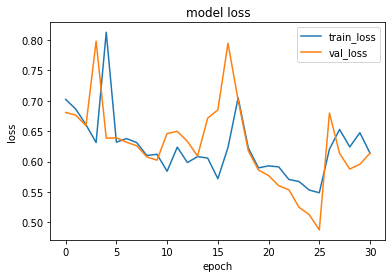

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.54950994]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.7069053]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.64871424]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.5104884]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.5285571]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.516292]]


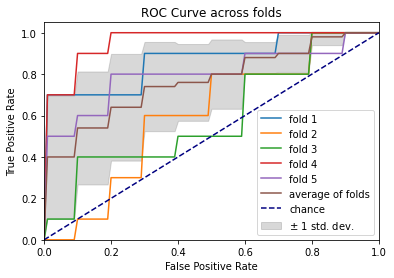

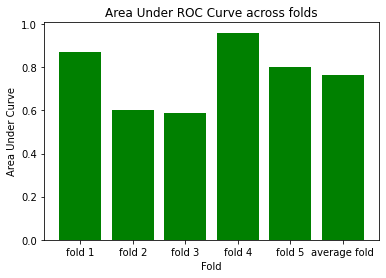

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7035 - accuracy: 0.4125 - precision: 0.4364 - recall: 0.6000 - val_loss: 0.6922 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6666 - accuracy: 0.5625 - precision: 0.8571 - recall: 0.1500 - val_loss: 0.6909 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6716 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6892 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6704 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6843 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

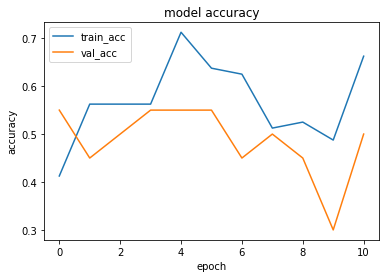

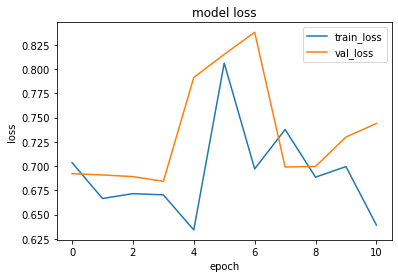

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.3510889]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.33906513]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.3514451]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.35025406]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.34999228]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.3498775]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7057 - accuracy: 0.4375 - precision: 0.4576 - recall: 0.6750 - val_loss: 0.6853 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6665 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.6463 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6441 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.7748 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.7165 - accuracy: 0.6000 - precision: 0.5769 - recall: 0.7500 - val_loss: 0.6677 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75
3

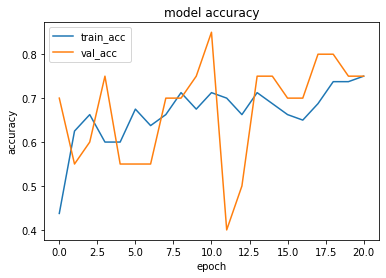

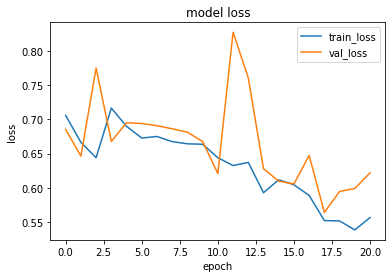

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.3013547]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.49629393]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_2.mov is [[0.53754604]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.22177872]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.21096957]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2194579]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6902 - accuracy: 0.4875 - precision: 0.4909 - recall: 0.6750 - val_loss: 0.7287 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.7494 - accuracy: 0.4375 - precision: 0.4390 - recall: 0.4500 - val_loss: 0.6769 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 188ms/step - loss: 0.6694 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6799 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6716 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6721 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3

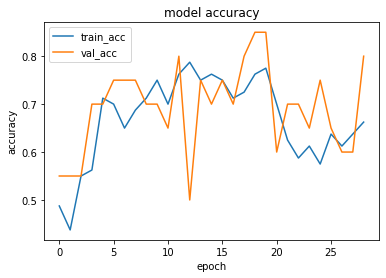

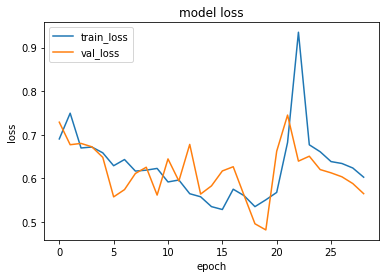

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.4957053]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5424588]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5407909]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.4746933]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.4651678]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.4624167]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 131ms/step - loss: 0.6998 - accuracy: 0.5375 - precision: 0.5484 - recall: 0.4250 - val_loss: 0.6698 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6702 - accuracy: 0.5750 - precision: 0.6667 - recall: 0.3000 - val_loss: 0.6299 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6394 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.4736 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7380 - accuracy: 0.6625 - precision: 0.6383 - recall: 0.7500 - val_loss: 0.7315 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3

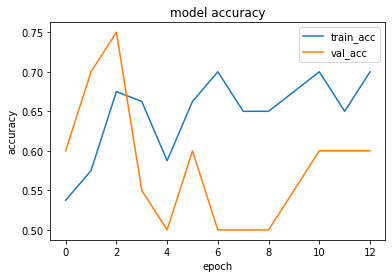

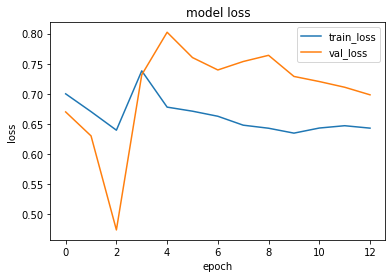

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.48240814]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.5298901]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.53204376]]


1it [00:00, 16644.06it/s]


prediction for video control_1.mov is [[0.41334033]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.36305237]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.3826597]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6949 - accuracy: 0.4750 - precision: 0.4773 - recall: 0.5250 - val_loss: 0.7667 - val_accuracy: 0.3000 - val_precision: 0.3571 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6362 - accuracy: 0.5875 - precision: 0.5574 - recall: 0.8500 - val_loss: 0.7070 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.7267 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.8493 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6179 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6619 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3

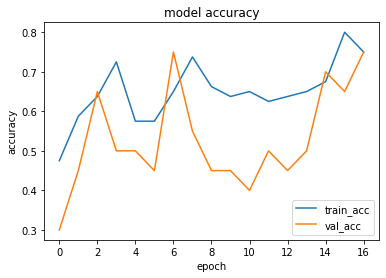

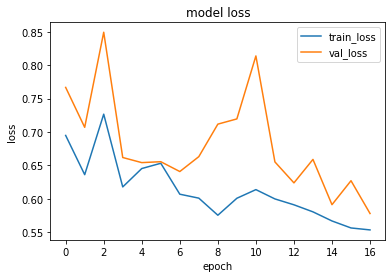

1it [00:00, 17189.77it/s]


prediction for video armflapping_1.mov is [[0.40696004]]


1it [00:00, 13189.64it/s]


prediction for video armflapping_3.mov is [[0.5174861]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.51626986]]


1it [00:00, 14563.56it/s]


prediction for video control_1.mov is [[0.36250603]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.35812598]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.33917052]]


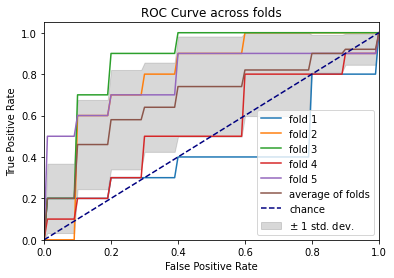

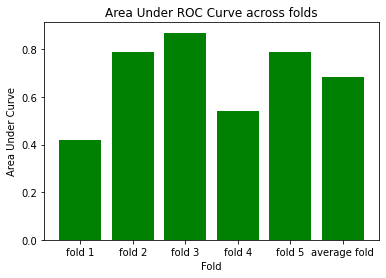

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6897 - accuracy: 0.5375 - precision: 0.5254 - recall: 0.7750 - val_loss: 0.6714 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6737 - accuracy: 0.5625 - precision: 0.5581 - recall: 0.6000 - val_loss: 0.6478 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.7091 - accuracy: 0.6375 - precision: 0.6410 - recall: 0.6250 - val_loss: 0.5980 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6283 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6474 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

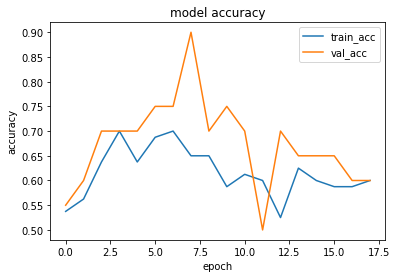

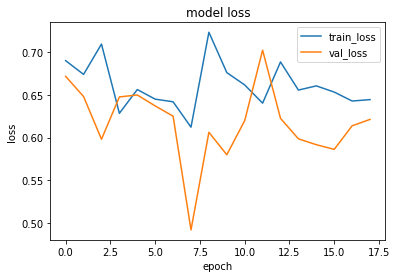

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5250682]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.55489814]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.5322714]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.51894814]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.5168559]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.51651865]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6850 - accuracy: 0.5125 - precision: 0.5085 - recall: 0.7500 - val_loss: 0.6335 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6802 - accuracy: 0.5750 - precision: 0.6250 - recall: 0.3750 - val_loss: 0.6568 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6649 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6609 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6410 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6172 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


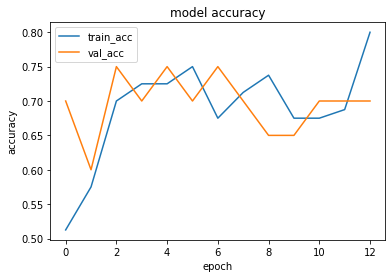

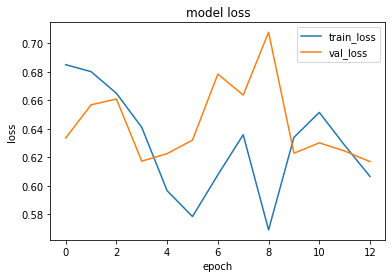

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5152022]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_3.mov is [[0.59275466]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.55674094]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.48807913]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.48137325]]


1it [00:00, 16070.13it/s]


prediction for video control_3.mov is [[0.47943753]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7038 - accuracy: 0.3875 - precision: 0.3200 - recall: 0.2000 - val_loss: 0.7077 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6704 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6833 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6659 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6702 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 184ms/step - loss: 0.6365 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.8284 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75


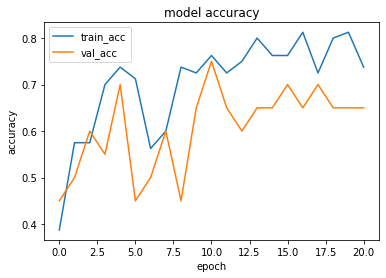

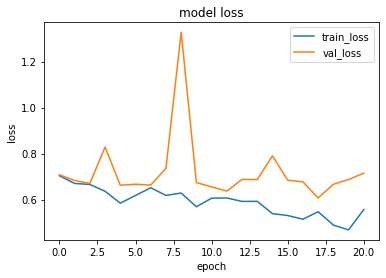

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.3305208]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.40793642]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.5369093]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.28942338]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.27089196]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.27183998]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7007 - accuracy: 0.5875 - precision: 0.6522 - recall: 0.3750 - val_loss: 0.6815 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6883 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8000 - val_loss: 0.6924 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6577 - accuracy: 0.6625 - precision: 0.6383 - recall: 0.7500 - val_loss: 0.6709 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6708 - accuracy: 0.6250 - precision: 0.8125 - recall: 0.3250 - val_loss: 0.6791 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75


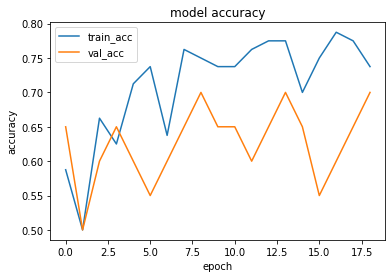

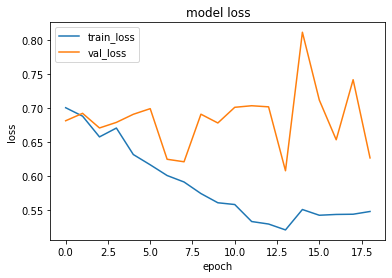

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.47789422]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.59461546]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.61496824]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.4193504]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.40139493]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.3953638]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7042 - accuracy: 0.4875 - precision: 0.4925 - recall: 0.8250 - val_loss: 0.6727 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6902 - accuracy: 0.5625 - precision: 0.6923 - recall: 0.2250 - val_loss: 0.6555 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6784 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6575 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6766 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.6467 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75
3

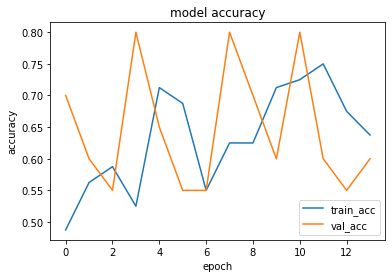

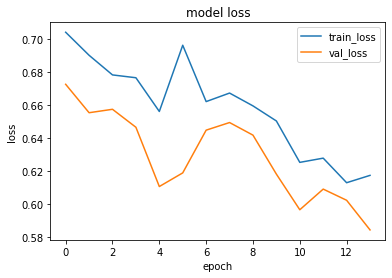

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.59696794]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.6414929]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.6240329]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.5687148]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.5580872]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.55406153]]


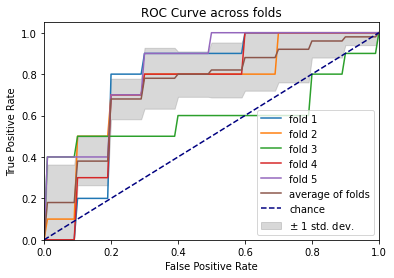

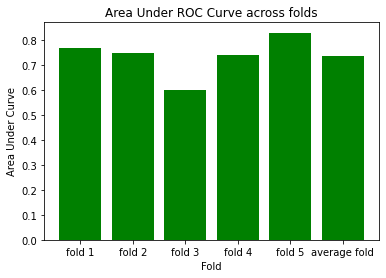

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7026 - accuracy: 0.4750 - precision: 0.4667 - recall: 0.3500 - val_loss: 0.6878 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6636 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.6722 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6224 - accuracy: 0.6000 - precision: 0.5556 - recall: 1.0000 - val_loss: 0.7034 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6339 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.6918 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

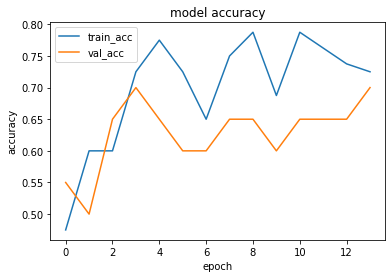

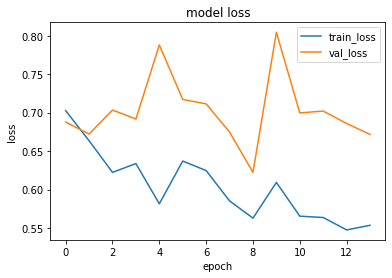

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.39322913]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.5531593]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.5610728]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.29636025]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.26821485]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.29358035]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6922 - accuracy: 0.4500 - precision: 0.4375 - recall: 0.3500 - val_loss: 0.6948 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 193ms/step - loss: 0.8010 - accuracy: 0.5750 - precision: 0.5714 - recall: 0.6000 - val_loss: 0.8200 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6798 - accuracy: 0.5375 - precision: 1.0000 - recall: 0.0750 - val_loss: 0.6958 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6652 - accuracy: 0.6625 - precision: 0.6066 - recall: 0.9250 - val_loss: 0.6901 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epo

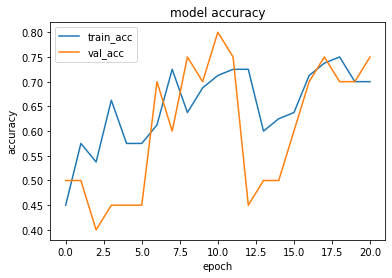

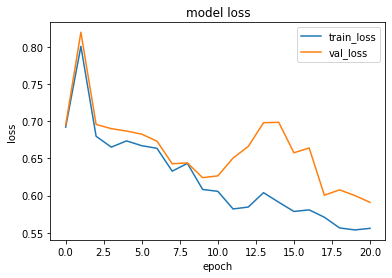

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.38265693]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.4712841]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.54574823]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.32200366]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.305473]]


1it [00:00, 13842.59it/s]


prediction for video control_3.mov is [[0.3019976]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6747 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 1.0504 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.8302 - accuracy: 0.4875 - precision: 0.4444 - recall: 0.1000 - val_loss: 0.6624 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6686 - accuracy: 0.5875 - precision: 0.5507 - recall: 0.9500 - val_loss: 0.6594 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6616 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.6025 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoc

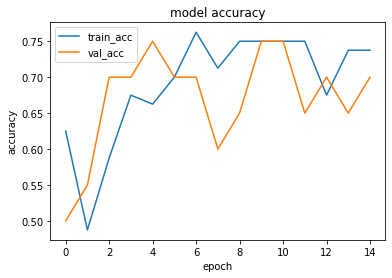

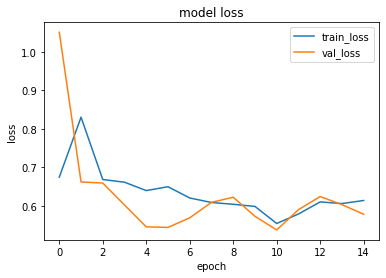

1it [00:00, 11244.78it/s]


prediction for video armflapping_1.mov is [[0.49972245]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.52832866]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.5062724]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.4650138]]


1it [00:00, 22192.08it/s]


prediction for video control_2.mov is [[0.43408602]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.4368059]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7012 - accuracy: 0.4500 - precision: 0.4600 - recall: 0.5750 - val_loss: 0.6659 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6695 - accuracy: 0.6625 - precision: 0.7826 - recall: 0.4500 - val_loss: 0.6192 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6353 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6759 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6433 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6502 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75
3

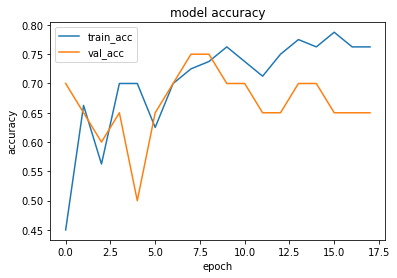

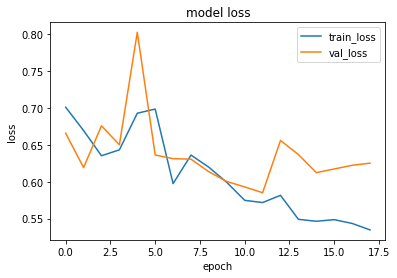

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.2779038]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.36191857]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.6660044]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.2544819]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.24238077]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.24031258]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7223 - accuracy: 0.4625 - precision: 0.4000 - recall: 0.1500 - val_loss: 0.6908 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6930 - accuracy: 0.5500 - precision: 0.5476 - recall: 0.5750 - val_loss: 0.6641 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6643 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6989 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.8026 - accuracy: 0.5375 - precision: 0.5224 - recall: 0.8750 - val_loss: 0.6210 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epo

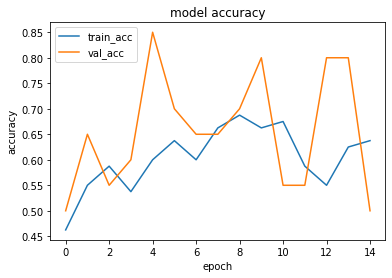

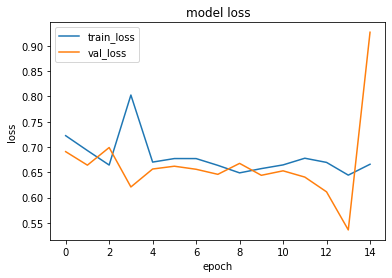

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.1653946]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.17803124]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.17193323]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.16190228]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.16049808]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.16033459]]


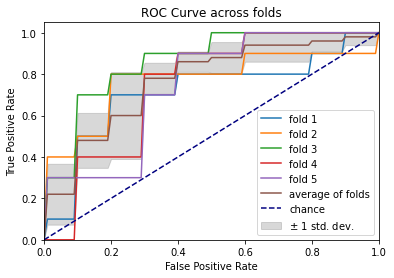

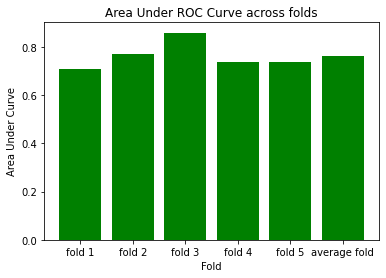

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6947 - accuracy: 0.4500 - precision: 0.4167 - recall: 0.2500 - val_loss: 0.7051 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6493 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.8067 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6421 - accuracy: 0.6000 - precision: 0.6053 - recall: 0.5750 - val_loss: 0.6981 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6221 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.7393 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

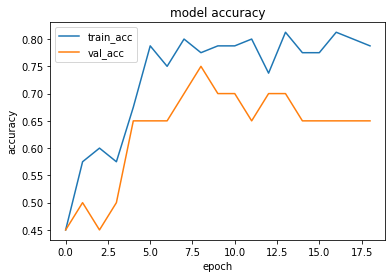

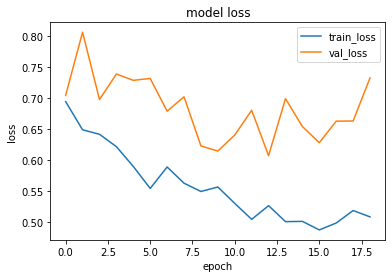

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.47510692]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.58450365]]


1it [00:00, 12372.58it/s]


prediction for video armflapping_2.mov is [[0.6839938]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.33849907]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.2916345]]


1it [00:00, 12633.45it/s]


prediction for video control_3.mov is [[0.28158978]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6866 - accuracy: 0.4375 - precision: 0.4510 - recall: 0.5750 - val_loss: 0.9529 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.7083 - accuracy: 0.6125 - precision: 0.6364 - recall: 0.5250 - val_loss: 0.6551 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6864 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6512 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 184ms/step - loss: 0.6700 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6400 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epo

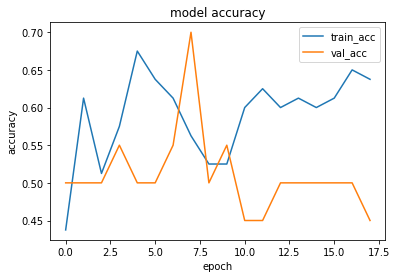

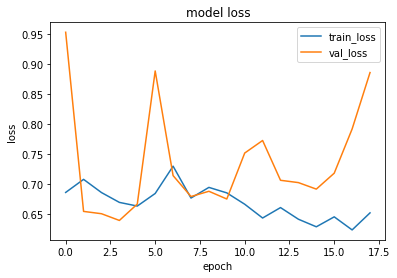

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.5394491]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5406129]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.5430938]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.5339721]]


1it [00:00, 14027.77it/s]


prediction for video control_2.mov is [[0.5306874]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.53097785]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6861 - accuracy: 0.6375 - precision: 0.6279 - recall: 0.6750 - val_loss: 0.6606 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6963 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6525 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6693 - accuracy: 0.5750 - precision: 0.8750 - recall: 0.1750 - val_loss: 0.6435 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6564 - accuracy: 0.6500 - precision: 0.7500 - recall: 0.4500 - val_loss: 0.6398 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epo

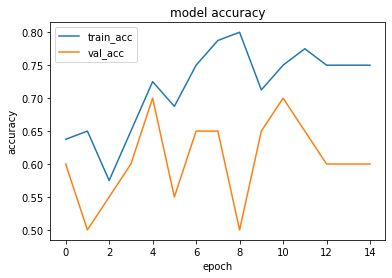

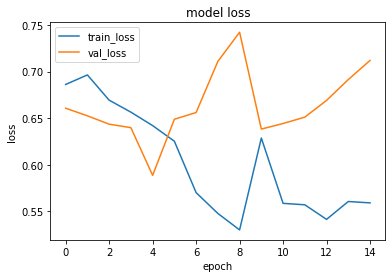

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.3626551]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.45216167]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.44337747]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.3197989]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.3037387]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.29632062]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7034 - accuracy: 0.3875 - precision: 0.3902 - recall: 0.4000 - val_loss: 0.6837 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6741 - accuracy: 0.5750 - precision: 0.5625 - recall: 0.6750 - val_loss: 0.6293 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6877 - accuracy: 0.6250 - precision: 0.6136 - recall: 0.6750 - val_loss: 0.5974 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6364 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.6426 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


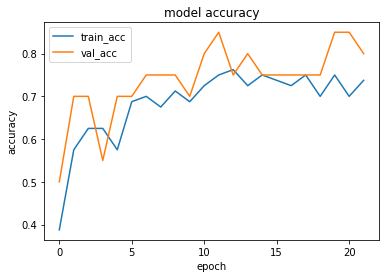

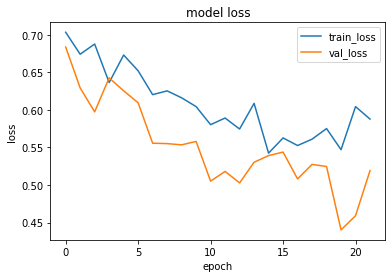

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.51502174]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.60196507]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.6151761]]


1it [00:00, 9597.95it/s]


prediction for video control_1.mov is [[0.45313603]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.4259413]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.41152948]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6723 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.7091 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6567 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.6988 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6466 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.7034 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6227 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.7131 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

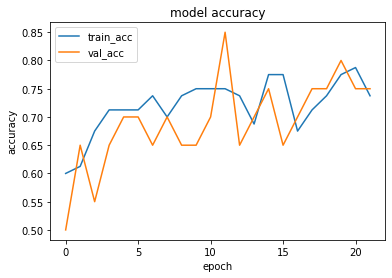

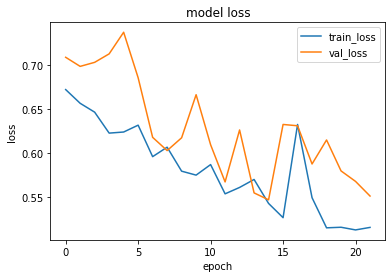

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.3981034]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.64534175]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.5877282]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.32307917]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.31238845]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.31153888]]


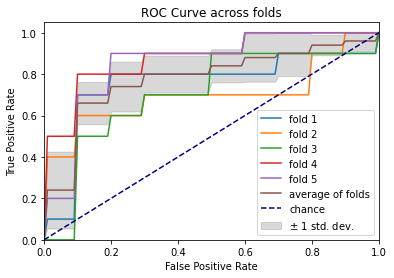

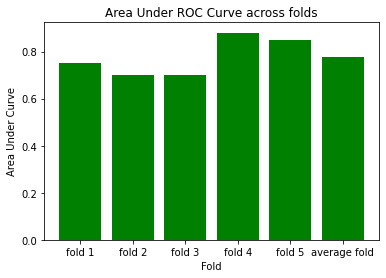

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6890 - accuracy: 0.4750 - precision: 0.4286 - recall: 0.1500 - val_loss: 0.6745 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6957 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6478 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6646 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.6918 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6922 - accuracy: 0.6000 - precision: 0.7000 - recall: 0.3500 - val_loss: 0.6396 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

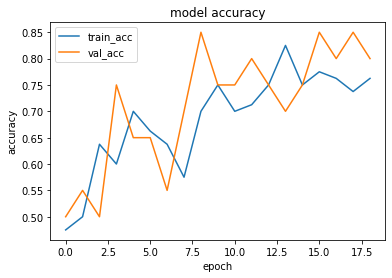

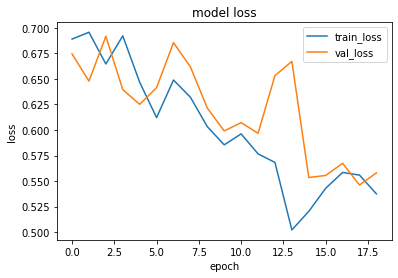

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.5692857]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.6707173]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.6878164]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.42453313]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.38313287]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.3530959]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7053 - accuracy: 0.4625 - precision: 0.4286 - recall: 0.2250 - val_loss: 0.6981 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 188ms/step - loss: 0.6947 - accuracy: 0.6375 - precision: 0.5873 - recall: 0.9250 - val_loss: 0.7593 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6284 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 0.7569 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6089 - accuracy: 0.6125 - precision: 0.7368 - recall: 0.3500 - val_loss: 0.7043 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 5/75
3

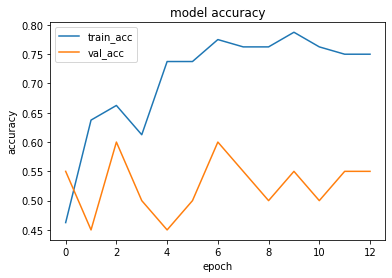

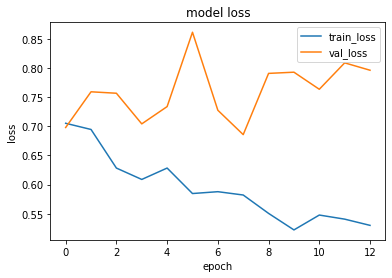

1it [00:00, 12372.58it/s]


prediction for video armflapping_1.mov is [[0.5177913]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.58065385]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.66006875]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.36621803]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.31909162]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.2990095]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6876 - accuracy: 0.4875 - precision: 0.4894 - recall: 0.5750 - val_loss: 0.6347 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6684 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.5296 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6749 - accuracy: 0.6125 - precision: 0.6098 - recall: 0.6250 - val_loss: 0.6260 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6549 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.5916 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75
3

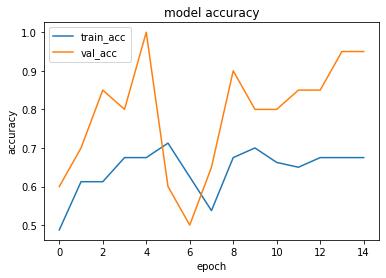

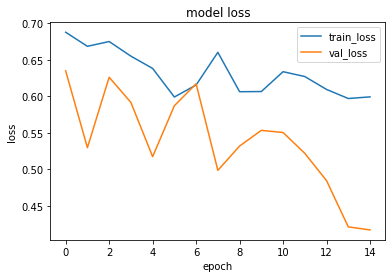

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.30288625]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.636574]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6079113]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.14270353]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.13518476]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.17962351]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6939 - accuracy: 0.5750 - precision: 0.5833 - recall: 0.5250 - val_loss: 0.6758 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6831 - accuracy: 0.5125 - precision: 0.5217 - recall: 0.3000 - val_loss: 0.6523 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6501 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.6848 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6307 - accuracy: 0.7250 - precision: 0.6607 - recall: 0.9250 - val_loss: 0.6802 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


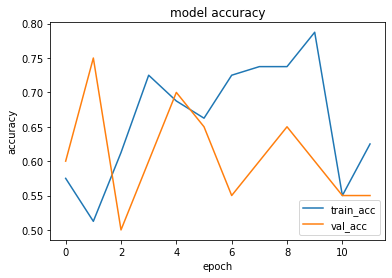

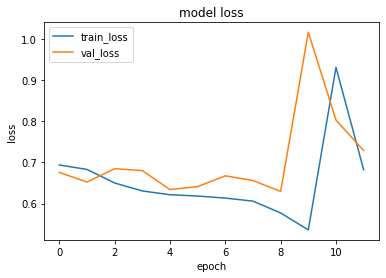

1it [00:00, 11915.64it/s]


prediction for video armflapping_1.mov is [[0.30941728]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.31674886]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.41494998]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.29514277]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.2898447]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.2892735]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7064 - accuracy: 0.4500 - precision: 0.4000 - recall: 0.2000 - val_loss: 0.6990 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6975 - accuracy: 0.5500 - precision: 0.5323 - recall: 0.8250 - val_loss: 0.6898 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6726 - accuracy: 0.6500 - precision: 0.6200 - recall: 0.7750 - val_loss: 0.6862 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6602 - accuracy: 0.6000 - precision: 0.5690 - recall: 0.8250 - val_loss: 0.6607 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3

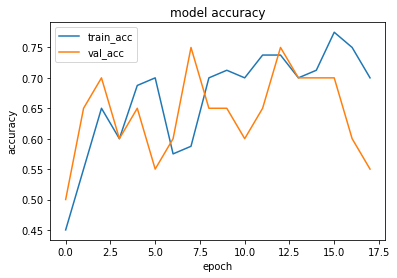

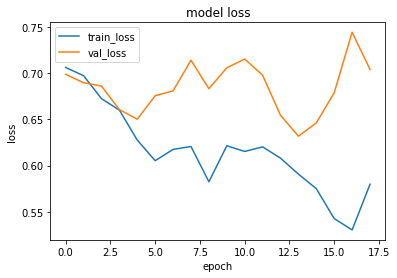

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.39884496]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.39608625]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.3918281]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.3691733]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.35632318]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.35953206]]


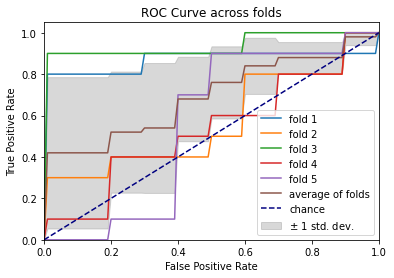

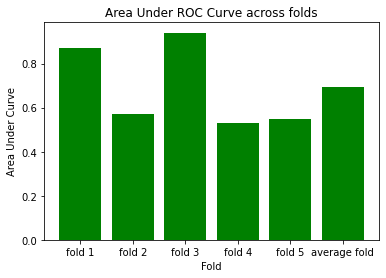

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6923 - accuracy: 0.4875 - precision: 0.4815 - recall: 0.3250 - val_loss: 0.6621 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6512 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6278 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6856 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6320 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6740 - accuracy: 0.5500 - precision: 0.5909 - recall: 0.3250 - val_loss: 0.6385 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] - 0s 119ms/step 

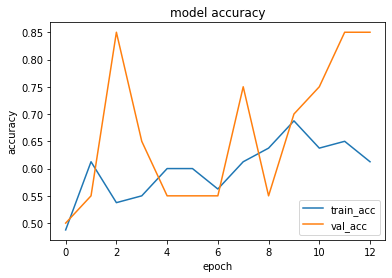

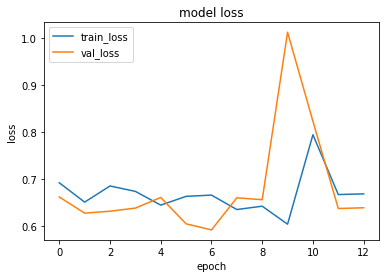

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4887727]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_3.mov is [[0.5077754]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.49545804]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.48181087]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.47883397]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.47883713]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6951 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.6642 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6591 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6636 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.8803 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.6276 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6356 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.6457 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 5/75


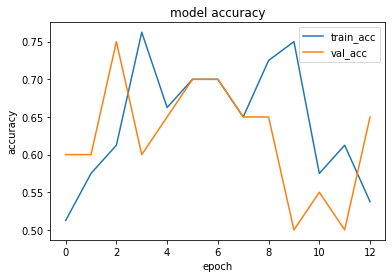

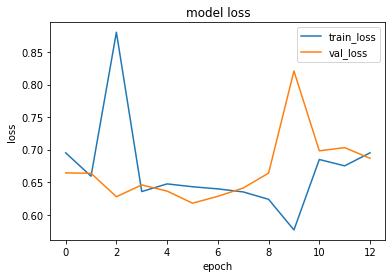

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.46137974]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.49781975]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.51570565]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.43715608]]


1it [00:00, 12520.31it/s]


prediction for video control_2.mov is [[0.42891452]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.43082434]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6788 - accuracy: 0.5250 - precision: 0.5143 - recall: 0.9000 - val_loss: 0.6271 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6825 - accuracy: 0.5625 - precision: 0.7273 - recall: 0.2000 - val_loss: 0.6451 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6202 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6481 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6628 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.6351 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

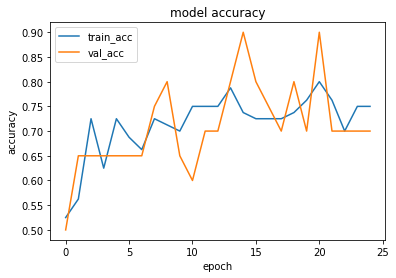

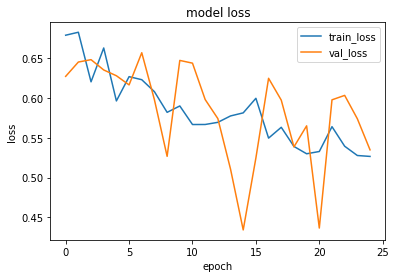

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.44588155]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.6314602]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.60216945]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.30270332]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.2771874]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.25008905]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6617 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.7147 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6166 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.6666 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6415 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6681 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6291 - accuracy: 0.6875 - precision: 0.8000 - recall: 0.5000 - val_loss: 0.6443 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


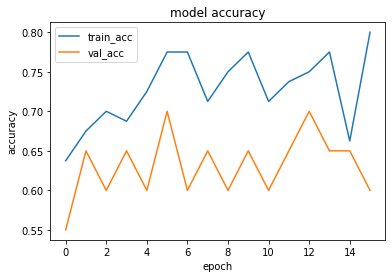

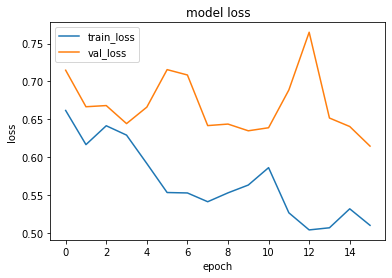

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.4655903]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.6289106]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_2.mov is [[0.5779647]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.3600093]]


1it [00:00, 13357.66it/s]


prediction for video control_2.mov is [[0.3274482]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.2950124]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6934 - accuracy: 0.4625 - precision: 0.4694 - recall: 0.5750 - val_loss: 0.6846 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6490 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.7192 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6659 - accuracy: 0.5625 - precision: 0.6316 - recall: 0.3000 - val_loss: 0.6862 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6365 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.7203 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoc

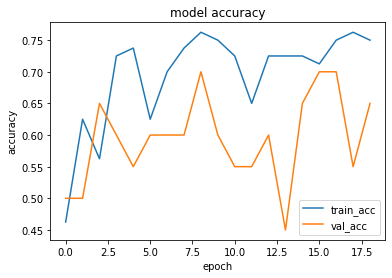

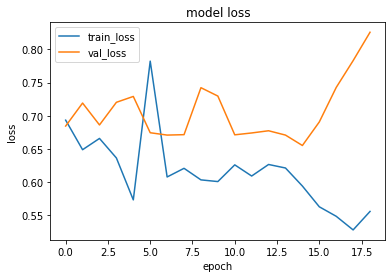

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4282621]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.569443]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.55797553]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.5120036]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.45275384]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.48045158]]


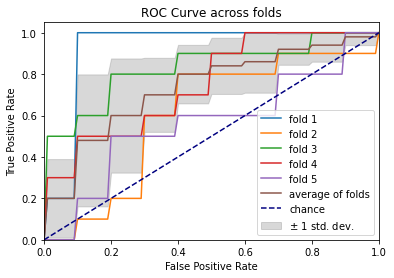

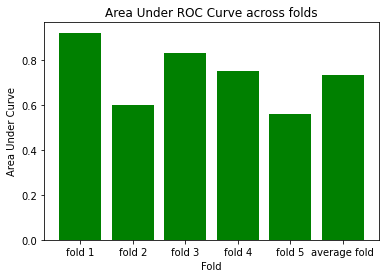

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6953 - accuracy: 0.4375 - precision: 0.4590 - recall: 0.7000 - val_loss: 0.6840 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6640 - accuracy: 0.6375 - precision: 0.8235 - recall: 0.3500 - val_loss: 0.6794 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.5888 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.8129 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6673 - accuracy: 0.5750 - precision: 0.8000 - recall: 0.2000 - val_loss: 0.6691 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 126ms/step 

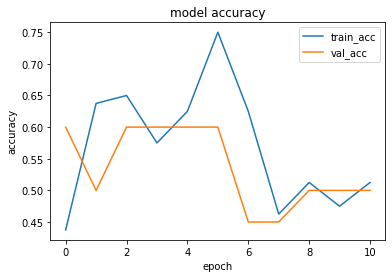

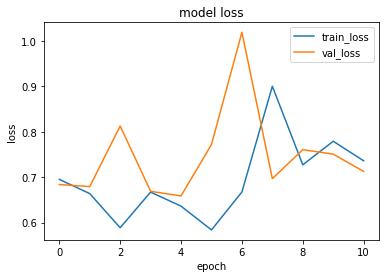

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.5885757]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.55990607]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.58735204]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.5886499]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.5886655]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.58866596]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 143ms/step - loss: 0.6990 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6662 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6867 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6703 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6808 - accuracy: 0.5500 - precision: 0.5312 - recall: 0.8500 - val_loss: 0.6634 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6782 - accuracy: 0.6500 - precision: 0.6500 - recall: 0.6500 - val_loss: 0.6356 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75


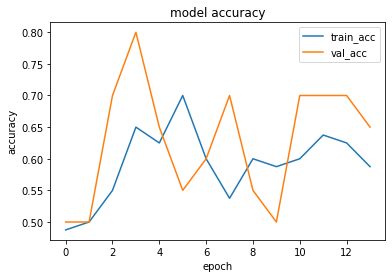

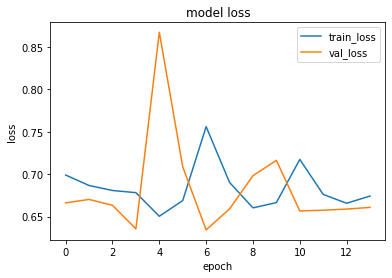

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4915642]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.53647166]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5411269]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.47190553]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.4731587]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.48511982]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6797 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.6325 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.7024 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.6952 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6479 - accuracy: 0.5750 - precision: 0.7143 - recall: 0.2500 - val_loss: 0.6931 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6362 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.6930 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


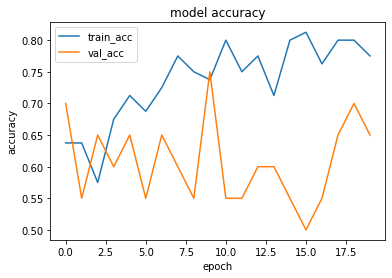

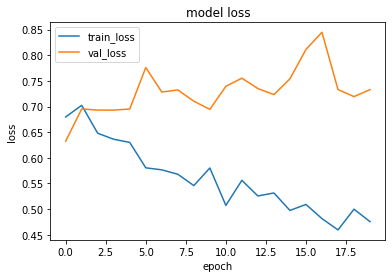

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.2632164]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.7836131]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.7673732]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.17847133]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.157877]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.15592146]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7140 - accuracy: 0.5750 - precision: 0.5556 - recall: 0.7500 - val_loss: 0.6765 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6852 - accuracy: 0.6000 - precision: 0.6429 - recall: 0.4500 - val_loss: 0.6392 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6515 - accuracy: 0.6875 - precision: 0.6364 - recall: 0.8750 - val_loss: 0.5724 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6406 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.6751 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75


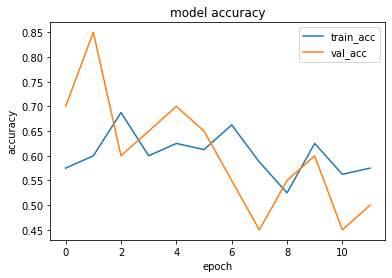

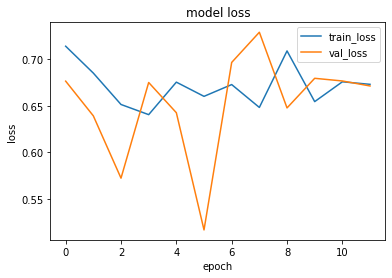

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5064487]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5443416]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.52234244]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.5027595]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.5065536]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.50616795]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 137ms/step - loss: 0.7093 - accuracy: 0.5250 - precision: 0.5333 - recall: 0.4000 - val_loss: 0.6726 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6810 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.6391 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6490 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6204 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6452 - accuracy: 0.5750 - precision: 0.5484 - recall: 0.8500 - val_loss: 0.6611 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


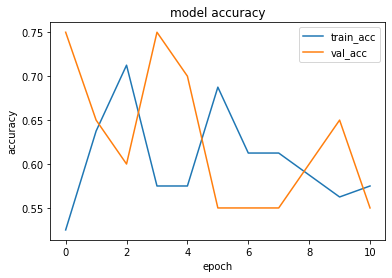

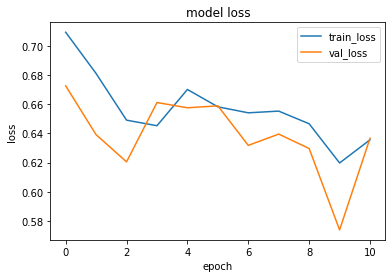

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.53493553]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.5651859]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5519141]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.51873726]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.51345134]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.51424414]]


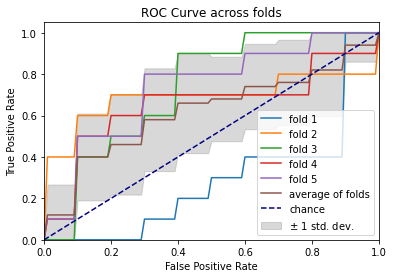

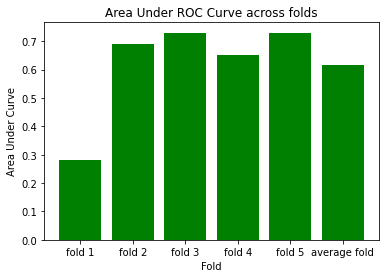

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7049 - accuracy: 0.4500 - precision: 0.3750 - recall: 0.1500 - val_loss: 0.6750 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6512 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.9290 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6905 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.6263 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6372 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.6608 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

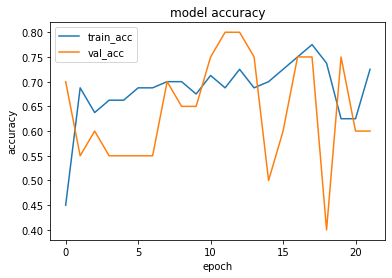

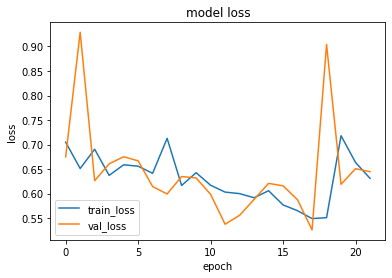

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.46633133]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_3.mov is [[0.5207567]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.5096962]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.45422414]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.45314687]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.4635204]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7059 - accuracy: 0.4875 - precision: 0.4906 - recall: 0.6500 - val_loss: 0.6424 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6700 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 0.6154 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6562 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6405 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6720 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6468 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75
3

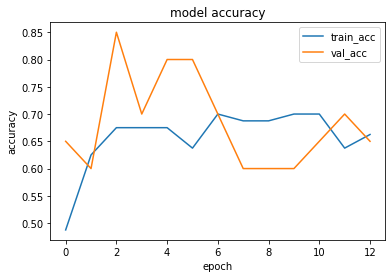

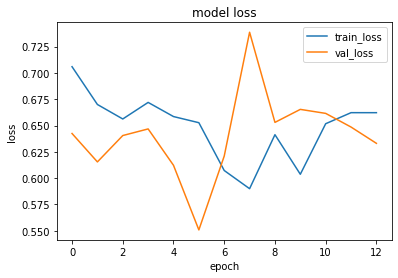

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.49609128]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.555414]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.5230439]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.48393106]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.48146367]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.4811847]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7363 - accuracy: 0.4625 - precision: 0.4717 - recall: 0.6250 - val_loss: 0.6827 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6832 - accuracy: 0.5875 - precision: 0.5745 - recall: 0.6750 - val_loss: 0.6873 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6809 - accuracy: 0.5250 - precision: 1.0000 - recall: 0.0500 - val_loss: 0.7011 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6781 - accuracy: 0.4875 - precision: 0.4000 - recall: 0.0500 - val_loss: 0.6788 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8

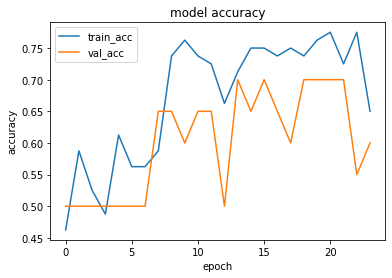

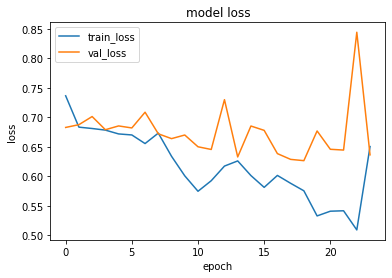

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.5575899]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.55775046]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.6103725]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.43205947]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.3914752]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.36000845]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6989 - accuracy: 0.4625 - precision: 0.4000 - recall: 0.1500 - val_loss: 0.6723 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6696 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6456 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6203 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6078 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6313 - accuracy: 0.6375 - precision: 0.7619 - recall: 0.4000 - val_loss: 0.6436 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75


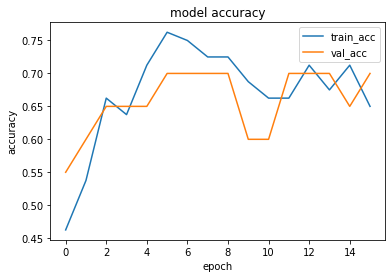

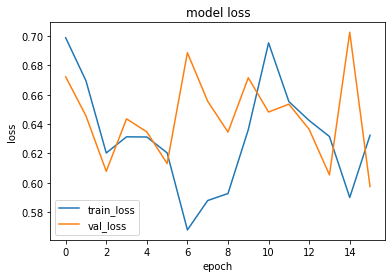

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.3581547]]


1it [00:00, 19599.55it/s]


prediction for video armflapping_3.mov is [[0.43754566]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.4885306]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.31599414]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.31149578]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.30106515]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6814 - accuracy: 0.5375 - precision: 0.5217 - recall: 0.9000 - val_loss: 0.6646 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6706 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6936 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6500 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.8505 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6619 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 1.0056 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


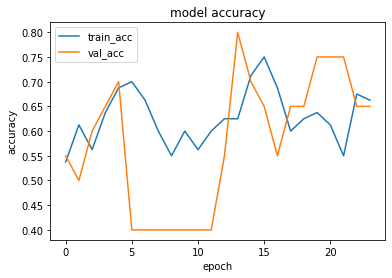

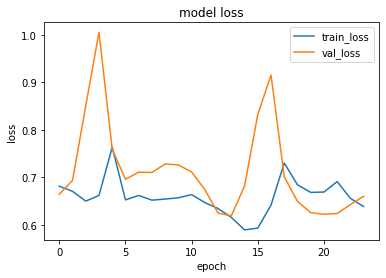

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.46975663]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.52266186]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.5044761]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.44507384]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.43840227]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.43298405]]


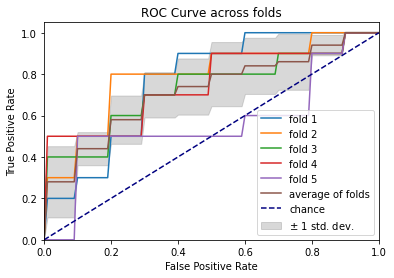

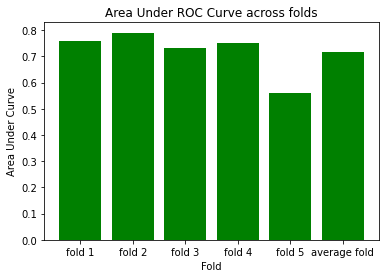

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6825 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.6176 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 192ms/step - loss: 0.8234 - accuracy: 0.6000 - precision: 0.5952 - recall: 0.6250 - val_loss: 0.6029 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6555 - accuracy: 0.6250 - precision: 0.6667 - recall: 0.5000 - val_loss: 0.6539 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6719 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6508 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

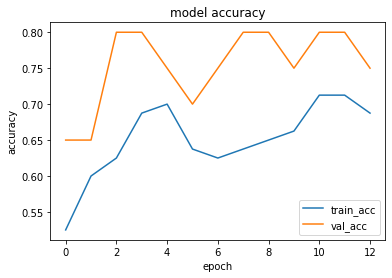

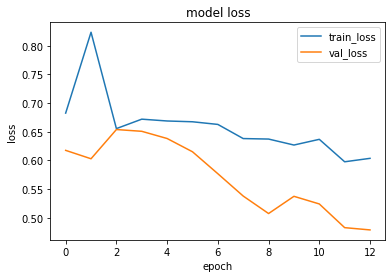

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.2138792]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.6060094]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.4942056]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.17715603]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.16893333]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.17936864]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6880 - accuracy: 0.5125 - precision: 0.5106 - recall: 0.6000 - val_loss: 0.7135 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6589 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.6713 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6695 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6584 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6315 - accuracy: 0.6375 - precision: 0.6667 - recall: 0.5500 - val_loss: 0.6197 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

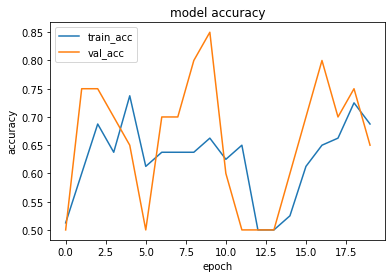

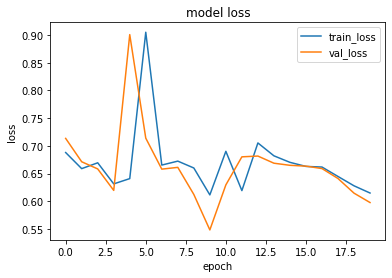

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.56208444]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.6176426]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.6423573]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.5427457]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.5319717]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.51652336]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6855 - accuracy: 0.5250 - precision: 0.5185 - recall: 0.7000 - val_loss: 0.7085 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6621 - accuracy: 0.5875 - precision: 0.7692 - recall: 0.2500 - val_loss: 0.6800 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6292 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.7293 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7280 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 1.4006 - val_accuracy: 0.4500 - val_precision: 0.3333 - val_recall: 0.1000
Epoch 5/75


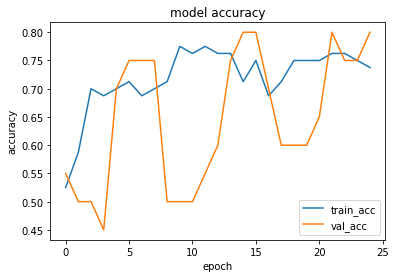

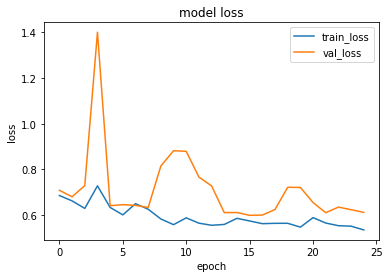

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.5949746]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.6305746]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.6933342]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.27772522]]


1it [00:00, 17189.77it/s]


prediction for video control_2.mov is [[0.27252698]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.28920645]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7009 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6779 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6966 - accuracy: 0.5625 - precision: 0.7778 - recall: 0.1750 - val_loss: 0.6696 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6754 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.6433 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6696 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6356 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75


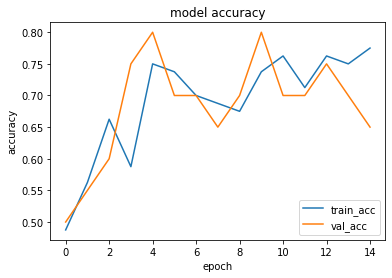

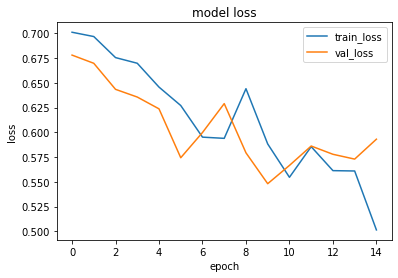

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.25098294]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.6834246]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.77547216]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.19400442]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.18220764]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.19844887]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 135ms/step - loss: 0.6809 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.6644 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6853 - accuracy: 0.5500 - precision: 0.5500 - recall: 0.5500 - val_loss: 0.6593 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6488 - accuracy: 0.6500 - precision: 0.7143 - recall: 0.5000 - val_loss: 0.6804 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6527 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.6918 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.

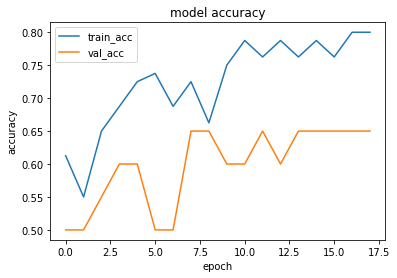

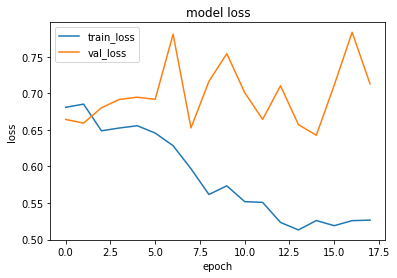

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.19271272]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.44126123]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.49444616]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.16351971]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.15514272]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.15549216]]


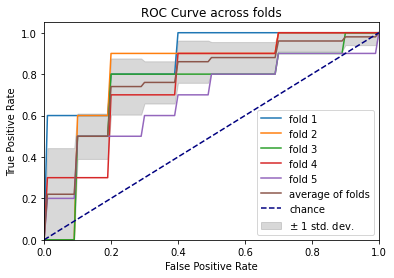

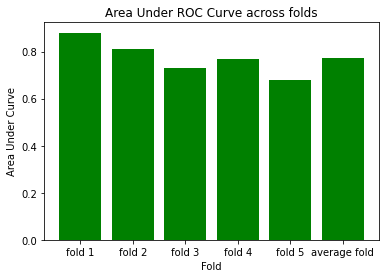

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7007 - accuracy: 0.3625 - precision: 0.3962 - recall: 0.5250 - val_loss: 0.6436 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 183ms/step - loss: 0.6702 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.7079 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7013 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.5885 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6875 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.6611 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

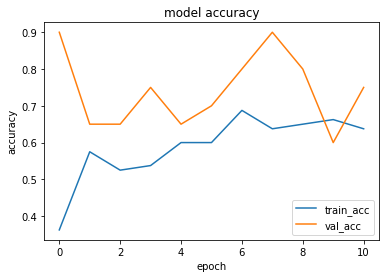

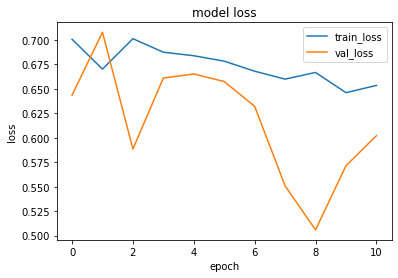

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.49734583]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_3.mov is [[0.5274981]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5038452]]


1it [00:00, 14563.56it/s]


prediction for video control_1.mov is [[0.48581415]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.47905642]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.48100704]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6843 - accuracy: 0.6125 - precision: 0.6667 - recall: 0.4500 - val_loss: 0.7024 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6389 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.7721 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6382 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.7161 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6154 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.7326 - val_accuracy: 0.4500 - val_precision: 0.4000 - val_recall: 0.2000
Epoch 5/75


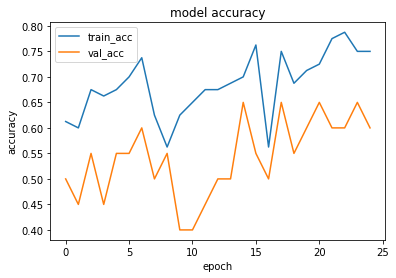

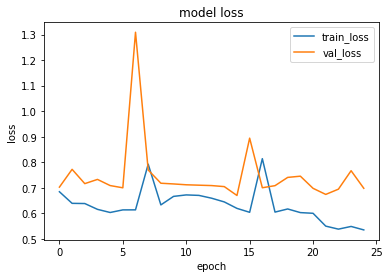

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.48502594]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.58253586]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.6360538]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.3837965]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.35564947]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.3069367]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7119 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6660 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6978 - accuracy: 0.5625 - precision: 0.6000 - recall: 0.3750 - val_loss: 0.6646 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6657 - accuracy: 0.5500 - precision: 0.5323 - recall: 0.8250 - val_loss: 0.6681 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6738 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6483 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75
3

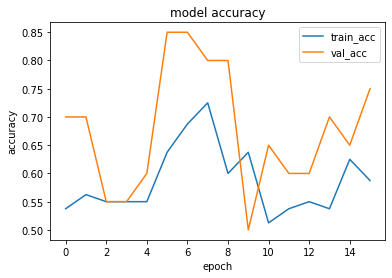

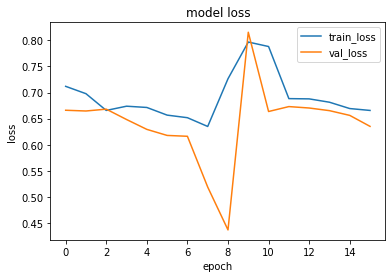

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.5013889]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.507457]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.5142479]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.5052777]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.4994197]]


1it [00:00, 12483.05it/s]


prediction for video control_3.mov is [[0.49883008]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6827 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6402 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6626 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.7072 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6393 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.7004 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.5758 - accuracy: 0.7125 - precision: 0.7931 - recall: 0.5750 - val_loss: 0.8380 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75


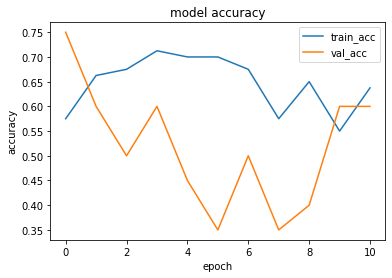

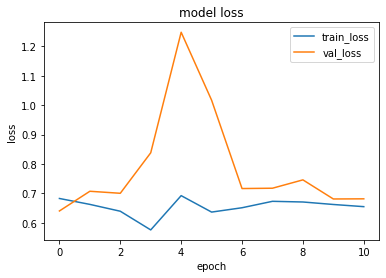

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.49868616]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.6051643]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.56798244]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.4820131]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.4916604]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.48971635]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6930 - accuracy: 0.4750 - precision: 0.4706 - recall: 0.4000 - val_loss: 0.6761 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6575 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.7815 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6353 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7780 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6051 - accuracy: 0.8000 - precision: 0.8158 - recall: 0.7750 - val_loss: 0.7882 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 5/75


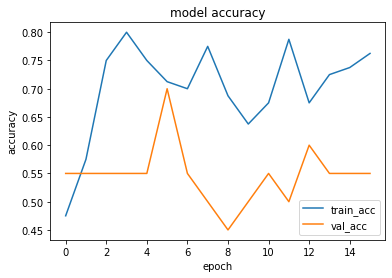

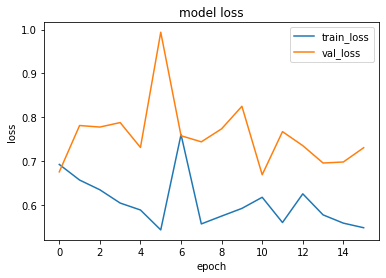

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.49478066]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.58683187]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.6470352]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.3884403]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.36634403]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.36121354]]


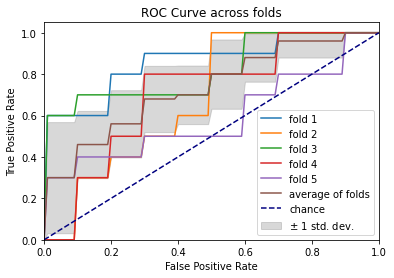

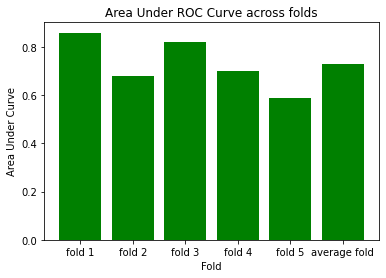

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6833 - accuracy: 0.5500 - precision: 0.5345 - recall: 0.7750 - val_loss: 0.6126 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.7674 - accuracy: 0.5250 - precision: 0.5172 - recall: 0.7500 - val_loss: 0.6183 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6741 - accuracy: 0.6000 - precision: 0.7000 - recall: 0.3500 - val_loss: 0.6258 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6733 - accuracy: 0.5875 - precision: 0.8182 - recall: 0.2250 - val_loss: 0.6236 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 125ms/step 

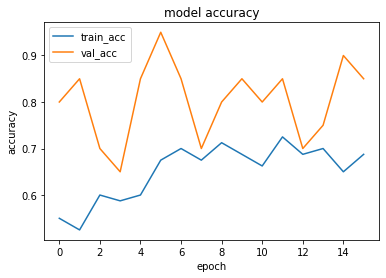

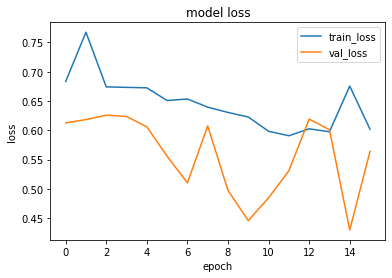

1it [00:00, 12372.58it/s]


prediction for video armflapping_1.mov is [[0.4543532]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5418019]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.5184083]]


1it [00:00, 13189.64it/s]


prediction for video control_1.mov is [[0.42306727]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.41491276]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.40422067]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6969 - accuracy: 0.4250 - precision: 0.4375 - recall: 0.5250 - val_loss: 0.7106 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.7164 - accuracy: 0.5875 - precision: 0.7692 - recall: 0.2500 - val_loss: 0.6987 - val_accuracy: 0.4000 - val_precision: 0.4375 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6725 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6865 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6702 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6830 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


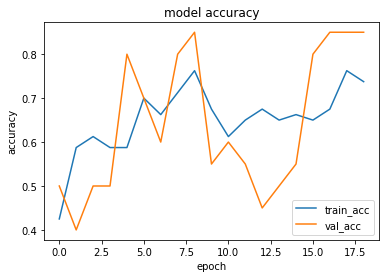

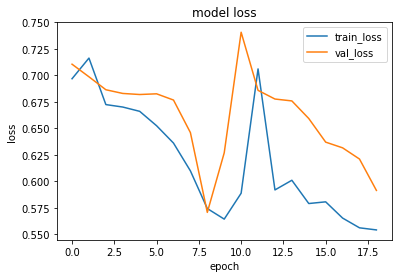

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.4034004]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.529332]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.55015]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.31267434]]


1it [00:00, 12372.58it/s]


prediction for video control_2.mov is [[0.28740138]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.2835763]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 137ms/step - loss: 0.6945 - accuracy: 0.5375 - precision: 0.6000 - recall: 0.2250 - val_loss: 0.6798 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6369 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.7386 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6621 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.6733 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6649 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.6810 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

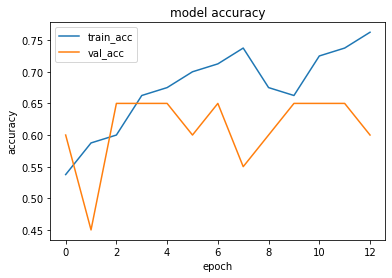

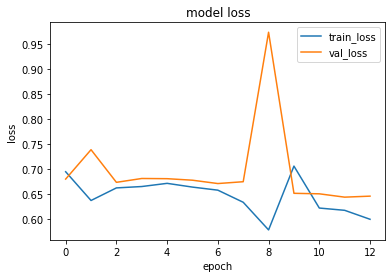

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.5243746]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.5619225]]


1it [00:00, 12336.19it/s]


prediction for video armflapping_2.mov is [[0.5926302]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.4866956]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.47421873]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.46899453]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6984 - accuracy: 0.5875 - precision: 0.5686 - recall: 0.7250 - val_loss: 0.6760 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6636 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.6309 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6656 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.9083 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6326 - accuracy: 0.6625 - precision: 0.6000 - recall: 0.9750 - val_loss: 0.6725 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


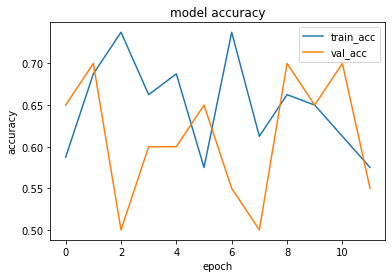

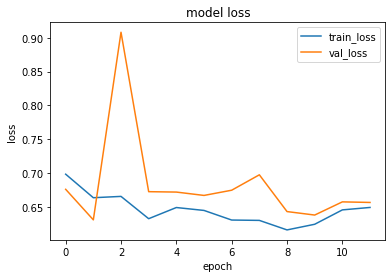

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.50661826]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.53037703]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.5289788]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.50566715]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.4950736]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.50047773]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7011 - accuracy: 0.4250 - precision: 0.4500 - recall: 0.6750 - val_loss: 0.6754 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6670 - accuracy: 0.5250 - precision: 0.5278 - recall: 0.4750 - val_loss: 0.6879 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6827 - accuracy: 0.6500 - precision: 0.8333 - recall: 0.3750 - val_loss: 0.6755 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6136 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6571 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


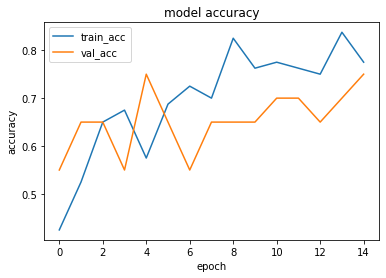

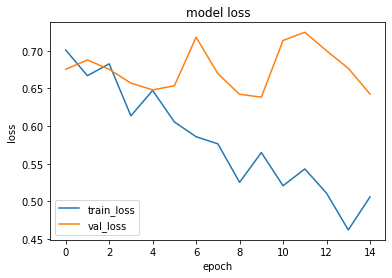

1it [00:00, 11491.24it/s]


prediction for video armflapping_1.mov is [[0.662129]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.6785991]]


1it [00:00, 11781.75it/s]


prediction for video armflapping_2.mov is [[0.69101226]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.5060097]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.42840588]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.35110456]]


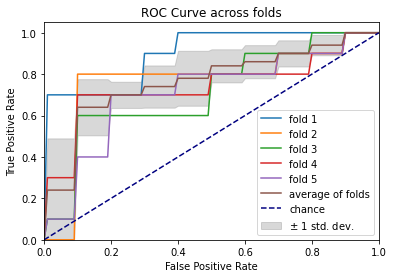

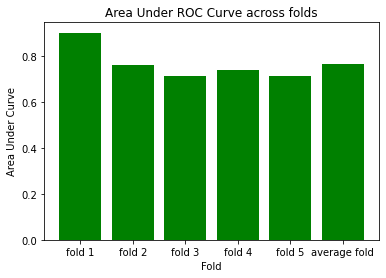

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6996 - accuracy: 0.5250 - precision: 0.5385 - recall: 0.3500 - val_loss: 0.6963 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6919 - accuracy: 0.6125 - precision: 0.8462 - recall: 0.2750 - val_loss: 0.6867 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6697 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6791 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6554 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6785 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

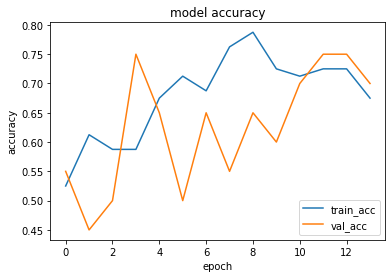

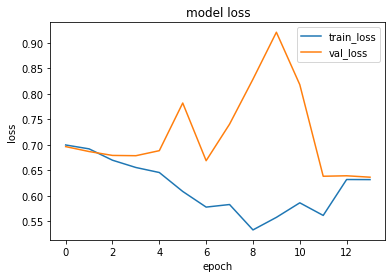

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.45633176]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.48704767]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5125142]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.42077765]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.40667862]]


1it [00:00, 11244.78it/s]


prediction for video control_3.mov is [[0.4016508]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6959 - accuracy: 0.5125 - precision: 0.5091 - recall: 0.7000 - val_loss: 0.6844 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6895 - accuracy: 0.5625 - precision: 0.6667 - recall: 0.2500 - val_loss: 0.6754 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6366 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.8881 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7607 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6647 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75
3

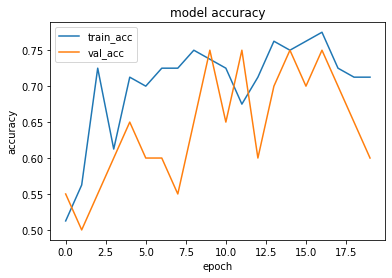

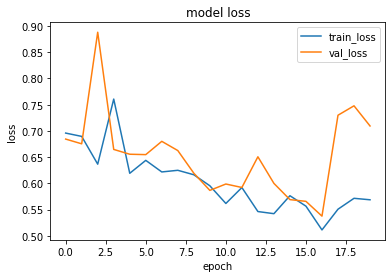

1it [00:00, 12633.45it/s]


prediction for video armflapping_1.mov is [[0.34365147]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.40590212]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.4179694]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.3036735]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.28495193]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.28248888]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7059 - accuracy: 0.4375 - precision: 0.4510 - recall: 0.5750 - val_loss: 0.6737 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6757 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7144 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6499 - accuracy: 0.6375 - precision: 0.6897 - recall: 0.5000 - val_loss: 0.6472 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6590 - accuracy: 0.7000 - precision: 0.6290 - recall: 0.9750 - val_loss: 0.5982 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

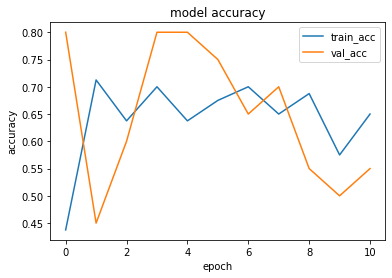

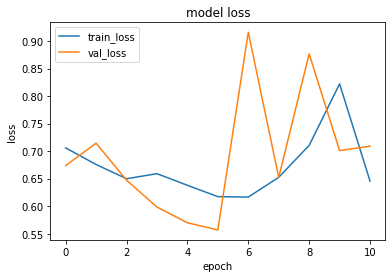

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.4987675]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.49940535]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.49908367]]


1it [00:00, 13662.23it/s]


prediction for video control_1.mov is [[0.49712825]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.49537778]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.49463496]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6859 - accuracy: 0.5375 - precision: 0.5254 - recall: 0.7750 - val_loss: 0.6853 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6712 - accuracy: 0.5750 - precision: 0.5750 - recall: 0.5750 - val_loss: 0.7479 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.7216 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6585 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6724 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6635 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

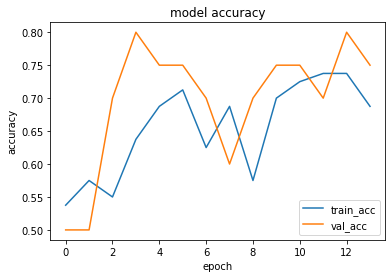

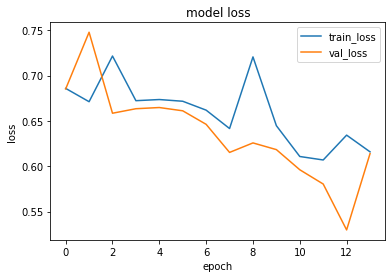

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.2250661]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.63779175]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.24317753]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.21565247]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.21206877]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.2102496]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6986 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6500 - val_loss: 0.6782 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6757 - accuracy: 0.6125 - precision: 0.6552 - recall: 0.4750 - val_loss: 0.6601 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6786 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.5947 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6366 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.6305 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 5/75
3

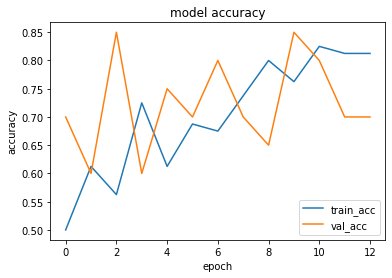

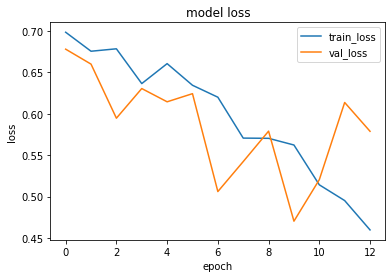

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.47893852]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.8131688]]


1it [00:00, 9915.61it/s]


prediction for video armflapping_2.mov is [[0.85465705]]


1it [00:00, 13662.23it/s]


prediction for video control_1.mov is [[0.29386097]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.26095068]]


1it [00:00, 13443.28it/s]


prediction for video control_3.mov is [[0.24440795]]


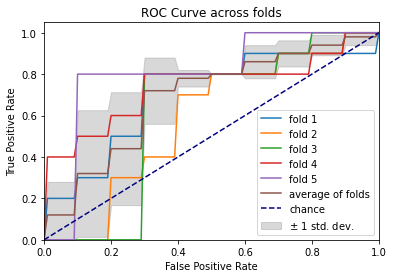

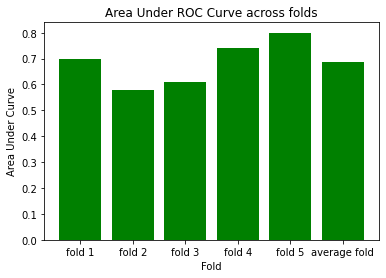

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7051 - accuracy: 0.4375 - precision: 0.4590 - recall: 0.7000 - val_loss: 0.6432 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6698 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.6424 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6868 - accuracy: 0.5500 - precision: 1.0000 - recall: 0.1000 - val_loss: 0.6388 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6721 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.6355 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 126ms/step 

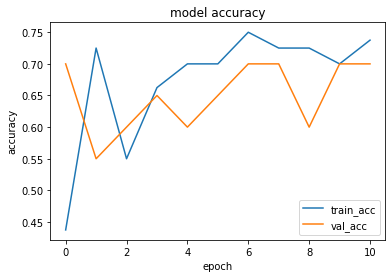

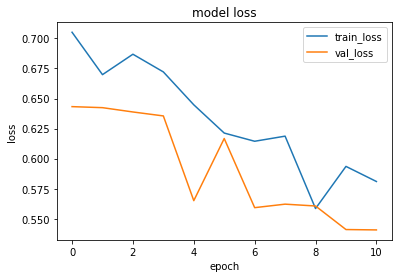

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.5136651]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.53609544]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5659609]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.46056363]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.43340403]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.42921215]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6834 - accuracy: 0.6500 - precision: 0.5938 - recall: 0.9500 - val_loss: 0.8012 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6810 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.0750 - val_loss: 0.6939 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6664 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6734 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6319 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.9933 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epo

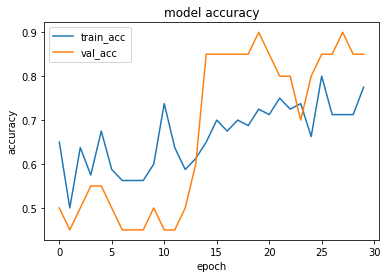

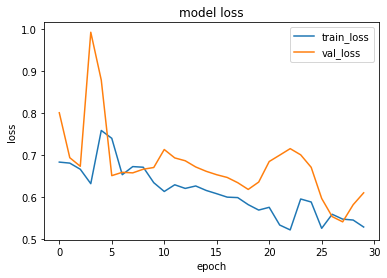

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.5194063]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5844785]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5842755]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.46311396]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.4310639]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.42145723]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6943 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.6587 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6512 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.7036 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6477 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 1.1167 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 1.0334 - accuracy: 0.4875 - precision: 0.3333 - recall: 0.0250 - val_loss: 0.6860 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000

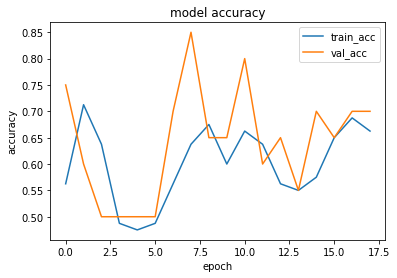

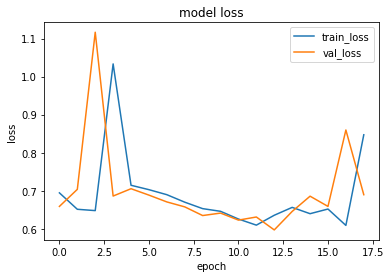

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.16471893]]


1it [00:00, 19599.55it/s]


prediction for video armflapping_3.mov is [[0.15809843]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.16853958]]


1it [00:00, 14027.77it/s]


prediction for video control_1.mov is [[0.16432074]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.16446114]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.16444597]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7170 - accuracy: 0.5125 - precision: 0.5714 - recall: 0.1000 - val_loss: 0.6803 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 185ms/step - loss: 0.6697 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6915 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6583 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.6761 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6434 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.7270 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75


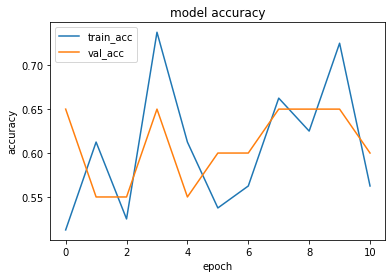

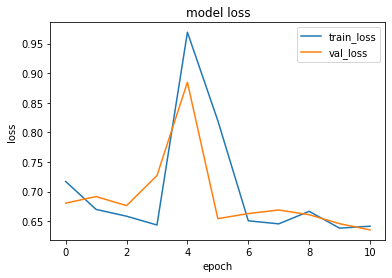

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.5594597]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.570446]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.5704218]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.54361784]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.5325265]]


1it [00:00, 16194.22it/s]


prediction for video control_3.mov is [[0.53385246]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7190 - accuracy: 0.5125 - precision: 0.5455 - recall: 0.1500 - val_loss: 0.6848 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6721 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.7342 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6691 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.6813 - val_accuracy: 0.4500 - val_precision: 0.4000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6648 - accuracy: 0.6375 - precision: 0.7619 - recall: 0.4000 - val_loss: 0.6767 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 5/75


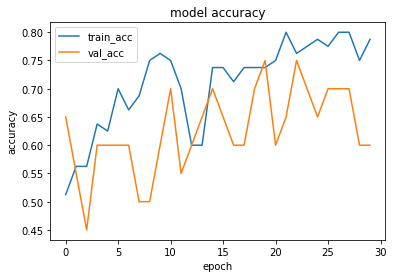

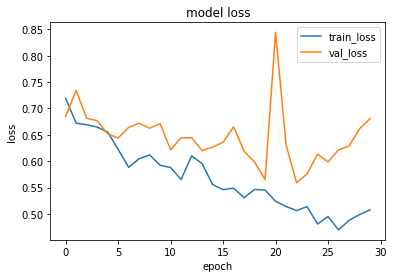

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.42026237]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.593259]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5262346]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.35660756]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.3332938]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.3223595]]


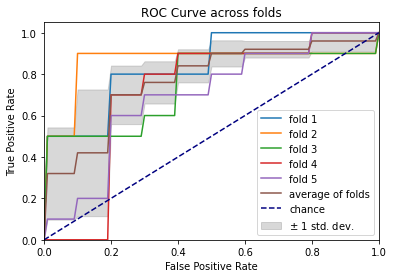

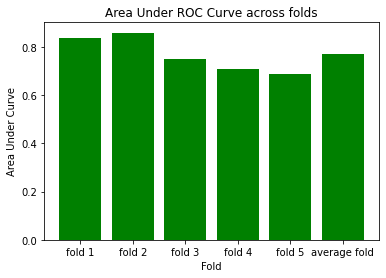

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7310 - accuracy: 0.4750 - precision: 0.3750 - recall: 0.0750 - val_loss: 0.7000 - val_accuracy: 0.2500 - val_precision: 0.2727 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6923 - accuracy: 0.4000 - precision: 0.4200 - recall: 0.5250 - val_loss: 0.6828 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6867 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.6720 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6671 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.7466 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

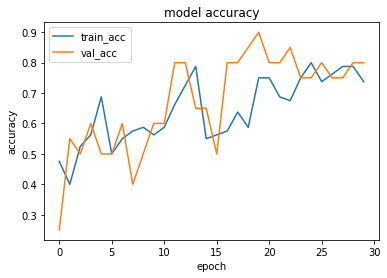

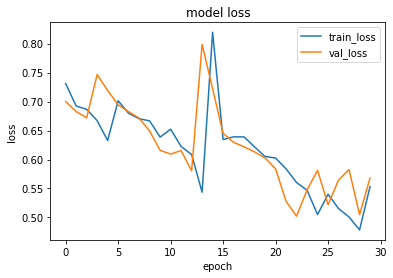

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.38237813]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.5256322]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.4979129]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.34344473]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.32547063]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.3238297]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7020 - accuracy: 0.4250 - precision: 0.4531 - recall: 0.7250 - val_loss: 0.6845 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6399 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.6857 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6745 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6642 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 181ms/step - loss: 0.6303 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.9542 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

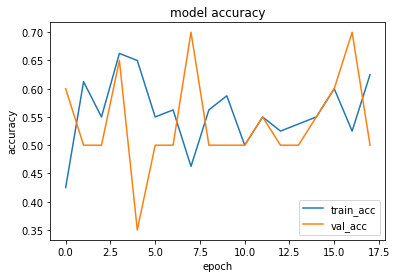

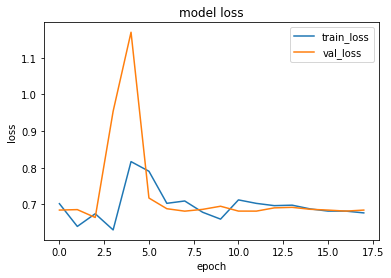

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.52663076]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.58334446]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_2.mov is [[0.55194026]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.52927023]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.52922684]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.5281522]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7225 - accuracy: 0.3750 - precision: 0.3333 - recall: 0.2500 - val_loss: 0.6814 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6881 - accuracy: 0.6125 - precision: 0.6098 - recall: 0.6250 - val_loss: 0.6621 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6716 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.5671 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6552 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.5993 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 5/75
3

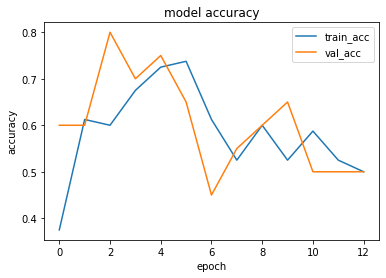

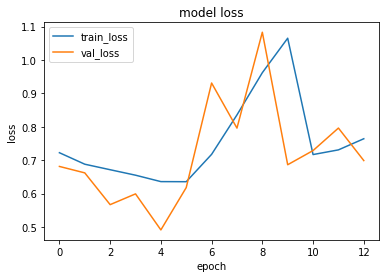

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.40858236]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.42322785]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_2.mov is [[0.41096425]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.4085357]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.40857893]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.4085416]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7052 - accuracy: 0.4750 - precision: 0.4167 - recall: 0.1250 - val_loss: 0.6936 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6732 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6941 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6244 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.7134 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.5666 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.6860 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

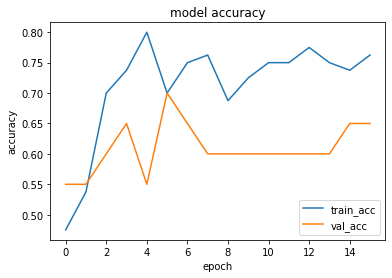

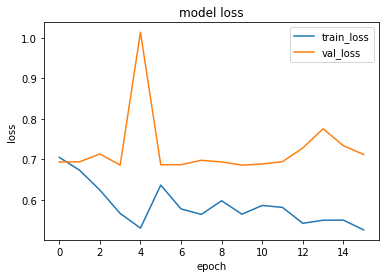

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.36652625]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.38805673]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.4770306]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.3092578]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.2907204]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.27793247]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7215 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6851 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6824 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.6738 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6635 - accuracy: 0.6000 - precision: 0.8333 - recall: 0.2500 - val_loss: 0.6430 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7177 - accuracy: 0.6125 - precision: 0.5818 - recall: 0.8000 - val_loss: 0.6673 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75


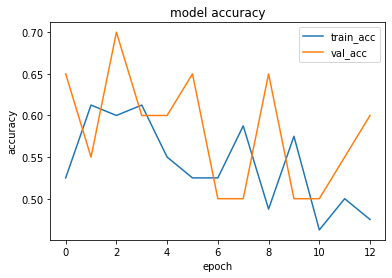

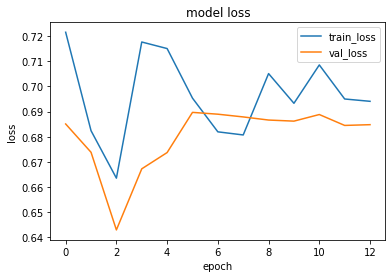

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4643952]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_3.mov is [[0.4820502]]


1it [00:00, 11618.57it/s]


prediction for video armflapping_2.mov is [[0.46843138]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.46414575]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.46410537]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.4641031]]


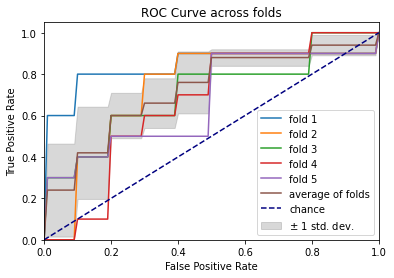

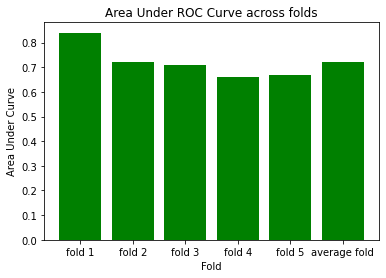

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6864 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6738 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6312 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.7387 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.5912 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6837 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6476 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6808 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

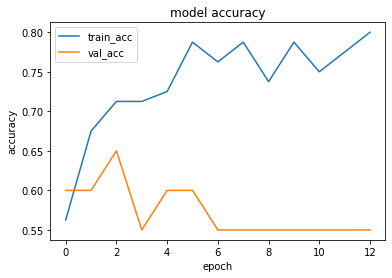

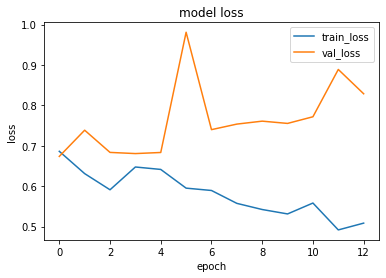

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.377369]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.4469536]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.6591402]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.34876287]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.31464446]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.3245515]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6919 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6753 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6667 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6416 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.7280 - accuracy: 0.6375 - precision: 0.6897 - recall: 0.5000 - val_loss: 0.6698 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6465 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.7115 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75
3

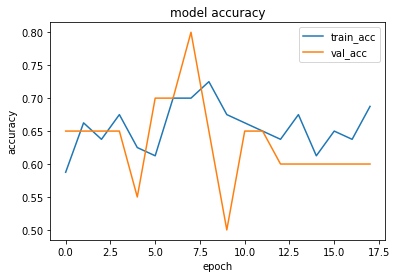

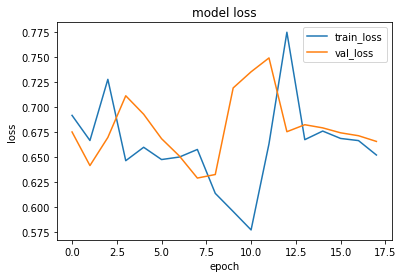

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.48707828]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.5259123]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.51991045]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.46753418]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.46148044]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.4601766]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6949 - accuracy: 0.5375 - precision: 0.5405 - recall: 0.5000 - val_loss: 0.6936 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 180ms/step - loss: 0.6635 - accuracy: 0.5250 - precision: 0.5185 - recall: 0.7000 - val_loss: 0.6881 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6717 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6629 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6718 - accuracy: 0.5500 - precision: 0.5345 - recall: 0.7750 - val_loss: 0.6697 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 5/75
3

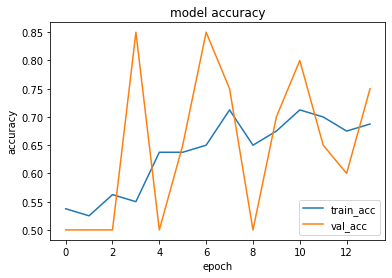

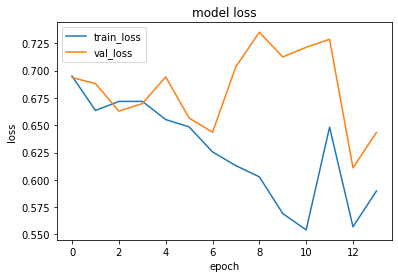

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5386225]]


1it [00:00, 12336.19it/s]


prediction for video armflapping_3.mov is [[0.5981315]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.5999575]]


1it [00:00, 17260.51it/s]


prediction for video control_1.mov is [[0.1639944]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.07982549]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.3299964]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7000 - accuracy: 0.4625 - precision: 0.4444 - recall: 0.3000 - val_loss: 0.6555 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6939 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6285 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6957 - accuracy: 0.5375 - precision: 0.6364 - recall: 0.1750 - val_loss: 0.6427 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6799 - accuracy: 0.5250 - precision: 0.6667 - recall: 0.1000 - val_loss: 0.6108 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoc

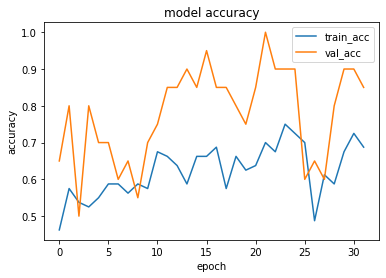

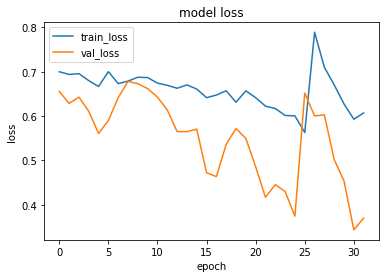

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.3056168]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.46810395]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.68523896]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.2536338]]


1it [00:00, 12671.61it/s]


prediction for video control_2.mov is [[0.24134853]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.25428954]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6892 - accuracy: 0.5875 - precision: 0.6842 - recall: 0.3250 - val_loss: 0.7231 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6656 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.7090 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6487 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.7008 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.5874 - accuracy: 0.8000 - precision: 0.8158 - recall: 0.7750 - val_loss: 0.7834 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


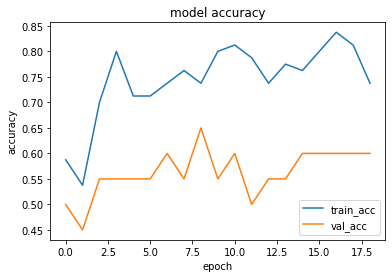

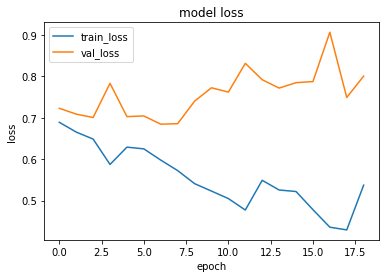

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.29596105]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.5640361]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.5993479]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.18786058]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.16892084]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.17435277]]


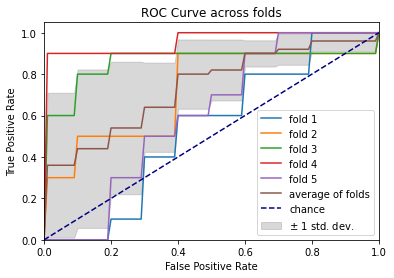

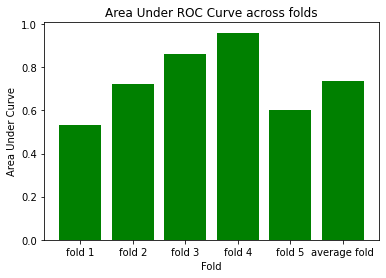

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6816 - accuracy: 0.6625 - precision: 0.6585 - recall: 0.6750 - val_loss: 0.7526 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6296 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.6989 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.5927 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.7266 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.5781 - accuracy: 0.7625 - precision: 0.8387 - recall: 0.6500 - val_loss: 0.6743 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

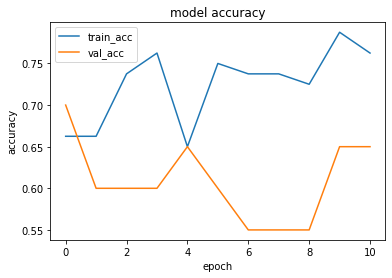

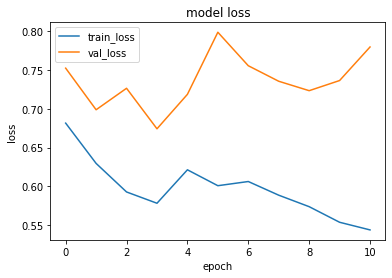

1it [00:00, 15087.42it/s]


prediction for video armflapping_1.mov is [[0.520923]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.63534546]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.66054857]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.3828665]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.32746154]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.35493624]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7115 - accuracy: 0.4500 - precision: 0.4286 - recall: 0.3000 - val_loss: 0.6816 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7029 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6678 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6697 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.6559 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6739 - accuracy: 0.5375 - precision: 1.0000 - recall: 0.0750 - val_loss: 0.6384 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 5/75


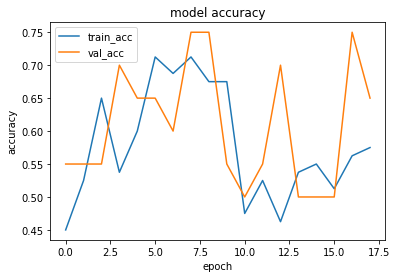

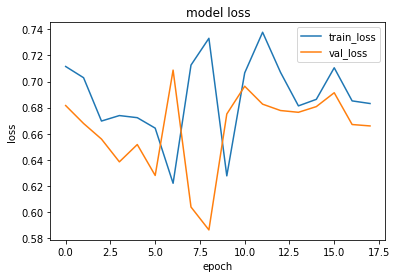

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.44604704]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.43085894]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.45056057]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.44432855]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.44372183]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.44366175]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6993 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8500 - val_loss: 0.6895 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.7368 - accuracy: 0.5000 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6815 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6692 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6758 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6683 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.6681 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.

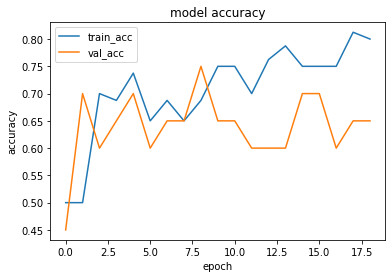

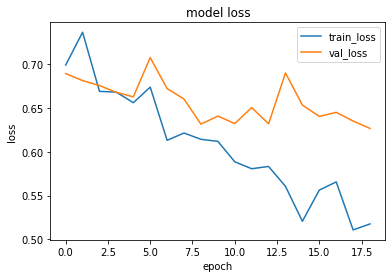

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.5487886]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.6588332]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.70560443]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.25518608]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.22408196]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.23492286]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6807 - accuracy: 0.5625 - precision: 0.5758 - recall: 0.4750 - val_loss: 0.6067 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.7042 - accuracy: 0.5375 - precision: 0.5217 - recall: 0.9000 - val_loss: 0.6311 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6899 - accuracy: 0.5750 - precision: 0.5833 - recall: 0.5250 - val_loss: 0.6713 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 183ms/step - loss: 0.6699 - accuracy: 0.5625 - precision: 0.6667 - recall: 0.2500 - val_loss: 0.6521 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75


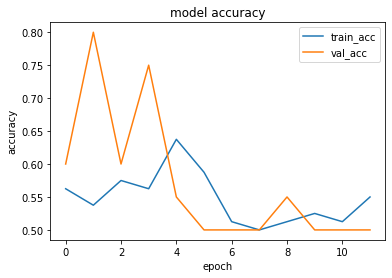

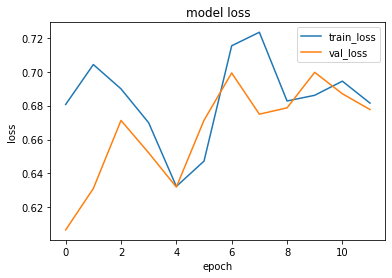

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.45399806]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.46366245]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.4647336]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.45251867]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.4539535]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.45216352]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.7246 - accuracy: 0.4625 - precision: 0.3333 - recall: 0.0750 - val_loss: 0.6805 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6857 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6595 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6811 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6300 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6737 - accuracy: 0.5875 - precision: 0.5854 - recall: 0.6000 - val_loss: 0.5942 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


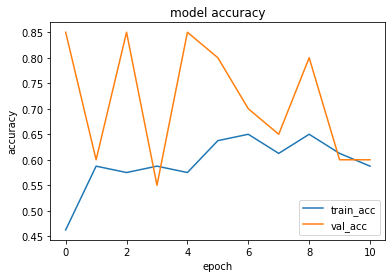

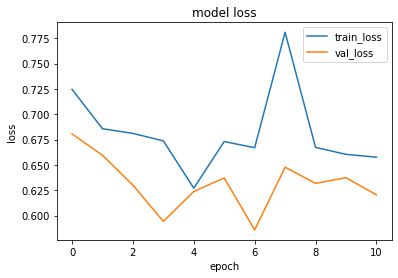

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.536265]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.56560206]]


1it [00:00, 12157.40it/s]


prediction for video armflapping_2.mov is [[0.55938923]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.51848334]]


1it [00:00, 12520.31it/s]


prediction for video control_2.mov is [[0.5129557]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.5080582]]


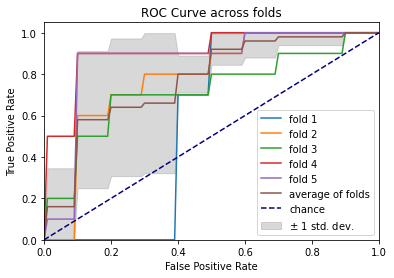

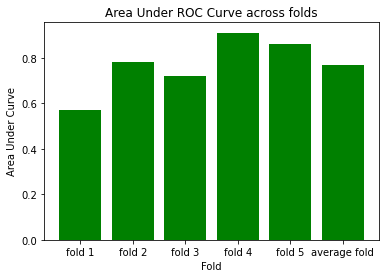

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6877 - accuracy: 0.5750 - precision: 0.6000 - recall: 0.4500 - val_loss: 0.7479 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6467 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.6453 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6715 - accuracy: 0.6750 - precision: 0.8500 - recall: 0.4250 - val_loss: 0.7147 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6412 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.7510 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 116ms/step 

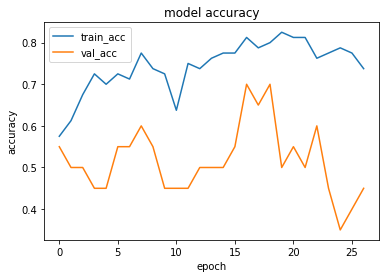

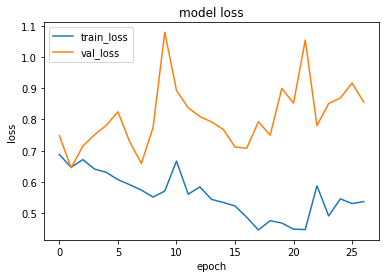

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.40203154]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.6272573]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.51529187]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.19794184]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.18263602]]


1it [00:00, 6034.97it/s]


prediction for video control_3.mov is [[0.19504699]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6877 - accuracy: 0.5125 - precision: 0.5122 - recall: 0.5250 - val_loss: 0.6909 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6741 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.7141 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6335 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6741 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6809 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.7439 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


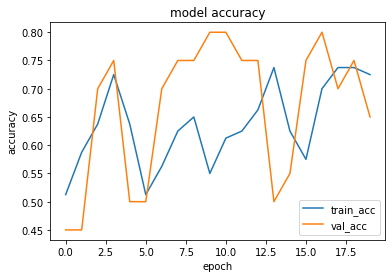

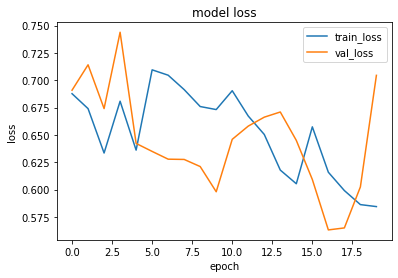

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.6308236]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.67934114]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.7221067]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.54942584]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.52570885]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.47293276]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6999 - accuracy: 0.4500 - precision: 0.3571 - recall: 0.1250 - val_loss: 0.6591 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6870 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6514 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6657 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.6806 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6693 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.1000 - val_loss: 0.6326 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75


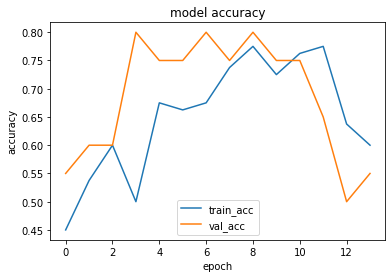

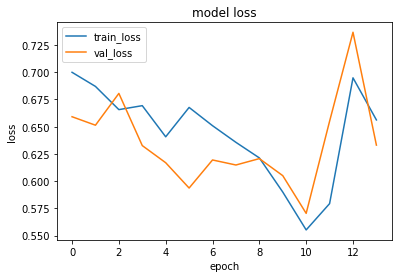

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.3955287]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.42281157]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.455123]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.3693279]]


1it [00:00, 9238.56it/s]


prediction for video control_2.mov is [[0.35664642]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.35373285]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6978 - accuracy: 0.4375 - precision: 0.3333 - recall: 0.1250 - val_loss: 0.7005 - val_accuracy: 0.4000 - val_precision: 0.4286 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6536 - accuracy: 0.6625 - precision: 0.6066 - recall: 0.9250 - val_loss: 1.3131 - val_accuracy: 0.3000 - val_precision: 0.2500 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7253 - accuracy: 0.6125 - precision: 0.6098 - recall: 0.6250 - val_loss: 0.6870 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6434 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6843 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75


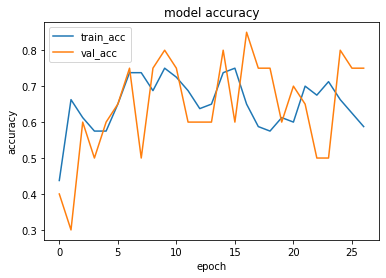

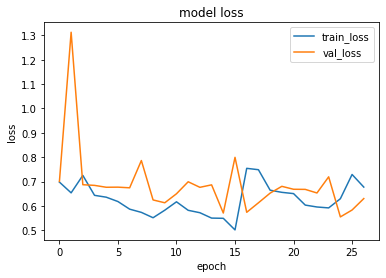

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.44958198]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.46830362]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.4511144]]


1it [00:00, 11214.72it/s]


prediction for video control_1.mov is [[0.42879453]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.40485346]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.41107702]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6887 - accuracy: 0.5375 - precision: 0.5556 - recall: 0.3750 - val_loss: 0.6281 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.8874 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.5988 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6921 - accuracy: 0.6000 - precision: 0.7500 - recall: 0.3000 - val_loss: 0.6574 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6784 - accuracy: 0.6125 - precision: 0.6452 - recall: 0.5000 - val_loss: 0.6690 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


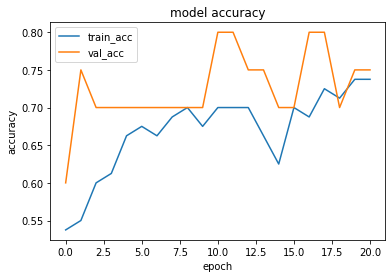

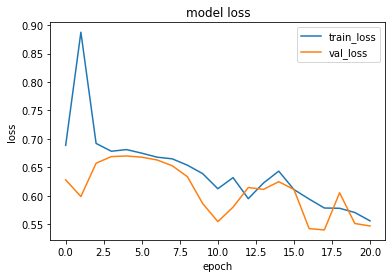

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.47651315]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.5660052]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.64557624]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.4076854]]


1it [00:00, 13842.59it/s]


prediction for video control_2.mov is [[0.3731349]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.36616045]]


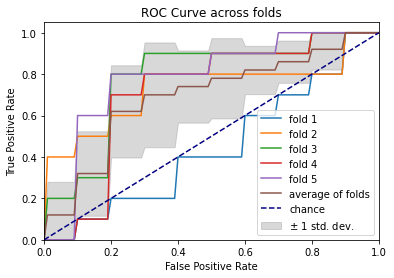

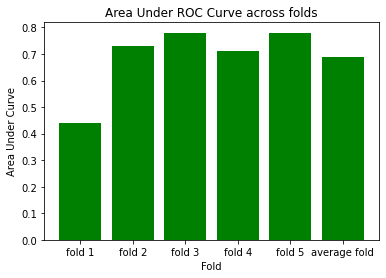

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6834 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.7336 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.7034 - accuracy: 0.5125 - precision: 0.5172 - recall: 0.3750 - val_loss: 0.6770 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6659 - accuracy: 0.5250 - precision: 0.7500 - recall: 0.0750 - val_loss: 0.6684 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6605 - accuracy: 0.6625 - precision: 0.8824 - recall: 0.3750 - val_loss: 0.6574 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 120ms/step 

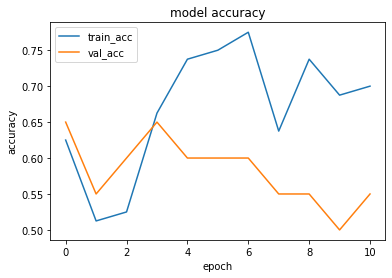

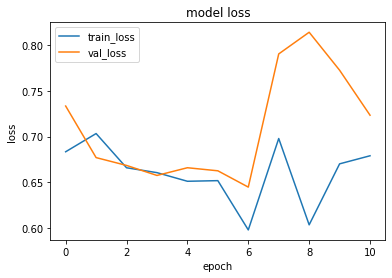

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.5024972]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.55192256]]


1it [00:00, 12520.31it/s]


prediction for video armflapping_2.mov is [[0.5449432]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.47019857]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.45554268]]


1it [00:00, 12633.45it/s]


prediction for video control_3.mov is [[0.4426643]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6874 - accuracy: 0.5250 - precision: 0.5333 - recall: 0.4000 - val_loss: 0.6661 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6793 - accuracy: 0.5375 - precision: 0.5224 - recall: 0.8750 - val_loss: 0.7531 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6890 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6688 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6595 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.6661 - val_accuracy: 0.4000 - val_precision: 0.4375 - val_recall: 0.7000
Epoch 5/75
3

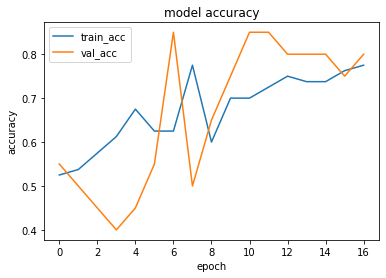

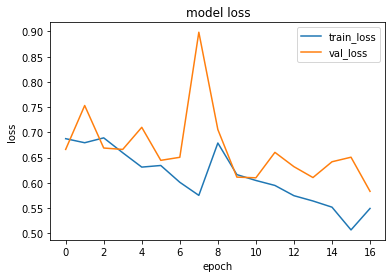

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.44747505]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.57362604]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.553154]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.35724843]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.3300326]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.3181842]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7053 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6981 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6798 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.6645 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6699 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.5788 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6643 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.6722 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

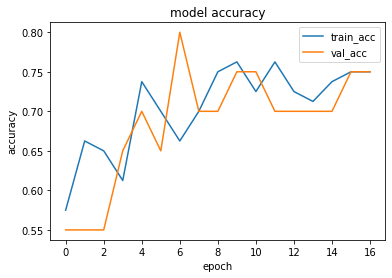

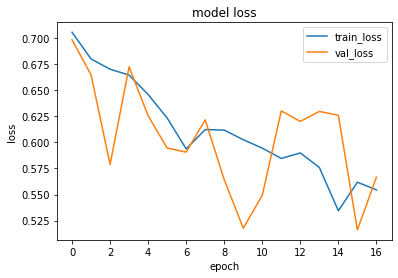

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.46551505]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.6366284]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.5966114]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.39127827]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.365651]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.34404844]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6936 - accuracy: 0.4875 - precision: 0.4865 - recall: 0.4500 - val_loss: 0.6761 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6729 - accuracy: 0.5750 - precision: 0.5625 - recall: 0.6750 - val_loss: 0.6269 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6665 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.6419 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6379 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6515 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


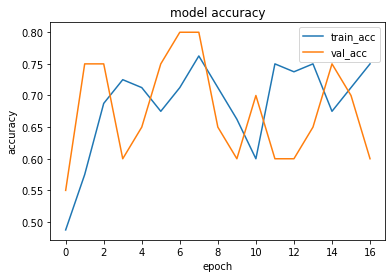

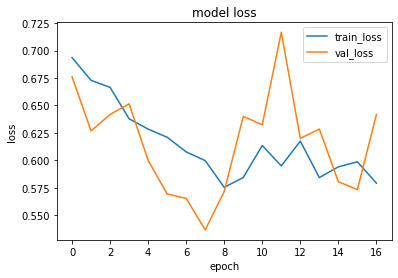

1it [00:00, 11491.24it/s]


prediction for video armflapping_1.mov is [[0.4486899]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.51347387]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.5243546]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.41339073]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.4019767]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.3981812]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6819 - accuracy: 0.5250 - precision: 0.5185 - recall: 0.7000 - val_loss: 0.7468 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7701 - accuracy: 0.5375 - precision: 0.8000 - recall: 0.1000 - val_loss: 0.6729 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6651 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6742 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6619 - accuracy: 0.6500 - precision: 0.6250 - recall: 0.7500 - val_loss: 0.6788 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoc

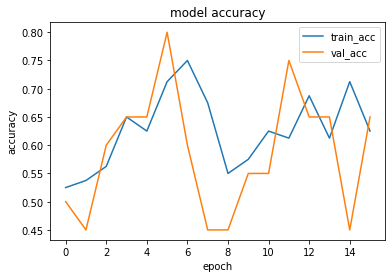

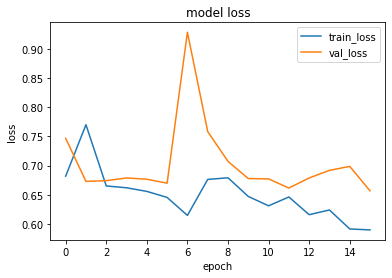

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.57282263]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.6356792]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6339192]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.5413592]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.5300826]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.524123]]


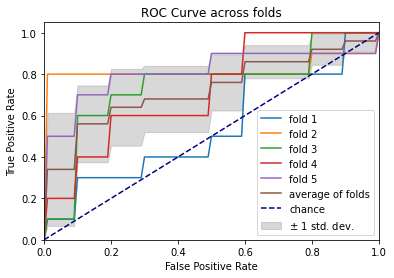

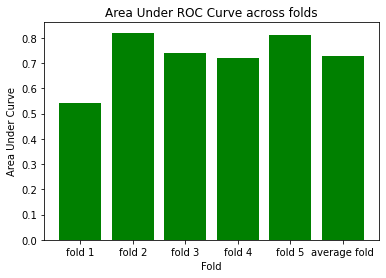

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6832 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3000 - val_loss: 0.6770 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6849 - accuracy: 0.6500 - precision: 0.5938 - recall: 0.9500 - val_loss: 0.6442 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6526 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.6293 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6241 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5895 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

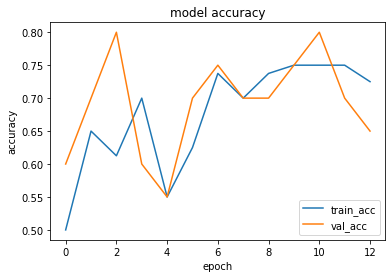

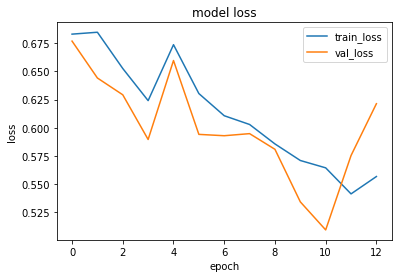

1it [00:00, 17189.77it/s]


prediction for video armflapping_1.mov is [[0.34509087]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.41261917]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.43854266]]


1it [00:00, 16384.00it/s]


prediction for video control_1.mov is [[0.27376083]]


1it [00:00, 14563.56it/s]


prediction for video control_2.mov is [[0.25015873]]


1it [00:00, 13662.23it/s]


prediction for video control_3.mov is [[0.2352837]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 210ms/step - loss: 0.6767 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.8323 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.7199 - accuracy: 0.5375 - precision: 0.5319 - recall: 0.6250 - val_loss: 0.6886 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6673 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6852 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6648 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6831 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

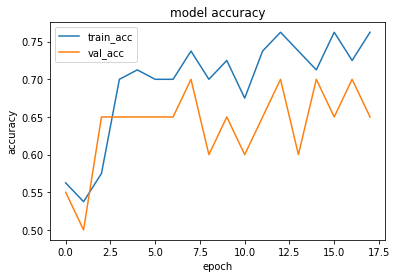

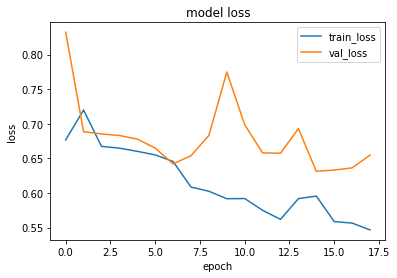

1it [00:00, 11748.75it/s]


prediction for video armflapping_1.mov is [[0.4957018]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_3.mov is [[0.56776536]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.6225854]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.30256993]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.2787764]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.2311531]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6890 - accuracy: 0.5375 - precision: 0.5217 - recall: 0.9000 - val_loss: 0.7212 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.7109 - accuracy: 0.4625 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6777 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6872 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8000 - val_loss: 0.6535 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6544 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6642 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8

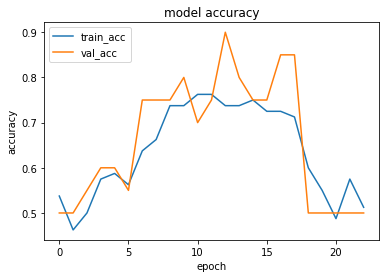

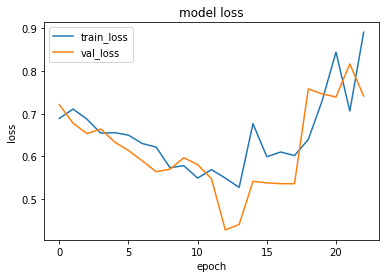

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.31433913]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.35078007]]


1it [00:00, 12228.29it/s]


prediction for video armflapping_2.mov is [[0.31811032]]


1it [00:00, 18808.54it/s]


prediction for video control_1.mov is [[0.31404203]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.31398398]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.31398144]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6862 - accuracy: 0.5750 - precision: 0.6154 - recall: 0.4000 - val_loss: 0.6682 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6841 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.6228 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6153 - accuracy: 0.6000 - precision: 0.5690 - recall: 0.8250 - val_loss: 0.6506 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6318 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.6739 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


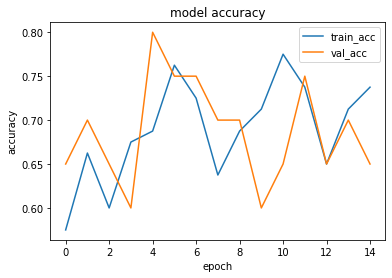

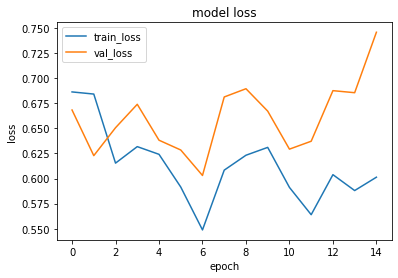

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.47191107]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.55635965]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.5234849]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.42960986]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.41341904]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.40372646]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6851 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6700 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6642 - accuracy: 0.5375 - precision: 0.5714 - recall: 0.3000 - val_loss: 0.7011 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6591 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.6304 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6382 - accuracy: 0.6250 - precision: 0.5735 - recall: 0.9750 - val_loss: 0.6454 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


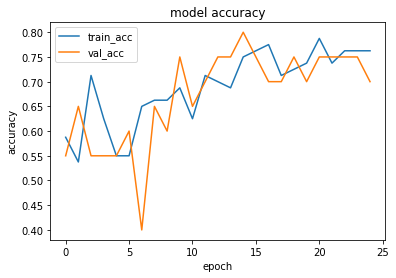

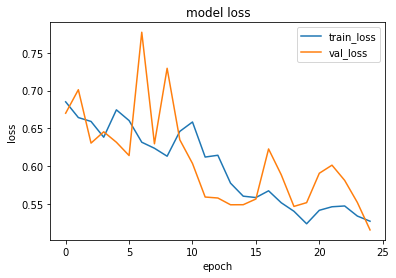

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.34371826]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.6224891]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.7412066]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.22869188]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.19068366]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.18235779]]


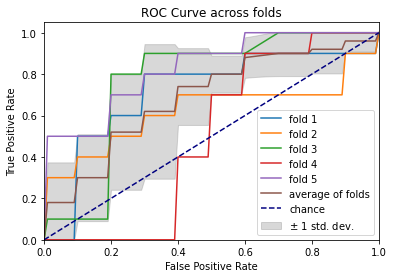

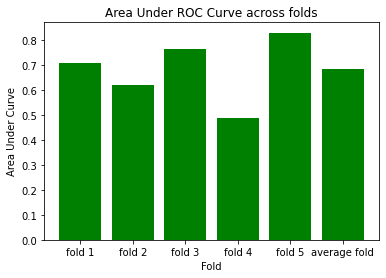

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6868 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6250 - val_loss: 0.6699 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6906 - accuracy: 0.6000 - precision: 0.7500 - recall: 0.3000 - val_loss: 0.6582 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6580 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6570 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6652 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6366 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

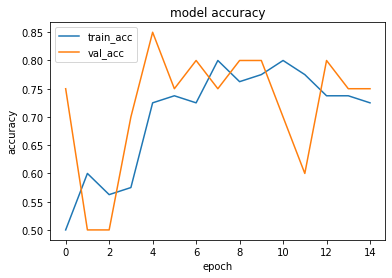

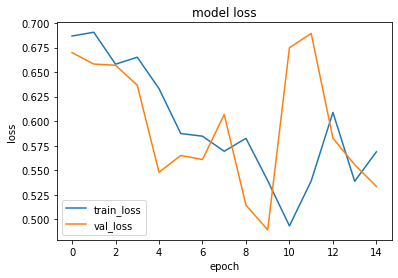

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.3769099]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.40015942]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.47442767]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.32424527]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.29994074]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.2907443]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6860 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5750 - val_loss: 0.6821 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6167 - accuracy: 0.7250 - precision: 0.6667 - recall: 0.9000 - val_loss: 0.7720 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.5842 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.7489 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6581 - accuracy: 0.6625 - precision: 0.7826 - recall: 0.4500 - val_loss: 0.7524 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 5/75
3

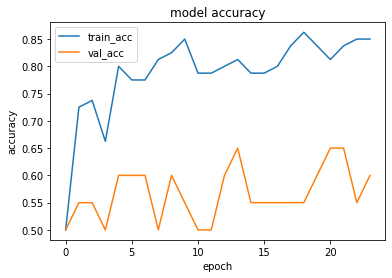

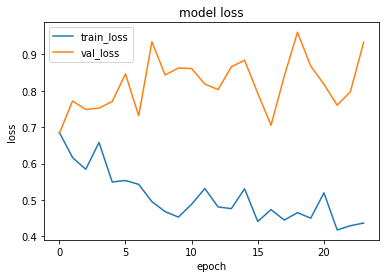

1it [00:00, 12633.45it/s]


prediction for video armflapping_1.mov is [[0.265153]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.49223423]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6948595]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.21630794]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.19862896]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.19586325]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6902 - accuracy: 0.4625 - precision: 0.4762 - recall: 0.7500 - val_loss: 0.6748 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6573 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.6336 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6455 - accuracy: 0.6625 - precision: 0.8095 - recall: 0.4250 - val_loss: 0.6037 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6199 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5934 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75


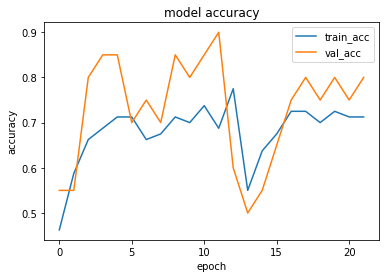

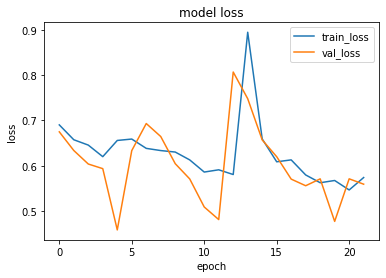

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.46053135]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.58502567]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_2.mov is [[0.5557706]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.45002687]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.42920503]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.43612164]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6929 - accuracy: 0.5375 - precision: 0.5231 - recall: 0.8500 - val_loss: 0.6625 - val_accuracy: 0.4000 - val_precision: 0.3333 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6682 - accuracy: 0.6500 - precision: 0.7500 - recall: 0.4500 - val_loss: 0.6398 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6562 - accuracy: 0.6875 - precision: 0.8571 - recall: 0.4500 - val_loss: 0.6104 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6368 - accuracy: 0.6375 - precision: 0.6410 - recall: 0.6250 - val_loss: 0.5707 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 5/75


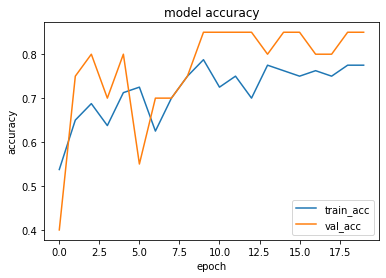

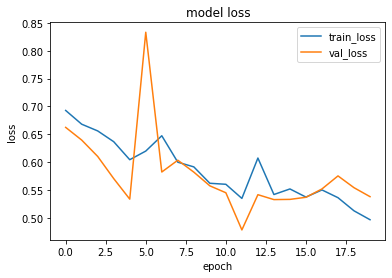

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.36821342]]


1it [00:00, 12520.31it/s]


prediction for video armflapping_3.mov is [[0.5938185]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.6726856]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.2904526]]


1it [00:00, 12710.01it/s]


prediction for video control_2.mov is [[0.26877075]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.25732285]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7118 - accuracy: 0.5125 - precision: 0.5091 - recall: 0.7000 - val_loss: 0.6752 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6719 - accuracy: 0.5500 - precision: 0.7000 - recall: 0.1750 - val_loss: 0.6936 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7027 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.6594 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6742 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6601 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epo

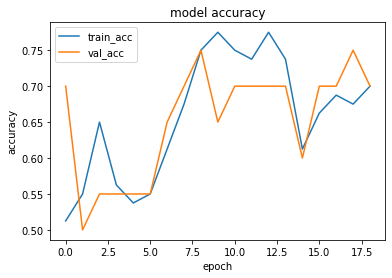

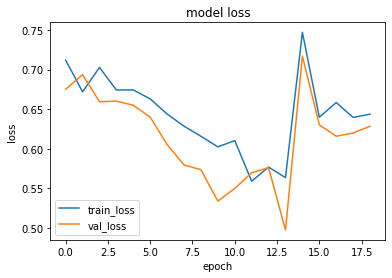

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.3158711]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.519282]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5335859]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.25388235]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.2500007]]


1it [00:00, 11915.64it/s]


prediction for video control_3.mov is [[0.2722633]]


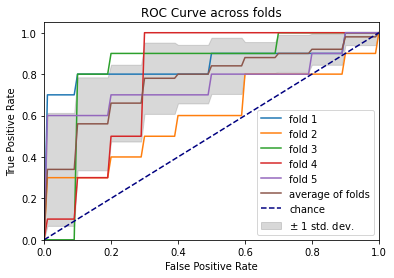

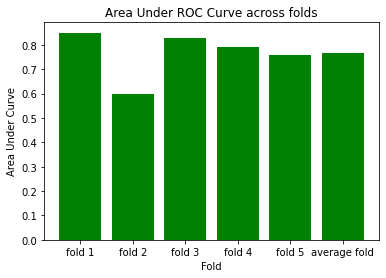

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6969 - accuracy: 0.4375 - precision: 0.4545 - recall: 0.6250 - val_loss: 0.6861 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6705 - accuracy: 0.5875 - precision: 0.7692 - recall: 0.2500 - val_loss: 0.7006 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6002 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.7231 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6608 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.6822 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

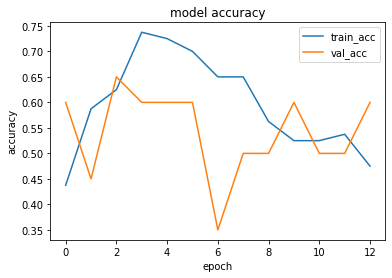

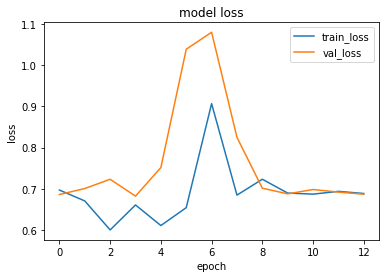

1it [00:00, 11096.04it/s]


prediction for video armflapping_1.mov is [[0.4719484]]


1it [00:00, 8272.79it/s]


prediction for video armflapping_3.mov is [[0.5078957]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.48199016]]


1it [00:00, 13025.79it/s]


prediction for video control_1.mov is [[0.46889523]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.47062972]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.47080335]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6883 - accuracy: 0.5750 - precision: 0.5833 - recall: 0.5250 - val_loss: 0.6208 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6462 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6512 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6611 - accuracy: 0.6000 - precision: 0.5556 - recall: 1.0000 - val_loss: 0.6627 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6599 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.6600 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 5/75


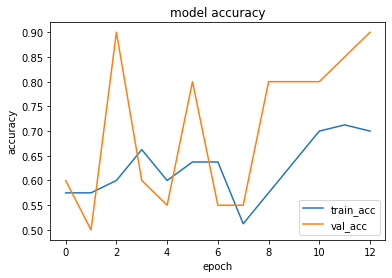

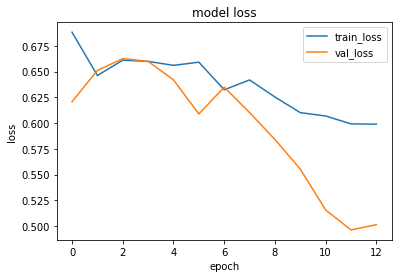

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.23567656]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.42139074]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.34467864]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.20983419]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.20269126]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.20429495]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6968 - accuracy: 0.4250 - precision: 0.4000 - recall: 0.3000 - val_loss: 0.6945 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6667 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.8877 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.5819 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.7108 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6181 - accuracy: 0.7250 - precision: 0.8750 - recall: 0.5250 - val_loss: 0.7035 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


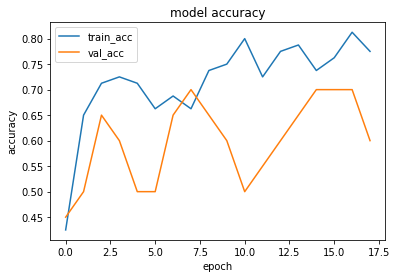

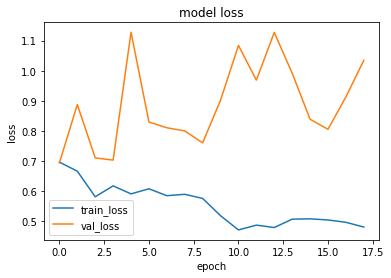

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4102477]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.4825921]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.5533191]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.34567255]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.32397217]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.31601658]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6917 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6556 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6608 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.6204 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.7239 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.5849 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.8991 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.5973 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75


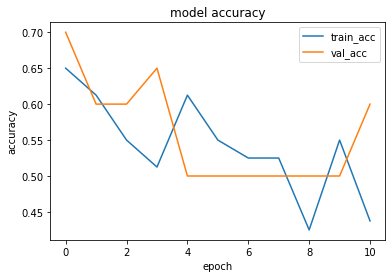

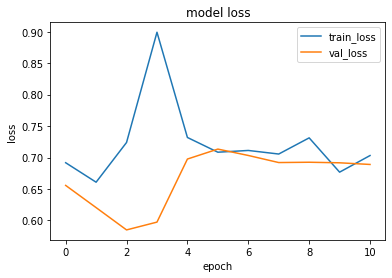

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.48490015]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.46846166]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.48703173]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.48417863]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.48399994]]


1it [00:00, 14027.77it/s]


prediction for video control_3.mov is [[0.48398456]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6983 - accuracy: 0.5250 - precision: 0.6250 - recall: 0.1250 - val_loss: 0.7004 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6792 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.6357 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6559 - accuracy: 0.6500 - precision: 0.7727 - recall: 0.4250 - val_loss: 0.6137 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6249 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.6729 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75


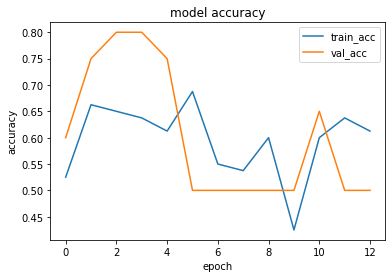

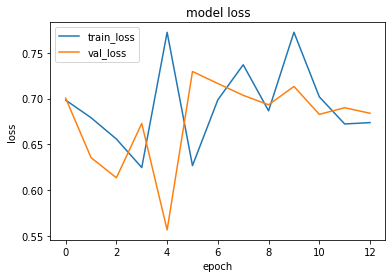

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5247336]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.52653044]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.52544165]]


1it [00:00, 12787.51it/s]


prediction for video control_1.mov is [[0.5245114]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.52444124]]


1it [00:00, 13189.64it/s]


prediction for video control_3.mov is [[0.52443355]]


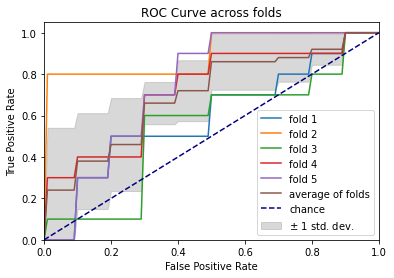

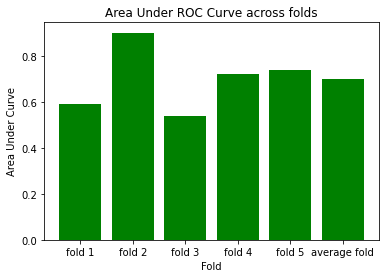

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7015 - accuracy: 0.5750 - precision: 0.5750 - recall: 0.5750 - val_loss: 0.6849 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6774 - accuracy: 0.6500 - precision: 0.6364 - recall: 0.7000 - val_loss: 0.6407 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6557 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.5967 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6646 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.5771 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 132ms/step 

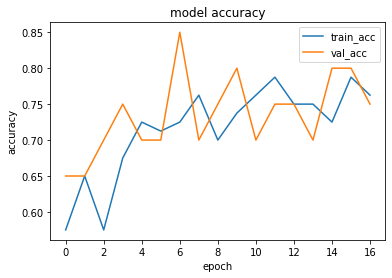

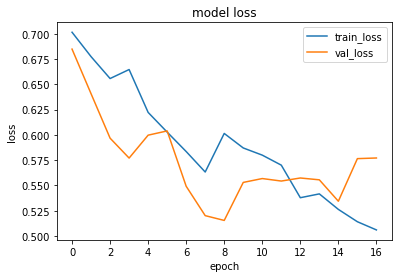

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.49354622]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.5884105]]


1it [00:00, 11244.78it/s]


prediction for video armflapping_2.mov is [[0.60673547]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.3958666]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.35553065]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.33106285]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6844 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6830 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6692 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.8788 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6383 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6887 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 190ms/step - loss: 0.6556 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6893 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75


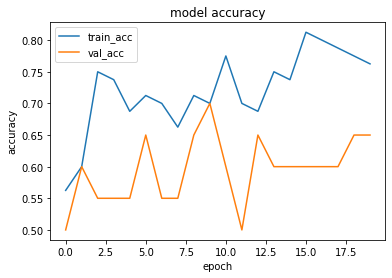

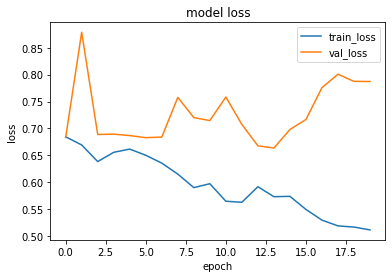

1it [00:00, 15477.14it/s]


prediction for video armflapping_1.mov is [[0.23244295]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.6864869]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.6807923]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.18101814]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.16899693]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.16672811]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 135ms/step - loss: 0.7067 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3250 - val_loss: 0.6675 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6690 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.7743 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.7927 - accuracy: 0.6000 - precision: 0.5625 - recall: 0.9000 - val_loss: 0.6698 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7834 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.6229 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


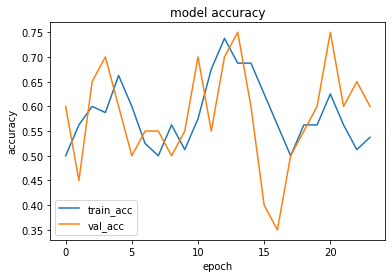

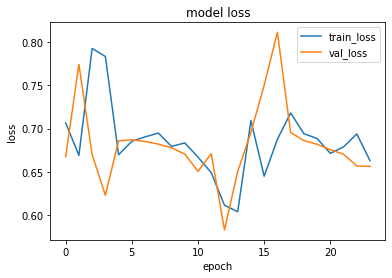

1it [00:00, 12446.01it/s]


prediction for video armflapping_1.mov is [[0.58113253]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.586585]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.5870663]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.5783576]]


1it [00:00, 12787.51it/s]


prediction for video control_2.mov is [[0.5772153]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.57693654]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7052 - accuracy: 0.4625 - precision: 0.4706 - recall: 0.6000 - val_loss: 0.6738 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6831 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.5977 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.7106 - accuracy: 0.5500 - precision: 0.5294 - recall: 0.9000 - val_loss: 0.5914 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6648 - accuracy: 0.6000 - precision: 0.6667 - recall: 0.4000 - val_loss: 0.6085 - val_accuracy: 0.9500 - val_precision: 1.0000 - val_recall: 0.9000
Epoch 5/75


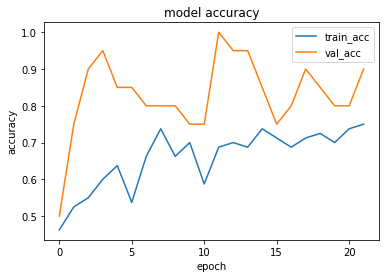

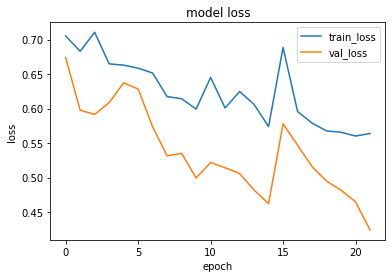

1it [00:00, 14027.77it/s]


prediction for video armflapping_1.mov is [[0.27331084]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.529048]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.42349678]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.2545579]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.24958077]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.24937233]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6994 - accuracy: 0.3625 - precision: 0.3429 - recall: 0.3000 - val_loss: 0.6995 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6829 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6889 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6415 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6927 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6553 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6802 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75


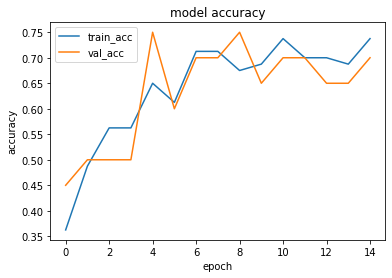

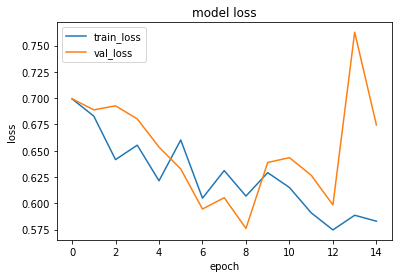

1it [00:00, 12787.51it/s]


prediction for video armflapping_1.mov is [[0.15187705]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_3.mov is [[0.46570793]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.33059752]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.13828728]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.13481209]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.13297835]]


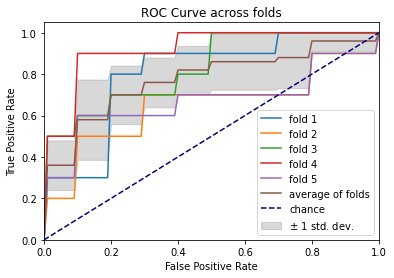

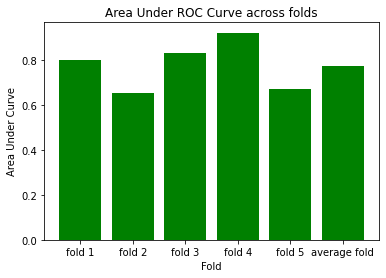

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6914 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.6756 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6465 - accuracy: 0.5375 - precision: 0.5429 - recall: 0.4750 - val_loss: 0.7707 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7495 - accuracy: 0.5875 - precision: 0.5574 - recall: 0.8500 - val_loss: 0.6322 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6407 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6594 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 119ms/step 

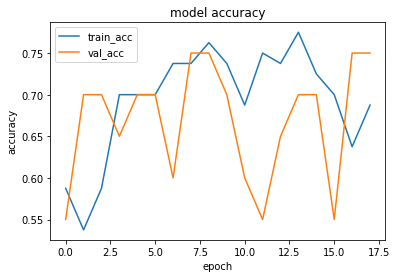

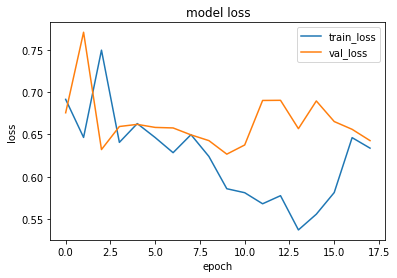

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.5031624]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.5813689]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.57058936]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.46267068]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.45239943]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.44848508]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6802 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.7325 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.8156 - accuracy: 0.5875 - precision: 0.5479 - recall: 1.0000 - val_loss: 0.9082 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.7466 - accuracy: 0.6375 - precision: 0.7619 - recall: 0.4000 - val_loss: 0.7016 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6547 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6947 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


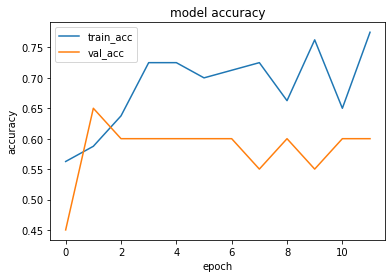

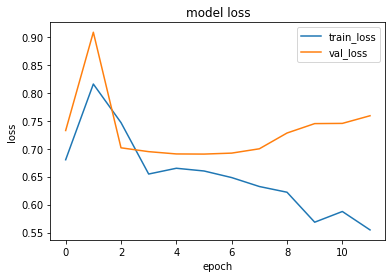

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.4837148]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.47671688]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.54943055]]


1it [00:00, 19239.93it/s]


prediction for video control_1.mov is [[0.43260062]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.40783337]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.38477543]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6809 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.6619 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6649 - accuracy: 0.6000 - precision: 0.6429 - recall: 0.4500 - val_loss: 0.6656 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6429 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.5856 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6866 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.6465 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


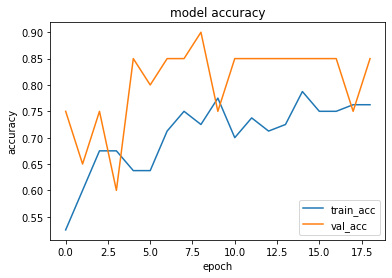

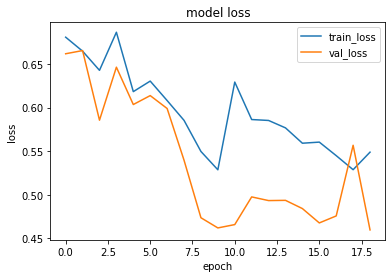

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.39213035]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.6137804]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.63979584]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.305979]]


1it [00:00, 10979.85it/s]


prediction for video control_2.mov is [[0.2849424]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.27651376]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7047 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.2000 - val_loss: 0.6609 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6673 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.8812 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.8319 - accuracy: 0.6125 - precision: 0.5882 - recall: 0.7500 - val_loss: 0.6561 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6702 - accuracy: 0.5750 - precision: 0.7500 - recall: 0.2250 - val_loss: 0.6592 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epo

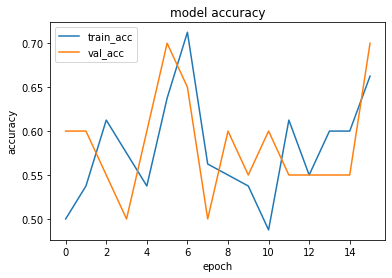

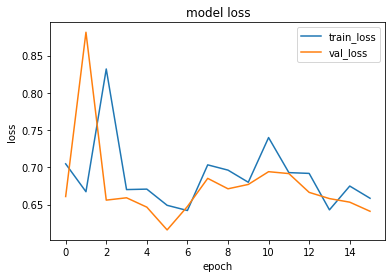

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.4541669]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.4563232]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.4720121]]


1it [00:00, 14027.77it/s]


prediction for video control_1.mov is [[0.44637558]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.44411027]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.44293168]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.7282 - accuracy: 0.4750 - precision: 0.4762 - recall: 0.5000 - val_loss: 0.6788 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6783 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6893 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6745 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6870 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6760 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6813 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


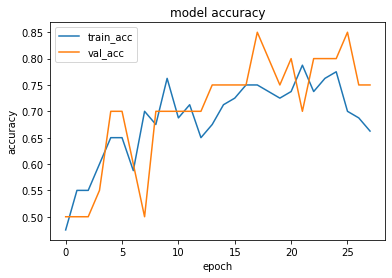

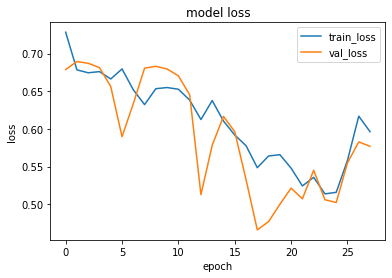

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.46590638]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.52208984]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.48350888]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.43746296]]


1it [00:00, 12985.46it/s]


prediction for video control_2.mov is [[0.42223287]]


1it [00:00, 11650.84it/s]


prediction for video control_3.mov is [[0.42476854]]


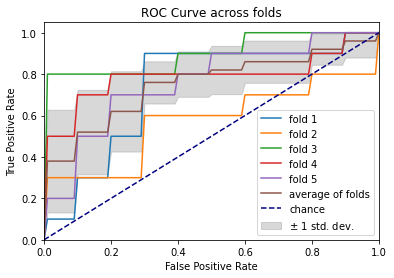

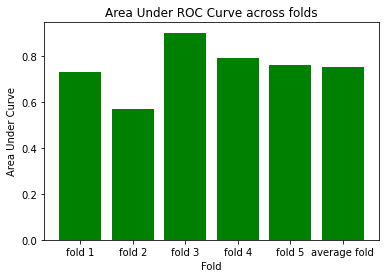

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6817 - accuracy: 0.5375 - precision: 0.5366 - recall: 0.5500 - val_loss: 0.6700 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.9443 - accuracy: 0.4625 - precision: 0.4634 - recall: 0.4750 - val_loss: 0.6581 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6594 - accuracy: 0.6000 - precision: 0.5690 - recall: 0.8250 - val_loss: 0.6606 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6740 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6539 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 136ms/step 

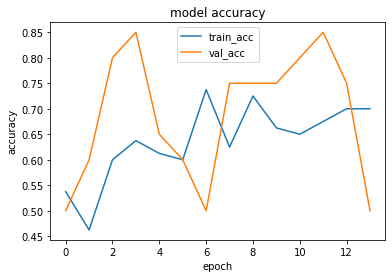

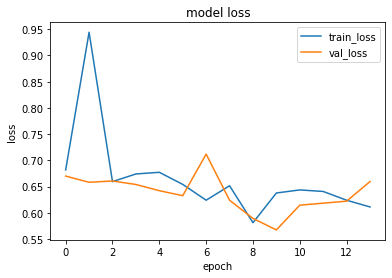

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.5445787]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.59245086]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.61516356]]


1it [00:00, 14563.56it/s]


prediction for video control_1.mov is [[0.51901]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.51179767]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.5014569]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 202ms/step - loss: 0.6982 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7000 - val_loss: 0.6973 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6890 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.2250 - val_loss: 0.7050 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6530 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.7459 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6663 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.7217 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75
3

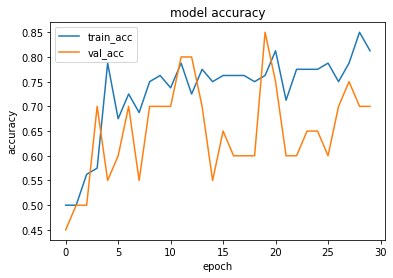

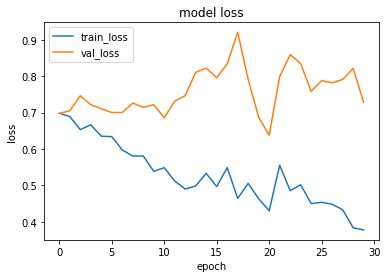

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.304663]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_3.mov is [[0.5406734]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.530383]]


1it [00:00, 3146.51it/s]


prediction for video control_1.mov is [[0.24934456]]


1it [00:00, 13842.59it/s]


prediction for video control_2.mov is [[0.25146052]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.2442058]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6855 - accuracy: 0.4750 - precision: 0.4722 - recall: 0.4250 - val_loss: 0.6256 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.8376 - accuracy: 0.5125 - precision: 0.5068 - recall: 0.9250 - val_loss: 0.6391 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6480 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6548 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6570 - accuracy: 0.5500 - precision: 0.7500 - recall: 0.1500 - val_loss: 0.6675 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoc

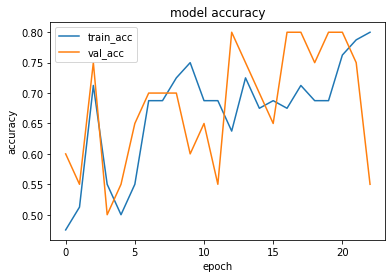

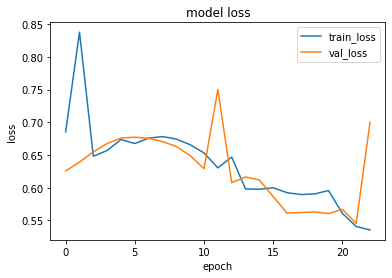

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.6934088]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.728065]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.6046145]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.2523167]]


1it [00:00, 14217.98it/s]


prediction for video control_2.mov is [[0.23404935]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.36434156]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7104 - accuracy: 0.4625 - precision: 0.4516 - recall: 0.3500 - val_loss: 0.6616 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6784 - accuracy: 0.6375 - precision: 0.6897 - recall: 0.5000 - val_loss: 0.6403 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6490 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6389 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6436 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.5855 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


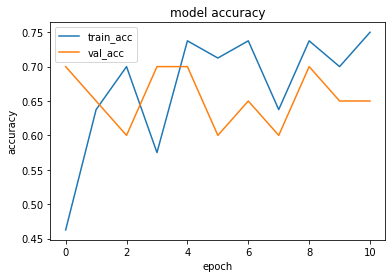

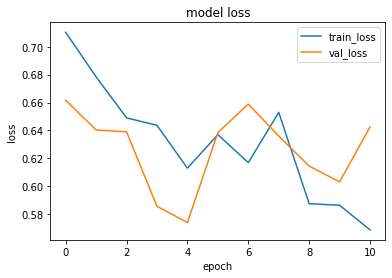

1it [00:00, 12633.45it/s]


prediction for video armflapping_1.mov is [[0.35376263]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5517577]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.58557665]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.2868291]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.27755865]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.26514846]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7075 - accuracy: 0.4625 - precision: 0.4769 - recall: 0.7750 - val_loss: 0.6702 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6777 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.6428 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6656 - accuracy: 0.6250 - precision: 0.9167 - recall: 0.2750 - val_loss: 0.6441 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6681 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6708 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75


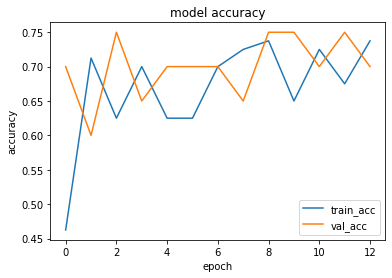

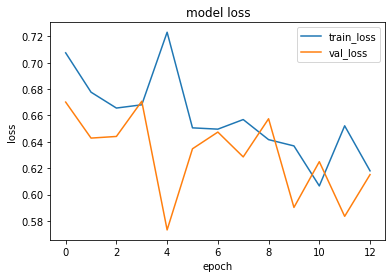

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.48167104]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.50065565]]


1it [00:00, 10205.12it/s]


prediction for video armflapping_2.mov is [[0.52299875]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.45174477]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.4348797]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.43041235]]


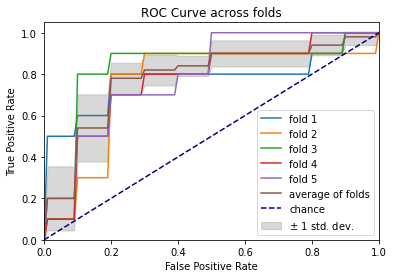

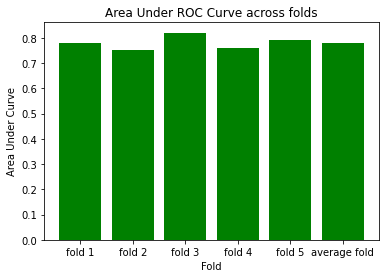

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6973 - accuracy: 0.4750 - precision: 0.4808 - recall: 0.6250 - val_loss: 0.6540 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6888 - accuracy: 0.6000 - precision: 0.6333 - recall: 0.4750 - val_loss: 0.6038 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6436 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.6067 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6438 - accuracy: 0.6125 - precision: 0.7647 - recall: 0.3250 - val_loss: 0.5747 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 120ms/step 

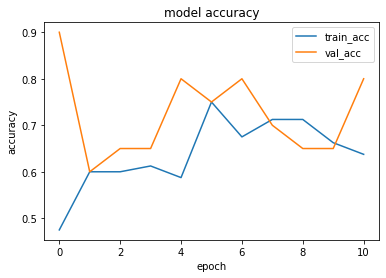

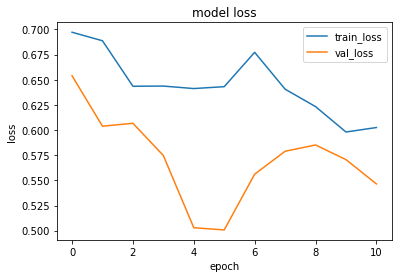

1it [00:00, 11335.96it/s]


prediction for video armflapping_1.mov is [[0.47942472]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.57788825]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.5553299]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.4408034]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.44970852]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.4390972]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6751 - accuracy: 0.5500 - precision: 0.5286 - recall: 0.9250 - val_loss: 0.8173 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6718 - accuracy: 0.4750 - precision: 0.4000 - recall: 0.1000 - val_loss: 0.7086 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6646 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.7054 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 192ms/step - loss: 0.6100 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.7270 - val_accuracy: 0.4500 - val_precision: 0.3333 - val_recall: 0.1000
Epoc

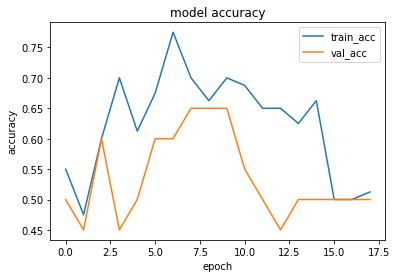

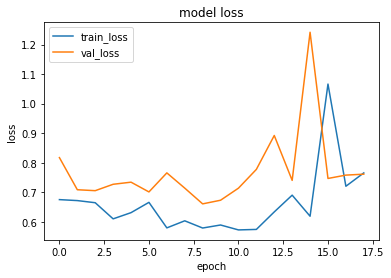

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.6702189]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.64219356]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6716498]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.6701775]]


1it [00:00, 13189.64it/s]


prediction for video control_2.mov is [[0.67035294]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.67041695]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6974 - accuracy: 0.4125 - precision: 0.4386 - recall: 0.6250 - val_loss: 0.6890 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6590 - accuracy: 0.6000 - precision: 0.5952 - recall: 0.6250 - val_loss: 0.8091 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.7471 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6669 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6425 - accuracy: 0.7250 - precision: 0.8462 - recall: 0.5500 - val_loss: 0.6572 - val_accuracy: 0.4500 - val_precision: 0.3333 - val_recall: 0.1000
Epoch 5/75


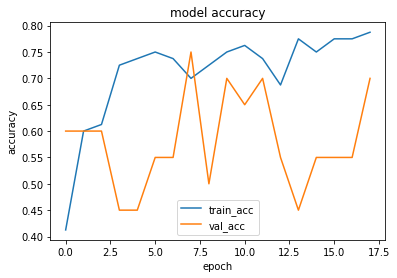

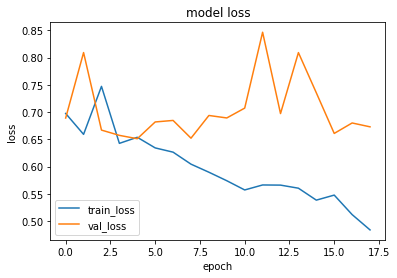

1it [00:00, 12228.29it/s]


prediction for video armflapping_1.mov is [[0.49714327]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.66647553]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.6913502]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.37653264]]


1it [00:00, 16578.28it/s]


prediction for video control_2.mov is [[0.3430307]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.3346048]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6886 - accuracy: 0.5375 - precision: 0.5273 - recall: 0.7250 - val_loss: 0.7270 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6669 - accuracy: 0.5625 - precision: 0.5581 - recall: 0.6000 - val_loss: 0.6766 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6511 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6795 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6629 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6936 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75
3

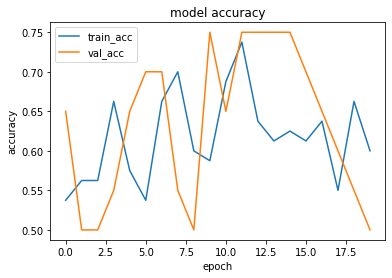

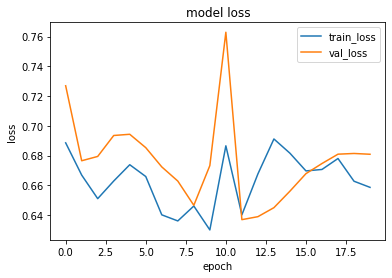

1it [00:00, 11335.96it/s]


prediction for video armflapping_1.mov is [[0.4687042]]


1it [00:00, 12052.60it/s]


prediction for video armflapping_3.mov is [[0.527791]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.5167127]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.46203983]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.465104]]


1it [00:00, 13315.25it/s]


prediction for video control_3.mov is [[0.46227926]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7011 - accuracy: 0.5125 - precision: 0.5122 - recall: 0.5250 - val_loss: 0.6481 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6568 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.5844 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6578 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6924 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6729 - accuracy: 0.6375 - precision: 0.6279 - recall: 0.6750 - val_loss: 0.6842 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75


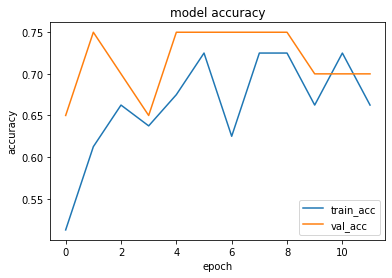

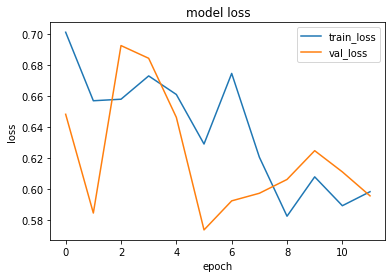

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.4116217]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.44971722]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5037802]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.34890118]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.32778645]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.3132778]]


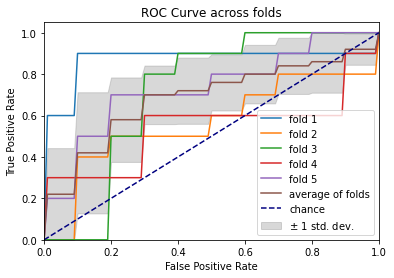

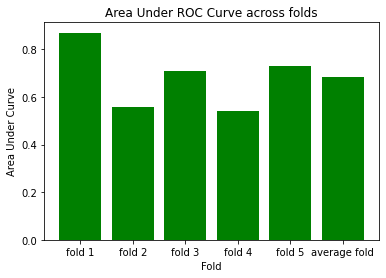

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 216ms/step - loss: 0.7055 - accuracy: 0.4875 - precision: 0.4848 - recall: 0.4000 - val_loss: 0.6551 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6739 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6110 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6787 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.6122 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6548 - accuracy: 0.6500 - precision: 0.8333 - recall: 0.3750 - val_loss: 0.6032 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 125ms/step 

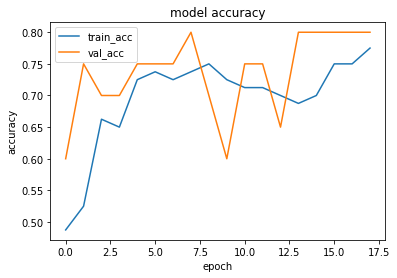

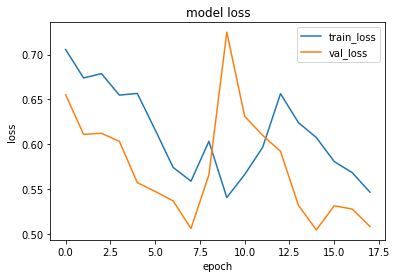

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.46237022]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.6935575]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_2.mov is [[0.6941196]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.34093234]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.31191945]]


1it [00:00, 11915.64it/s]


prediction for video control_3.mov is [[0.30818143]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6924 - accuracy: 0.4875 - precision: 0.4884 - recall: 0.5250 - val_loss: 0.6781 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6493 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 1.0504 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.7246 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.6859 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6614 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.6903 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


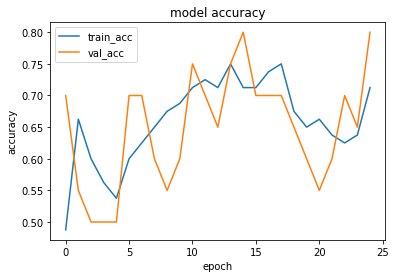

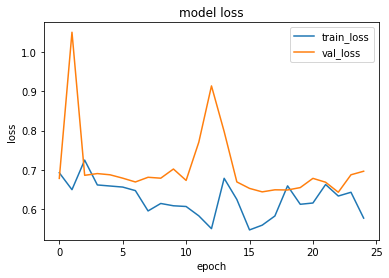

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5009912]]


1it [00:00, 12787.51it/s]


prediction for video armflapping_3.mov is [[0.5767054]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.56415755]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.4650812]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.45260313]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.44563943]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6996 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3500 - val_loss: 0.6773 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6530 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.7204 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.8099 - accuracy: 0.5875 - precision: 0.5714 - recall: 0.7000 - val_loss: 0.6802 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7093 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.6656 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


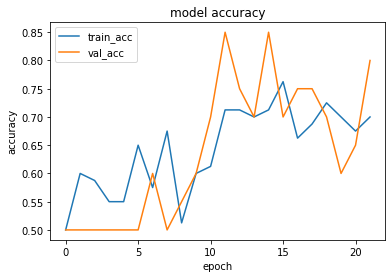

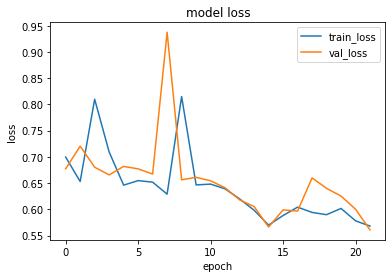

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.51176107]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.5976317]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.59784085]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.27736962]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.22602656]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.3098277]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.7079 - accuracy: 0.4125 - precision: 0.4507 - recall: 0.8000 - val_loss: 0.6774 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6761 - accuracy: 0.5625 - precision: 0.8571 - recall: 0.1500 - val_loss: 0.6954 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6454 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6482 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.7206 - accuracy: 0.6000 - precision: 0.5625 - recall: 0.9000 - val_loss: 0.9051 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3

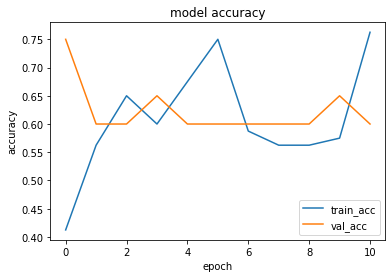

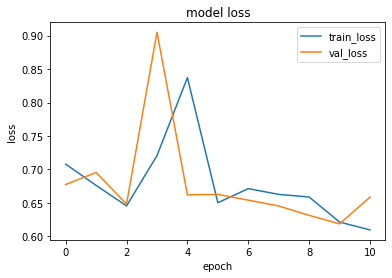

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.53248274]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.59409165]]


1it [00:00, 12865.96it/s]


prediction for video armflapping_2.mov is [[0.6503781]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.46943372]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.47230297]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.39286882]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7228 - accuracy: 0.3750 - precision: 0.3958 - recall: 0.4750 - val_loss: 0.6931 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6823 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.6720 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6707 - accuracy: 0.5750 - precision: 0.5789 - recall: 0.5500 - val_loss: 0.6451 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6545 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6573 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


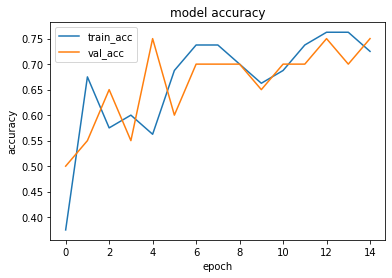

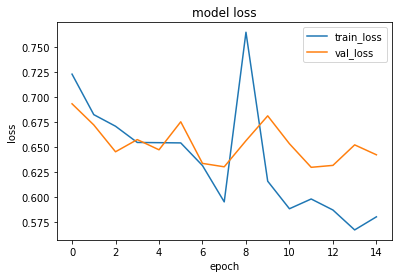

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4740042]]


1it [00:00, 11491.24it/s]


prediction for video armflapping_3.mov is [[0.6201799]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6316265]]


1it [00:00, 13662.23it/s]


prediction for video control_1.mov is [[0.41800174]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.4136364]]


1it [00:00, 14027.77it/s]


prediction for video control_3.mov is [[0.4087507]]


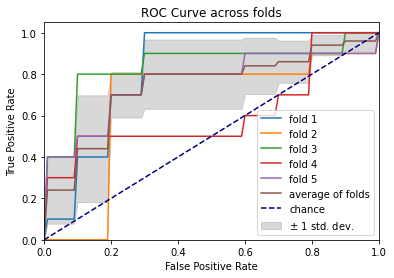

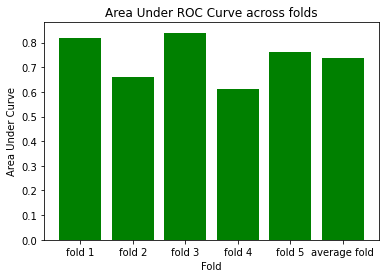

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 217ms/step - loss: 0.7075 - accuracy: 0.4625 - precision: 0.3846 - recall: 0.1250 - val_loss: 0.6769 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6745 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.6972 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6522 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.7108 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6319 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6412 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 127ms/step 

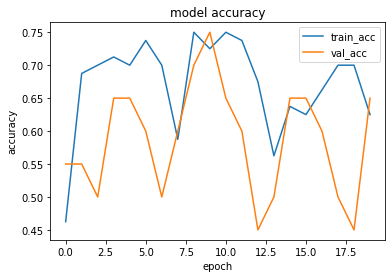

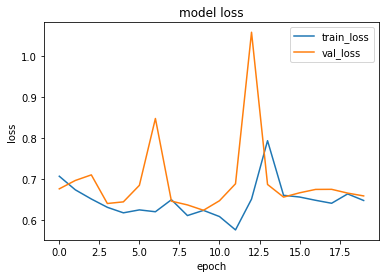

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.41873747]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.48121884]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.48707965]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.46598282]]


1it [00:00, 14027.77it/s]


prediction for video control_2.mov is [[0.3904788]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.45968637]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6896 - accuracy: 0.5250 - precision: 0.5167 - recall: 0.7750 - val_loss: 0.6432 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6920 - accuracy: 0.5625 - precision: 0.6087 - recall: 0.3500 - val_loss: 0.6282 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6644 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.6343 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6665 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.6167 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75


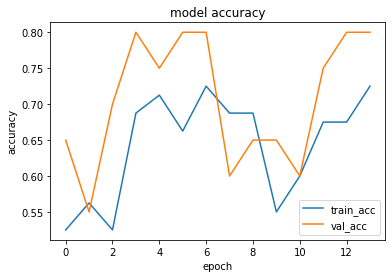

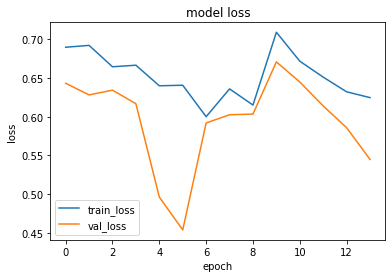

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.46854752]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5188806]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.5257739]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.43524894]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.42503828]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.417091]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6912 - accuracy: 0.4750 - precision: 0.4783 - recall: 0.5500 - val_loss: 0.6585 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6910 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.6357 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6597 - accuracy: 0.5250 - precision: 0.5139 - recall: 0.9250 - val_loss: 0.6484 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6636 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6434 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3/

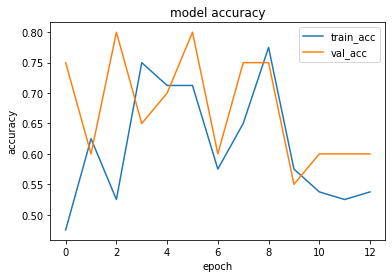

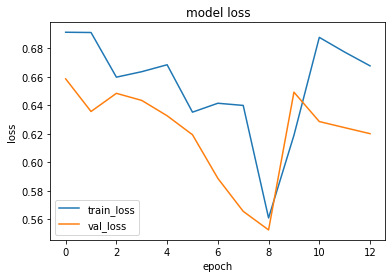

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5220458]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.5865905]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_2.mov is [[0.53837436]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.5154542]]


1it [00:00, 15087.42it/s]


prediction for video control_2.mov is [[0.5195559]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.51981574]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6868 - accuracy: 0.5875 - precision: 0.6129 - recall: 0.4750 - val_loss: 0.6961 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7198 - accuracy: 0.5750 - precision: 0.5682 - recall: 0.6250 - val_loss: 0.6915 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6393 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6909 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6426 - accuracy: 0.5500 - precision: 0.5294 - recall: 0.9000 - val_loss: 0.6948 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


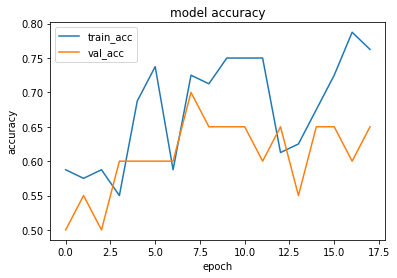

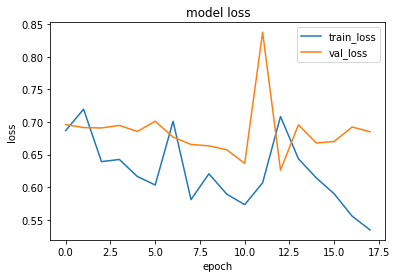

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.26656398]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5636432]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.63406986]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.20238373]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.19547206]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.20436233]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6998 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3750 - val_loss: 0.6602 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6674 - accuracy: 0.6625 - precision: 0.6970 - recall: 0.5750 - val_loss: 0.6631 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6705 - accuracy: 0.6375 - precision: 0.8667 - recall: 0.3250 - val_loss: 0.6321 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6389 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6182 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


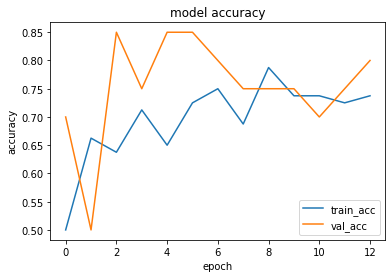

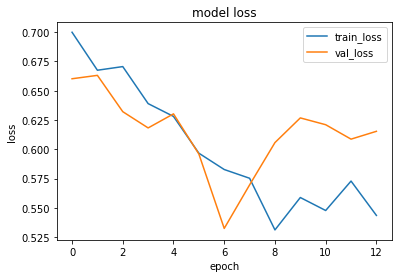

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.426369]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.5106002]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.50151324]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.3570875]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.33383152]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.30859888]]


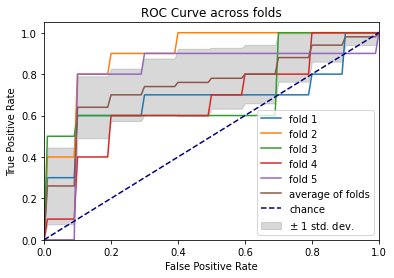

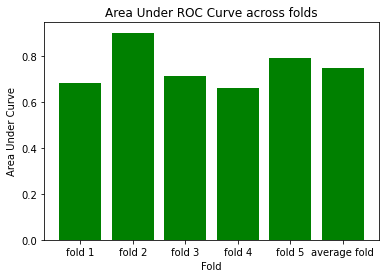

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7359 - accuracy: 0.4375 - precision: 0.3333 - recall: 0.1250 - val_loss: 0.6862 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6812 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6774 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6838 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6690 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6545 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.6544 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

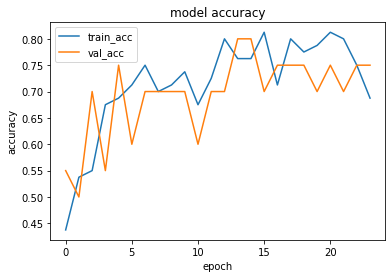

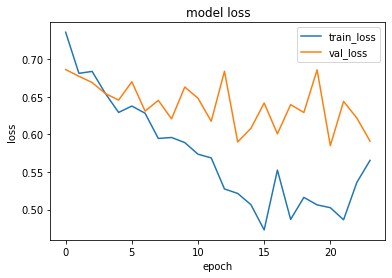

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.3005724]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.7162322]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.688825]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.20372495]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.18944919]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.20147368]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7138 - accuracy: 0.3875 - precision: 0.2857 - recall: 0.1500 - val_loss: 0.6826 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6918 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7250 - val_loss: 0.6895 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6754 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6387 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.7067 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.6427 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75


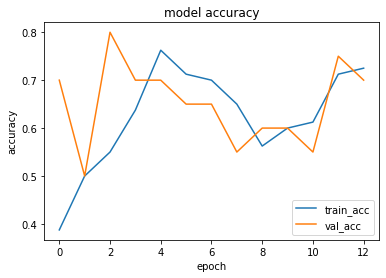

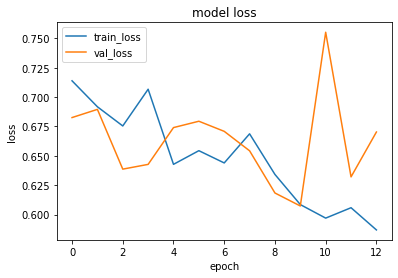

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5035151]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_3.mov is [[0.51868033]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.5091171]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.47049096]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.45338592]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.45392874]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6980 - accuracy: 0.4625 - precision: 0.4706 - recall: 0.6000 - val_loss: 0.6862 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6597 - accuracy: 0.4750 - precision: 0.4773 - recall: 0.5250 - val_loss: 0.6562 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6245 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.7163 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.7482 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.7147 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epo

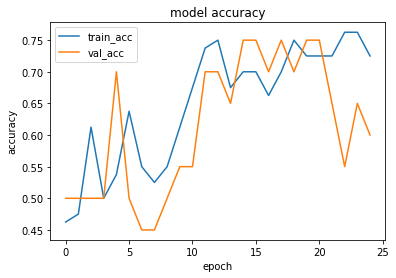

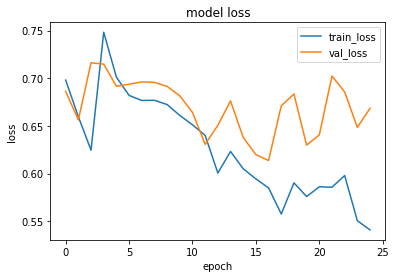

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.42368823]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.40703076]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_2.mov is [[0.49300617]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.37250316]]


1it [00:00, 17260.51it/s]


prediction for video control_2.mov is [[0.34604818]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.34570587]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6878 - accuracy: 0.5875 - precision: 0.6129 - recall: 0.4750 - val_loss: 0.6523 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6670 - accuracy: 0.6000 - precision: 0.5741 - recall: 0.7750 - val_loss: 0.6197 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6376 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.6187 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7264 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6400 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75


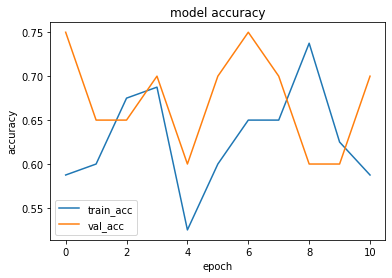

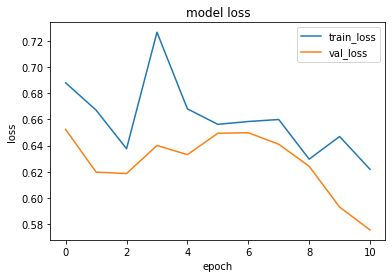

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5154855]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.5514719]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.5731919]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.4818676]]


1it [00:00, 12483.05it/s]


prediction for video control_2.mov is [[0.4720813]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.4638476]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7006 - accuracy: 0.4625 - precision: 0.4400 - recall: 0.2750 - val_loss: 0.6721 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6698 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6285 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7015 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6328 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6568 - accuracy: 0.6875 - precision: 0.8000 - recall: 0.5000 - val_loss: 0.6433 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 5/75
3

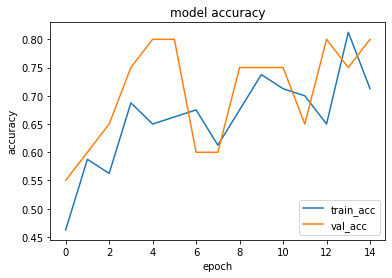

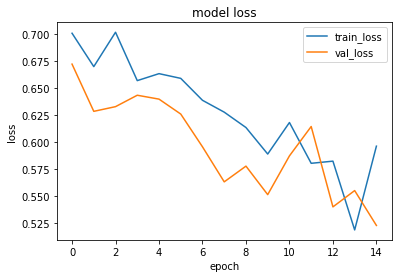

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.40172613]]


1it [00:00, 9892.23it/s]


prediction for video armflapping_3.mov is [[0.59116614]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.60495704]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.3118965]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.29055986]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.28248894]]


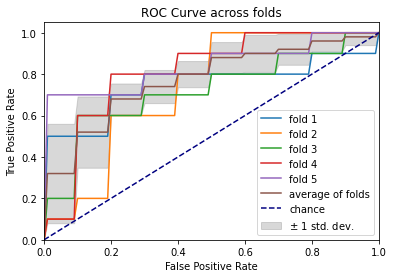

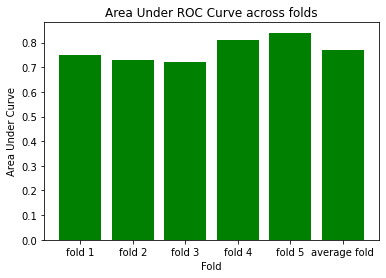

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6800 - accuracy: 0.5625 - precision: 0.5806 - recall: 0.4500 - val_loss: 0.6972 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6558 - accuracy: 0.6000 - precision: 0.5952 - recall: 0.6250 - val_loss: 0.6818 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6156 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.6806 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6189 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.7619 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 136ms/step 

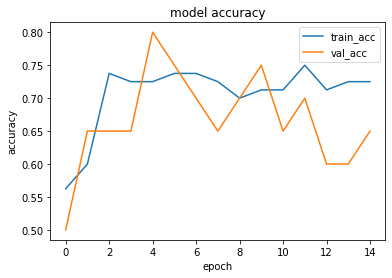

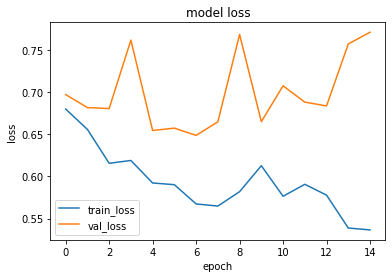

1it [00:00, 12945.38it/s]


prediction for video armflapping_1.mov is [[0.13443956]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.59658456]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.1422706]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.13090128]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.1296424]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.12953871]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7036 - accuracy: 0.4625 - precision: 0.4348 - recall: 0.2500 - val_loss: 0.6819 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6822 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6646 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6651 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.6755 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6082 - accuracy: 0.6250 - precision: 0.5735 - recall: 0.9750 - val_loss: 0.7159 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


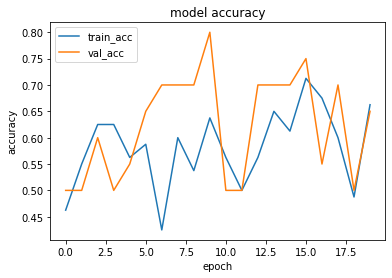

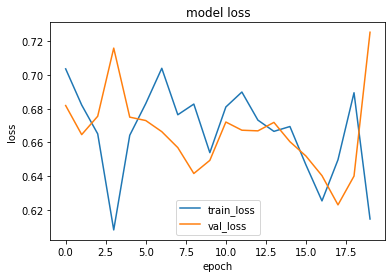

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.463527]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_3.mov is [[0.49061677]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.4968353]]


1it [00:00, 16194.22it/s]


prediction for video control_1.mov is [[0.44321167]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.42821547]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.42077518]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6947 - accuracy: 0.4250 - precision: 0.3750 - recall: 0.2250 - val_loss: 0.6705 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6664 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.8891 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 177ms/step - loss: 0.8015 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6461 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6490 - accuracy: 0.6625 - precision: 0.7826 - recall: 0.4500 - val_loss: 0.6475 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75


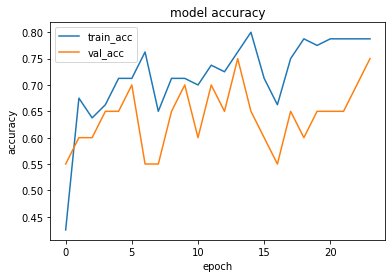

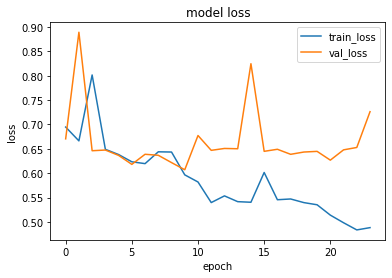

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.2740957]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.38741964]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.6369047]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.2104088]]


1it [00:00, 17772.47it/s]


prediction for video control_2.mov is [[0.19256106]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.1830968]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6900 - accuracy: 0.5875 - precision: 0.6296 - recall: 0.4250 - val_loss: 0.6650 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6564 - accuracy: 0.6000 - precision: 0.5741 - recall: 0.7750 - val_loss: 0.6185 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7392 - accuracy: 0.6250 - precision: 0.7500 - recall: 0.3750 - val_loss: 0.6243 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 177ms/step - loss: 0.6417 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6939 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3

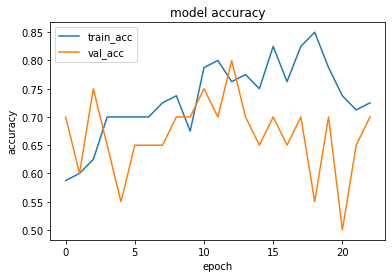

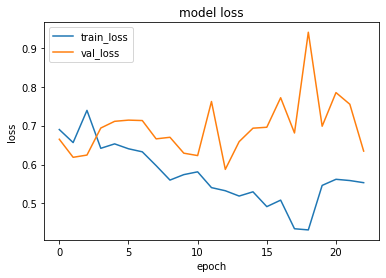

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.13251597]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.43837833]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.2145598]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.11733299]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.1161966]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.11542276]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6917 - accuracy: 0.4875 - precision: 0.4800 - recall: 0.3000 - val_loss: 0.6485 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.8125 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6516 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6613 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6769 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6733 - accuracy: 0.5750 - precision: 0.6875 - recall: 0.2750 - val_loss: 0.6508 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epo

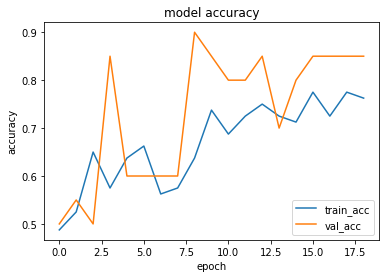

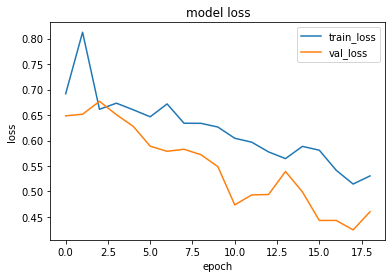

1it [00:00, 12671.61it/s]


prediction for video armflapping_1.mov is [[0.53163767]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.6624255]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.66099733]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.45064485]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.42308047]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.4090057]]


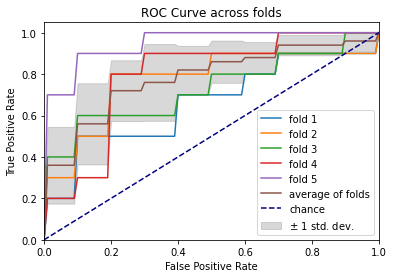

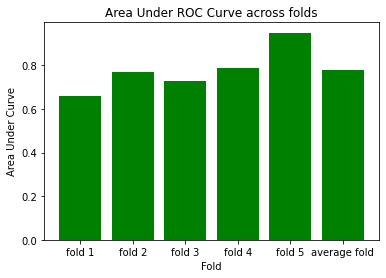

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6801 - accuracy: 0.5750 - precision: 0.6364 - recall: 0.3500 - val_loss: 0.8324 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6639 - accuracy: 0.6500 - precision: 0.5909 - recall: 0.9750 - val_loss: 0.6482 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6786 - accuracy: 0.6375 - precision: 0.8667 - recall: 0.3250 - val_loss: 0.6450 - val_accuracy: 0.4000 - val_precision: 0.2500 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6445 - accuracy: 0.7000 - precision: 0.8077 - recall: 0.5250 - val_loss: 0.7174 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 118ms/step 

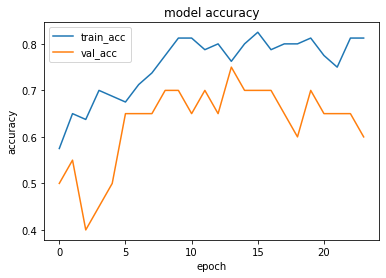

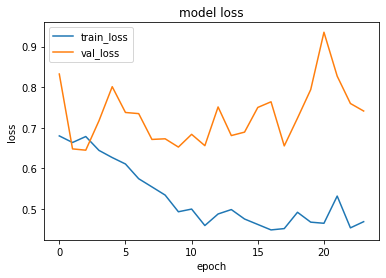

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.5105063]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.673858]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.67517865]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.27610442]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.23099414]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.21870494]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6870 - accuracy: 0.6000 - precision: 0.5800 - recall: 0.7250 - val_loss: 0.7115 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6282 - accuracy: 0.6250 - precision: 0.6136 - recall: 0.6750 - val_loss: 0.9573 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.5919 - accuracy: 0.6875 - precision: 0.6271 - recall: 0.9250 - val_loss: 0.6604 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6939 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.6443 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


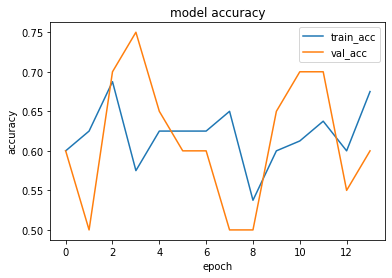

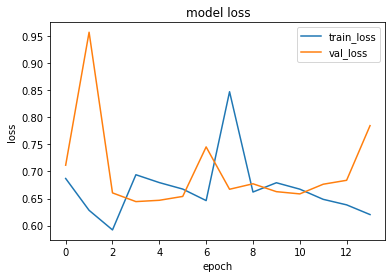

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5231647]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5378688]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.54266095]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.50744075]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.49228352]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.4968614]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6847 - accuracy: 0.4500 - precision: 0.4565 - recall: 0.5250 - val_loss: 0.6563 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6207 - accuracy: 0.7000 - precision: 0.6429 - recall: 0.9000 - val_loss: 0.8181 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6480 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.6815 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6583 - accuracy: 0.6625 - precision: 0.6066 - recall: 0.9250 - val_loss: 0.6697 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3

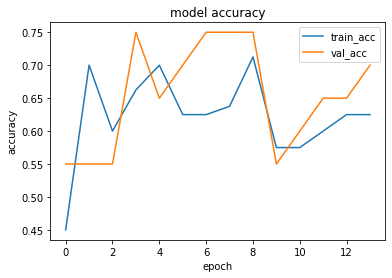

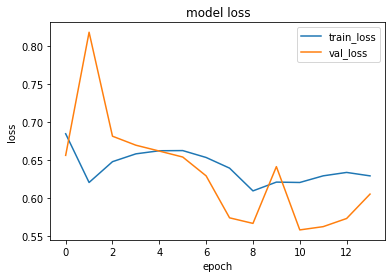

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.52721083]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.55454344]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.54242355]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.505187]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.493675]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.49689984]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 218ms/step - loss: 0.6955 - accuracy: 0.4750 - precision: 0.4792 - recall: 0.5750 - val_loss: 0.6648 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6743 - accuracy: 0.6125 - precision: 0.8000 - recall: 0.3000 - val_loss: 0.6460 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6511 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.5632 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.7150 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.5777 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 5/75


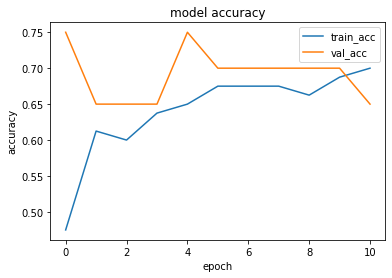

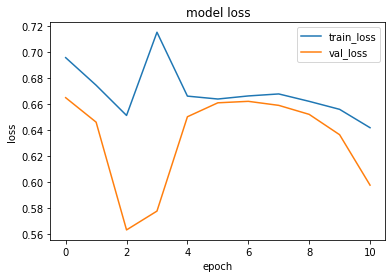

1it [00:00, 14563.56it/s]


prediction for video armflapping_1.mov is [[0.47602227]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.5043842]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.51327235]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.4544186]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.44798636]]


1it [00:00, 13662.23it/s]


prediction for video control_3.mov is [[0.44338763]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6875 - accuracy: 0.4375 - precision: 0.4074 - recall: 0.2750 - val_loss: 0.6715 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6530 - accuracy: 0.6000 - precision: 0.5625 - recall: 0.9000 - val_loss: 0.6114 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6327 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6529 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6414 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.5775 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75


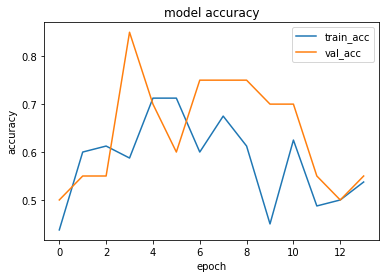

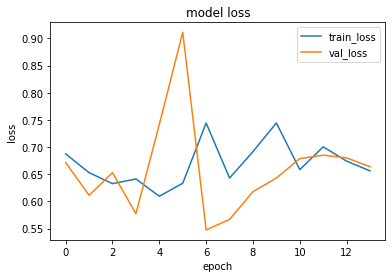

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.53245616]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.5716727]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.56359535]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.52298355]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.53359073]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.41047058]]


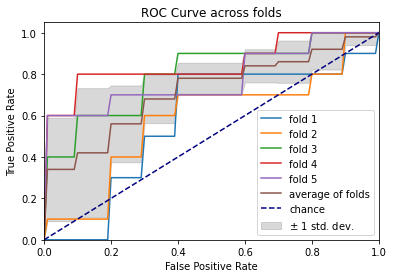

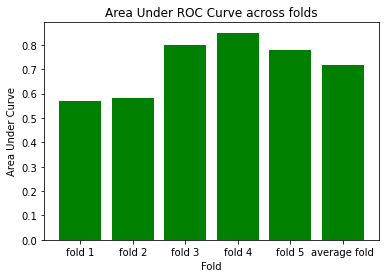

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6878 - accuracy: 0.4875 - precision: 0.4909 - recall: 0.6750 - val_loss: 0.6973 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6847 - accuracy: 0.5625 - precision: 0.5581 - recall: 0.6000 - val_loss: 0.6246 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6861 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6397 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6665 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6293 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 122

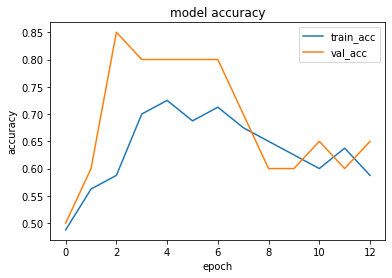

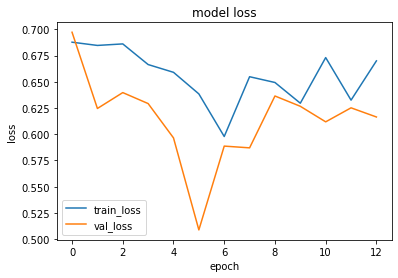

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.33237132]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.59114456]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.33477566]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.33101404]]


1it [00:00, 12826.62it/s]


prediction for video control_2.mov is [[0.33031073]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.3302529]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6890 - accuracy: 0.5250 - precision: 0.5143 - recall: 0.9000 - val_loss: 0.6791 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.7042 - accuracy: 0.5125 - precision: 1.0000 - recall: 0.0250 - val_loss: 0.6911 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6426 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.7613 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6201 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.6961 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoc

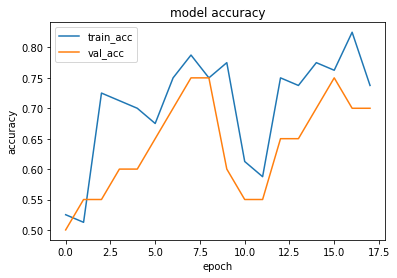

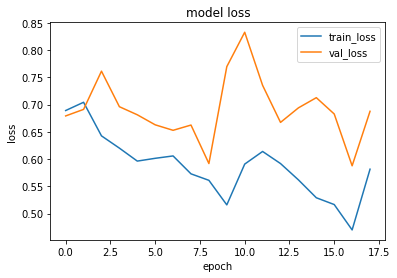

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.6807219]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.7576487]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.7474663]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.3141682]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.24267152]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.27523756]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6906 - accuracy: 0.4875 - precision: 0.4286 - recall: 0.0750 - val_loss: 0.6796 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6703 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.7026 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6351 - accuracy: 0.5875 - precision: 0.5479 - recall: 1.0000 - val_loss: 0.6718 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6530 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6686 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 5/75


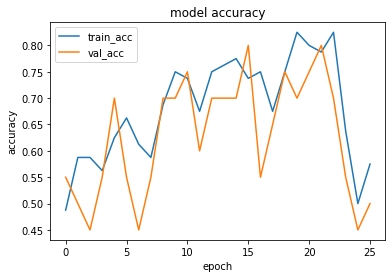

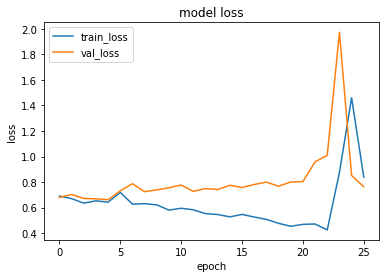

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.310125]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.66370744]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.43225947]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.27699107]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.26633596]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.26640552]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7075 - accuracy: 0.5500 - precision: 0.5323 - recall: 0.8250 - val_loss: 0.6759 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6838 - accuracy: 0.5875 - precision: 0.6207 - recall: 0.4500 - val_loss: 0.6517 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6853 - accuracy: 0.5500 - precision: 0.8333 - recall: 0.1250 - val_loss: 0.6213 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6648 - accuracy: 0.6500 - precision: 0.6500 - recall: 0.6500 - val_loss: 0.5766 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75


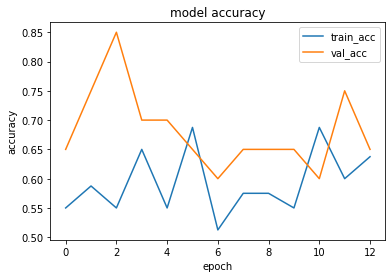

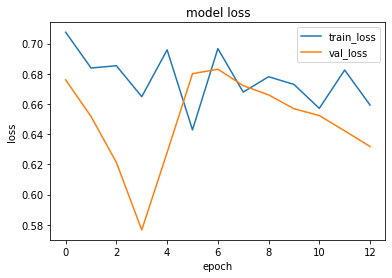

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.44305724]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.5045796]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.49626064]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.42516157]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.42497823]]


1it [00:00, 12483.05it/s]


prediction for video control_3.mov is [[0.42062357]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6798 - accuracy: 0.5875 - precision: 0.6296 - recall: 0.4250 - val_loss: 0.6599 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.8174 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6541 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6550 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6828 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6743 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6837 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75


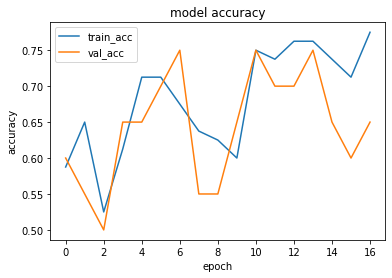

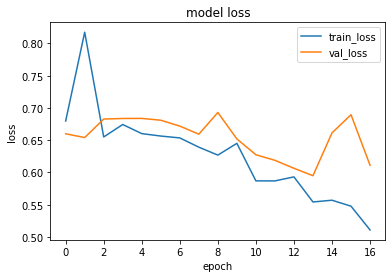

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.45592505]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.62562853]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_2.mov is [[0.6598823]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.3627744]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.33993107]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.32874978]]


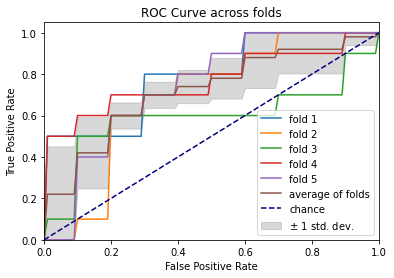

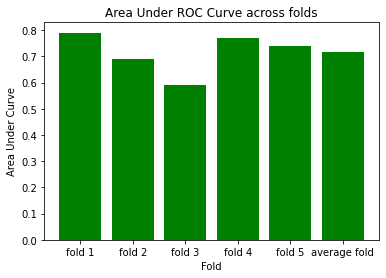

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6885 - accuracy: 0.5250 - precision: 0.5250 - recall: 0.5250 - val_loss: 0.7200 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6598 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9250 - val_loss: 0.6957 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6598 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.6429 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6498 - accuracy: 0.6125 - precision: 0.8462 - recall: 0.2750 - val_loss: 0.6506 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

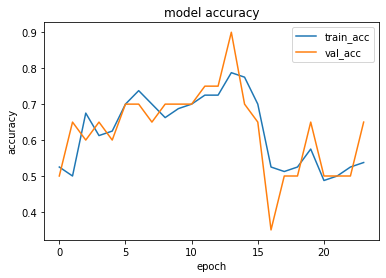

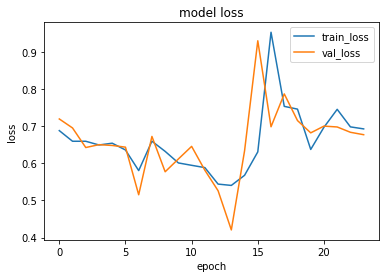

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.49021772]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.4911906]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.49052942]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.48948836]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.48932102]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.48932713]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6823 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.7612 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6570 - accuracy: 0.5750 - precision: 0.5652 - recall: 0.6500 - val_loss: 0.6517 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6253 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.7543 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.5821 - accuracy: 0.7500 - precision: 0.7083 - recall: 0.8500 - val_loss: 0.6822 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 5/75


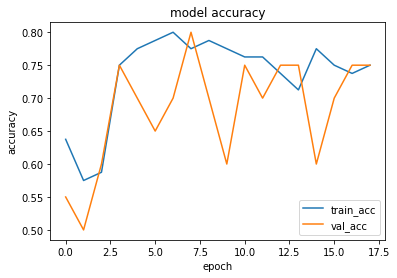

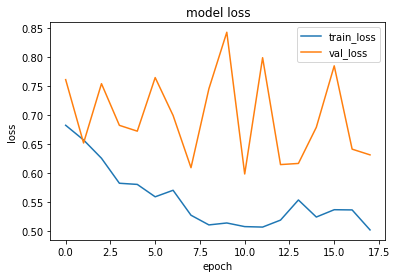

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5025654]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.6259081]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.60025746]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.40117073]]


1it [00:00, 12520.31it/s]


prediction for video control_2.mov is [[0.35360754]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.35204774]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6954 - accuracy: 0.4000 - precision: 0.3750 - recall: 0.3000 - val_loss: 0.6595 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 192ms/step - loss: 0.7374 - accuracy: 0.5500 - precision: 0.5526 - recall: 0.5250 - val_loss: 0.6568 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6525 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6640 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6715 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6503 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75


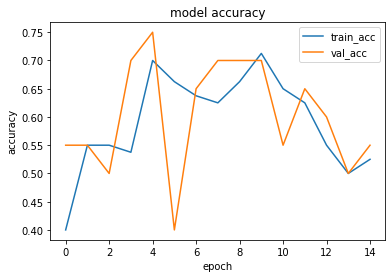

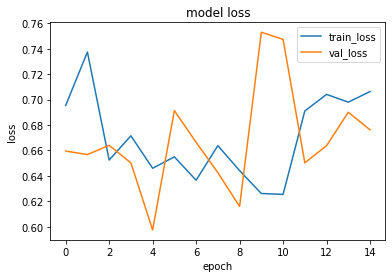

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.509015]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.5508274]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5178601]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.5039709]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.5071629]]


1it [00:00, 11915.64it/s]


prediction for video control_3.mov is [[0.50685036]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6905 - accuracy: 0.4875 - precision: 0.4918 - recall: 0.7500 - val_loss: 0.6552 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7277 - accuracy: 0.6000 - precision: 0.6538 - recall: 0.4250 - val_loss: 0.6513 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6629 - accuracy: 0.6500 - precision: 0.7143 - recall: 0.5000 - val_loss: 0.6830 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6603 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6909 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75


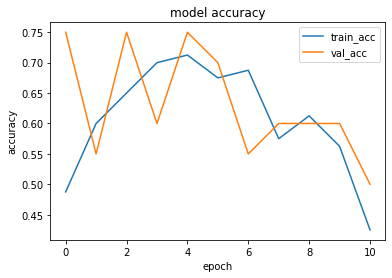

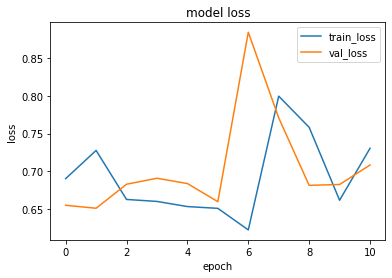

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5887093]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.59465957]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5939281]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.5865239]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.58607006]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.58611864]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7145 - accuracy: 0.4000 - precision: 0.3182 - recall: 0.1750 - val_loss: 0.7006 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6808 - accuracy: 0.6250 - precision: 0.6667 - recall: 0.5000 - val_loss: 0.6808 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6420 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.7339 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6396 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.6515 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 5/75


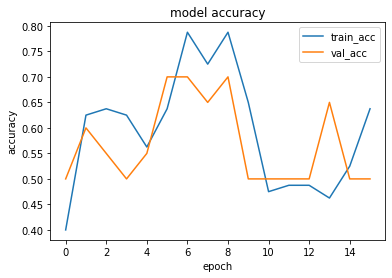

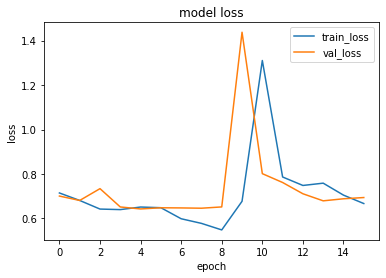

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.47693884]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.4744937]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.47744995]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.47631398]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.47605658]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.47600022]]


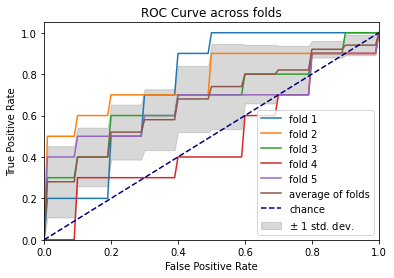

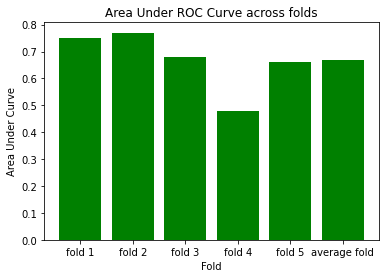

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6979 - accuracy: 0.5375 - precision: 0.5455 - recall: 0.4500 - val_loss: 0.6812 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 194ms/step - loss: 0.6507 - accuracy: 0.5500 - precision: 0.5286 - recall: 0.9250 - val_loss: 0.8613 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6762 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6794 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6630 - accuracy: 0.5625 - precision: 0.6471 - recall: 0.2750 - val_loss: 0.6846 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] - 0s 119ms/step 

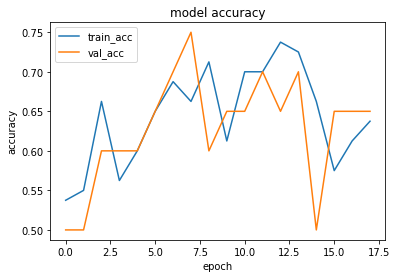

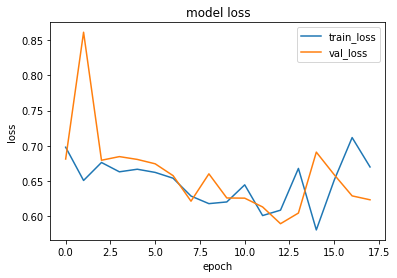

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.46307868]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.44611105]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_2.mov is [[0.4572353]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.43842506]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.4227441]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.42698294]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.7049 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6760 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6794 - accuracy: 0.6375 - precision: 0.7391 - recall: 0.4250 - val_loss: 0.6447 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7297 - accuracy: 0.6125 - precision: 0.5882 - recall: 0.7500 - val_loss: 0.5484 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6256 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.5973 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75


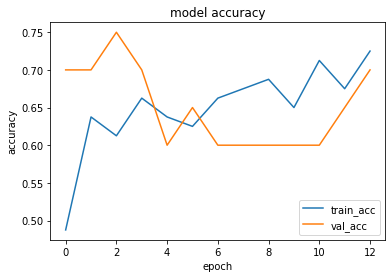

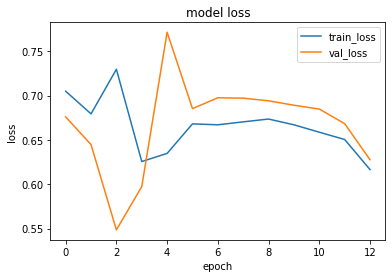

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.373984]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.782226]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.64855397]]


1it [00:00, 12372.58it/s]


prediction for video control_1.mov is [[0.3553294]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.35394698]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.32730508]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6812 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.7036 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7013 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.6583 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6505 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.6596 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6912 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.6392 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epo

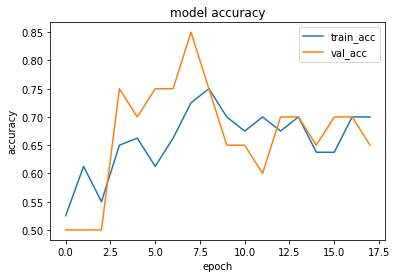

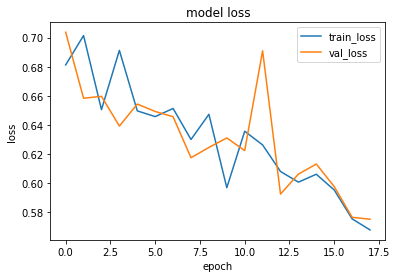

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.28722528]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.34879267]]


1it [00:00, 12192.74it/s]


prediction for video armflapping_2.mov is [[0.3808421]]


1it [00:00, 12945.38it/s]


prediction for video control_1.mov is [[0.25542617]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.24481535]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.24080852]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6824 - accuracy: 0.5875 - precision: 0.5946 - recall: 0.5500 - val_loss: 0.6522 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7573 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 1.2095 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.8256 - accuracy: 0.5375 - precision: 0.7143 - recall: 0.1250 - val_loss: 0.6791 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6688 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.6905 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

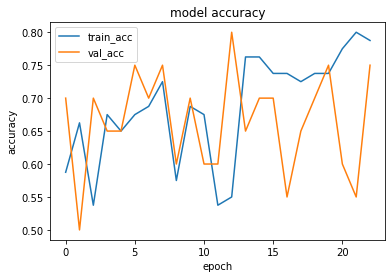

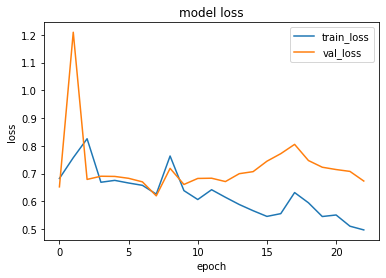

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.307259]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.60066056]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.6734992]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.27827597]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.27035922]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.27136147]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 207ms/step - loss: 0.6908 - accuracy: 0.4875 - precision: 0.4800 - recall: 0.3000 - val_loss: 0.6349 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6542 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.8809 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6620 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6528 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6619 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6473 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75


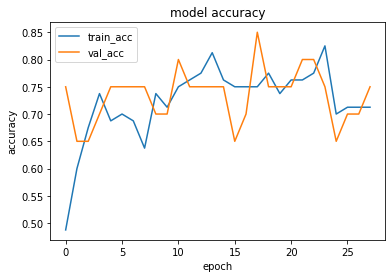

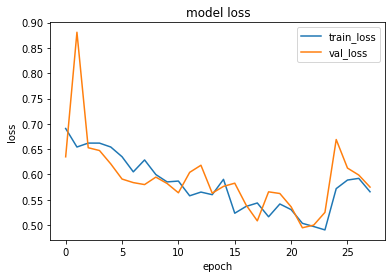

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4651731]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.66403633]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_2.mov is [[0.61872435]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.3747205]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.35508716]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.34473687]]


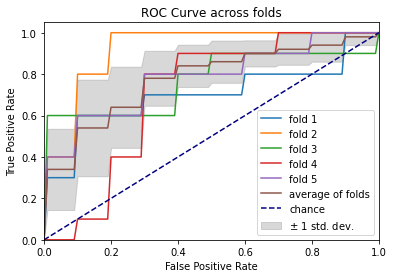

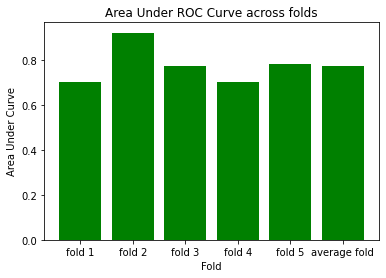

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6763 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6250 - val_loss: 0.9307 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7251 - accuracy: 0.6125 - precision: 0.6552 - recall: 0.4750 - val_loss: 0.7178 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6413 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.7113 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6366 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.7114 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] - 0s 123

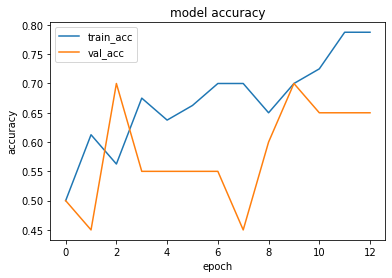

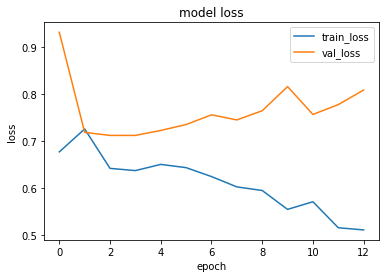

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.5564749]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.71474296]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.7882601]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.435585]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.40391645]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.38652164]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6983 - accuracy: 0.5250 - precision: 0.5312 - recall: 0.4250 - val_loss: 0.6617 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6815 - accuracy: 0.5875 - precision: 0.5854 - recall: 0.6000 - val_loss: 0.6369 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6561 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.6174 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 190ms/step - loss: 0.6382 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.5814 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75


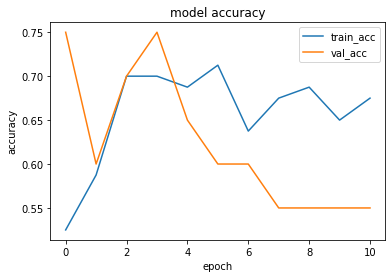

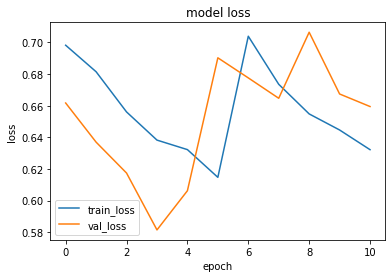

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.41504043]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.44412294]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.49739394]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.39355493]]


1it [00:00, 14027.77it/s]


prediction for video control_2.mov is [[0.33948737]]


1it [00:00, 12520.31it/s]


prediction for video control_3.mov is [[0.3721476]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6927 - accuracy: 0.4750 - precision: 0.4615 - recall: 0.3000 - val_loss: 0.6414 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6962 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.6656 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6782 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6616 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6818 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6557 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75
3

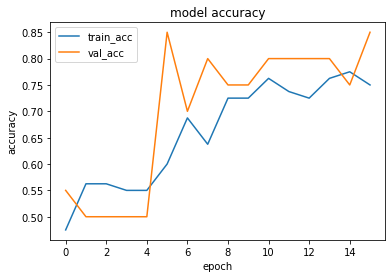

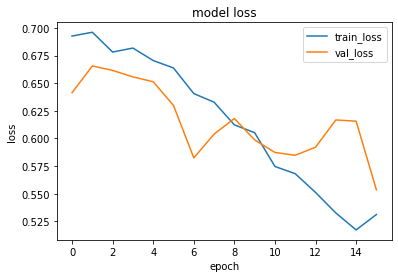

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.38929212]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5988837]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.66568696]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.2882247]]


1it [00:00, 18236.10it/s]


prediction for video control_2.mov is [[0.2658537]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.24694532]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6874 - accuracy: 0.5375 - precision: 0.5238 - recall: 0.8250 - val_loss: 0.6725 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7054 - accuracy: 0.5125 - precision: 0.5714 - recall: 0.1000 - val_loss: 0.6647 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6735 - accuracy: 0.5750 - precision: 0.5938 - recall: 0.4750 - val_loss: 0.6631 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6436 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6204 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75


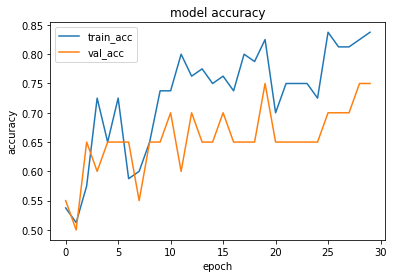

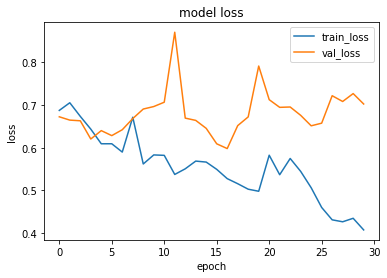

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.2506988]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.34691477]]


1it [00:00, 12945.38it/s]


prediction for video armflapping_2.mov is [[0.5253712]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.21533847]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.20266631]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.8402209]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6918 - accuracy: 0.6500 - precision: 0.6200 - recall: 0.7750 - val_loss: 0.6921 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6744 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.6643 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6450 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6459 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6241 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6028 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75
3

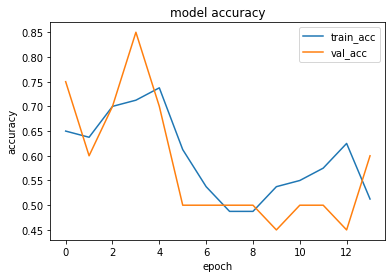

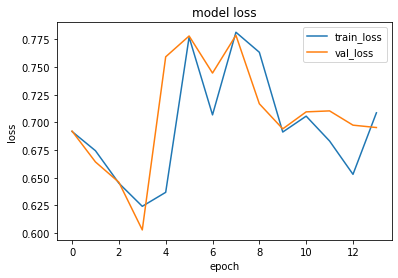

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.50374854]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.502509]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.5023812]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.50369674]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.5036841]]


1it [00:00, 14027.77it/s]


prediction for video control_3.mov is [[0.50368345]]


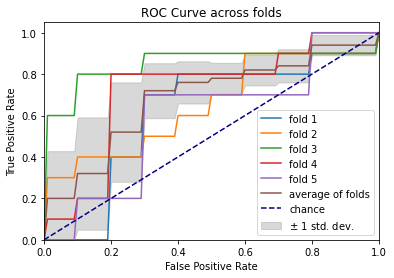

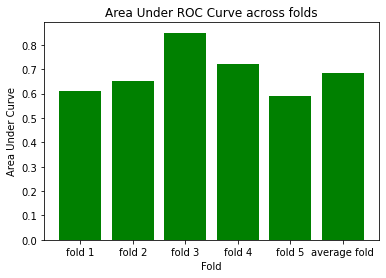

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 230ms/step - loss: 0.6973 - accuracy: 0.4250 - precision: 0.4464 - recall: 0.6250 - val_loss: 0.6726 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6737 - accuracy: 0.5375 - precision: 0.5217 - recall: 0.9000 - val_loss: 0.6361 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6458 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 0.6222 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6167 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.6164 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 124ms/step 

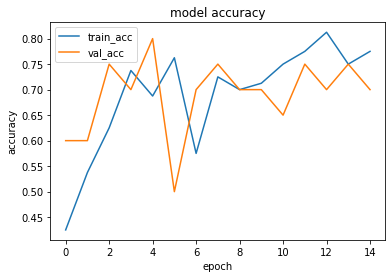

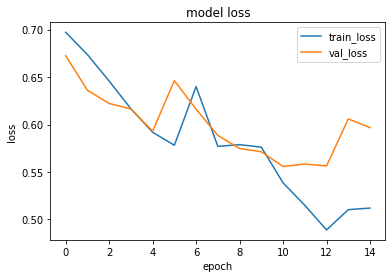

1it [00:00, 10305.42it/s]


prediction for video armflapping_1.mov is [[0.37659565]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.47837102]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.44456923]]


1it [00:00, 14027.77it/s]


prediction for video control_1.mov is [[0.28838542]]


1it [00:00, 12052.60it/s]


prediction for video control_2.mov is [[0.25171065]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.22222063]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6975 - accuracy: 0.3875 - precision: 0.4118 - recall: 0.5250 - val_loss: 0.6995 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6521 - accuracy: 0.6000 - precision: 0.5588 - recall: 0.9500 - val_loss: 0.8075 - val_accuracy: 0.4000 - val_precision: 0.4167 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6185 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.6830 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6545 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6665 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


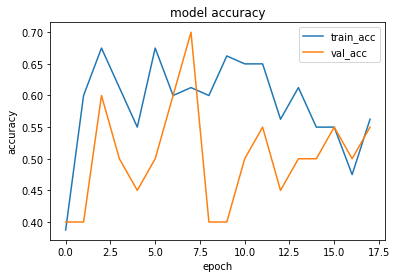

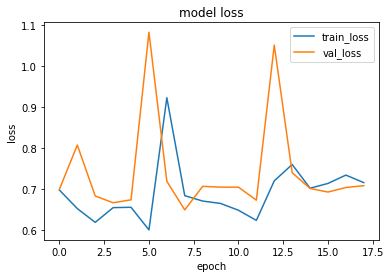

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.35556686]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_3.mov is [[0.35575727]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.35688204]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.35467112]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.35431367]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.35424906]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6841 - accuracy: 0.5875 - precision: 0.5897 - recall: 0.5750 - val_loss: 0.6773 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6785 - accuracy: 0.5375 - precision: 0.5319 - recall: 0.6250 - val_loss: 0.6329 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6358 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.6154 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5741 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.7305 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 5/75


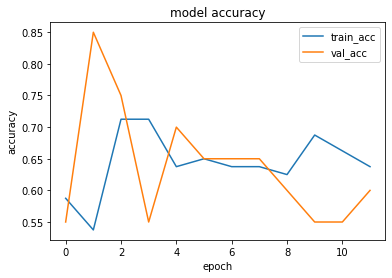

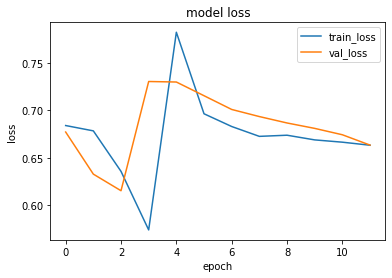

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.46505487]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.4874764]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.47372076]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.46465498]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.4636836]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.46333292]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 133ms/step - loss: 0.6956 - accuracy: 0.5500 - precision: 0.6429 - recall: 0.2250 - val_loss: 0.6975 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6444 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.9391 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6386 - accuracy: 0.6875 - precision: 0.6271 - recall: 0.9250 - val_loss: 0.7420 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6280 - accuracy: 0.7375 - precision: 0.8800 - recall: 0.5500 - val_loss: 0.6697 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75


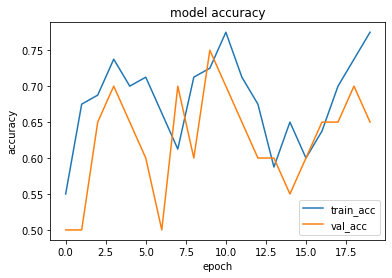

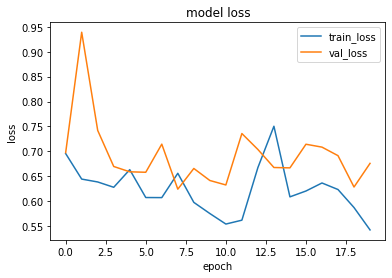

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.2989987]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.5785371]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.6404491]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.23088041]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.20299593]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.21336523]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6957 - accuracy: 0.4500 - precision: 0.4630 - recall: 0.6250 - val_loss: 0.6517 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6417 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.6736 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6956 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6588 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6414 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.6976 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 5/75


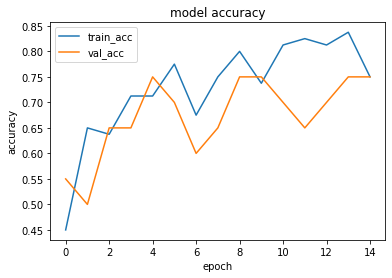

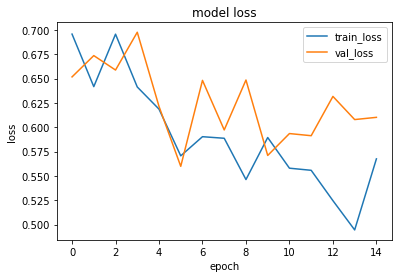

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.37516713]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_3.mov is [[0.56317306]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.6586158]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.27409834]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.22036985]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.21678704]]


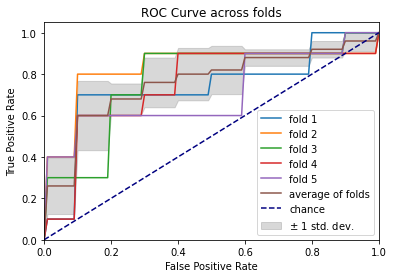

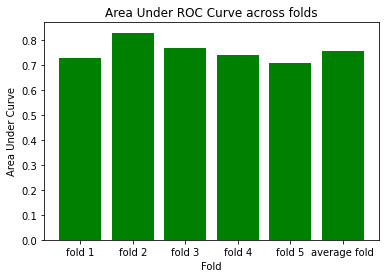

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.7045 - accuracy: 0.5125 - precision: 0.5294 - recall: 0.2250 - val_loss: 0.6811 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6885 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8750 - val_loss: 0.6576 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6596 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6325 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6605 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.5869 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 124ms/step 

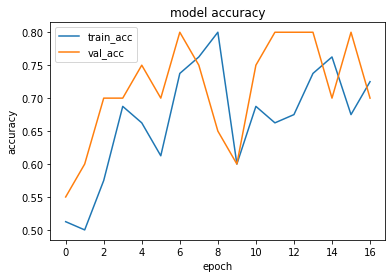

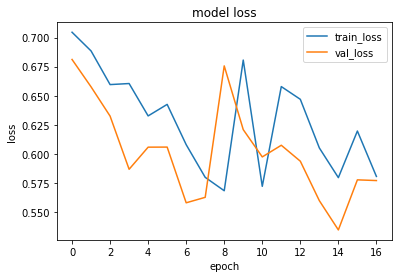

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.46255752]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.56722224]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.5978229]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.39846176]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.3800235]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.37480816]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6987 - accuracy: 0.5125 - precision: 0.5098 - recall: 0.6500 - val_loss: 0.6659 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6701 - accuracy: 0.6500 - precision: 0.6154 - recall: 0.8000 - val_loss: 0.6288 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6380 - accuracy: 0.5500 - precision: 0.5333 - recall: 0.8000 - val_loss: 0.5741 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6340 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.6135 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75


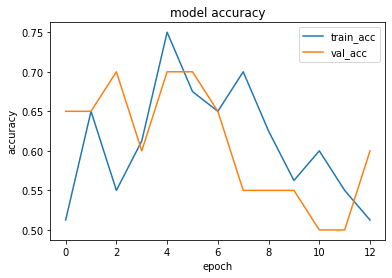

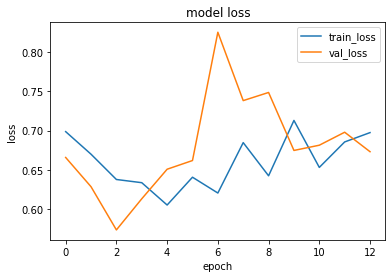

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.4365892]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.4710617]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.44510007]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.43794364]]


1it [00:00, 12671.61it/s]


prediction for video control_2.mov is [[0.44259182]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.44251856]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 136ms/step - loss: 0.6803 - accuracy: 0.5625 - precision: 0.5676 - recall: 0.5250 - val_loss: 0.6304 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6478 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.6981 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6610 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.6926 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6475 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.7038 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 5/75


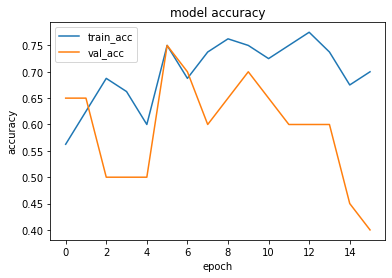

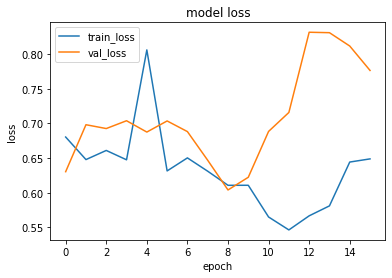

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.4644085]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.5177896]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.48937467]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.4321388]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.4134771]]


1it [00:00, 13842.59it/s]


prediction for video control_3.mov is [[0.41509452]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6749 - accuracy: 0.5500 - precision: 0.5303 - recall: 0.8750 - val_loss: 0.7789 - val_accuracy: 0.4000 - val_precision: 0.2500 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6503 - accuracy: 0.5625 - precision: 0.8571 - recall: 0.1500 - val_loss: 0.7674 - val_accuracy: 0.4000 - val_precision: 0.3333 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6138 - accuracy: 0.6375 - precision: 0.7619 - recall: 0.4000 - val_loss: 1.4366 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.7130 - accuracy: 0.6125 - precision: 0.5849 - recall: 0.7750 - val_loss: 0.9968 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 5/75


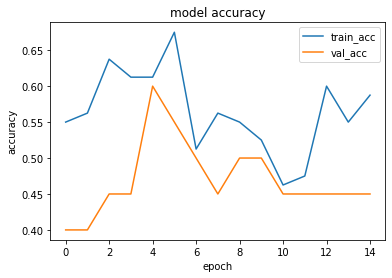

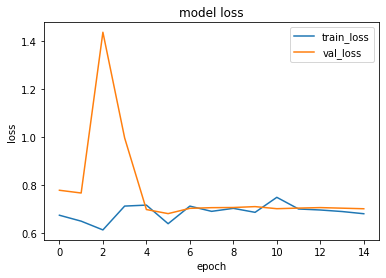

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.5562285]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.50522774]]


1it [00:00, 11650.84it/s]


prediction for video armflapping_2.mov is [[0.5577754]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.5561079]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.55607754]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.5560741]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7093 - accuracy: 0.5250 - precision: 0.5625 - recall: 0.2250 - val_loss: 0.6683 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6752 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6356 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6553 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.5934 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.5989 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.5812 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 5/75
3

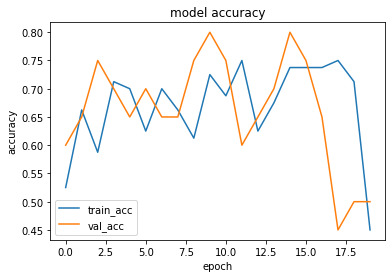

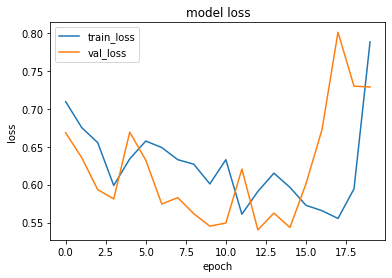

1it [00:00, 7570.95it/s]


prediction for video armflapping_1.mov is [[0.6504989]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_3.mov is [[0.641919]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.6522444]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.650189]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.6500501]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.6499777]]


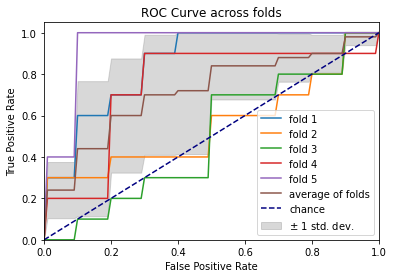

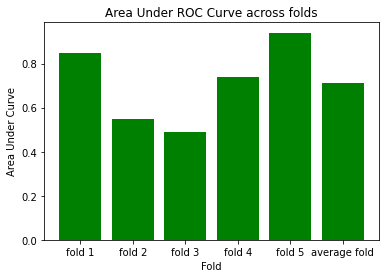

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6942 - accuracy: 0.4000 - precision: 0.4333 - recall: 0.6500 - val_loss: 0.6816 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7357 - accuracy: 0.5375 - precision: 0.5231 - recall: 0.8500 - val_loss: 0.6612 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6400 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.6725 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6696 - accuracy: 0.5875 - precision: 0.8182 - recall: 0.2250 - val_loss: 0.6734 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 5/75
3/3 [==============================] - 0s 122ms/step 

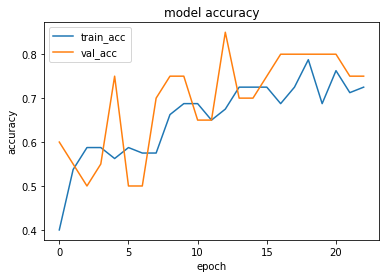

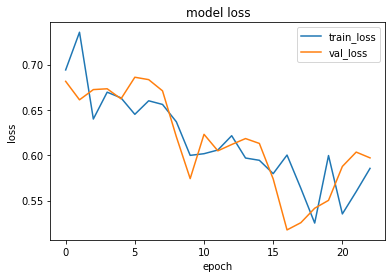

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.45704302]]


1it [00:00, 10866.07it/s]


prediction for video armflapping_3.mov is [[0.50040257]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.5042192]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.41879034]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.37948102]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.39533326]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6875 - accuracy: 0.5250 - precision: 0.5139 - recall: 0.9250 - val_loss: 0.6449 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6766 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.6642 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.7454 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6740 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6894 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.6739 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75


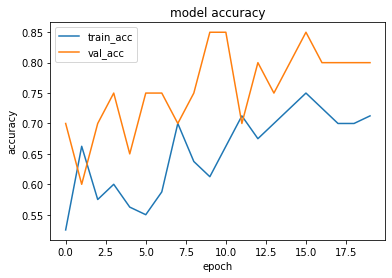

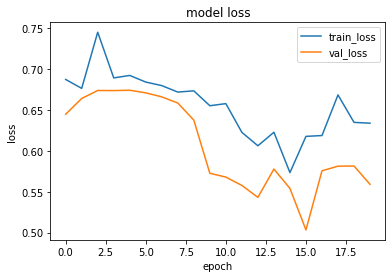

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.36008084]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.56558454]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.62155926]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.31446737]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.27047247]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.29077518]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6945 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5000 - val_loss: 0.6283 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6840 - accuracy: 0.5500 - precision: 0.5357 - recall: 0.7500 - val_loss: 0.6548 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6715 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6691 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6759 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6622 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75


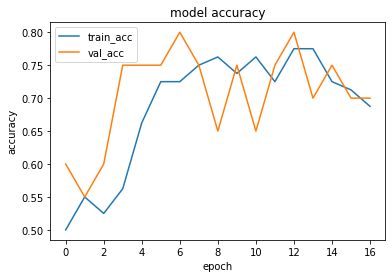

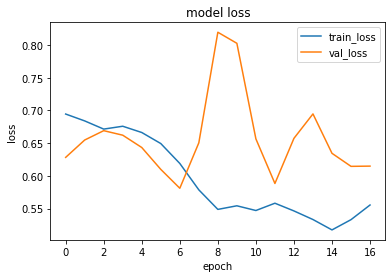

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.535531]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.67684144]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.6835267]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.36242613]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.32783523]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.32338196]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7180 - accuracy: 0.4000 - precision: 0.4167 - recall: 0.5000 - val_loss: 0.6946 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 188ms/step - loss: 0.6743 - accuracy: 0.6125 - precision: 0.5918 - recall: 0.7250 - val_loss: 0.7060 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6604 - accuracy: 0.5375 - precision: 0.7143 - recall: 0.1250 - val_loss: 0.6893 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6483 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.6882 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epo

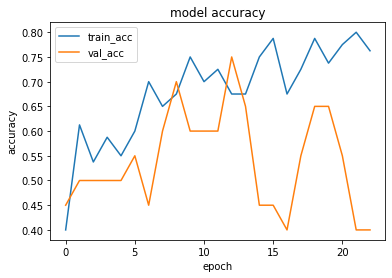

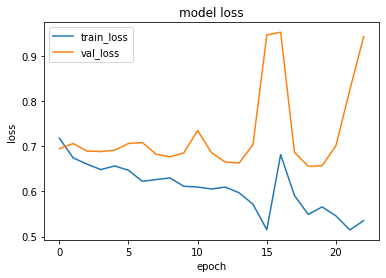

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.18684122]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.1910539]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.21043983]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.1749281]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.17083815]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.16938096]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7042 - accuracy: 0.4625 - precision: 0.4118 - recall: 0.1750 - val_loss: 0.6778 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6846 - accuracy: 0.5750 - precision: 0.6364 - recall: 0.3500 - val_loss: 0.6336 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6404 - accuracy: 0.7625 - precision: 0.8000 - recall: 0.7000 - val_loss: 0.7749 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6398 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.6065 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75


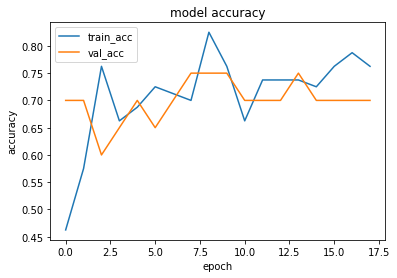

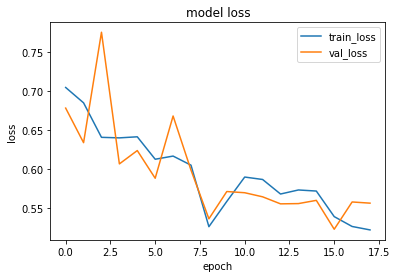

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.56244034]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.7345415]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.6982705]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.25716853]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.13205701]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.23853394]]


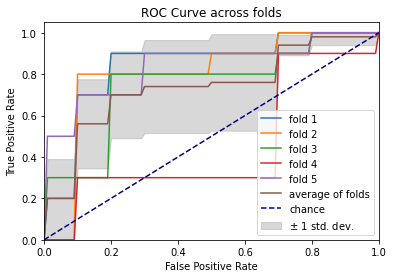

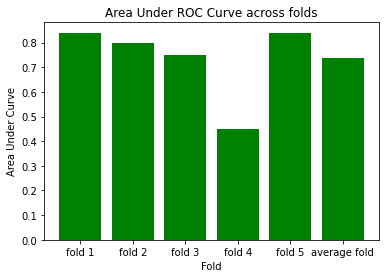

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6837 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.8603 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6595 - accuracy: 0.5750 - precision: 0.5714 - recall: 0.6000 - val_loss: 0.6993 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6457 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6883 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6096 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.8179 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 120

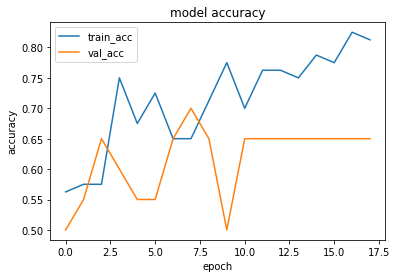

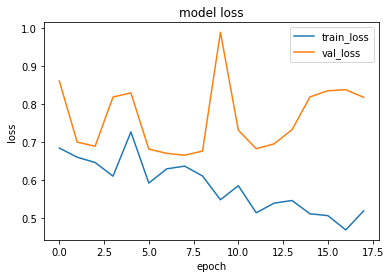

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.63555086]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.6309038]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.66380036]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.5546015]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.50372195]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.39817238]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6888 - accuracy: 0.4875 - precision: 0.4925 - recall: 0.8250 - val_loss: 0.5767 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6579 - accuracy: 0.5750 - precision: 0.5517 - recall: 0.8000 - val_loss: 0.5592 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6615 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.5966 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6416 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.5423 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75


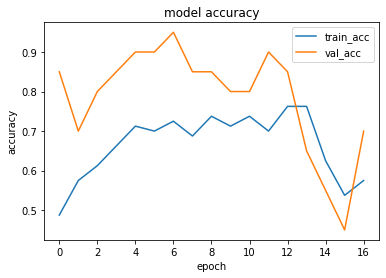

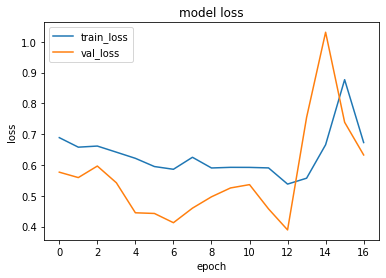

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.46915653]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.5964651]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.53727376]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.47128183]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.46479473]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.47686565]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7105 - accuracy: 0.4125 - precision: 0.3600 - recall: 0.2250 - val_loss: 0.6876 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6794 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.6706 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6435 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6108 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6411 - accuracy: 0.6500 - precision: 0.6364 - recall: 0.7000 - val_loss: 0.6405 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


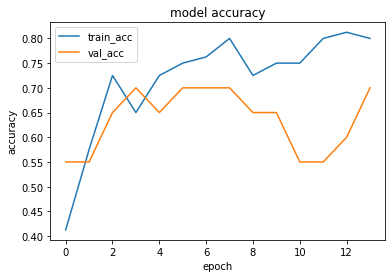

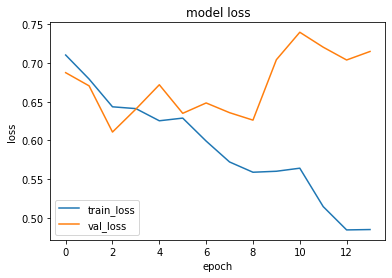

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.31074697]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.49291056]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.6750711]]


1it [00:00, 12787.51it/s]


prediction for video control_1.mov is [[0.25818485]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.23832688]]


1it [00:00, 12520.31it/s]


prediction for video control_3.mov is [[0.23523307]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7036 - accuracy: 0.4750 - precision: 0.4839 - recall: 0.7500 - val_loss: 0.6754 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6548 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.5591 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.7439 - accuracy: 0.5375 - precision: 0.5217 - recall: 0.9000 - val_loss: 0.6808 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6405 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6764 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


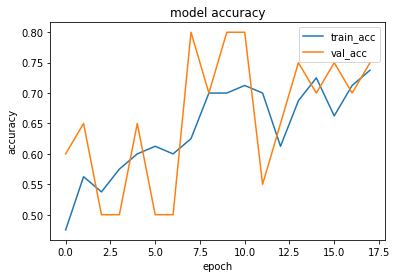

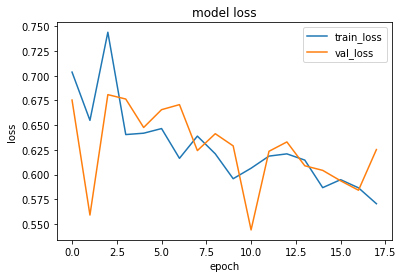

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.50125533]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.5950621]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_2.mov is [[0.56599975]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.4589823]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.445849]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.43060288]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6843 - accuracy: 0.5375 - precision: 0.5263 - recall: 0.7500 - val_loss: 0.6753 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6580 - accuracy: 0.5625 - precision: 0.5581 - recall: 0.6000 - val_loss: 0.6427 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6369 - accuracy: 0.6500 - precision: 0.6200 - recall: 0.7750 - val_loss: 0.6119 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6007 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.5719 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


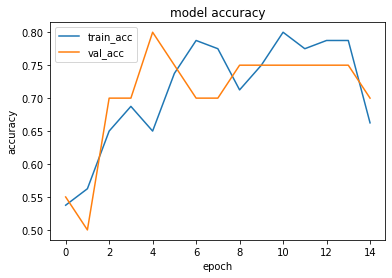

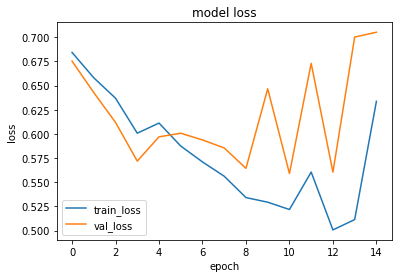

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.3900554]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.50690454]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.43625298]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.35087025]]


1it [00:00, 11881.88it/s]


prediction for video control_2.mov is [[0.3696056]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.3591931]]


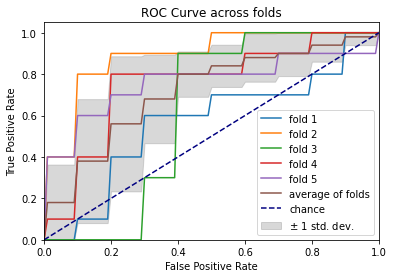

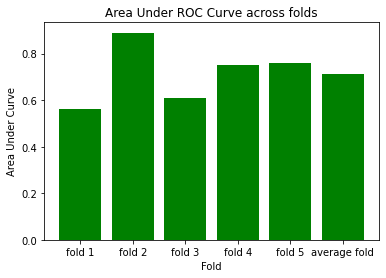

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6991 - accuracy: 0.5750 - precision: 0.5517 - recall: 0.8000 - val_loss: 0.6860 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6662 - accuracy: 0.6375 - precision: 0.9231 - recall: 0.3000 - val_loss: 0.7064 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6597 - accuracy: 0.6000 - precision: 0.5556 - recall: 1.0000 - val_loss: 0.6750 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6530 - accuracy: 0.6000 - precision: 0.6818 - recall: 0.3750 - val_loss: 0.6807 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 5/75
3/3 [==============================] - 0s 121ms/step 

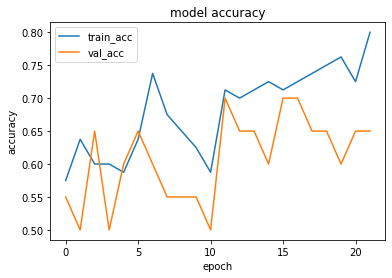

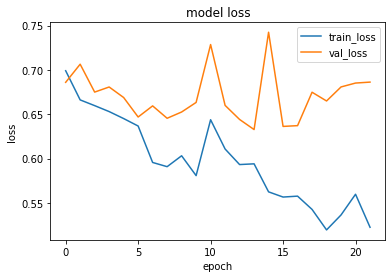

1it [00:00, 12633.45it/s]


prediction for video armflapping_1.mov is [[0.30079538]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.71879876]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.7371627]]


1it [00:00, 16070.13it/s]


prediction for video control_1.mov is [[0.251617]]


1it [00:00, 12787.51it/s]


prediction for video control_2.mov is [[0.2386688]]


1it [00:00, 13315.25it/s]


prediction for video control_3.mov is [[0.235277]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7289 - accuracy: 0.4875 - precision: 0.4615 - recall: 0.1500 - val_loss: 0.6987 - val_accuracy: 0.4000 - val_precision: 0.4375 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6887 - accuracy: 0.5250 - precision: 0.5147 - recall: 0.8750 - val_loss: 0.6790 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6875 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6675 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6898 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.2750 - val_loss: 0.6830 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75
3/

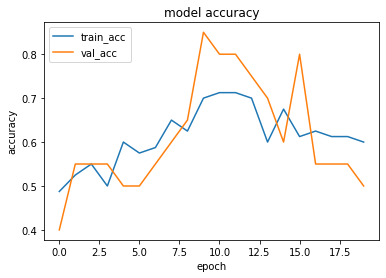

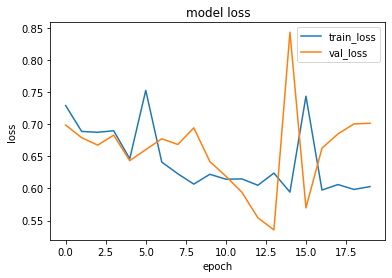

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.5863568]]


1it [00:00, 11335.96it/s]


prediction for video armflapping_3.mov is [[0.6439862]]


1it [00:00, 12483.05it/s]


prediction for video armflapping_2.mov is [[0.59906965]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.57322246]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.5724717]]


1it [00:00, 13315.25it/s]


prediction for video control_3.mov is [[0.57397795]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6922 - accuracy: 0.5250 - precision: 0.5185 - recall: 0.7000 - val_loss: 0.6852 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6496 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.7064 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.7247 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.8313 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.7189 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 0.7763 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 5/75


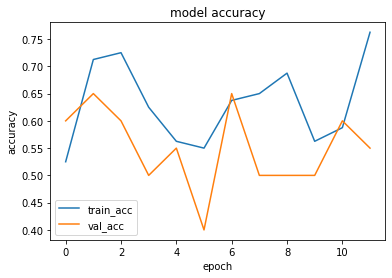

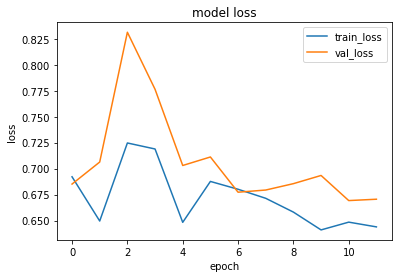

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.4864596]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.50970745]]


1it [00:00, 12710.01it/s]


prediction for video armflapping_2.mov is [[0.5115106]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.47384512]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.4730622]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.46798423]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6916 - accuracy: 0.4875 - precision: 0.4815 - recall: 0.3250 - val_loss: 0.6712 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6641 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.6410 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6702 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.5741 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6417 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5167 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75


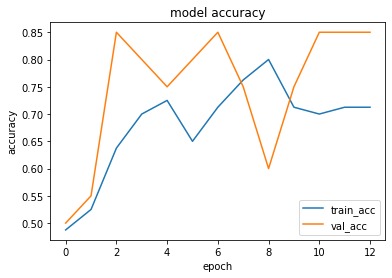

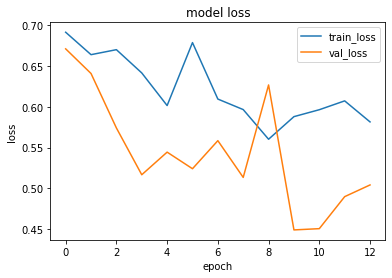

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.45452267]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.53008723]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_2.mov is [[0.54021555]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.37868887]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.353102]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.33659744]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6940 - accuracy: 0.5250 - precision: 0.5417 - recall: 0.3250 - val_loss: 0.7329 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.7080 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6735 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6740 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.6443 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6683 - accuracy: 0.6125 - precision: 0.7368 - recall: 0.3500 - val_loss: 0.5954 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75


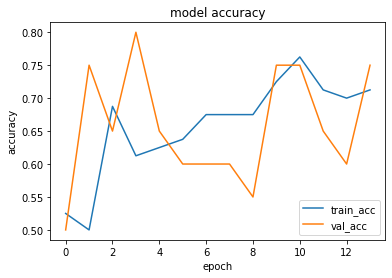

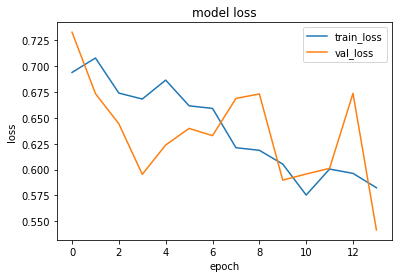

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.31603974]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.5039605]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.51285565]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.29664546]]


1it [00:00, 13662.23it/s]


prediction for video control_2.mov is [[0.29250586]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.29303873]]


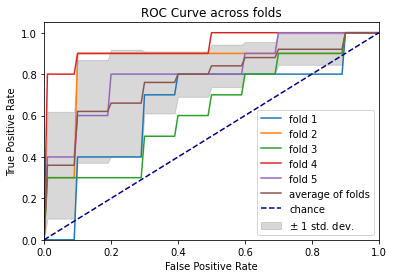

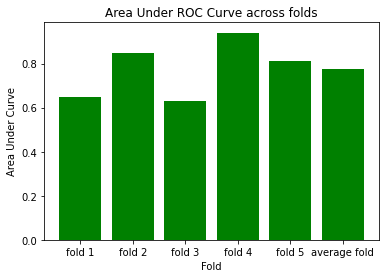

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6908 - accuracy: 0.5375 - precision: 0.6364 - recall: 0.1750 - val_loss: 0.7044 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6505 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.9330 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6612 - accuracy: 0.6625 - precision: 0.6000 - recall: 0.9750 - val_loss: 0.7691 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6084 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.7962 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 133ms/step 

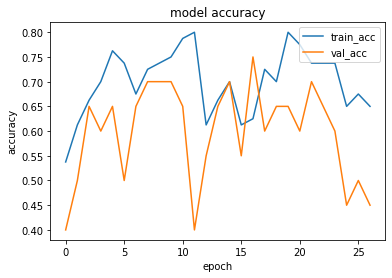

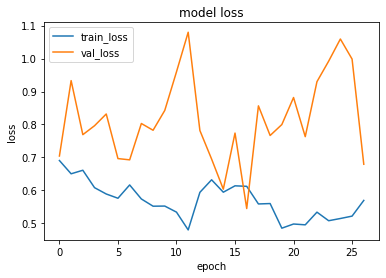

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5988934]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.6614295]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.63609695]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.5544914]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.52813494]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.52368855]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7069 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6690 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6805 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6366 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6749 - accuracy: 0.5250 - precision: 0.5556 - recall: 0.2500 - val_loss: 0.5951 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6529 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.4938 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 5/75


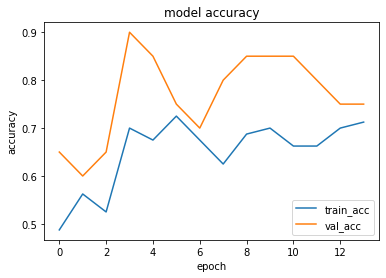

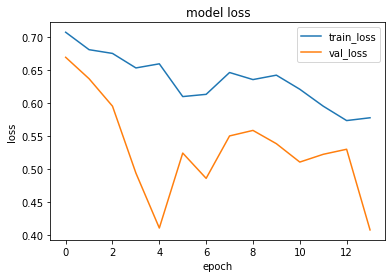

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.4476225]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.68411946]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.67905486]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.34312242]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.3183073]]


1it [00:00, 11881.88it/s]


prediction for video control_3.mov is [[0.34182143]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6890 - accuracy: 0.6000 - precision: 0.6053 - recall: 0.5750 - val_loss: 0.6223 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6636 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.7065 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6814 - accuracy: 0.5375 - precision: 0.5195 - recall: 1.0000 - val_loss: 0.6484 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 185ms/step - loss: 0.6683 - accuracy: 0.6250 - precision: 0.6562 - recall: 0.5250 - val_loss: 0.6516 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


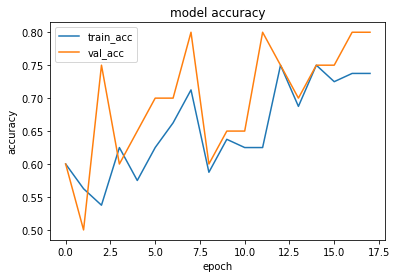

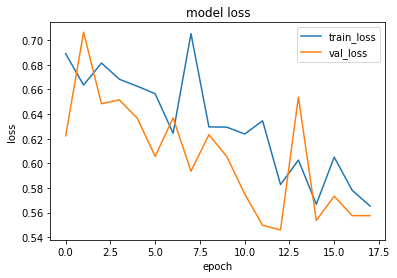

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.5523797]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.65000665]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.6565597]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.39763772]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.35776785]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.38699502]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7013 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4250 - val_loss: 0.6882 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6368 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.9397 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.8140 - accuracy: 0.6000 - precision: 0.6667 - recall: 0.4000 - val_loss: 0.9975 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.7884 - accuracy: 0.6250 - precision: 0.5806 - recall: 0.9000 - val_loss: 0.6697 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epo

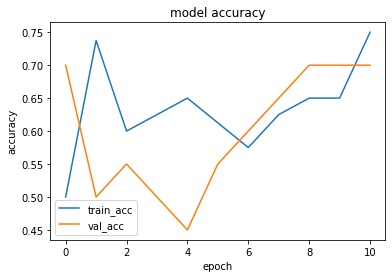

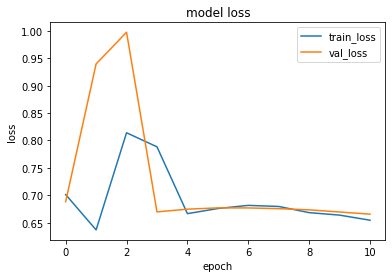

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5048307]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.5147082]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.52814084]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.49253362]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.4889419]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.4873029]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6715 - accuracy: 0.5625 - precision: 0.5532 - recall: 0.6500 - val_loss: 0.7099 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6525 - accuracy: 0.7000 - precision: 0.6290 - recall: 0.9750 - val_loss: 0.6833 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6558 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6858 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6382 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.6537 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3

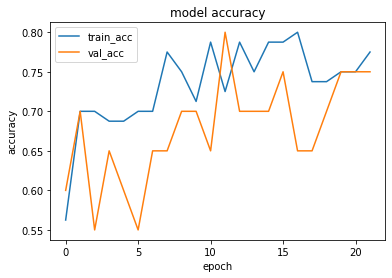

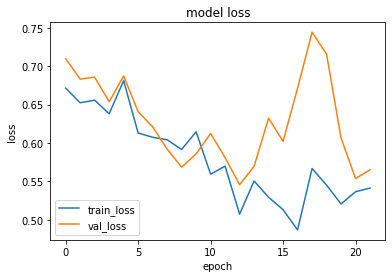

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.35056722]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.57186395]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.5828449]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.23478633]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.21163282]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.20938823]]


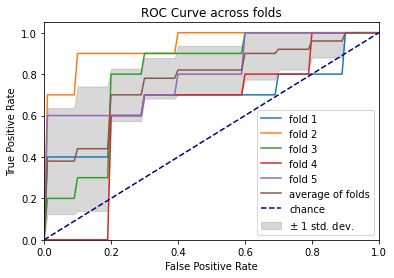

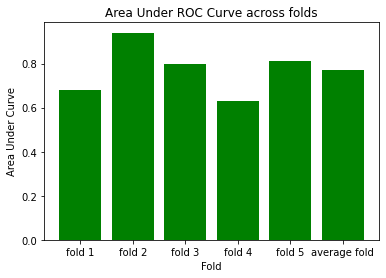

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6937 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.6571 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6679 - accuracy: 0.5875 - precision: 0.7333 - recall: 0.2750 - val_loss: 0.6238 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6146 - accuracy: 0.8000 - precision: 0.8158 - recall: 0.7750 - val_loss: 0.5990 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6209 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6571 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 120ms/step 

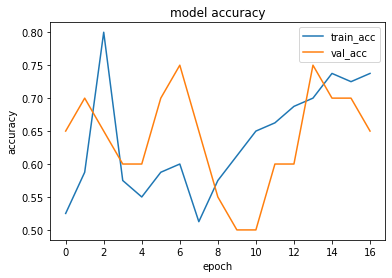

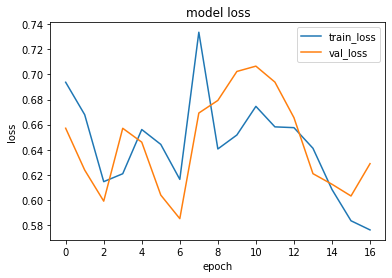

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.36877504]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.45930526]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.49518764]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.30822185]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.28677988]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.29159528]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 132ms/step - loss: 0.7066 - accuracy: 0.4000 - precision: 0.3947 - recall: 0.3750 - val_loss: 0.6834 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6777 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.6562 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6288 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6890 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.7017 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6350 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75


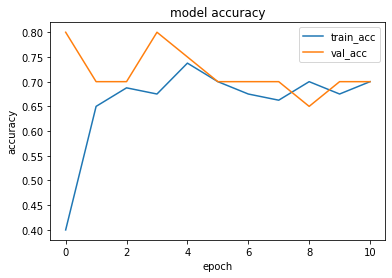

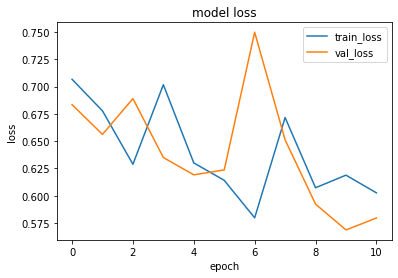

1it [00:00, 11881.88it/s]


prediction for video armflapping_1.mov is [[0.4898843]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.51721513]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.53362143]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.41392684]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.3803947]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.37428364]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6934 - accuracy: 0.4500 - precision: 0.4565 - recall: 0.5250 - val_loss: 0.6464 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6654 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.6132 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6609 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6330 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6497 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5927 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75


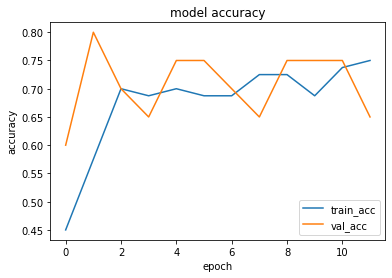

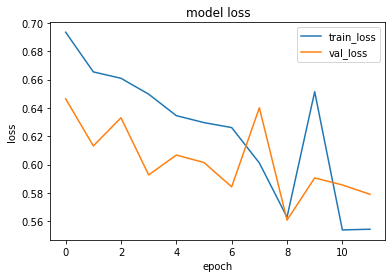

1it [00:00, 11748.75it/s]


prediction for video armflapping_1.mov is [[0.28257254]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.4341487]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.36954385]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.26249072]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.25866574]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.2575253]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6887 - accuracy: 0.5375 - precision: 0.5246 - recall: 0.8000 - val_loss: 0.6750 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6495 - accuracy: 0.6250 - precision: 0.6316 - recall: 0.6000 - val_loss: 0.6641 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6737 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6654 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6460 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6775 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75
3

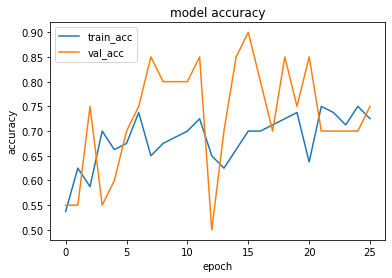

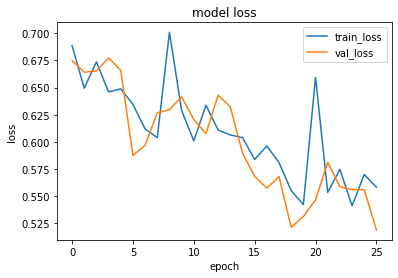

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.37030056]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.5642075]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.5330645]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.24645123]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.22597599]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.23882249]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6917 - accuracy: 0.5375 - precision: 0.5600 - recall: 0.3500 - val_loss: 0.6925 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6882 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.6835 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6506 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.6818 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6716 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 0.6843 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 5/75


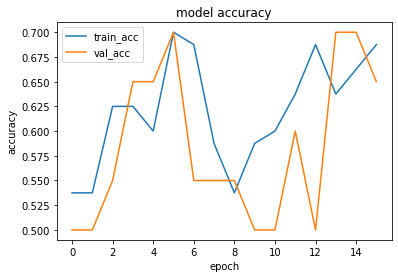

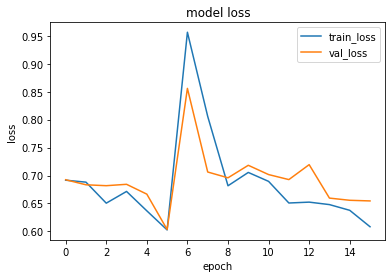

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.371189]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.47096962]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.46050748]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.33201844]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.3195598]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.31158927]]


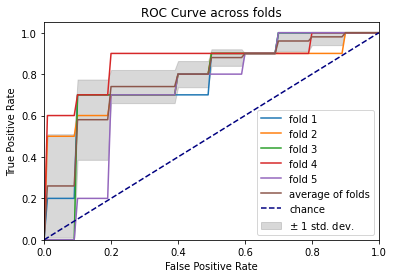

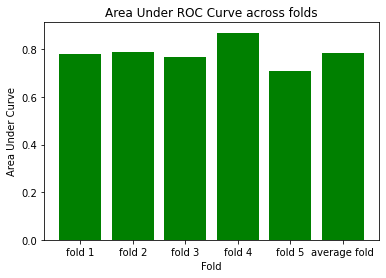

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6930 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6664 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6397 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.6589 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7590 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.7235 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6751 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.7442 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 118ms/step 

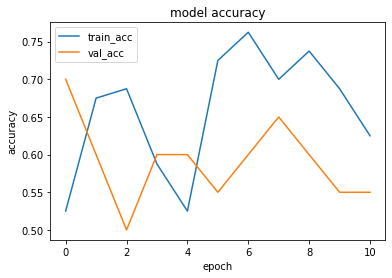

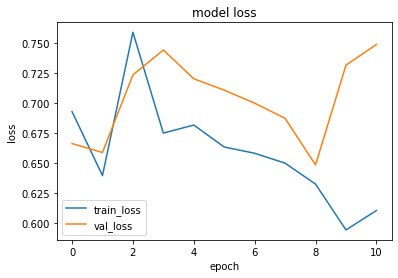

1it [00:00, 11915.64it/s]


prediction for video armflapping_1.mov is [[0.42767423]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.53860027]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.58822566]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.0795449]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.05490035]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.24463317]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6962 - accuracy: 0.4875 - precision: 0.4872 - recall: 0.4750 - val_loss: 0.6570 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6684 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.7081 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6982 - accuracy: 0.5750 - precision: 0.5536 - recall: 0.7750 - val_loss: 0.7435 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6995 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.6430 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75


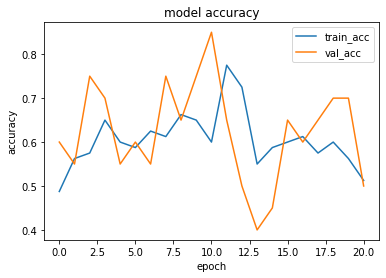

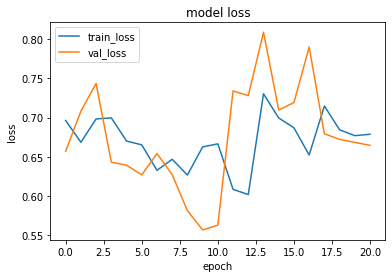

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5027376]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.55630714]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.5309944]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.5014509]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.50008285]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.49996316]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6885 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7250 - val_loss: 0.6490 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6521 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.5626 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6253 - accuracy: 0.6375 - precision: 0.6486 - recall: 0.6000 - val_loss: 0.6277 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6406 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.7251 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75


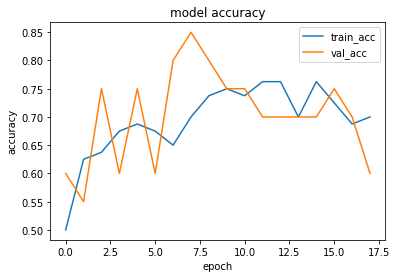

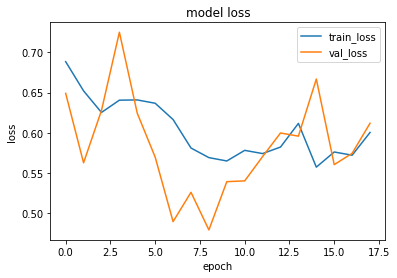

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.33210808]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.40783373]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.40462255]]


1it [00:00, 18893.26it/s]


prediction for video control_1.mov is [[0.30588996]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.29990652]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.2974186]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6978 - accuracy: 0.5500 - precision: 0.5417 - recall: 0.6500 - val_loss: 0.6845 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6586 - accuracy: 0.6125 - precision: 0.5918 - recall: 0.7250 - val_loss: 0.8922 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7340 - accuracy: 0.5125 - precision: 0.5094 - recall: 0.6750 - val_loss: 0.6746 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6464 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6859 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75
3

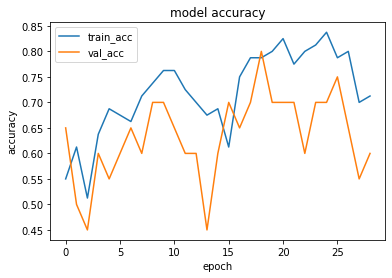

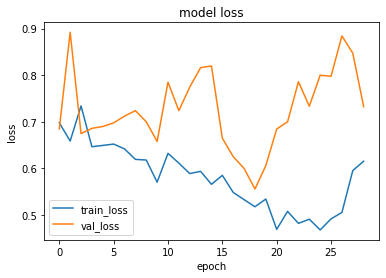

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.4651932]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.6203984]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.5381465]]


1it [00:00, 13231.24it/s]


prediction for video control_1.mov is [[0.43409038]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.42649612]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.42340723]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 169ms/step - loss: 0.6974 - accuracy: 0.4875 - precision: 0.4923 - recall: 0.8000 - val_loss: 0.6802 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6806 - accuracy: 0.5625 - precision: 0.6471 - recall: 0.2750 - val_loss: 0.6743 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6501 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.7235 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6670 - accuracy: 0.5875 - precision: 0.5660 - recall: 0.7500 - val_loss: 0.6364 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 5/75


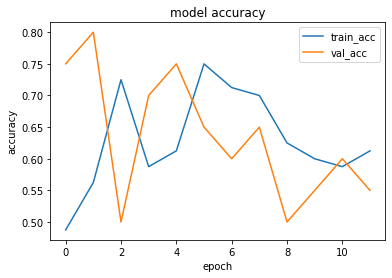

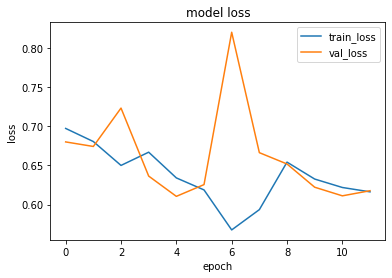

1it [00:00, 12336.19it/s]


prediction for video armflapping_1.mov is [[0.5373469]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.5905318]]


1it [00:00, 13189.64it/s]


prediction for video armflapping_2.mov is [[0.5660304]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.52403426]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.5214056]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.52039593]]


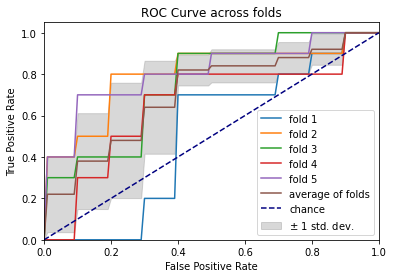

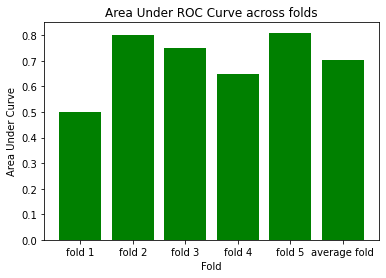

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6934 - accuracy: 0.5250 - precision: 0.5714 - recall: 0.2000 - val_loss: 0.6700 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6445 - accuracy: 0.5625 - precision: 0.5352 - recall: 0.9500 - val_loss: 0.8066 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6467 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.6646 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6636 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.6630 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 168ms/step 

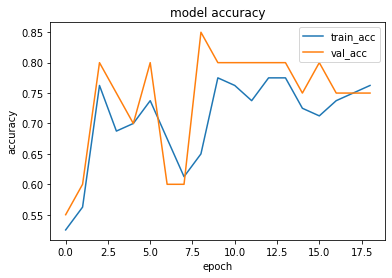

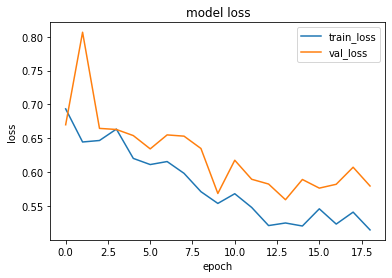

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.48884568]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.5241879]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.5448736]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.40756902]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.3780461]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.35765398]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6990 - accuracy: 0.4125 - precision: 0.2667 - recall: 0.1000 - val_loss: 0.7076 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6921 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.7023 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 121ms/step - loss: 0.6793 - accuracy: 0.6500 - precision: 0.7000 - recall: 0.5250 - val_loss: 0.6723 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 187ms/step - loss: 0.6593 - accuracy: 0.7000 - precision: 0.8077 - recall: 0.5250 - val_loss: 0.6686 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 5/75


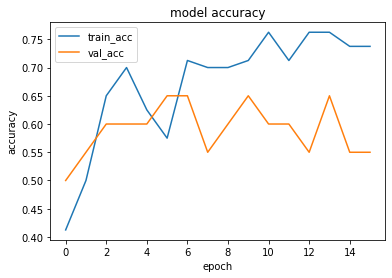

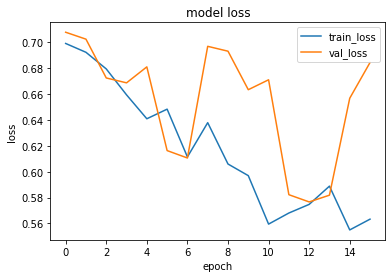

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.40476057]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.4945233]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.47931144]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.362624]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.34796113]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.34696093]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6833 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5000 - val_loss: 0.6906 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 120ms/step - loss: 0.6764 - accuracy: 0.5875 - precision: 0.5493 - recall: 0.9750 - val_loss: 0.6673 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 119ms/step - loss: 0.6172 - accuracy: 0.6875 - precision: 0.6230 - recall: 0.9500 - val_loss: 0.7960 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 120ms/step - loss: 1.0239 - accuracy: 0.5875 - precision: 0.6842 - recall: 0.3250 - val_loss: 0.8787 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 5/75


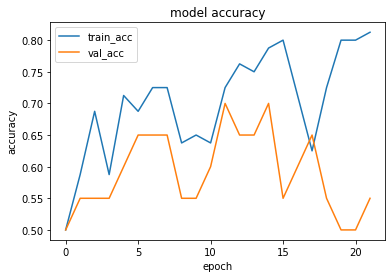

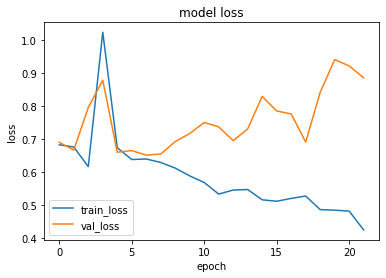

1it [00:00, 12052.60it/s]


prediction for video armflapping_1.mov is [[0.3496366]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.60011303]]


1it [00:00, 13400.33it/s]


prediction for video armflapping_2.mov is [[0.69156754]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.21546617]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.1878928]]


1it [00:00, 11491.24it/s]


prediction for video control_3.mov is [[0.19484717]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6917 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.6622 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 117ms/step - loss: 0.6718 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6491 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6698 - accuracy: 0.6000 - precision: 0.6429 - recall: 0.4500 - val_loss: 0.6028 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6504 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6150 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 5/75


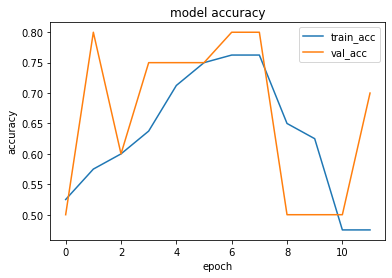

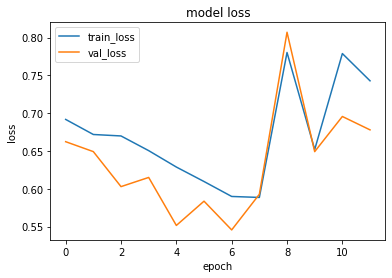

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.26627773]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.47505334]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.26812625]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.44698742]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.4461107]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.2659599]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7214 - accuracy: 0.4750 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6798 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6957 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6688 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 118ms/step - loss: 0.6880 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6484 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6703 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.5538 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoc

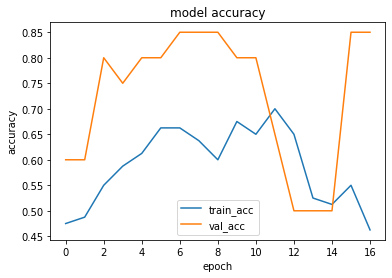

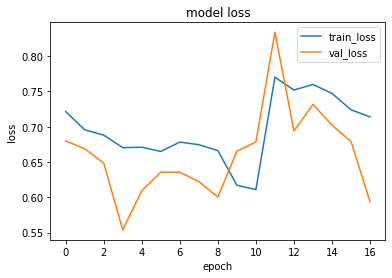

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.492023]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.49043]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.49075145]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.49604118]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.49305415]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.4971755]]


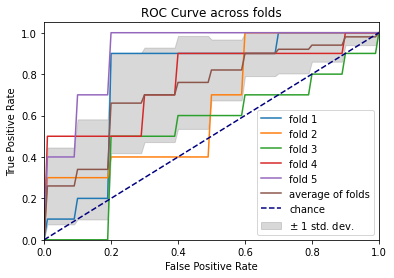

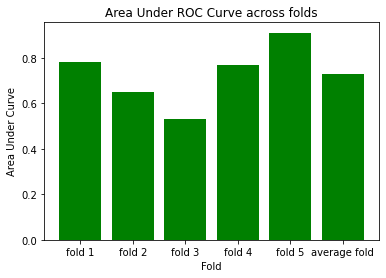

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 228ms/step - loss: 0.6969 - accuracy: 0.4375 - precision: 0.3077 - recall: 0.1000 - val_loss: 0.6666 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6791 - accuracy: 0.6125 - precision: 0.5634 - recall: 1.0000 - val_loss: 0.5878 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6397 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.5787 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6392 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5587 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 123ms/step 

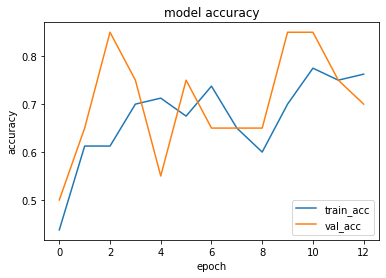

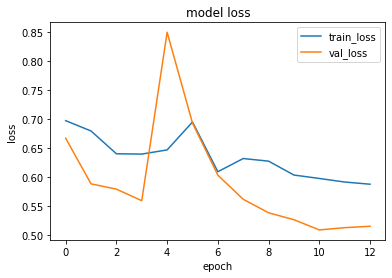

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.25072867]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.31907332]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.2685059]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.24457595]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.24209672]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.24168772]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7173 - accuracy: 0.3500 - precision: 0.1250 - recall: 0.0500 - val_loss: 0.7140 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6785 - accuracy: 0.4750 - precision: 0.4286 - recall: 0.1500 - val_loss: 0.7146 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6605 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.7295 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6244 - accuracy: 0.6500 - precision: 0.5938 - recall: 0.9500 - val_loss: 0.7088 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

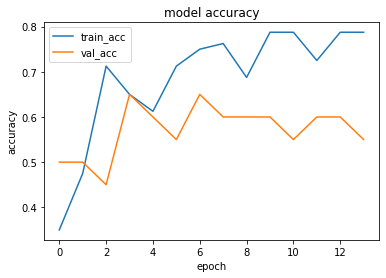

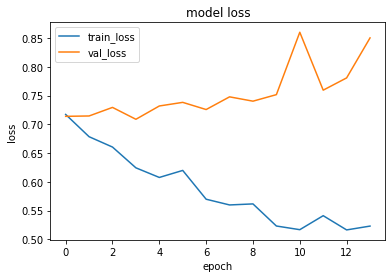

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.48305467]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.64062124]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_2.mov is [[0.72967446]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.18325734]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.142378]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.18473506]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 1s 165ms/step - loss: 0.6862 - accuracy: 0.4625 - precision: 0.4694 - recall: 0.5750 - val_loss: 0.7786 - val_accuracy: 0.3500 - val_precision: 0.4118 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5907 - accuracy: 0.6250 - precision: 0.5781 - recall: 0.9250 - val_loss: 1.0965 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 158ms/step - loss: 1.3301 - accuracy: 0.5875 - precision: 0.8182 - recall: 0.2250 - val_loss: 1.1831 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/75
3/3 [==============================] - 0s 156ms/step - loss: 1.0063 - accuracy: 0.5000 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.7017 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall

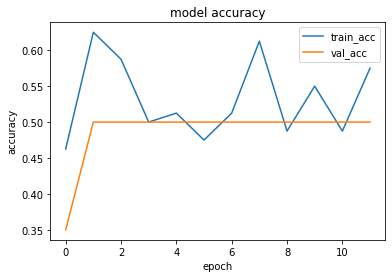

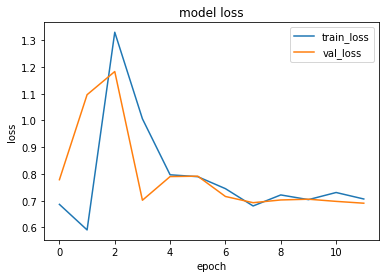

1it [00:00, 16448.25it/s]


prediction for video armflapping_1.mov is [[0.5077855]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.49042302]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.5076165]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.50775814]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.5077522]]


1it [00:00, 11618.57it/s]


prediction for video control_3.mov is [[0.50775206]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6856 - accuracy: 0.6375 - precision: 0.6410 - recall: 0.6250 - val_loss: 0.6477 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7607 - accuracy: 0.6000 - precision: 0.5741 - recall: 0.7750 - val_loss: 0.6335 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6448 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6930 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6580 - accuracy: 0.6125 - precision: 0.5789 - recall: 0.8250 - val_loss: 0.6916 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 5/75


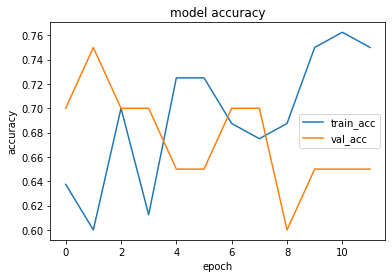

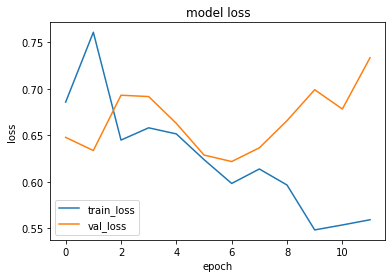

1it [00:00, 12787.51it/s]


prediction for video armflapping_1.mov is [[0.5229173]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.6166752]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6166269]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.39649612]]


1it [00:00, 12483.05it/s]


prediction for video control_2.mov is [[0.33341354]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.34468055]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6930 - accuracy: 0.4125 - precision: 0.4386 - recall: 0.6250 - val_loss: 0.6247 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 122ms/step - loss: 0.6696 - accuracy: 0.5500 - precision: 0.5526 - recall: 0.5250 - val_loss: 0.6341 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 124ms/step - loss: 0.6685 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6375 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6759 - accuracy: 0.5750 - precision: 0.5536 - recall: 0.7750 - val_loss: 0.6376 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75


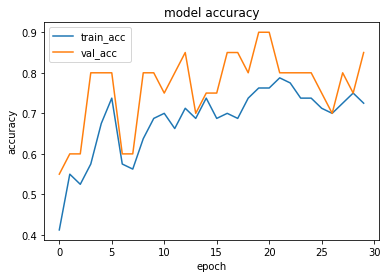

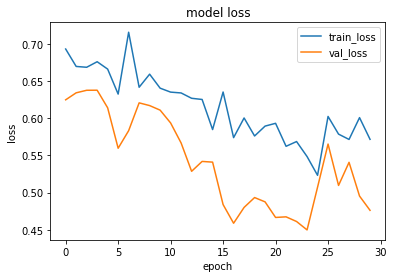

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.4705608]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5901626]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.5943146]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.36210567]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.3313744]]


1it [00:00, 12671.61it/s]


prediction for video control_3.mov is [[0.34140277]]


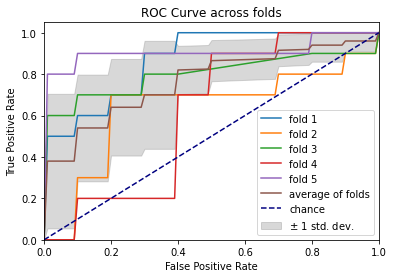

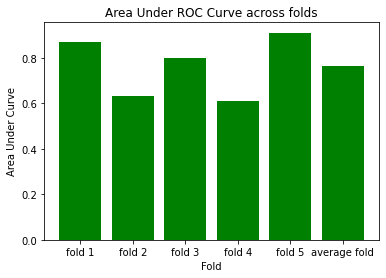

(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 179ms/step - loss: 0.6908 - accuracy: 0.5375 - precision: 0.5254 - recall: 0.7750 - val_loss: 0.6423 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6630 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.6559 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6500 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6433 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.7158 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.6147 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 143ms/step 

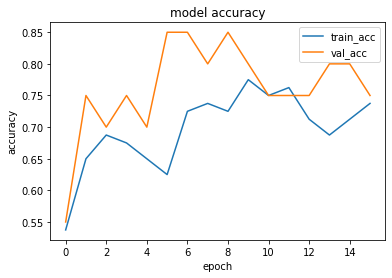

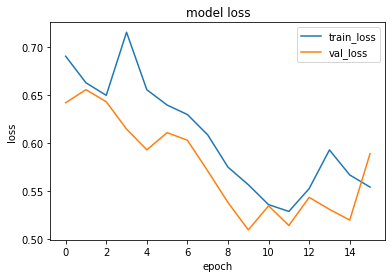

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.43513834]]


1it [00:00, 11335.96it/s]


prediction for video armflapping_3.mov is [[0.5428766]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.5302267]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.38092673]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.3724789]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.36245972]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6954 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4000 - val_loss: 0.7306 - val_accuracy: 0.4000 - val_precision: 0.3750 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.6660 - accuracy: 0.5125 - precision: 0.5091 - recall: 0.7000 - val_loss: 0.7661 - val_accuracy: 0.4000 - val_precision: 0.4375 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6705 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.7168 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 123ms/step - loss: 0.6261 - accuracy: 0.6125 - precision: 0.5652 - recall: 0.9750 - val_loss: 0.7127 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 5/75


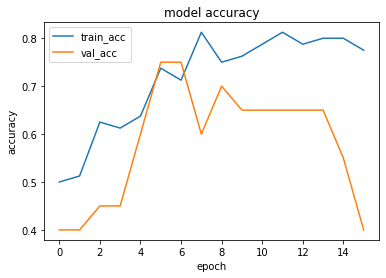

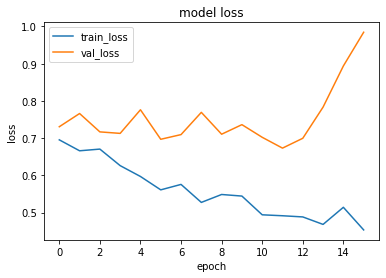

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.6802923]]


1it [00:00, 10837.99it/s]


prediction for video armflapping_3.mov is [[0.38375205]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6280029]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.37460107]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.26221162]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.25276345]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6843 - accuracy: 0.5250 - precision: 0.5192 - recall: 0.6750 - val_loss: 0.6029 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6576 - accuracy: 0.5750 - precision: 0.6000 - recall: 0.4500 - val_loss: 0.6493 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6413 - accuracy: 0.7000 - precision: 0.7857 - recall: 0.5500 - val_loss: 0.6163 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6498 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.6645 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 5/75


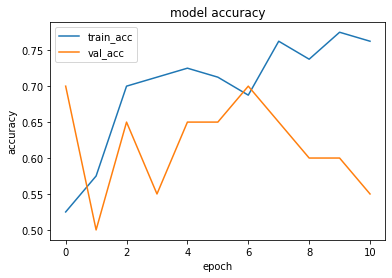

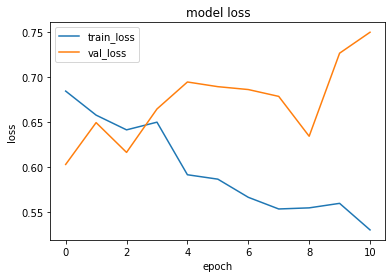

1it [00:00, 11881.88it/s]


prediction for video armflapping_1.mov is [[0.467296]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.5423323]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.51609844]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.41676718]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.382289]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.38540888]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7091 - accuracy: 0.4750 - precision: 0.4821 - recall: 0.6750 - val_loss: 0.6743 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6791 - accuracy: 0.5375 - precision: 0.5333 - recall: 0.6000 - val_loss: 0.6410 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6608 - accuracy: 0.6125 - precision: 0.6667 - recall: 0.4500 - val_loss: 0.5827 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6464 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6294 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75


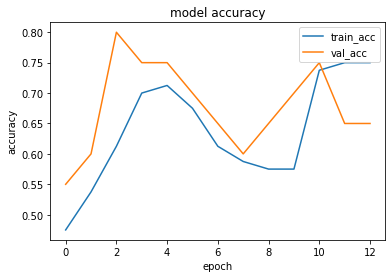

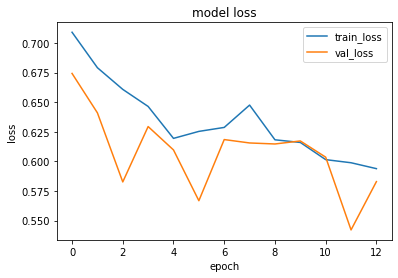

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.41477266]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.46013528]]


1it [00:00, 11618.57it/s]


prediction for video armflapping_2.mov is [[0.48143327]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.3765985]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.3616397]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.35781598]]
(40, 90, 6) (40, 90, 6)
(10, 90, 6) (10, 90, 6)
Epoch 1/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6805 - accuracy: 0.6125 - precision: 0.6286 - recall: 0.5500 - val_loss: 0.6756 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6658 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.6780 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6458 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6539 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 186ms/step - loss: 0.6177 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6927 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 5/75


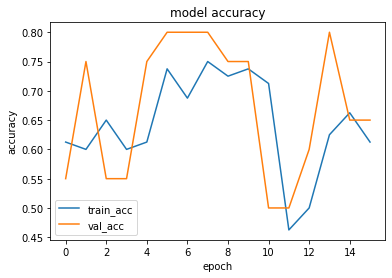

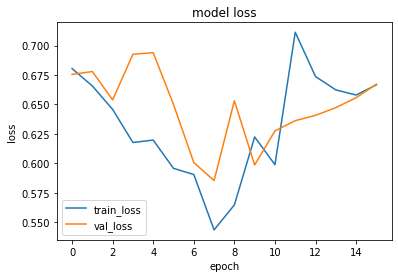

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.4564523]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.5687519]]


1it [00:00, 11244.78it/s]


prediction for video armflapping_2.mov is [[0.49273002]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.4621047]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.47509375]]


1it [00:00, 9892.23it/s]


prediction for video control_3.mov is [[0.4743849]]


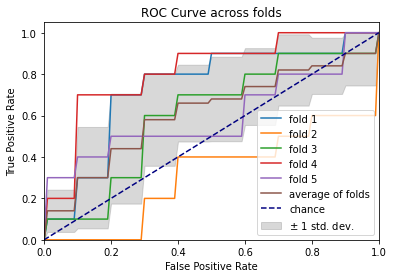

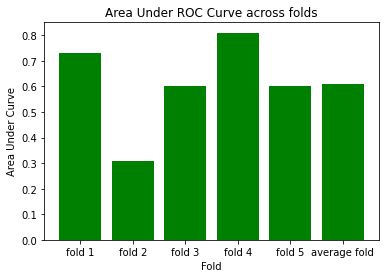

In [23]:
for seed in SEEDS:
    """ the only problem with this is that it's a basically 100 seed loop, which will take around 500 minutes of running"""
    np.random.seed(seed) # set seed 
    
    # first sort all of the folds 
    N = np.random.permutation(ARMFLAPPING_FRAMES.shape[0])
    ARMFLAPPING_FRAMES = ARMFLAPPING_FRAMES[N]
    CONTROL_FRAMES = CONTROL_FRAMES[N]

    # split them into 5 folds 
    ARMFLAPPING_FRAMES_SPLIT = np.array_split(ARMFLAPPING_FRAMES, 5)
    CONTROL_FRAMES_SPLIT = np.array_split(CONTROL_FRAMES, 5)

    # then run them 5x 
    checkpoint = tf.keras.callbacks.ModelCheckpoint("best.h5", save_best_only=True, monitor = "val_accuracy")
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor = "val_accuracy", patience=10)
    cross_validate(make_model, epochs = 75, callbacks=[checkpoint, early_stopping]) 

In [24]:
with open("mean_landmark_hundred_seeds_results", 'wb') as f: 
    pickle.dump((META_RESULT_MATRIX, AVERAGE_AUROCS, AVERAGE_TPRS), f)

In [25]:
import pickle, numpy as np
with open("mean_landmark_hundred_seeds_results", 'rb') as f: 
 (META_RESULT_MATRIX, AVERAGE_AUROCS, AVERAGE_TPRS) = pickle.load(f)

In [26]:
META_RESULT_MATRIX = np.array(META_RESULT_MATRIX)
np.mean(META_RESULT_MATRIX, axis=0) # yoo the results for one hundred landmarks do be completely ass 

array([0.691625  , 0.70388215, 0.70555   , 0.68865693, 0.6553    ,
       0.6667072 , 0.669     , 0.64216033])

In [27]:
for i in range(8): 
    print(np.mean(META_RESULT_MATRIX[:, i], axis=0), np.std(META_RESULT_MATRIX[:, i], axis=0))

0.6916249988079071 0.08706059367967703
0.703882148861885 0.11255035862916218
0.7055500005707145 0.16353271119057616
0.6886569273963126 0.11317403979074657
0.6552999995946884 0.10754956874515013
0.6667072045207023 0.17465849864512945
0.6690000022500754 0.22666935817468828
0.6421603343201607 0.15897747876607646


In [28]:
METRICS = []
for fold_results in np.array_split(META_RESULT_MATRIX, 100):
    METRICS.append(np.mean(fold_results, axis = 0)) 

METRICS = np.around(np.array(METRICS), 10)
print(METRICS)

print(f"training accuracy : {np.mean(METRICS[:, 0])} +/- {np.std(METRICS[:, 0])}")
print(f"training precision : {np.mean(METRICS[:, 1])} +/- {np.std(METRICS[:, 1])}")
print(f"training recall : {np.mean(METRICS[:, 2])} +/- {np.std(METRICS[:, 2])}")
print(f"training f1 : {np.mean(METRICS[:, 3])} +/- {np.std(METRICS[:, 3])}")
print(f"validation accuracy : {np.mean(METRICS[:, 4])} +/- {np.std(METRICS[:, 4])}")
print(f"validation precision : {np.mean(METRICS[:, 5])} +/- {np.std(METRICS[:, 5])}")
print(f"validation recall : {np.mean(METRICS[:, 6])} +/- {np.std(METRICS[:, 6])}")
print(f"validation f1 : {np.mean(METRICS[:, 7])} +/- {np.std(METRICS[:, 7])}")

[[0.68499999 0.73442785 0.56000001 0.60152507 0.59999999 0.52949495
  0.46       0.48570171]
 [0.6175     0.60621107 0.72000001 0.62813718 0.56999999 0.55843047
  0.72       0.61841953]
 [0.63000001 0.61666858 0.79       0.67955261 0.59999999 0.59822022
  0.72       0.64570383]
 [0.69749999 0.69394197 0.705      0.68661582 0.65999999 0.68606062
  0.62000001 0.6386967 ]
 [0.725      0.73129516 0.755      0.73367307 0.66       0.75761906
  0.54000001 0.58051279]
 [0.7225     0.75603957 0.715      0.72221506 0.61000001 0.68739178
  0.6        0.57179483]
 [0.7525     0.75896908 0.75       0.75113279 0.64       0.65822512
  0.64000001 0.62415125]
 [0.66999999 0.65497421 0.75000001 0.68910089 0.68000001 0.69199347
  0.72       0.69165334]
 [0.73249998 0.74705021 0.7        0.71789793 0.73000001 0.76742425
  0.68000001 0.71896403]
 [0.69499999 0.72844383 0.68       0.68173043 0.63000001 0.64184437
  0.69999999 0.64703854]
 [0.7025     0.72563182 0.695      0.69618698 0.66999999 0.71280277
  

In [14]:
# create plots of evreything 

training_acc = np.mean(META_RESULT_MATRIX[:, 0], axis=0)

labels = ['Accuracy', "Precision", "Recall", "F1"]

x = np.arange(len(labels))  # the label locations
width = 0.4  # the width of the bars

fig, ax = plt.subplots()
fig.set_size_inches(7, 6)
rects1 = ax.bar(x - width/2, [training_acc, training_precision, training_recall, training_f1], width, label='Training', color = "tab:blue")
rects2 = ax.bar(x + width/2, [validation_acc, validation_precision, validation_recall, validation_f1], width, label='Validation', color="tab:green")

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Metric')
if FOLD_NUMBER != 5: 
    ax.set_title(f"Training vs. Testing Metrics: Fold {FOLD_NUMBER + 1} (No Aug)")
else: 
    ax.set_title("Training vs. Testing Metrics All Folds (No Aug)")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend(loc="upper right")

array([[0.80000001, 0.80000001, 0.80000001, 0.80000001, 0.60000002,
        0.60000002, 0.60000002, 0.60000002],
       [0.77499998, 0.76190478, 0.80000001, 0.78048782, 0.64999998,
        0.66666669, 0.60000002, 0.63157897],
       [0.75      , 0.72727275, 0.80000001, 0.76190478, 0.69999999,
        0.69999999, 0.69999999, 0.69999999],
       [0.85000002, 0.8888889 , 0.80000001, 0.84210527, 0.69999999,
        0.69999999, 0.69999999, 0.69999999],
       [0.72500002, 0.72500002, 0.72500002, 0.72500002, 0.85000002,
        0.81818181, 0.89999998, 0.85714284]])

0.7636873058008137


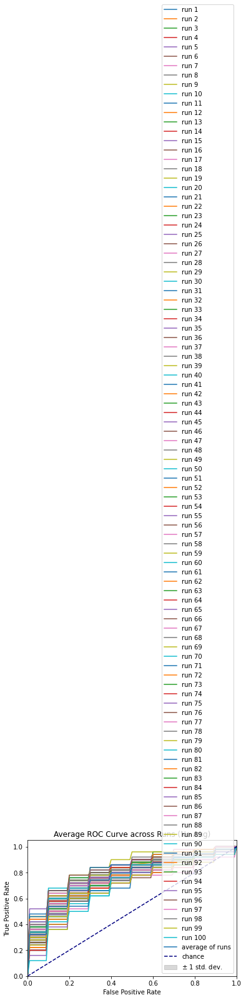

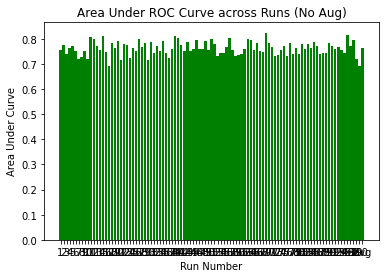

In [39]:
# REEE RUN THIS STUFF 
plot_meta_roc_auroc(AVERAGE_AUROCS, AVERAGE_TPRS, np.linspace(0, 1, 101)) # save the images here 

In [40]:
np.mean(AVERAGE_AUROCS), np.std(AVERAGE_AUROCS)

(0.76189, 0.026550118867552906)

In [41]:
def interpret(metrics_string):
     metrics = []
     for i in range(len(metrics_string)):
         try:
             index = metrics_string.index(":")
             metrics.append(metrics_string[index + 2 : index + 8])
             metrics_string = metrics_string[index + 9:]
         except Exception as e:
             return [float(m) for m in metrics][1:]

In [42]:
METRICS = [] # training acc, training pres, training recall, validation acc, validation pres, validation recall 

# for all of the 50 runs have a (50, 6 + 2) matrix, and then use that to store data and compute scores 
import numpy as np
meta_results = []
meta_results.append("3/3 [==============================] - 0s 143ms/step - loss: 0.5490 - accuracy: 0.7625 - precision_127: 0.7692 - recall_127: 0.7500 - val_loss: 0.6196 - val_accuracy: 0.7000 - val_precision_127: 0.6429 - val_recall_127: 0.9000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.5468 - accuracy: 0.7500 - precision_128: 0.7381 - recall_128: 0.7750 - val_loss: 0.4929 - val_accuracy: 0.7500 - val_precision_128: 0.7778 - val_recall_128: 0.7000")
meta_results.append("3/3 [==============================] - 0s 148ms/step - loss: 0.5195 - accuracy: 0.7875 - precision_129: 0.8485 - recall_129: 0.7000 - val_loss: 0.6768 - val_accuracy: 0.6500 - val_precision_129: 0.7143 - val_recall_129: 0.5000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5528 - accuracy: 0.7375 - precision_130: 0.8800 - recall_130: 0.5500 - val_loss: 0.6188 - val_accuracy: 0.7000 - val_precision_130: 0.7500 - val_recall_130: 0.6000")
meta_results.append("3/3 [==============================] - 0s 136ms/step - loss: 0.5276 - accuracy: 0.7500 - precision_131: 0.7500 - recall_131: 0.7500 - val_loss: 0.5546 - val_accuracy: 0.7500 - val_precision_131: 0.7778 - val_recall_131: 0.7000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.3641 - accuracy: 0.8250 - precision_133: 0.9333 - recall_133: 0.7000 - val_loss: 0.8364 - val_accuracy: 0.7000 - val_precision_133: 0.6429 - val_recall_133: 0.9000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.5302 - accuracy: 0.7750 - precision_134: 0.7750 - recall_134: 0.7750 - val_loss: 0.5209 - val_accuracy: 0.8000 - val_precision_134: 0.8000 - val_recall_134: 0.8000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5198 - accuracy: 0.7375 - precision_135: 0.7209 - recall_135: 0.7750 - val_loss: 0.6696 - val_accuracy: 0.5500 - val_precision_135: 0.5714 - val_recall_135: 0.4000")
meta_results.append('3/3 [==============================] - 0s 142ms/step - loss: 0.5037 - accuracy: 0.7875 - precision_136: 0.8108 - recall_136: 0.7500 - val_loss: 0.5018 - val_accuracy: 0.7500 - val_precision_136: 0.7273 - val_recall_136: 0.8000')
meta_results.append("3/3 [==============================] - 0s 128ms/step - loss: 0.6638 - accuracy: 0.6000 - precision_137: 0.6053 - recall_137: 0.5750 - val_loss: 0.6271 - val_accuracy: 0.6000 - val_precision_137: 0.6250 - val_recall_137: 0.5000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4704 - accuracy: 0.7875 - precision_139: 0.8485 - recall_139: 0.7000 - val_loss: 0.6656 - val_accuracy: 0.7000 - val_precision_139: 0.6667 - val_recall_139: 0.8000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.6160 - accuracy: 0.6500 - precision_140: 0.6875 - recall_140: 0.5500 - val_loss: 0.5326 - val_accuracy: 0.8500 - val_precision_140: 0.8182 - val_recall_140: 0.9000")
meta_results.append("3/3 [==============================] - 0s 134ms/step - loss: 0.4795 - accuracy: 0.7625 - precision_141: 0.7838 - recall_141: 0.7250 - val_loss: 0.7107 - val_accuracy: 0.6500 - val_precision_141: 0.8000 - val_recall_141: 0.4000")
meta_results.append("3/3 [==============================] - 0s 121ms/step - loss: 0.5433 - accuracy: 0.7375 - precision_142: 0.9130 - recall_142: 0.5250 - val_loss: 0.5958 - val_accuracy: 0.7000 - val_precision_142: 0.7000 - val_recall_142: 0.7000")
meta_results.append("3/3 [==============================] - 0s 181ms/step - loss: 0.4387 - accuracy: 0.8375 - precision_143: 0.9091 - recall_143: 0.7500 - val_loss: 0.8756 - val_accuracy: 0.7000 - val_precision_143: 0.6429 - val_recall_143: 0.9000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.5071 - accuracy: 0.7750 - precision_145: 0.8235 - recall_145: 0.7000 - val_loss: 0.6108 - val_accuracy: 0.7000 - val_precision_145: 0.6429 - val_recall_145: 0.9000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.4103 - accuracy: 0.7875 - precision_146: 0.7674 - recall_146: 0.8250 - val_loss: 0.6352 - val_accuracy: 0.7500 - val_precision_146: 0.7273 - val_recall_146: 0.8000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5201 - accuracy: 0.7375 - precision_147: 0.8065 - recall_147: 0.6250 - val_loss: 0.7552 - val_accuracy: 0.5500 - val_precision_147: 0.6000 - val_recall_147: 0.3000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4809 - accuracy: 0.7750 - precision_148: 0.7750 - recall_148: 0.7750 - val_loss: 0.5301 - val_accuracy: 0.7500 - val_precision_148: 0.7273 - val_recall_148: 0.8000")
meta_results.append("3/3 [==============================] - 0s 135ms/step - loss: 0.6238 - accuracy: 0.7250 - precision_149: 0.6957 - recall_149: 0.8000 - val_loss: 0.5609 - val_accuracy: 0.7000 - val_precision_149: 0.7500 - val_recall_149: 0.6000")
meta_results.append("3/3 [==============================] - 0s 147ms/step - loss: 0.4444 - accuracy: 0.8125 - precision_151: 0.8571 - recall_151: 0.7500 - val_loss: 0.6537 - val_accuracy: 0.7000 - val_precision_151: 0.6667 - val_recall_151: 0.8000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.4550 - accuracy: 0.8000 - precision_152: 0.7500 - recall_152: 0.9000 - val_loss: 0.6105 - val_accuracy: 0.7500 - val_precision_152: 0.7778 - val_recall_152: 0.7000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.4810 - accuracy: 0.7625 - precision_153: 0.8000 - recall_153: 0.7000 - val_loss: 0.6956 - val_accuracy: 0.6500 - val_precision_153: 0.7143 - val_recall_153: 0.5000")
meta_results.append("3/3 [==============================] - 0s 135ms/step - loss: 0.4951 - accuracy: 0.7625 - precision_154: 0.7692 - recall_154: 0.7500 - val_loss: 0.5621 - val_accuracy: 0.7500 - val_precision_154: 0.7273 - val_recall_154: 0.8000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4192 - accuracy: 0.8250 - precision_155: 0.8421 - recall_155: 0.8000 - val_loss: 0.5144 - val_accuracy: 0.7500 - val_precision_155: 0.7778 - val_recall_155: 0.7000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.5146 - accuracy: 0.7375 - precision_157: 0.7568 - recall_157: 0.7000 - val_loss: 0.6470 - val_accuracy: 0.7000 - val_precision_157: 0.6429 - val_recall_157: 0.9000")
meta_results.append("3/3 [==============================] - 0s 136ms/step - loss: 0.5297 - accuracy: 0.7750 - precision_158: 0.7895 - recall_158: 0.7500 - val_loss: 0.5801 - val_accuracy: 0.7500 - val_precision_158: 0.7778 - val_recall_158: 0.7000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4522 - accuracy: 0.7750 - precision_159: 0.8056 - recall_159: 0.7250 - val_loss: 0.6115 - val_accuracy: 0.6000 - val_precision_159: 0.7500 - val_recall_159: 0.3000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.5559 - accuracy: 0.7250 - precision_160: 0.6957 - recall_160: 0.8000 - val_loss: 0.5596 - val_accuracy: 0.7000 - val_precision_160: 0.6667 - val_recall_160: 0.8000")
meta_results.append("3/3 [==============================] - 0s 175ms/step - loss: 0.5519 - accuracy: 0.7750 - precision_161: 0.8438 - recall_161: 0.6750 - val_loss: 0.5466 - val_accuracy: 0.6500 - val_precision_161: 0.7143 - val_recall_161: 0.5000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4980 - accuracy: 0.7750 - precision_163: 0.8235 - recall_163: 0.7000 - val_loss: 0.6757 - val_accuracy: 0.6500 - val_precision_163: 0.6154 - val_recall_163: 0.8000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4898 - accuracy: 0.7750 - precision_164: 0.7895 - recall_164: 0.7500 - val_loss: 0.6056 - val_accuracy: 0.7000 - val_precision_164: 0.7000 - val_recall_164: 0.7000")
meta_results.append("3/3 [==============================] - 0s 181ms/step - loss: 0.5320 - accuracy: 0.7375 - precision_165: 0.7209 - recall_165: 0.7750 - val_loss: 0.7340 - val_accuracy: 0.6500 - val_precision_165: 0.6364 - val_recall_165: 0.7000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4484 - accuracy: 0.7750 - precision_166: 0.7895 - recall_166: 0.7500 - val_loss: 0.5302 - val_accuracy: 0.7500 - val_precision_166: 0.7273 - val_recall_166: 0.8000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.6792 - accuracy: 0.6750 - precision_167: 0.6522 - recall_167: 0.7500 - val_loss: 0.6917 - val_accuracy: 0.5500 - val_precision_167: 0.5556 - val_recall_167: 0.5000")
meta_results.append("3/3 [==============================] - 0s 128ms/step - loss: 0.4365 - accuracy: 0.8125 - precision_169: 0.8788 - recall_169: 0.7250 - val_loss: 0.7150 - val_accuracy: 0.6500 - val_precision_169: 0.6364 - val_recall_169: 0.7000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5207 - accuracy: 0.7750 - precision_170: 0.7750 - recall_170: 0.7750 - val_loss: 0.5656 - val_accuracy: 0.7500 - val_precision_170: 0.7778 - val_recall_170: 0.7000")
meta_results.append("3/3 [==============================] - 0s 131ms/step - loss: 0.4846 - accuracy: 0.7625 - precision_171: 0.7692 - recall_171: 0.7500 - val_loss: 0.7023 - val_accuracy: 0.6500 - val_precision_171: 0.6667 - val_recall_171: 0.6000")
meta_results.append("3/3 [==============================] - 0s 129ms/step - loss: 0.4192 - accuracy: 0.8250 - precision_172: 0.8824 - recall_172: 0.7500 - val_loss: 0.8445 - val_accuracy: 0.7000 - val_precision_172: 0.7500 - val_recall_172: 0.6000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.6846 - accuracy: 0.5750 - precision_173: 0.5682 - recall_173: 0.6250 - val_loss: 0.6460 - val_accuracy: 0.6000 - val_precision_173: 0.6250 - val_recall_173: 0.5000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.4731 - accuracy: 0.7625 - precision_175: 0.7838 - recall_175: 0.7250 - val_loss: 0.6003 - val_accuracy: 0.7500 - val_precision_175: 0.6923 - val_recall_175: 0.9000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.6343 - accuracy: 0.6875 - precision_176: 0.6744 - recall_176: 0.7250 - val_loss: 0.6167 - val_accuracy: 0.7000 - val_precision_176: 1.0000 - val_recall_176: 0.4000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.6491 - accuracy: 0.5875 - precision_177: 0.6061 - recall_177: 0.5000 - val_loss: 0.6270 - val_accuracy: 0.6000 - val_precision_177: 1.0000 - val_recall_177: 0.2000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.4416 - accuracy: 0.8000 - precision_178: 0.8333 - recall_178: 0.7500 - val_loss: 0.6544 - val_accuracy: 0.6500 - val_precision_178: 0.7143 - val_recall_178: 0.5000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4658 - accuracy: 0.8125 - precision_179: 0.9032 - recall_179: 0.7000 - val_loss: 0.6116 - val_accuracy: 0.7500 - val_precision_179: 0.7778 - val_recall_179: 0.7000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.4735 - accuracy: 0.8000 - precision_181: 0.8750 - recall_181: 0.7000 - val_loss: 0.6479 - val_accuracy: 0.6500 - val_precision_181: 0.6667 - val_recall_181: 0.6000")
meta_results.append("3/3 [==============================] - 0s 153ms/step - loss: 0.5056 - accuracy: 0.7750 - precision_182: 0.7895 - recall_182: 0.7500 - val_loss: 0.4801 - val_accuracy: 0.7500 - val_precision_182: 0.7778 - val_recall_182: 0.7000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.4631 - accuracy: 0.8000 - precision_183: 0.8000 - recall_183: 0.8000 - val_loss: 0.7841 - val_accuracy: 0.5000 - val_precision_183: 0.5000 - val_recall_183: 0.3000")
meta_results.append("3/3 [==============================] - 0s 129ms/step - loss: 0.4344 - accuracy: 0.8500 - precision_184: 0.8684 - recall_184: 0.8250 - val_loss: 0.6026 - val_accuracy: 0.7000 - val_precision_184: 0.6667 - val_recall_184: 0.8000")
meta_results.append("3/3 [==============================] - 0s 135ms/step - loss: 0.5167 - accuracy: 0.7375 - precision_185: 0.7111 - recall_185: 0.8000 - val_loss: 0.5716 - val_accuracy: 0.7000 - val_precision_185: 0.7500 - val_recall_185: 0.6000")

METRICS = [interpret(result) for result in meta_results]

In [43]:
METRICS = np.array(METRICS)

METRICS = np.delete(METRICS, obj=3, axis=1)
METRICS.shape

(50, 6)

In [44]:
train_acc = METRICS[:, 0]
train_pres = METRICS[:, 1]
train_recall = METRICS[:, 2]
val_acc = METRICS[:, 3]
val_pres = METRICS[:, 4]
val_recall = METRICS[:, 5]

print(f"training accuracy : {round(train_acc.mean(), 3)} ± {round(train_acc.std(), 3)}")
print(f"training precision : {round(train_pres.mean(), 3)} ± {round(train_pres.std(), 3)}")
print(f"training recall : {round(train_recall.mean(), 3)} ± {round(train_recall.std(), 3)}")
print(f"validation accuracy : {round(val_acc.mean(), 3)} ± {round(val_acc.std(), 3)}")
print(f"validation precision : {round(val_pres.mean(), 3)} ± {round(val_pres.std(), 3)}")
print(f"validation recall : {round(val_recall.mean(), 3)} ± {round(val_recall.std(), 3)}")


training accuracy : 0.759 ± 0.058
training precision : 0.785 ± 0.081
training recall : 0.725 ± 0.078
validation accuracy : 0.688 ± 0.068
validation precision : 0.711 ± 0.091
validation recall : 0.658 ± 0.181


In [45]:
def hmean(pres, recall):
    return 2 * pres * recall / (pres + recall)

train_f1 = hmean(train_pres, train_recall)
val_f1 = hmean(val_pres, val_recall)
print(f"training F1 : {round(train_f1.mean(), 3)} ± {round(train_f1.std(), 3)}")
print(f"validation F1 : {round(val_f1.mean(), 3)} ± {round(val_f1.std(), 3)}")

training F1 : 0.75 ± 0.06
validation F1 : 0.665 ± 0.115


In [46]:
METRICS_DICT = {i : [] for i in range(5)}

for i, metric in enumerate(METRICS): 
    METRICS_DICT[i % 5].append(metric)

for i, value in METRICS_DICT.items():
    METRICS_DICT[i] = np.array(METRICS_DICT[i])

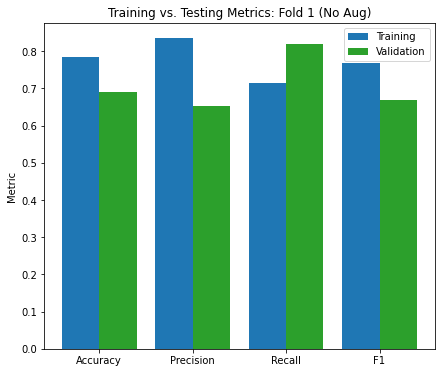

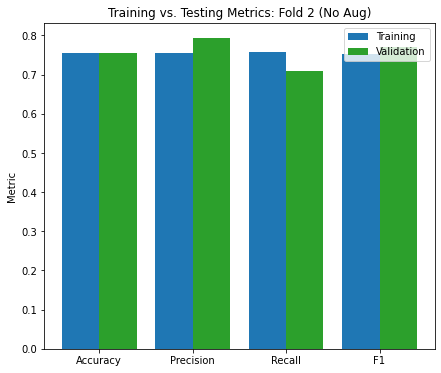

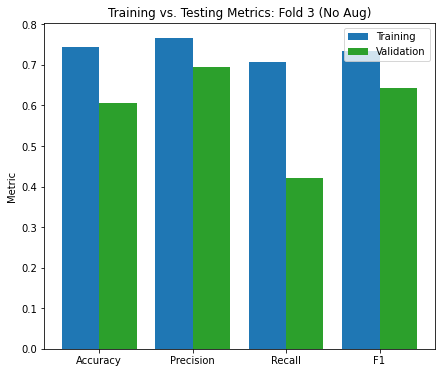

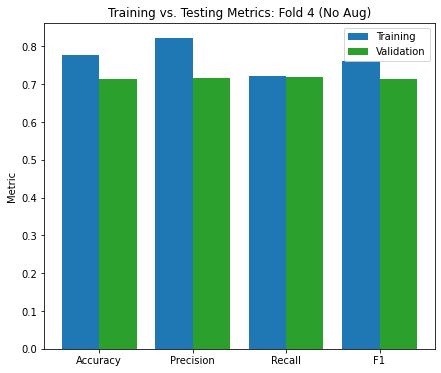

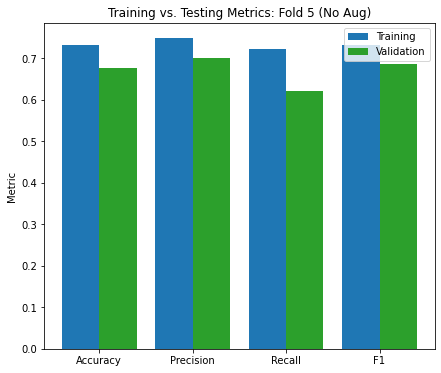

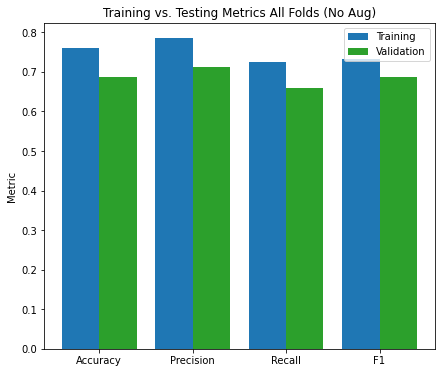

In [47]:
import matplotlib.pyplot as plt
import numpy as np

for FOLD_NUMBER in range(6): 
    
    if FOLD_NUMBER == 5: 
        training_acc = round(METRICS[:, 0].mean(), 3)
        training_precision = round(METRICS[:, 1].mean(), 3)
        training_recall = round(METRICS[:, 2].mean(), 3)
        validation_acc = round(METRICS[:, 3].mean(), 3)
        validation_precision = round(METRICS[:, 4].mean(), 3)
        validation_recall = round(METRICS[:, 5].mean(), 3)

        train_f1 = hmean(training_precision, train_recall)
        val_f1 = hmean(validation_precision, validation_recall)
    
    else : 
        metrics = METRICS_DICT[FOLD_NUMBER]
        training_acc = round(metrics[:, 0].mean(), 3)
        training_precision = round(metrics[:, 1].mean(), 3)
        training_recall = round(metrics[:, 2].mean(), 3)
        validation_acc = round(metrics[:, 3].mean(), 3)
        validation_precision = round(metrics[:, 4].mean(), 3)
        validation_recall = round(metrics[:, 5].mean(), 3)


        training_f1 = hmean(metrics[:, 1], metrics[:, 2]).mean()
        validation_f1 = hmean(metrics[:, 3], metrics[:, 4]).mean()

    labels = ['Accuracy', "Precision", "Recall", "F1"]

    x = np.arange(len(labels))  # the label locations
    width = 0.4  # the width of the bars

    fig, ax = plt.subplots()
    fig.set_size_inches(7, 6)
    rects1 = ax.bar(x - width/2, [training_acc, training_precision, training_recall, training_f1], width, label='Training', color = "tab:blue")
    rects2 = ax.bar(x + width/2, [validation_acc, validation_precision, validation_recall, validation_f1], width, label='Validation', color="tab:green")

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_ylabel('Metric')
    if FOLD_NUMBER != 5: 
        ax.set_title(f"Training vs. Testing Metrics: Fold {FOLD_NUMBER + 1} (No Aug)")
    else: 
        ax.set_title("Training vs. Testing Metrics All Folds (No Aug)")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.legend(loc="upper right")

    #ax.bar_label(rects1, padding=3)
    #ax.bar_label(rects2, padding=3)

    if FOLD_NUMBER != 5 : 
        plt.savefig(f"balanced_plots/train_vs_test_{FOLD_NUMBER + 1}_naug.png")

    else: 
        plt.savefig("balanced_plots/train_vs_test_all_naug.png")
    plt.show()